<a href="https://colab.research.google.com/github/AttarTee/sample-social-network-datasets/blob/master/DataComp_datacleaning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [25]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Packages/Libraries

## Python

In [1]:
!pip install xlsxwriter

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 149 kB 29.6 MB/s 


In [2]:
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt

from datetime import datetime

In [3]:
import xlsxwriter

In [4]:
!pip install econml

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 3.3 MB 26.5 MB/s 
     |████████████████████████████████| 564 kB 29.5 MB/s 
     |████████████████████████████████| 77 kB 7.1 MB/s 
     |████████████████████████████████| 164 kB 52.3 MB/s 
  Attempting uninstall: pydot
    Found existing installation: pydot 1.3.0
    Uninstalling pydot-1.3.0:
      Successfully uninstalled pydot-1.3.0


In [5]:
from econml.grf import CausalForest, CausalIVForest, RegressionForest
from econml.dml import CausalForestDML
import numpy as np
import scipy.special
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree
import shap

In [6]:
from sklearn import preprocessing

In [7]:
#pd.set_option('display.max_columns', 50)

## R


In [8]:
%load_ext rpy2.ipython

In [9]:
%%R
install.packages(c("tidyverse", "learnr", "DiagrammeR", "broom"))

install.packages("grf")
install.packages("https://github.com/grf-labs/sufrep/blob/master/sufrep_0.1.0.tar.gz?raw=true", repos = NULL, type = "source")

install.packages(c("mice","VIM", "lattice"))

library(learnr)
library(DiagrammeR)
library(broom)
library(tidyverse)

library(grf)
library(sufrep)

library(mice)
library(VIM)
library(lattice)

(as ‘lib’ is unspecified)


















































































































	‘/tmp/RtmpCJesIv/downloaded_packages’

(as ‘lib’ is unspecified)

































	‘/tmp/RtmpCJesIv/downloaded_packages’

(as ‘lib’ is unspecified)






(as ‘lib’ is unspecified)























































































































	‘/tmp/RtmpCJesIv/downloaded_packages’



── Attaching packages ─────────────────────────────────────── tidyverse 1.3.2 ──
✔ ggplot2 3.3.6     ✔ purrr   0.3.4
✔ tibble  3.1.7     ✔ dplyr   1.0.9
✔ tidyr   1.2.0     ✔ stringr 1.4.1
✔ readr   2.1.2     ✔ forcats 0.5.2
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()


Attaching package: ‘mice’



    filter



    cbind, rbind







Attaching package: ‘VIM’



    sleep




In [20]:
%R getOption("max.print")

array([50], dtype=int32)

In [17]:
%%R
options(max.print=50)

# Directory Management

In [22]:
file_path = "/content/drive/MyDrive/DataDrive2030/"
data_file_name = "DataDrive2030_PD_EXTERNAL.dta"

In [23]:
# PD_1_INT_total_elom_CHILD_df.to_stata(file_path + 'PD_1_INT_total_elom_CHILD_2021.dta')

# Raw Data Import

In [26]:
raw_data_df = pd.read_stata(file_path + data_file_name, convert_categoricals=True) #.unique()
raw_data_df.head()

,child_id,data_year,data_source,child_date,child_age,child_enrolment_date,child_months_enrolment,child_grant,child_years_in_programme,child_score_item_1,...,elp_ind,gps_ind,pre_covid,ses_proxy,quintile_used,id_facility_n,id_ward_n,id_mn_n,id_dc_n,id_prov_n
0,1000101,2021.0,Thrive by Five Index,2021-10-18,59.0,2020-01-13,21.0,NaN,2nd year in programme,2.91,...,Yes,Yes,Post COVID,2.0,No,4.0,16.0,40.0,494.0,950.0
1,1000102,2021.0,Thrive by Five Index,2021-10-18,58.0,2020-01-18,21.0,NaN,2nd year in programme,2.91,...,Yes,Yes,Post COVID,2.0,No,4.0,16.0,40.0,494.0,950.0
2,1000103,2021.0,Thrive by Five Index,2021-10-18,58.0,2020-02-15,20.0,NaN,2nd year in programme,2.91,...,Yes,Yes,Post COVID,2.0,No,4.0,16.0,40.0,494.0,950.0
3,1000104,2021.0,Thrive by Five Index,2021-10-18,57.0,2020-02-18,19.0,NaN,2nd year in programme,2.91,...,Yes,Yes,Post COVID,2.0,No,4.0,16.0,40.0,494.0,950.0
4,1000202,2021.0,Thrive by Five Index,2021-10-25,54.0,2021-02-01,8.0,Yes,1st year in the programme,2.91,...,Yes,Yes,Post COVID,3.0,No,4.0,16.0,40.0,494.0,950.0


In [27]:
raw_data_df_with_number = pd.read_stata(file_path + data_file_name, convert_categoricals=False) #.unique()
raw_data_df_with_number.head(3)

,child_id,data_year,data_source,child_date,child_age,child_enrolment_date,child_months_enrolment,child_grant,child_years_in_programme,child_score_item_1,...,elp_ind,gps_ind,pre_covid,ses_proxy,quintile_used,id_facility_n,id_ward_n,id_mn_n,id_dc_n,id_prov_n
0,1000101,2021.0,Thrive by Five Index,2021-10-18,59.0,2020-01-13,21.0,NaN,2.0,2.91,...,1.0,1.0,0.0,2.0,0.0,4.0,16.0,40.0,494.0,950.0
1,1000102,2021.0,Thrive by Five Index,2021-10-18,58.0,2020-01-18,21.0,NaN,2.0,2.91,...,1.0,1.0,0.0,2.0,0.0,4.0,16.0,40.0,494.0,950.0
2,1000103,2021.0,Thrive by Five Index,2021-10-18,58.0,2020-02-15,20.0,NaN,2.0,2.91,...,1.0,1.0,0.0,2.0,0.0,4.0,16.0,40.0,494.0,950.0


In [ ]:
# plt.figure(figsize=(100,100))
# sns.heatmap(raw_data_df.sort_values('data_year').dropna(axis = 1, how = 'all').isna().transpose(),
#             cmap="YlGnBu",  
#             cbar_kws={'label': 'Missing Data'})

# plt.show()

In [ ]:

# plt.figure(figsize=(400,200))
# sns.displot(
#     data=raw_data_df.iloc[:100,:100].isna().melt(value_name="missing"),
#     y="variable",
#     hue="missing",
#     multiple="fill",
#     aspect=1.25
# )
# plt.show()

## Functions

In [28]:
def print_columns_with_substring(df, string):
  for i in df.columns:
    if string in i: 
      print(i)

#print_columns_with_substring(raw_data_df, 'cook')

In [29]:
def get_variables_with_given_prefix(df,pref):
  Pref_cols = []
  for var in df.columns:  
    if pref in var:
      Pref_cols.append(var)
  return Pref_cols

In [30]:
def drop_cols_with_substring(df, substrings):
  temp_df = df.copy()
  for substring in substrings:
     temp_df = temp_df.loc[:,~temp_df.columns.str.contains(substring, case=False)] 

  return temp_df

test_df = drop_cols_with_substring(raw_data_df, ['cluster'])
                                                    

In [31]:
def standardize_strings(df, column, things_to_drop = [""]):
  temp_test = list(set([str.lower(x) for x in df[column].unique()]))

  for i in things_to_drop:
    while(i in temp_test) :
      temp_test.remove(i)

  return temp_test

#standardize_strings(raw_data_df, 'language_child', [""])

In [32]:
#raw_data_df['ses_proxy'].unique()

In [33]:
def pre_forest_prep_for_specific_PD(Penultimate_df, PD_Variable, drop_to_refine_significant_vars_PD_Variable, dropNa = False):

  df = Penultimate_df.copy()
  print(df.shape)
  df = df[df['data_year'] == 2021]
  # df = df[df['ses_proxy'] <= 3]
  print(df.shape)
  df = df.dropna(axis = 1, how = 'all')
  print(df.shape)



  df = df.dropna(subset = ['id_cluster_original'])

  if dropNa:
      df = df.dropna(axis = 1).dropna()

  Y = df[PD_Variable]

  X = df.drop(columns = [PD_Variable])
  print(X.shape)
  X = drop_cols_with_substring(X, drop_to_refine_significant_vars_total_elom_facility )


  clusters = X['id_cluster_original'].copy()
  X = X.drop(columns = ['id_cluster_original'])
  clusters = clusters.to_numpy()
  clusters = pd.Series(clusters) 

  return X, Y, clusters

# X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 
#                                                  'PD_1_INT_total_elom_facility', drop_to_refine_significant_vars_total_elom_facility,
#                                                  dropNa = False )
# X

In [34]:
# Penultimate_df['ses_cat']

NameError: ignored

In [36]:
def crosstab_crossplot(df, vars):
  # df.plot(kind = 'scatter', y = vars[0], x = vars[1])
  temp_cross = pd.crosstab(df[vars[0]], df[vars[1]])

  #display(temp_cross)
  temp_cross.plot(kind = 'bar')
  
  temp_cross['perc'] = temp_cross[temp_cross.columns[-1]]/temp_cross[temp_cross.columns[0]]
  display(temp_cross)


# crosstab_crossplot(X, [ 'ses_cat', 'ses_proxy'])

## Datatypes

In [ ]:
temp_cats = []
for i in range(len(raw_data_df.dtypes.unique())):
  temp_cats.append(str(raw_data_df.dtypes.unique()[i]))

set(temp_cats)

{'category', 'datetime64[ns]', 'float32', 'float64', 'object'}

### object

In [37]:
print(raw_data_df.select_dtypes(include= 'object').shape)

all_strings_vars = raw_data_df.select_dtypes(include= 'object').columns
print(all_strings_vars[:5])

all_strings_df = raw_data_df.select_dtypes(include= 'object')
all_strings_df.head(3)

(11822, 110)
Index(['child_id', 'data_source', 'id_mn_best', 'prov_best', 'id_dc_best'], dtype='object')


,child_id,data_source,id_mn_best,prov_best,id_dc_best,dc_best,mn_best,pqa_class_age,pqa_class,pra_groupings,...,health,healthother,other_practitioner,language_child,language_assessment,programme,sanitation_educators,sanitation_learners,positionother,positionotherreason
0,1000101,Thrive by Five Index,MP313,Mpumalanga,DC31,NKANGALA,Steve Tshwete,,,5,...,,,,isiZulu,isiZulu,,,,,
1,1000102,Thrive by Five Index,MP313,Mpumalanga,DC31,NKANGALA,Steve Tshwete,,,5,...,,,,isiZulu,isiZulu,,,,,
2,1000103,Thrive by Five Index,MP313,Mpumalanga,DC31,NKANGALA,Steve Tshwete,,,5,...,,,,isiZulu,isiZulu,,,,,


In [38]:
# to categorical
string_to_cat_vars = ['id_mn_best',
                      'id_prov',
                      'id_dc_best',
                      'phase_natemis'
                      ]
                      
string_dummies_df = pd.get_dummies(raw_data_df[string_to_cat_vars], dummy_na=True)
string_dummies_df.head(3)

,id_mn_best_,id_mn_best_BUF,id_mn_best_CPT,id_mn_best_EC104,id_mn_best_EC121,id_mn_best_EC122,id_mn_best_EC124,id_mn_best_EC126,id_mn_best_EC129,id_mn_best_EC135,...,id_dc_best_MAN,id_dc_best_NMA,id_dc_best_TSH,id_dc_best_nan,phase_natemis_,phase_natemis_COMBINED SCHOOL,phase_natemis_INTERMEDIATE SCHOOL,phase_natemis_PRIMARY SCHOOL,phase_natemis_SECONDARY SCHOOL,phase_natemis_nan
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0


In [ ]:
print(raw_data_df['language_child'].unique())

print(raw_data_df['language_assessment'].unique())

temp_test = list(set([str.lower(x) for x in raw_data_df['language_assessment'].unique()]))
#pd.Series(list(set([str.lower(x) for x in raw_data_df['language_assessment'].unique()]))).dropna(axis= 0)[1]

['isiZulu' 'isiNdebele' 'siSwati' 'Sepedi' 'Xitsonga' 'Sesotho' 'Setswana'
 'Tshivenda' 'isiXhosa' '' 'Afrikaans' 'English' 'Siswati' 'Other']
['isiZulu' 'isiNdebele' 'siSwati' 'Sepedi' 'Xitsonga' 'Sesotho' 'Setswana'
 'Tshivenda' '' 'isiXhosa' 'Afrikaans' 'English' 'Other']


### Floats

#### 64

In [39]:
print(raw_data_df.select_dtypes(include=[np.float64]).shape)

all_float64_vars = raw_data_df.select_dtypes(include=[np.float64]).columns
print(all_float64_vars[:5])

all_float64_df = raw_data_df.select_dtypes(include=[np.float64])
display(all_float64_df.head())
# print_columns_with_substring(all_float64_df, 'PD_1_')
#all_float64_df = pd.DataFrame(preprocessing.MinMaxScaler(feature_range=(0, 1)).fit_transform(all_float64_df), columns = all_float64_df.columns)

all_float64_df.head(3)


(11822, 232)
Index(['child_age', 'child_months_enrolment', 'child_score_item_1',
       'child_score_item_2', 'child_score_item_3'],
      dtype='object')


,child_age,child_months_enrolment,child_score_item_1,child_score_item_2,child_score_item_3,child_score_item_4,child_domain_1,child_score_item_5,child_score_item_6,child_score_item_7,...,count_staff_cat_educator,count_assistants,duration_elom,saspri_datazone_quintile,duration_w2,programme_exposure,gr_r,gr_c1,gr_c2,gr_c3
0,59.0,21.0,2.91,2.07,0.00,4.25,9.23,4.20,4.58,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,58.0,21.0,2.91,1.00,2.22,4.25,10.38,4.20,4.58,4.74,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,58.0,20.0,2.91,2.07,0.00,2.62,7.60,3.11,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,57.0,19.0,2.91,0.00,2.22,0.00,5.13,4.20,4.58,3.12,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,54.0,8.0,2.91,3.59,2.22,2.62,11.34,3.11,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


,child_age,child_months_enrolment,child_score_item_1,child_score_item_2,child_score_item_3,child_score_item_4,child_domain_1,child_score_item_5,child_score_item_6,child_score_item_7,...,count_staff_cat_educator,count_assistants,duration_elom,saspri_datazone_quintile,duration_w2,programme_exposure,gr_r,gr_c1,gr_c2,gr_c3
0,59.0,21.0,2.91,2.07,0.00,4.25,9.23,4.20,4.58,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,58.0,21.0,2.91,1.00,2.22,4.25,10.38,4.20,4.58,4.74,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,58.0,20.0,2.91,2.07,0.00,2.62,7.60,3.11,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### 32

In [ ]:
print_columns_with_substring(raw_data_df_with_number, 'ses_cat')

ses_cat


In [ ]:
all_float32_df

,data_year,child_zha,child_zha_w2,child_stunted_w2,PD_1_INT_total_facility,PD_1_INT_total_ward,PD_1_INT_total_mn,PD_1_INT_total_dc,id_facility,pra_experience,...,prov_space_m,count_toilets_children,opening_hours,language_match,ses_proxy,id_facility_n,id_ward_n,id_mn_n,id_dc_n,id_prov_n
0,2021,1.251235,NaN,NaN,0.0,1.0,0.0,1.0,1.0,NaN,...,0.872460,1.0,NaN,1.0,2.0,4.0,16.0,40.0,494.0,950.0
1,2021,1.054518,NaN,NaN,0.0,1.0,0.0,1.0,1.0,NaN,...,0.872460,1.0,NaN,1.0,2.0,4.0,16.0,40.0,494.0,950.0
2,2021,0.511026,NaN,NaN,0.0,1.0,0.0,1.0,1.0,NaN,...,0.872460,1.0,NaN,1.0,2.0,4.0,16.0,40.0,494.0,950.0
3,2021,0.459762,NaN,NaN,0.0,1.0,0.0,1.0,1.0,NaN,...,0.872460,1.0,NaN,1.0,2.0,4.0,16.0,40.0,494.0,950.0
4,2021,0.733104,NaN,NaN,0.0,0.0,0.0,1.0,2.0,NaN,...,0.872460,18.0,NaN,1.0,3.0,4.0,16.0,40.0,494.0,950.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11817,2021,0.365268,NaN,NaN,0.0,0.0,0.0,3.0,506.0,24.0,...,0.836897,8.0,10.5,1.0,5.0,4.0,25.0,838.0,1448.0,2102.0
11818,2021,0.601019,NaN,NaN,3.0,0.0,0.0,0.0,555.0,NaN,...,0.806530,8.0,NaN,1.0,4.0,3.0,20.0,35.0,118.0,868.0
11819,2019,0.689245,NaN,NaN,0.0,0.0,0.0,3.0,1092.0,NaN,...,NaN,NaN,NaN,1.0,4.0,24.0,NaN,NaN,0.0,0.0
11820,2021,-0.447919,NaN,NaN,0.0,4.0,1.0,0.0,595.0,NaN,...,0.806530,1.0,NaN,1.0,4.0,2.0,14.0,73.0,119.0,868.0


In [ ]:
print(raw_data_df.select_dtypes(include=[np.float32]).shape)
all_float32_vars = raw_data_df.select_dtypes(include=[np.float32]).columns #.dropna(axis = 1)
print(all_float32_vars[:3])

all_float32_df = raw_data_df.select_dtypes(include=[np.float32]) #.dropna(axis = 1)
display(all_float32_df.head(3))
print(all_float32_df['PD_1_INT_total_ward'].unique())
# all_float32_df = pd.DataFrame(preprocessing.scale(all_float32_df), columns = all_float32_df.columns)
# display(pd.DataFrame(preprocessing.scale(all_float32_df), columns = all_float32_df.columns).head(3))

# to categorical {ordered}
# all_float32_df['data_year'] = pd.Categorical(all_float32_df['data_year'].astype(int), ordered=True)

all_float32_df.head()

(11822, 126)
Index(['data_year', 'child_zha', 'child_zha_w2'], dtype='object')


,data_year,child_zha,child_zha_w2,child_stunted_w2,PD_1_INT_total_facility,PD_1_INT_total_ward,PD_1_INT_total_mn,PD_1_INT_total_dc,id_facility,pra_experience,...,prov_space_m,count_toilets_children,opening_hours,language_match,ses_proxy,id_facility_n,id_ward_n,id_mn_n,id_dc_n,id_prov_n
0,2021.0,1.251235,NaN,NaN,0.0,1.0,0.0,1.0,1.0,NaN,...,0.87246,1.0,NaN,1.0,2.0,4.0,16.0,40.0,494.0,950.0
1,2021.0,1.054518,NaN,NaN,0.0,1.0,0.0,1.0,1.0,NaN,...,0.87246,1.0,NaN,1.0,2.0,4.0,16.0,40.0,494.0,950.0
2,2021.0,0.511026,NaN,NaN,0.0,1.0,0.0,1.0,1.0,NaN,...,0.87246,1.0,NaN,1.0,2.0,4.0,16.0,40.0,494.0,950.0


[1. 0. 3. 4. 2. 5. 6.]


,data_year,child_zha,child_zha_w2,child_stunted_w2,PD_1_INT_total_facility,PD_1_INT_total_ward,PD_1_INT_total_mn,PD_1_INT_total_dc,id_facility,pra_experience,...,prov_space_m,count_toilets_children,opening_hours,language_match,ses_proxy,id_facility_n,id_ward_n,id_mn_n,id_dc_n,id_prov_n
0,2021.0,1.251235,NaN,NaN,0.0,1.0,0.0,1.0,1.0,NaN,...,0.87246,1.0,NaN,1.0,2.0,4.0,16.0,40.0,494.0,950.0
1,2021.0,1.054518,NaN,NaN,0.0,1.0,0.0,1.0,1.0,NaN,...,0.87246,1.0,NaN,1.0,2.0,4.0,16.0,40.0,494.0,950.0
2,2021.0,0.511026,NaN,NaN,0.0,1.0,0.0,1.0,1.0,NaN,...,0.87246,1.0,NaN,1.0,2.0,4.0,16.0,40.0,494.0,950.0
3,2021.0,0.459762,NaN,NaN,0.0,1.0,0.0,1.0,1.0,NaN,...,0.87246,1.0,NaN,1.0,2.0,4.0,16.0,40.0,494.0,950.0
4,2021.0,0.733104,NaN,NaN,0.0,0.0,0.0,1.0,2.0,NaN,...,0.87246,18.0,NaN,1.0,3.0,4.0,16.0,40.0,494.0,950.0


In [ ]:
# # to categorical {ordered}
# temp_df_ = all_float32_df.copy()
# all_float32_df = all_float32_df.drop(columns = ['data_year'])
# temp_df_['data_year'] = np.array(temp_df_['data_year']).astype(int)
# float_to_cat = pd.Categorical(temp_df_['data_year'], ordered=True)
# float_to_cat

In [ ]:
# all_float32_df = pd.DataFrame(preprocessing.MinMaxScaler(feature_range=(0, 1)).fit_transform(all_float32_df), columns = all_float32_df.columns)
# all_float32_df

### DateTime

In [ ]:
datetime_vars_to_keep = ['child_date',
                         'child_enrolment_date',
                         'child_dob']

In [ ]:
print(raw_data_df.select_dtypes(include='datetime64').shape)
final_datetime = raw_data_df.select_dtypes(include='datetime64')[datetime_vars_to_keep]

for column in final_datetime.columns:
  temp_time_int = []
  temp_time_int = np.array(temp_time_int)

  for i in range(len(final_datetime[column])):
    try:
      temp_time_int = np.append(temp_time_int, int(round(final_datetime[column].loc[i].timestamp())))
    except :
      temp_time_int = np.append(temp_time_int, np.nan)

  final_datetime[column] = temp_time_int

print(final_datetime.shape)
final_datetime.head(3)

(11822, 12)
(11822, 3)


,child_date,child_enrolment_date,child_dob
0,1.634515e+09,1.578874e+09,1.478650e+09
1,1.634515e+09,1.579306e+09,1.480291e+09
2,1.634515e+09,1.581725e+09,1.479686e+09


### Categorical

In [ ]:
print(raw_data_df.select_dtypes(include='category').shape)
raw_data_df.select_dtypes(include='category').head(3)

(11822, 808)


,child_grant,child_years_in_programme,child_observe_attentive,child_observe_concentrated,child_observe_diligent,child_observe_interested,child_total_elom_cuts,child_domain_1_cuts,child_domain_2_cuts,child_domain_3_cuts,...,sanitation_educators_96,sanitation_learners_3,gr_ecd,gr_1_tt,sef_ind,ses_cat,elp_ind,gps_ind,pre_covid,quintile_used
0,NaN,2nd year in programme,Often,Often,Often,Often,On track,On track,On track,On track,...,NaN,NaN,NaN,NaN,Yes,R111-290,Yes,Yes,Post COVID,No
1,NaN,2nd year in programme,Often,Often,Often,Often,On track,On track,On track,On track,...,NaN,NaN,NaN,NaN,Yes,R111-290,Yes,Yes,Post COVID,No
2,NaN,2nd year in programme,Often,Often,Often,Often,Falling behind,Falling behind,Falling behind,Falling far behind,...,NaN,NaN,NaN,NaN,Yes,R111-290,Yes,Yes,Post COVID,No


In [ ]:
# counter = 0
# for i in variable_with_two_categories:
#   if counter < 50:
#     if sorted(raw_data_df_with_number[i].unique())[-1] > 1:
#           print(i,sorted(raw_data_df_with_number[i].unique())[-1])
#     else:
#       print("*")
#     counter += 1
#   else:
#     break

In [ ]:
cat_df = raw_data_df.select_dtypes(include='category')
variable_with_more_than_two_categories = []
variable_with_two_categories = []
COUNT = 0
for i in cat_df.columns:

  if len(cat_df[i].dtype.categories) > 2 :
 
    variable_with_more_than_two_categories.append(i)
    COUNT +=1

  if len(cat_df[i].dtype.categories) == 2:
    variable_with_two_categories.append(i)


variable_with_two_categories
variable_with_more_than_two_categories[:10]

['child_years_in_programme',
 'child_observe_attentive',
 'child_observe_concentrated',
 'child_observe_diligent',
 'child_observe_interested',
 'child_total_elom_cuts',
 'child_domain_1_cuts',
 'child_domain_2_cuts',
 'child_domain_3_cuts',
 'child_domain_4_cuts']

#### Dummies

In [ ]:
more_than_two_cats_df = pd.read_excel("/content/drive/MyDrive/DataDrive2030/DD2030_PD_Codebook.xlsx", sheet_name="Sheet1")
more_than_two_cats_df.head()

,name,Unnamed: 1,ordered,policy,Unnamed: 4,Unnamed: 5
0,child_years_in_programme,NaN,1.0,NaN,NaN,NaN
1,child_observe_attentive,NaN,1.0,NaN,NaN,NaN
2,child_observe_concentrated,NaN,1.0,NaN,NaN,NaN
3,child_observe_diligent,NaN,1.0,NaN,NaN,NaN
4,child_observe_interested,NaN,1.0,NaN,NaN,NaN


In [ ]:
ordered_cats_df = more_than_two_cats_df[more_than_two_cats_df["ordered"] > 0]
ordered_cats_df = ordered_cats_df.name.to_list()
print(len(ordered_cats_df))
final_ordered_cats = raw_data_df[ordered_cats_df]
final_ordered_cats

119


,child_years_in_programme,child_observe_attentive,child_observe_concentrated,child_observe_diligent,child_observe_interested,child_total_elom_cuts,child_domain_1_cuts,child_domain_2_cuts,child_domain_3_cuts,child_domain_4_cuts,...,hle_names_time,hle_count_time,hle_paintdraw_time,certificate_registration_program,certificate_registration_npo,certificate_register,plan,rating,gr_1_tt,ses_cat
0,2nd year in programme,Often,Often,Often,Often,On track,On track,On track,On track,On track,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,R111-290
1,2nd year in programme,Often,Often,Often,Often,On track,On track,On track,On track,On track,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,R111-290
2,2nd year in programme,Often,Often,Often,Often,Falling behind,Falling behind,Falling behind,Falling far behind,On track,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,R111-290
3,2nd year in programme,Often,Often,Often,Often,On track,Falling far behind,On track,On track,On track,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,R111-290
4,1st year in the programme,Often,Often,Often,Often,On track,On track,Falling far behind,Falling behind,Falling behind,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,R291-750
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11817,3rd year in programme,Often,Sometimes,Often,Almost always,On track,On track,Falling behind,On track,On track,...,NaN,NaN,NaN,NaN,NaN,"No, but it exists","Yes, details provided for the activities each day",NaN,NaN,R1751+
11818,1st year in the programme,Often,Often,Often,Often,On track,On track,Falling behind,On track,On track,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,R751-1750
11819,1st year in the programme,Sometimes,Almost never,Sometimes,Almost never,On track,On track,On track,On track,On track,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11820,3rd year in programme,Almost always,Almost always,Almost always,Almost always,On track,On track,On track,On track,On track,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,R751-1750


In [ ]:
ordered_cats_df = more_than_two_cats_df[more_than_two_cats_df["ordered"] > 0]
ordered_cats_df = ordered_cats_df.name.to_list()
print(len(ordered_cats_df))
final_ordered_cats_with_dummies = raw_data_df[ordered_cats_df].copy() #pd.get_dummies(raw_data_df[ordered_cats_df], dummy_na= True )
print(final_ordered_cats_with_dummies.shape)
# final_ordered_cats_with_dummies['']
ordered_cats_df
# all_float32_df['data_year'] = pd.Categorical(all_float32_df['data_year'].astype(int), ordered=True)


In [ ]:
unordered_cats_df = more_than_two_cats_df[more_than_two_cats_df["ordered"]== 0]
unordered_cats_names = unordered_cats_df.name.to_list()

pd.get_dummies(raw_data_df[unordered_cats_names], dummy_na=True)

0        1
1        1
2        1
3        1
4        1
        ..
11817    1
11818    1
11819    1
11820    1
11821    0
Name: facility_type_nan, Length: 11822, dtype: uint8

In [ ]:
# numeric + binary_cats + ordered_cats + unordered_cats + string

In [ ]:
dd = [ 
    #child_years_in_programme


    #   child_total_elom_cuts
    #   child_domain_1_cuts
    #   child_domain_2_cuts
    #   child_domain_3_cuts
    #   child_domain_4_cuts
    #   child_domain_5_cuts
    #   child_observe_attentive_w2
    #   child_observe_concentrated_w2
    #   child_observe_diligent_w2
    #   child_observe_interested_w2
    #   child_conditions
    #   child_stunted
    #   pqa_environment_areas
    #   pqa_environment_variety
    #   pqa_environment_appropriate
    #   pqa_environment_accessible
    #   pqa_environment_open
    #   pqa_environment_outdoor
    #   pqa_assessment_observation
    #   pqa_assessment_systematic
    #   pqa_relationships_peers
    #   pqa_relationships_staff
    #   pqa_relationships_acknowledge
    #   pqa_relationships_discipline
    #   pqa_curriculum_ncf
    #   pqa_curriculum_plan
    #   pqa_curriculum_balance
    #   pqa_curriculum_numeracy
    #   pqa_curriculum_literacy
    #   pqa_teaching_choice
    #   pqa_teaching_engagement
    #   pqa_teaching_participation
    #   pqa_teaching_questions
    #   pqa_teaching_support
    #   pra_free_play
    #   pra_free_play_outdoor
    #   pra_engaged
    #   pra_class_language
    #   pra_job
    #   pra_salary
    #   pra_education
    #   pra_previous
    #   pra_motivate_support
    #   pra_motivate_recognition
    #   pra_motivate_mentoring
    #   pra_agency_choice
    #   pra_agency_explore
    #   pra_agency_questions
    #   pra_agency_understand
    #   pra_agency_play
    #   pra_agency_learn
    #   pra_agency_order
    #   pra_shape
    #   pra_meetings_per_week
    #   pra_class_space_2
    #   pra_adequacy_materials
    #   pra_subsidy
    #   pra_grade
    #   pra_cotlands_visits
    #   pra_cotlands_support
    #   pra_ntataise_visits
    #   pra_ntataise_support
    #   pra_ntataise_attendance
    #   pra_tuc_visits
    #   pra_tuc_support
    #   pra_tuc_attendance
    #   pra_letcee_support_cluster
    #   pra_letcee_support_coach
    #   pra_letcee_clubmeetings
    #   pra_letcee_clubattendance
    #   pri_time_open_hours
    #   pri_time_open_minutes
    #   pri_time_close_hours
    #   pri_time_close_minutes
    #   pri_separate
    #   pri_facilities
    #   pri_land
    #   pri_registered_partial
    #   pri_registered_programme
    #   pri_registered_dsd
    #   pri_kitchen
    #   pri_attendance
    #   pri_fees_paid_proportion
    #   pri_education
    #   pri_founder
    #   pri_same_language
    #   pri_location
    #   pri_support_dsd
    #   pri_support_dbe
    #   pri_support_municipality
    #   pri_support_ngo
    #   pri_staff_employed
    #   pri_covid_staff_salaries
    #   pri_bank
    #   pri_food_parents_breakfast
    #   pri_food_parents_morning
    #   pri_food_parents_lunch
    #   pri_food_parents_afternoon
    #   pri_meal_prep
    #   pri_parents_frequency
    #   pri_parents_contact
    #   pri_parents_activities
    #   pri_support_frequency
    #   obs_heating_census
    #   obs_lighting_census
    #   obs_cooking_census
    #   obs_water
    #   obs_building
    #   obs_condition_equipment
    #   obs_heating
    #   obs_lighting
    #   obs_cooking
    #   obs_material_display
    #   obs_booknumber
    #   obs_infrastructure
    #   teacher_social_peers
    #   teacher_social_nonaggressive
    #   teacher_social_cooperate
    #   teacher_social_assistance
    #   teacher_social_ideas
    #   teacher_social_initiative
    #   teacher_emotional_understand
    #   teacher_emotional_appropriate
    #   teacher_emotional_independent
    #   teacher_emotional_adjust
    #   teacher_emotional_confidence
    #   teacher_emotional_selfstarter
    #   teacher_familiarity_with_child
    #   hle_caregiver_relation
    #   hle_caregiver_postschool
    #   hle_time_available_weekday
    #   hle_time_available_weekend
    #   hle_readbooks_time
    #   hle_readbooks_otherwho
    #   hle_stories_time
    #   hle_sing_time
    #   hle_outside_time
    #   hle_outside_otherwho
    #   hle_play_time
    #   hle_play_otherwho
    #   hle_names_time
    #   hle_count_time
    #   hle_count_otherwho
    #   hle_paintdraw_time
    #   hle_paintdraw_otherwho
    #   hle_ecd_reason
    #   hle_caregiver_educ
    #   grade_r
    #   id_cluster_original
    #   certificate_registration_program
    #   certificate_registration_npo
    #   certificate_register
    #   plan
    #   facility_type
    #   rating
    #   gr_ecd
    #   gr_1_tt
    #   ses_cat 
]

# Penultimate Dataset

## Exceptions

In [ ]:
raw_data_df_with_number['ses_cat']

0        2.0
1        2.0
2        2.0
3        2.0
4        3.0
        ... 
11817    5.0
11818    4.0
11819    NaN
11820    4.0
11821    1.0
Name: ses_cat, Length: 11822, dtype: float32

In [ ]:
# raw_data_df['id_mn_n'].describe() #.sort_values(ascending = False).head(30)

In [ ]:
for i in raw_data_df:
  if "ses_cat" in i: 
    print(i)

ses_cat


In [ ]:
# numeric + binary_cats + ordered_cats[misc] + {unordered_cats}[misc] + string + datetime

In [ ]:
# # 64
# id_enumerator
# id_ward
# id_team
# #32
# id_facility
# id_ward_n
# id_mn_n
# id_dc_n
# id_prov_n

## Build

In [ ]:
all_float32_vars

Index(['data_year', 'child_zha', 'child_zha_w2', 'child_stunted_w2',
       'PD_1_INT_total_facility', 'PD_1_INT_total_ward', 'PD_1_INT_total_mn',
       'PD_1_INT_total_dc', 'id_facility', 'pra_experience',
       ...
       'prov_space_m', 'count_toilets_children', 'opening_hours',
       'language_match', 'ses_proxy', 'id_facility_n', 'id_ward_n', 'id_mn_n',
       'id_dc_n', 'id_prov_n'],
      dtype='object', length=126)

In [ ]:
# NUMERIC
all_float64_vars
all_float32_vars

In [ ]:
# BINARY
all_binary_df = raw_data_df_with_number[variable_with_two_categories]
# all_binary_df

In [ ]:
# UNORDERED
unordered_cats_df = more_than_two_cats_df[more_than_two_cats_df["ordered"]== 0]
unordered_cats_names = unordered_cats_df.name.to_list()

unordered_cats_df = raw_data_df[unordered_cats_names] #pd.get_dummies(raw_data_df[unordered_cats_names], dummy_na=True)
unordered_cats_df

In [ ]:
# to categorical {unorederd}
string_to_cat_vars = ['id_mn_best',
                      'id_prov',
                      'id_dc_best',
                      'phase_natemis'
                      ]
                      
string_dummies_df = raw_data_df[string_to_cat_vars] #pd.get_dummies(raw_data_df[string_to_cat_vars], dummy_na=True)
string_dummies_df

,id_mn_best,id_prov,id_dc_best,phase_natemis
0,MP313,MP,DC31,PRIMARY SCHOOL
1,MP313,MP,DC31,PRIMARY SCHOOL
2,MP313,MP,DC31,PRIMARY SCHOOL
3,MP313,MP,DC31,PRIMARY SCHOOL
4,MP313,MP,DC31,SECONDARY SCHOOL
...,...,...,...,...
11817,CPT,WC,CPT,PRIMARY SCHOOL
11818,NC073,NC,DC7,PRIMARY SCHOOL
11819,,,,
11820,NC091,NC,DC9,PRIMARY SCHOOL


In [ ]:
ordered_cats_df = more_than_two_cats_df[more_than_two_cats_df["ordered"] > 0]
ordered_cats_df = ordered_cats_df.name.to_list()
print(len(ordered_cats_df))
final_ordered_cats_with_dummies = raw_data_df[ordered_cats_df].copy() #pd.get_dummies(raw_data_df[ordered_cats_df], dummy_na= True )
print(final_ordered_cats_with_dummies.shape)
final_ordered_cats_with_dummies

# ORDERED
#final_ordered_cats_with_dummies


119
(11822, 119)


,child_years_in_programme,child_observe_attentive,child_observe_concentrated,child_observe_diligent,child_observe_interested,child_total_elom_cuts,child_domain_1_cuts,child_domain_2_cuts,child_domain_3_cuts,child_domain_4_cuts,...,hle_names_time,hle_count_time,hle_paintdraw_time,certificate_registration_program,certificate_registration_npo,certificate_register,plan,rating,gr_1_tt,ses_cat
0,2nd year in programme,Often,Often,Often,Often,On track,On track,On track,On track,On track,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,R111-290
1,2nd year in programme,Often,Often,Often,Often,On track,On track,On track,On track,On track,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,R111-290
2,2nd year in programme,Often,Often,Often,Often,Falling behind,Falling behind,Falling behind,Falling far behind,On track,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,R111-290
3,2nd year in programme,Often,Often,Often,Often,On track,Falling far behind,On track,On track,On track,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,R111-290
4,1st year in the programme,Often,Often,Often,Often,On track,On track,Falling far behind,Falling behind,Falling behind,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,R291-750
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11817,3rd year in programme,Often,Sometimes,Often,Almost always,On track,On track,Falling behind,On track,On track,...,NaN,NaN,NaN,NaN,NaN,"No, but it exists","Yes, details provided for the activities each day",NaN,NaN,R1751+
11818,1st year in the programme,Often,Often,Often,Often,On track,On track,Falling behind,On track,On track,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,R751-1750
11819,1st year in the programme,Sometimes,Almost never,Sometimes,Almost never,On track,On track,On track,On track,On track,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11820,3rd year in programme,Almost always,Almost always,Almost always,Almost always,On track,On track,On track,On track,On track,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,R751-1750


In [ ]:
# numeric + binary_cats + ordered_cats[misc] + {unordered_cats}[misc] + string + datetime

In [ ]:
# DATETIME
final_datetime

## Compile

In [ ]:
Penultimate_df['pra_cotlands_visits'].unique()[1]

'0.0'

In [ ]:
Penultimate_df = pd.DataFrame()
Penultimate_df = pd.concat([all_float64_df,  # numeric
                            all_float32_df,  # numeric
                            all_binary_df, # binary_cats
                            unordered_cats_df, #unordered_cats
                            string_dummies_df, #{unordered_cats}[misc] 
                            final_ordered_cats_with_dummies, #ordered_cats
                            # float_to_cat,        #ordered_cats[misc][time]
                            final_datetime      #datetime
                            ], axis=1)


# Penultimate_df['hle_readbooks_otherwho'] = Penultimate_df['hle_readbooks_otherwho'].astype(str)
# temp = get_variables_with_given_prefix(Penultimate_df,'hle_')
# # for i in temp:
#   # print(Penultimate_df[i].unique())
# hle_cat = Penultimate_df[temp].select_dtypes(include='category')
# Penultimate_df[hle_cat.columns] = hle_cat.apply(lambda x:  x.astype(str)).replace('nan',np.nan)
temp_cats = Penultimate_df.select_dtypes(include='category').columns
Penultimate_df[temp_cats] = Penultimate_df[temp_cats].select_dtypes(include='category').apply(lambda x:  x.astype(str)).replace('nan',np.nan)

# Penultimate_df[unordered_cats_df.columns] = pd.Categorical(Penultimate_df[unordered_cats_df.columns], ordered = False)
# Penultimate_df[final_ordered_cats.columns] = pd.Categorical(Penultimate_df[final_ordered_cats.columns], ordered = True)
Penultimate_df[unordered_cats_df.columns] = Penultimate_df[unordered_cats_df.columns].astype('category')
Penultimate_df[final_ordered_cats.columns] = Penultimate_df[final_ordered_cats.columns].apply(lambda x: pd.Categorical(x,  ordered = True))



Penultimate_df = drop_cols_with_substring(Penultimate_df, ['cluster'])
Penultimate_df['id_cluster_original'] = raw_data_df['id_cluster_original']
Penultimate_df

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`


,child_age,child_months_enrolment,child_score_item_1,child_score_item_2,child_score_item_3,child_score_item_4,child_domain_1,child_score_item_5,child_score_item_6,child_score_item_7,...,certificate_registration_npo,certificate_register,plan,rating,gr_1_tt,ses_cat,child_date,child_enrolment_date,child_dob,id_cluster_original
0,59.00000,21.0,2.91,2.07,0.00,4.25,9.230000,4.20,4.58,3.77,...,NaN,NaN,NaN,NaN,NaN,R111-290,1.634515e+09,1.578874e+09,1.478650e+09,347.0
1,58.00000,21.0,2.91,1.00,2.22,4.25,10.380000,4.20,4.58,4.74,...,NaN,NaN,NaN,NaN,NaN,R111-290,1.634515e+09,1.579306e+09,1.480291e+09,347.0
2,58.00000,20.0,2.91,2.07,0.00,2.62,7.600000,3.11,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,R111-290,1.634515e+09,1.581725e+09,1.479686e+09,347.0
3,57.00000,19.0,2.91,0.00,2.22,0.00,5.130000,4.20,4.58,3.12,...,NaN,NaN,NaN,NaN,NaN,R111-290,1.634515e+09,1.581984e+09,1.482278e+09,347.0
4,54.00000,8.0,2.91,3.59,2.22,2.62,11.340000,3.11,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,R291-750,1.635120e+09,1.612138e+09,1.492474e+09,367.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11817,55.00000,NaN,2.91,2.07,0.00,7.20,12.180000,4.20,0.00,3.77,...,NaN,"No, but it exists","Yes, details provided for the activities each day",NaN,NaN,R1751+,1.632182e+09,NaN,1.485216e+09,8.0
11818,56.00000,8.0,2.91,1.00,2.22,2.62,8.750000,4.20,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,R751-1750,1.633997e+09,1.612138e+09,1.486598e+09,108.0
11819,57.80328,NaN,2.91,2.07,2.22,4.25,11.450000,4.20,0.00,4.74,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11820,53.00000,45.0,2.91,3.59,6.30,4.25,17.049999,4.20,0.00,3.12,...,NaN,NaN,NaN,NaN,NaN,R751-1750,1.636589e+09,1.515888e+09,1.497139e+09,101.0


In [ ]:
# plt.figure(figsize=(100,100))
# sns.heatmap(PD_1_INT_total_elom_CHILD_df.sort_values('data_year').dropna(axis = 1, how = 'all').isna().transpose(),
#             cmap="YlGnBu",  
#             cbar_kws={'label': 'Missing Data'})

# plt.show()

# Variable names

In [ ]:
raw_data_df.columns

Index(['child_id', 'data_year', 'data_source', 'child_date', 'child_age',
       'child_enrolment_date', 'child_months_enrolment', 'child_grant',
       'child_years_in_programme', 'child_score_item_1',
       ...
       'elp_ind', 'gps_ind', 'pre_covid', 'ses_proxy', 'quintile_used',
       'id_facility_n', 'id_ward_n', 'id_mn_n', 'id_dc_n', 'id_prov_n'],
      dtype='object', length=1288)

In [ ]:
prefixes = ['pqa_',
            'child_',
            'pri_',
            'pra_',
            'obs_',
            'hle_',
            'PD_',
            '_w2']

In [ ]:
def get_variables_with_given_prefix(df,pref):
  Pref_cols = []
  for var in df.columns:  
    if pref in var:
      Pref_cols.append(var)
  return Pref_cols

# temp = get_variables_with_given_prefix(Penultimate_df,'hle_')
# # for i in temp:
#   # print(Penultimate_df[i].unique())
  
# Penultimate_df[temp].select_dtypes(include='category')

In [ ]:
for pref in prefixes:
  print(pref, get_variables_with_given_prefix(raw_data_df, pref))

In [ ]:
raw_data_df['child_id'].value_counts().to_frame()[raw_data_df['child_id'].value_counts().to_frame()['child_id'] > 1]

,child_id


In [ ]:
raw_data_df[['child_id', 'child_age', 'child_age_w2', 'PD_1_INT_total_elom_CHILD']].dropna()[raw_data_df[['child_id', 'child_age', 'child_age_w2', 'PD_1_INT_total_elom_CHILD']].dropna()['PD_1_INT_total_elom_CHILD'] =='Positive deviant' ]

,child_id,child_age,child_age_w2,PD_1_INT_total_elom_CHILD
2124,1045504,58.950820,66.983607,Positive deviant
2130,1045514,56.163934,64.393443,Positive deviant
6006,1113001,56.131148,63.934426,Positive deviant
6007,1113004,59.770492,67.803279,Positive deviant
8219,1159306,57.245902,65.049180,Positive deviant
8652,1167606,59.672131,67.475410,Positive deviant


In [ ]:
get_variables_with_given_prefix(raw_data_df, '_w2')

# Positive Deviants

In [ ]:
raw_data_df['id_cluster_original']

In [ ]:
raw_data_df[raw_data_df['PD_1_INT_total_elom_CHILD'] == 'Positive deviant'].shape[0] #/raw_data_df['PD_1_INT_total_elom_CHILD'].shape[0]

171

In [ ]:
for i in raw_data_df:
  print(raw_data_df.dtypes)

  brreak
  

In [ ]:
raw_data_df['PD_1_INT_total_elom_CHILD'].shape[0]

11822

In [ ]:
#variable_name
PD_Variable_names_totals = ['PD_1_INT_total_elom_CHILD'
                                ,'PD_1_INT_total_elom_facility'
                                ,'PD_1_INT_total_elom_ward'
                                ,'PD_1_INT_total_elom_dc'
                                ,'PD_1_INT_total_elom_mn'
                                ,'PD_1_INT_total_facility'
                                ,'PD_1_INT_total_ward'
                                ,'PD_1_INT_total_mn'
                                ,'PD_1_INT_total_dc'
                                ]

In [ ]:
#variable_name
PD_Variable_names_in_analysis = ['PD_1_INT_total_elom_CHILD'
                                ,'PD_1_INT_domain_1_CHILD'
                                ,'PD_1_INT_domain_2_CHILD'
                                ,'PD_1_INT_domain_3_CHILD'
                                ,'PD_1_INT_domain_4_CHILD'
                                ,'PD_1_INT_domain_5_CHILD'
                                ,'PD_1_INT_total_elom_facility'
                                ,'PD_1_INT_domain_1_facility'
                                ,'PD_1_INT_domain_2_facility'
                                ,'PD_1_INT_domain_3_facility'
                                ,'PD_1_INT_domain_4_facility'
                                ,'PD_1_INT_domain_5_facility'
                                ,'PD_1_INT_total_elom_ward'
                                ,'PD_1_INT_domain_1_ward'
                                ,'PD_1_INT_domain_2_ward'
                                ,'PD_1_INT_domain_3_ward'
                                ,'PD_1_INT_domain_4_ward'
                                ,'PD_1_INT_domain_5_ward'
                                ,'PD_1_INT_total_elom_dc'
                                ,'PD_1_INT_domain_1_dc'
                                ,'PD_1_INT_domain_2_dc'
                                ,'PD_1_INT_domain_3_dc'
                                ,'PD_1_INT_domain_4_dc'
                                ,'PD_1_INT_domain_5_dc'
                                ,'PD_1_INT_total_elom_mn'
                                ,'PD_1_INT_domain_1_mn'
                                ,'PD_1_INT_domain_2_mn'
                                ,'PD_1_INT_domain_3_mn'
                                ,'PD_1_INT_domain_4_mn'
                                ,'PD_1_INT_domain_5_mn'
                                ,'PD_1_INT_total_facility'
                                ,'PD_1_INT_total_ward'
                                ,'PD_1_INT_total_mn'
                                ,'PD_1_INT_total_dc'
                                ]

In [ ]:
#variable_name
PD_Variable_names = ['PD_1_INT_total_elom_CHILD'
  ,'PD_1_INT_domain_1_CHILD'
  ,'PD_1_INT_domain_2_CHILD'
  ,'PD_1_INT_domain_3_CHILD'
  ,'PD_1_INT_domain_4_CHILD'
  ,'PD_1_INT_domain_5_CHILD'
  ,'PD_1_INT_total_elom_facility'
  ,'PD_1_INT_domain_1_facility'
  ,'PD_1_INT_domain_2_facility'
  ,'PD_1_INT_domain_3_facility'
  ,'PD_1_INT_domain_4_facility'
  ,'PD_1_INT_domain_5_facility'
  ,'PD_1_INT_total_elom_ward'
  ,'PD_1_INT_domain_1_ward'
  ,'PD_1_INT_domain_2_ward'
  ,'PD_1_INT_domain_3_ward'
  ,'PD_1_INT_domain_4_ward'
  ,'PD_1_INT_domain_5_ward'
  ,'PD_1_INT_total_elom_dc'
  ,'PD_1_INT_domain_1_dc'
  ,'PD_1_INT_domain_2_dc'
  ,'PD_1_INT_domain_3_dc'
  ,'PD_1_INT_domain_4_dc'
  ,'PD_1_INT_domain_5_dc'
  ,'PD_1_INT_total_elom_mn'
  ,'PD_1_INT_domain_1_mn'
  ,'PD_1_INT_domain_2_mn'
  ,'PD_1_INT_domain_3_mn'
  ,'PD_1_INT_domain_4_mn'
  ,'PD_1_INT_domain_5_mn'
  ,'PD_1_INT_total_facility'
  ,'PD_1_INT_total_ward'
  ,'PD_1_INT_total_mn'
  ,'PD_1_INT_total_dc'
  ,'PD_1_UV_CHILD'
  ,'PD_1_UV_domain_1_CHILD'
  ,'PD_1_UV_domain_2_CHILD'
  ,'PD_1_UV_domain_3_CHILD'
  ,'PD_1_UV_domain_4_CHILD'
  ,'PD_1_UV_domain_5_CHILD'
  ,'PD_1_UV_domain_1_facility'
  ,'PD_1_UV_domain_2_facility'
  ,'PD_1_UV_domain_4_facility'
  ,'PD_1_UV_domain_3_facility'
  ,'PD_1_UV_domain_5_facility'
  ,'PD_1_UV_total_elom_facility'
  ,'PD_1_UV_domain_1_ward'
  ,'PD_1_UV_domain_2_ward'
  ,'PD_1_UV_domain_4_ward'
  ,'PD_1_UV_domain_3_ward'
  ,'PD_1_UV_domain_5_ward'
  ,'PD_1_UV_total_elom_ward'
  ,'PD_1_UV_domain_1_dc'
  ,'PD_1_UV_domain_2_dc'
  ,'PD_1_UV_domain_4_dc'
  ,'PD_1_UV_domain_3_dc'
  ,'PD_1_UV_domain_5_dc'
  ,'PD_1_UV_total_elom_dc'
  ,'PD_1_UV_domain_1_mn'
  ,'PD_1_UV_domain_2_mn'
  ,'PD_1_UV_domain_4_mn'
  ,'PD_1_UV_domain_3_mn'
  ,'PD_1_UV_domain_5_mn'
  ,'PD_1_UV_total_elom_mn'
  ,'PD_1_MV_CHILD'
  ,'PD_1_MV_domain_1_CHILD'
  ,'PD_1_MV_domain_2_CHILD'
  ,'PD_1_MV_domain_3_CHILD'
  ,'PD_1_MV_domain_4_CHILD'
  ,'PD_1_MV_domain_5_CHILD'
  ,'PD_1_MV_domain_1_facility'
  ,'PD_1_MV_domain_2_facility'
  ,'PD_1_MV_domain_4_facility'
  ,'PD_1_MV_domain_3_facility'
  ,'PD_1_MV_domain_5_facility'
  ,'PD_1_MV_total_elom_facility'
  ,'PD_1_MV_domain_1_ward'
  ,'PD_1_MV_domain_2_ward'
  ,'PD_1_MV_domain_4_ward'
  ,'PD_1_MV_domain_3_ward'
  ,'PD_1_MV_domain_5_ward'
  ,'PD_1_MV_total_elom_ward'
  ,'PD_1_MV_domain_1_dc'
  ,'PD_1_MV_domain_2_dc'
  ,'PD_1_MV_domain_4_dc'
  ,'PD_1_MV_domain_3_dc'
  ,'PD_1_MV_domain_5_dc'
  ,'PD_1_MV_total_elom_dc'
  ,'PD_1_MV_domain_1_mn'
  ,'PD_1_MV_domain_2_mn'
  ,'PD_1_MV_domain_4_mn'
  ,'PD_1_MV_domain_3_mn'
  ,'PD_1_MV_domain_5_mn'
  ,'PD_1_MV_total_elom_mn']
PD_Variable_names[:5]

['PD_1_INT_total_elom_CHILD',
 'PD_1_INT_domain_1_CHILD',
 'PD_1_INT_domain_2_CHILD',
 'PD_1_INT_domain_3_CHILD',
 'PD_1_INT_domain_4_CHILD']

In [ ]:
for i in range(1,6):
  string1 = 'PD_'
  string2 = '_INT_domain_'
  string3 = '_CHILD'
  final_string = string1 + str(1) + string2 + str(i) + string3
  print(final_string, raw_data_df[raw_data_df[final_string] == 'Positive deviant'].shape[0])


PD_1_INT_domain_1_CHILD 371
PD_1_INT_domain_2_CHILD 190
PD_1_INT_domain_3_CHILD 325
PD_1_INT_domain_4_CHILD 381
PD_1_INT_domain_5_CHILD 94


In [ ]:
PD_Variables_df = pd.DataFrame(columns = ['PD_variable', 'Deviant_count'])
for var in PD_Variable_names_totals:
  temp_dict = {
      'PD_variable' : var,
      'Deviant_count' : raw_data_df[raw_data_df[var] == 'Positive deviant'].shape[0]
      }

  PD_Variables_df = PD_Variables_df.append([temp_dict], ignore_index=True)

  

PD_Variables_df.head()

,PD_variable,Deviant_count
0,PD_1_INT_total_elom_CHILD,171
1,PD_1_INT_total_elom_facility,270
2,PD_1_INT_total_elom_ward,195
3,PD_1_INT_total_elom_dc,1644
4,PD_1_INT_total_elom_mn,448


In [ ]:
PD_Variables_df.sort_values('Deviant_count', ascending = False).head(50)

,PD_variable,Deviant_count
18,PD_1_INT_total_elom_dc,1644
22,PD_1_INT_domain_4_dc,1638
21,PD_1_INT_domain_3_dc,1455
23,PD_1_INT_domain_5_dc,503
29,PD_1_INT_domain_5_mn,490
9,PD_1_INT_domain_3_facility,470
24,PD_1_INT_total_elom_mn,448
26,PD_1_INT_domain_2_mn,421
28,PD_1_INT_domain_4_mn,407
4,PD_1_INT_domain_4_CHILD,381


In [ ]:
raw_data_df[raw_data_df['PD_1_INT_total_elom_CHILD'] == 'Positive deviant']

In [ ]:
raw_data_df['saspri_datazone_quintile'].unique()

array([nan,  3.,  1.,  0.,  4.,  2.])

## Districts/Municipalities

In [ ]:
pd.read_html("https://municipalities.co.za/municipalities/type/2/district")[0].head()

,Municipality,Province
0,Alfred Nzo District,Eastern Cape
1,Amajuba District,KwaZulu-Natal
2,Amathole District,Eastern Cape
3,Bojanala Platinum District,North West
4,Cape Winelands District,Western Cape


In [ ]:
sorted(raw_data_df['dc_best'].unique())[:10]

['',
 'ALFRED NZO',
 'AMAJUBA',
 'AMATHOLE',
 'BOJANALA',
 'BUFFALO CITY',
 'CAPE WINELANDS',
 'CAPRICORN',
 'CHRIS HANI',
 'CITY OF CAPE TOWN']

In [ ]:
pd.read_html("https://municipalities.co.za/municipalities/type/3/local")[0].head(10)

,Municipality,Province
0,!Kheis Local,Northern Cape
1,AbaQulusi Local,KwaZulu-Natal
2,Alfred Duma Local,KwaZulu-Natal
3,Amahlathi Local,Eastern Cape
4,Ba-Phalaborwa Local,Limpopo
5,Beaufort West Local,Western Cape
6,Bela-Bela Local,Limpopo
7,Bergrivier Local,Western Cape
8,Big 5 Hlabisa Local,KwaZulu-Natal
9,Bitou Local,Western Cape


# Final Dataframe per objective

In [ ]:
#@title
drop_to_refine_significant_vars = ['child_score_',
                                   'child_domain_',
                                   '_domain_',
                                   'child_total_elom',


                                 # 64
# 'id_enumerator',
# 'id_ward',
# 'id_team',
#32
# 'id_facility',
# 'id_ward_n',
# 'id_mn_n',
# 'id_dc_n',
# 'id_prov_n',
# 
# 'latitude',
'child_observe_total',
#EconML

# 'id_cluster_original',
# 'child_date',
# 'longitude',
# 'child_dob',
'PD_1_INT_total_elom_facility',
'PD_1_INT_total_elom_mn',
'PD_1_INT_total_facility',


'PD_1_MV_total_elom_mn'
'PD_1_MV_CHILD',
'PD_1_UV_CHILD',
'PD_1_UV_total_elom_facility',
'PD_1_MV_total_elom_facility',


'child_total_elom_cuts',


'PD_2_INT_CHILD',
'PD_2_UV_CHILD',
'PD_2_MV_',
'PD_2_UV',
'PD_2',

'PD_3',
'PD_3_UV_pc_ontrack_facility',

'PD_4',
'PD_4_MV_composite_facility',





In [ ]:
PD_Variable_names_totals = ['PD_1_INT_total_elom_CHILD'
                                ,'PD_1_INT_total_elom_facility'
                                ,'PD_1_INT_total_elom_ward'
                                ,'PD_1_INT_total_elom_dc'
                                ,'PD_1_INT_total_elom_mn'
                                ,'PD_1_INT_total_facility'
                                ,'PD_1_INT_total_ward'
                                ,'PD_1_INT_total_mn'
                                ,'PD_1_INT_total_dc'
                                ]

len(PD_Variable_names_totals)

In [ ]:
variables_of_interest = [
    'PD_1_INT_total_elom_CHILD'
    ,'PD_1_INT_total_elom_facility'
    ,'PD_1_INT_total_elom_ward'
    ,'PD_1_INT_total_elom_dc'
    ,'PD_1_INT_total_elom_mn'
    ,'PD_1_INT_total_facility'
    ,'PD_1_INT_total_ward'
    ,'PD_1_INT_total_mn'
    ,'PD_1_INT_total_dc',
    'PD_1_INT_domain_1_CHILD',
    'PD_1_INT_domain_2_CHILD',
    'PD_1_INT_domain_3_CHILD',
    'PD_1_INT_domain_4_CHILD',
    'PD_1_INT_domain_5_CHILD',
    'PD_1_INT_domain_1_facility',
    'PD_1_INT_domain_2_facility',
    'PD_1_INT_domain_3_facility',
    'PD_1_INT_domain_4_facility',
    'PD_1_INT_domain_5_facility',
    'PD_1_INT_domain_1_ward',
    'PD_1_INT_domain_2_ward',
    'PD_1_INT_domain_3_ward',
    'PD_1_INT_domain_4_ward',
    'PD_1_INT_domain_5_ward',
    'PD_1_INT_domain_1_dc',
    'PD_1_INT_domain_2_dc',
    'PD_1_INT_domain_3_dc',
    'PD_1_INT_domain_4_dc',
    'PD_1_INT_domain_5_dc',
    'PD_1_INT_domain_1_mn',
    'PD_1_INT_domain_2_mn',
    'PD_1_INT_domain_3_mn',
    'PD_1_INT_domain_4_mn',
    'PD_1_INT_domain_5_mn',
    'PD_1_INT_total_ward'
    
]

# chop 


composite_covariates = [
    'PD_1',
    'PD_2',
    'PD_3',
    'PD_4',
    '_domain_',
    '_total_',
    'child_score_'
     ]

other_vars_to_drop_controls = [
    # 'id_enumerator',
    'id_ward',
    # 'id_team',
    #32
    'id_facility',
    'id_ward',
    'id_mn',
    'id_dc',
    'id_prov',
    'child_date',
    'child_dob',
    # 'ses_proxy',
    'child_age',
    # 'quintile',
    'ward_best',
    'phase_natemis_COMBINED SCHOOL',
    'child_gender',
    # 'longitude',
    # 'latitude'
    # 'id_cluster_original'
    
]


drop_to_refine_significant_vars_total_elom_facility = composite_covariates + other_vars_to_drop_controls

## Tests

### PD_1_INT_total_elom_CHILD

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_total_elom_ward', drop_to_refine_significant_vars_total_elom_facility )


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

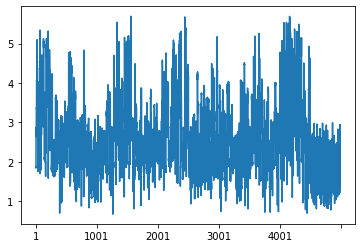

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(993, 2)


,variable,importance
163,ward_count_children_precovid_m,0.017127
81,count_register_race_coloured,0.014325
142,ward_fee_m,0.014132
144,ward_subsidy_m,0.013099
172,dc_meals_m,0.012879
26,pri_fees_amount,0.012861
188,dc_count_children_precovid_m,0.012716
196,mn_toilet_1_m,0.012636
193,mn_water_tap_m,0.012629
162,ward_count_children_usual_m,0.012451


In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_total_elom_dc', drop_to_refine_significant_vars_total_elom_facility )


(6612, 1628)
(4994, 1405)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

### 2021

In [ ]:
# PD_1_INT_total_elom_CHILD_df = Penultimate_df.copy()
PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df[PD_1_INT_total_elom_CHILD_df['data_year'] > 2019  ]
# print(PD_1_INT_total_elom_CHILD_df.shape)
# PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df.dropna(axis = 1, how = 'all')
# PD_1_INT_total_elom_CHILD_df


# Y = PD_1_INT_total_elom_CHILD_df['PD_1_INT_total_elom_CHILD']

# X = PD_1_INT_total_elom_CHILD_df.drop(columns = 'PD_1_INT_total_elom_CHILD')
# X = drop_cols_with_substring(X, ['child_score_', 
#                                                     'child_domain_',
#                                                     '_domain_'
#                                                     ])
# X.head(3)
PD_1_INT_total_elom_CHILD_df

,child_age,child_score_item_1,child_score_item_2,child_score_item_3,child_score_item_4,child_domain_1,child_score_item_5,child_score_item_6,child_score_item_7,child_score_item_8,...,child_total_elom_cuts,child_domain_1_cuts,child_domain_2_cuts,child_domain_3_cuts,child_domain_4_cuts,child_domain_5_cuts,data_year,child_date,child_dob,id_cluster_original
0,0.473684,1.000000,0.576602,0.000000,0.590278,0.4615,1.000000,1.0,0.795359,0.695988,...,3,3,3,3,3,3,2021,1.634515e+09,1.478650e+09,347.0
1,0.421053,1.000000,0.278552,0.352381,0.590278,0.5190,1.000000,1.0,1.000000,0.822531,...,3,3,3,3,3,3,2021,1.634515e+09,1.480291e+09,347.0
2,0.421053,1.000000,0.576602,0.000000,0.363889,0.3800,0.740476,0.0,0.795359,0.609568,...,2,2,2,1,3,2,2021,1.634515e+09,1.479686e+09,347.0
3,0.368421,1.000000,0.000000,0.352381,0.000000,0.2565,1.000000,1.0,0.658228,0.526235,...,3,1,3,3,3,2,2021,1.634515e+09,1.482278e+09,347.0
4,0.210526,1.000000,1.000000,0.352381,0.363889,0.5670,0.740476,0.0,0.795359,0.424383,...,3,3,1,2,2,3,2021,1.635120e+09,1.492474e+09,367.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11813,0.263158,0.467354,0.000000,0.352381,0.363889,0.3100,1.000000,0.0,0.795359,0.526235,...,2,2,2,1,3,3,2021,1.634083e+09,1.487030e+09,318.0
11816,0.052632,1.000000,0.000000,0.352381,0.000000,0.2565,0.000000,0.0,0.658228,0.424383,...,1,1,1,1,1,1,2021,1.636589e+09,1.501114e+09,321.0
11817,0.263158,1.000000,0.576602,0.000000,1.000000,0.6090,1.000000,0.0,0.795359,0.526235,...,3,3,2,3,3,3,2021,1.632182e+09,1.485216e+09,8.0
11818,0.315789,1.000000,0.278552,0.352381,0.363889,0.4375,1.000000,0.0,0.795359,0.609568,...,3,3,2,3,3,3,2021,1.633997e+09,1.486598e+09,108.0


#### Loop Refine variables

In [ ]:
drop_to_refine_significant_vars = ['child_score_',
                                   'child_domain_',
                                   '_domain_',
                                   'child_total_elom',

                                   'PD_2_MV_',
                                   'PD_2_UV',
                                   
                                   'PD_2_INT_CHILD',
                                   'PD_2_UV_CHILD',
                                   'PD_1_UV_total_elom_facility',
                                   'child_total_elom_cuts',
                                   'PD_1_MV_total_elom_facility',
                                   'PD_4_MV_composite_facility',
                                   'PD_3_UV_pc_ontrack_facility',
                                   'PD_2',
                                   'PD_3',
                                   'PD_4',
                                   'PD_1_MV_CHILD',
                                   'PD_1_UV_CHILD',
                                   'PD_1_INT_total_facility',
                                

                                 # 64
# 'id_enumerator',
# 'id_ward',
# 'id_team',
#32
# 'id_facility',
# 'id_ward_n',
# 'id_mn_n',
# 'id_dc_n',
# 'id_prov_n',
# 
# 'latitude',
'child_observe_total',
#EconML

# 'id_cluster_original',
# 'child_date',
# 'longitude',
# 'child_dob',
'PD_1_INT_total_elom_facility',
'PD_1_INT_total_elom_mn',
'PD_1_MV_total_elom_mn'
]

In [ ]:
controls = [
    # 'id_enumerator',
'id_ward',
'id_team',
#32
'id_facility',
'id_ward_n',
'id_mn_n',
'id_dc_n',
'id_prov_n',
'child_date',
'child_dob',
'ses_proxy',
'child_age',
'quintile',
'ward_best',
'phase_natemis_COMBINED SCHOOL',
'child_gender',
'longitude',
'latitude',
'id_cluster_original'
]

,child_age,child_months_enrolment,child_height,child_sample_wgt,child_age_w2,child_height_w2,ward_best,id_enumerator,pqa_class_assistants,pqa_score_environment,...,certificate_register,plan,rating,gr_1_tt,ses_cat,data_year,child_date,child_enrolment_date,child_dob,id_cluster_original
0,0.473684,0.368421,0.533755,0.021534,NaN,NaN,0.024194,0.138049,NaN,NaN,...,NaN,NaN,NaN,NaN,2.0,2021,1.634515e+09,1.578874e+09,1.478650e+09,347.0
1,0.421053,0.368421,0.517933,0.021534,NaN,NaN,0.024194,0.138049,NaN,NaN,...,NaN,NaN,NaN,NaN,2.0,2021,1.634515e+09,1.579306e+09,1.480291e+09,347.0
2,0.421053,0.350877,0.495781,0.021534,NaN,NaN,0.024194,0.138049,NaN,NaN,...,NaN,NaN,NaN,NaN,2.0,2021,1.634515e+09,1.581725e+09,1.479686e+09,347.0
3,0.368421,0.333333,0.487342,0.021534,NaN,NaN,0.024194,0.138049,NaN,NaN,...,NaN,NaN,NaN,NaN,2.0,2021,1.634515e+09,1.581984e+09,1.482278e+09,347.0
4,0.210526,0.140351,0.477848,0.108464,NaN,NaN,0.177419,0.138049,NaN,NaN,...,NaN,NaN,NaN,NaN,3.0,2021,1.635120e+09,1.612138e+09,1.492474e+09,367.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11813,0.263158,0.140351,0.483122,0.059864,NaN,NaN,0.556452,0.133071,0.2,0.416667,...,3.0,1.0,NaN,NaN,4.0,2021,1.634083e+09,1.613002e+09,1.487030e+09,318.0
11816,0.052632,0.175439,0.437764,0.198409,NaN,NaN,0.556452,0.147956,0.2,0.500000,...,3.0,2.0,NaN,NaN,4.0,2021,1.636589e+09,1.609718e+09,1.501114e+09,321.0
11817,0.263158,NaN,0.466245,0.063104,NaN,NaN,0.193548,0.028327,0.2,0.750000,...,2.0,1.0,NaN,NaN,5.0,2021,1.632182e+09,NaN,1.485216e+09,8.0
11818,0.315789,0.140351,0.483650,0.015935,NaN,NaN,0.032258,0.135212,NaN,NaN,...,NaN,NaN,NaN,NaN,4.0,2021,1.633997e+09,1.612138e+09,1.486598e+09,108.0


In [ ]:
PD_1_INT_total_elom_CHILD_df = Penultimate_df.copy()
PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df[PD_1_INT_total_elom_CHILD_df['data_year'] == 2021]
print(PD_1_INT_total_elom_CHILD_df.shape)
PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df.dropna(axis = 1, how = 'all')
PD_1_INT_total_elom_CHILD_df


PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df.dropna(subset = ['id_cluster_original'])

Y = PD_1_INT_total_elom_CHILD_df['PD_1_INT_total_elom_CHILD']

X = PD_1_INT_total_elom_CHILD_df.drop(columns = ['PD_1_INT_total_elom_CHILD'])
print(X.shape)
X = drop_cols_with_substring(X, drop_to_refine_significant_vars )


clusters = X['id_cluster_original']
X = X.drop(columns = ['id_cluster_original'])
clusters = clusters.to_numpy()
clusters = pd.Series(clusters) 

X.head(3)

##### R

###### Regression Forrest

In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

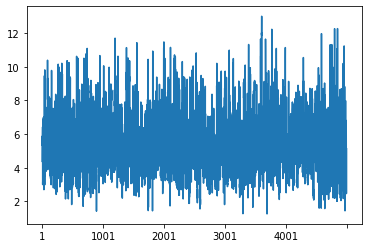

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1243, 2)


,variable,importance
140,child_zha,0.014247
66,count_children_precovid,0.011401
3,child_height,0.010057
151,teacher_emotional_total,0.009948
4,child_sample_wgt,0.009003
175,ward_count_staff_cat_prac_m,0.008961
173,ward_count_children_precovid_m,0.008483
203,mn_water_tap_m,0.008304
225,mn_count_staff_cat_prac_m,0.008203
90,count_register_race,0.007814


In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1233, 2)


,variable,importance
64,count_children_precovid,0.012962
136,child_zha,0.012625
63,count_children_attendance,0.010868
23,pri_year,0.010100
1231,child_date,0.008362
87,count_register_race,0.008338
170,ward_count_staff_cat_prac_m,0.007723
3,child_height,0.007605
206,mn_capacity_m,0.007564
146,teacher_emotional_total,0.007443


###### Multi-Regression Forrest

In [ ]:
%%R -i Y,X

rf_multi <- multi_regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE
                         )

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf_multi)
var_names <- data.frame(colnames(X)) 

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
var_importance_df.head(50)

,variable,importance
136,child_zha,0.017698
4,child_sample_wgt,0.011216
146,teacher_emotional_total,0.010670
161,ward_school_m,0.008746
63,count_children_attendance,0.008360
198,mn_water_tap_m,0.008271
1232,child_enrolment_date,0.008123
82,count_register_race_african,0.008112
1231,child_date,0.008076
168,ward_count_children_precovid_m,0.007861


###### multi-arm Forrest???

In [ ]:
%%R
rf_ll <- ll_regression_forest(X, Y,
                               tune.parameters = "all")

In [ ]:
%%R -o var_importance

var_importance <- variable_importance(rf2)

In [ ]:
%%R
plot(get_tree(rf2, index = 1))

In [ ]:
%%R

get_forest_weights(rf2, newdata = NULL, num.threads = NULL)

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
var_importance_df.head(50)

##### Causal Forest

In [ ]:
PD_1_INT_total_elom_CHILD_df = Penultimate_df.copy()
PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df[PD_1_INT_total_elom_CHILD_df['data_year'] == 2021]
print(PD_1_INT_total_elom_CHILD_df.shape)
PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df.dropna(axis = 1, how = 'all')
PD_1_INT_total_elom_CHILD_df


PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df.dropna(subset = ['id_cluster_original'])
PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df.dropna(axis = 1).dropna()

Y = PD_1_INT_total_elom_CHILD_df['PD_1_INT_total_elom_CHILD']

# X = PD_1_INT_total_elom_CHILD_df.drop(columns = ['PD_1_INT_total_elom_CHILD'])
print(X.shape)



X = PD_1_INT_total_elom_CHILD_df[controls]
X = drop_cols_with_substring(X, drop_to_refine_significant_vars )


W = PD_1_INT_total_elom_CHILD_df.drop(columns = ['PD_1_INT_total_elom_CHILD']).drop(columns = controls)

print(X.shape, W.shape)



clusters = X['id_cluster_original']

X = X.drop(columns = ['id_cluster_original'])
clusters = clusters.to_numpy()
clusters = pd.Series(clusters) 

X.head(3)

(6612, 1628)
(4994, 18)
(4994, 18) (4994, 679)


,id_ward,id_team,id_facility,id_ward_n,id_mn_n,id_dc_n,id_prov_n,child_date,child_dob,ses_proxy,child_age,quintile,ward_best,phase_natemis_COMBINED SCHOOL,child_gender,longitude,latitude
0,0.862855,0.235294,0.0,0.127119,0.047733,0.34116,0.451951,1.634515e+09,1.478650e+09,0.25,0.473684,0.25,0.024194,0,2,0.787846,0.683496
1,0.862855,0.235294,0.0,0.127119,0.047733,0.34116,0.451951,1.634515e+09,1.480291e+09,0.25,0.421053,0.25,0.024194,0,2,0.787846,0.683496
2,0.862855,0.235294,0.0,0.127119,0.047733,0.34116,0.451951,1.634515e+09,1.479686e+09,0.25,0.421053,0.25,0.024194,0,1,0.787846,0.683496


In [ ]:
PD_1_INT_total_elom_CHILD_df.drop(columns = ['PD_1_INT_total_elom_CHILD']).drop(columns = controls)

In [ ]:
W.dropna()

In [ ]:
%%R -i Y,X,W,clusters

clusters <- clusters %>% as.matrix()
W <- W %>% as.matrix()
X <- X %>% as.matrix()
Y <- Y %>% as.matrix()

rf2 <- causal_forest(X, Y, W,
                     num.trees = 20,
                         clusters = clusters,
                         equalize.cluster.weights = TRUE
                        #  tune.parameters = "all"
                         )

  Observations (W, Y, Z or D) must be vectors.




Error in validate_observations(W, X) : 
  Observations (W, Y, Z or D) must be vectors.


RInterpreterError: ignored

In [ ]:
causal_forest(
  X,
  Y,
  W,
  Y.hat = NULL,
  W.hat = NULL,
  num.trees = 2000,
  sample.weights = NULL,
  clusters = NULL,
  equalize.cluster.weights = FALSE,
  sample.fraction = 0.5,
  mtry = min(ceiling(sqrt(ncol(X)) + 20), ncol(X)),
  min.node.size = 5,
  honesty = TRUE,
  honesty.fraction = 0.5,
  honesty.prune.leaves = TRUE,
  alpha = 0.05,
  imbalance.penalty = 0,
  stabilize.splits = TRUE,
  ci.group.size = 2,
  tune.parameters = "none",
  tune.num.trees = 200,
  tune.num.reps = 50,
  tune.num.draws = 1000,
  compute.oob.predictions = TRUE,
  num.threads = NULL,
  seed = runif(1, 0, .Machine$integer.max)
)
A

##### EconMl

In [ ]:
PD_1_INT_total_elom_CHILD_df = Penultimate_df.copy()
PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df[PD_1_INT_total_elom_CHILD_df['data_year'] == 2021]
print(PD_1_INT_total_elom_CHILD_df.shape)
PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df.dropna(axis = 1, how = 'all')
PD_1_INT_total_elom_CHILD_df 


PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df.dropna(subset = ['id_cluster_original'])

PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df.dropna(axis = 1).dropna()

Y = PD_1_INT_total_elom_CHILD_df['PD_1_INT_total_elom_CHILD']

X = PD_1_INT_total_elom_CHILD_df.drop(columns = 'PD_1_INT_total_elom_CHILD')
print(X.shape)
X = drop_cols_with_substring(X, drop_to_refine_significant_vars)



clusters = X['id_cluster_original']
X = X.drop(columns = ['id_cluster_original'])
clusters = clusters.to_numpy()
clusters = pd.Series(clusters) 

X.head(3)

(6612, 1628)
(4994, 697)


<Figure size 1080x1800 with 0 Axes>

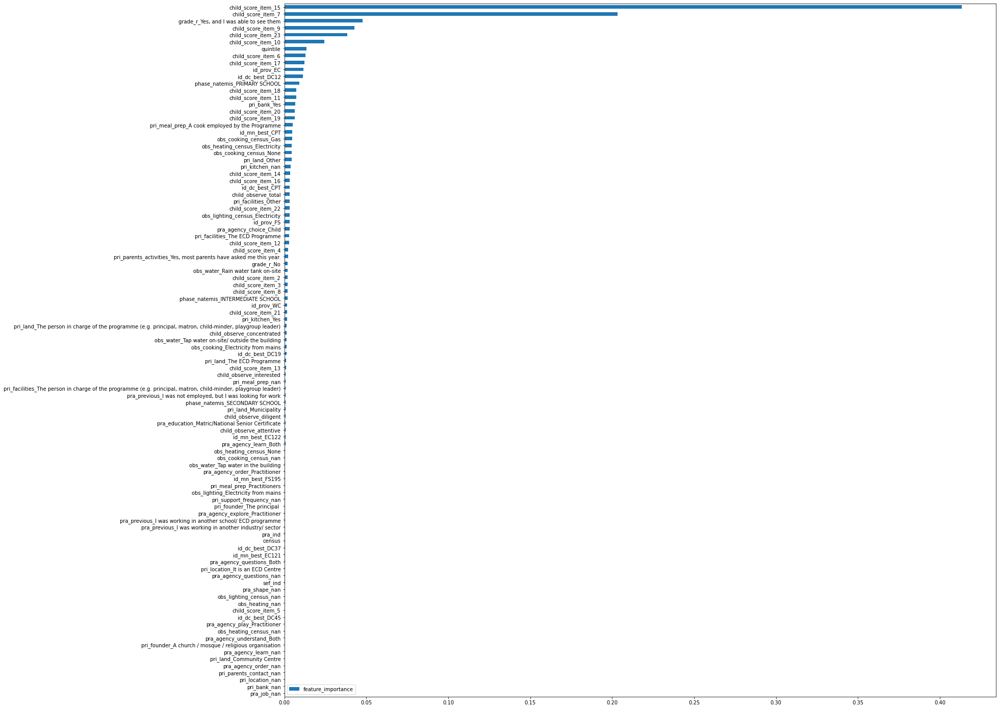

,feature_importance
child_score_item_15,0.413408
child_score_item_7,0.203236
"grade_r_Yes, and I was able to see them",0.047825
child_score_item_9,0.042683
child_score_item_23,0.038262
child_score_item_10,0.024437
quintile,0.013643
child_score_item_6,0.012951
child_score_item_17,0.012247
id_prov_EC,0.011754


100%|===================| 199/200 [00:44<00:00]       

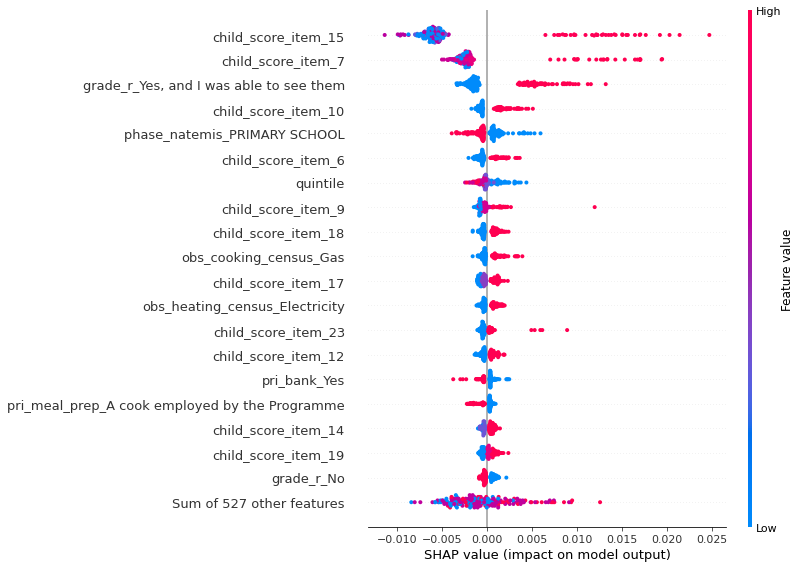

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_total_elom_facility', drop_to_refine_significant_vars_total_elom_facility , dropNa = True)

est = RegressionForest(n_estimators=1000, min_samples_leaf=5, max_depth=None,
                       min_impurity_decrease = 0.0, max_samples=0.45, min_balancedness_tol=.45,
                       warm_start=False, inference=True, subforest_size=4,
                       honest=True, verbose=0, n_jobs=-1, random_state=1235)

est.fit(X, Y)

plt.figure(figsize=(15,25))
# plt.plot(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), X.columns)
# plt.plot()
pd.DataFrame(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), 
             index = X.columns, columns= ['feature_importance']).sort_values('feature_importance', ascending = True).tail(100).plot(
                 kind='barh', figsize = (25,25))
# plt.xticks(rotation = 90)

# plt.bar(= est.feature_importances(max_depth=4, depth_decay_exponent=2.0), y = X.columns, columns= ['feature_importance'])
plt.show()

most_important_vars = pd.DataFrame(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), index = X.columns, columns= ['feature_importance']).sort_values('feature_importance', ascending = False).head(50)
display(most_important_vars)



explainer = shap.Explainer(est, shap.maskers.Independent(X, max_samples=100))

shap_values = explainer(X[:200])
shap.plots.beeswarm(shap_values, max_display=20)

In [ ]:
est = RegressionForest(n_estimators=500, min_samples_leaf=5, max_depth=None,
                       min_impurity_decrease = 0.0, max_samples=0.45, min_balancedness_tol=.45,
                       warm_start=False, inference=True, subforest_size=4,
                       honest=True, verbose=0, n_jobs=-1, random_state=1235)

In [ ]:
est.feature_importances(max_depth=4, depth_decay_exponent=2.0)

In [ ]:
est.fit(X, Y)

RegressionForest(n_estimators=500, random_state=1235)

In [ ]:
plt.figure(figsize=(20,20))
plot_tree(est[399], impurity=True, 
          max_depth=4, 
          feature_names = X.columns,
          filled = True)
plt.show()

In [ ]:
most_important_vars = pd.DataFrame(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), index = X.columns, columns= ['feature_importance']).sort_values('feature_importance', ascending = False).head(50)
most_important_vars

NotFittedError: ignored

<Figure size 1080x1800 with 0 Axes>

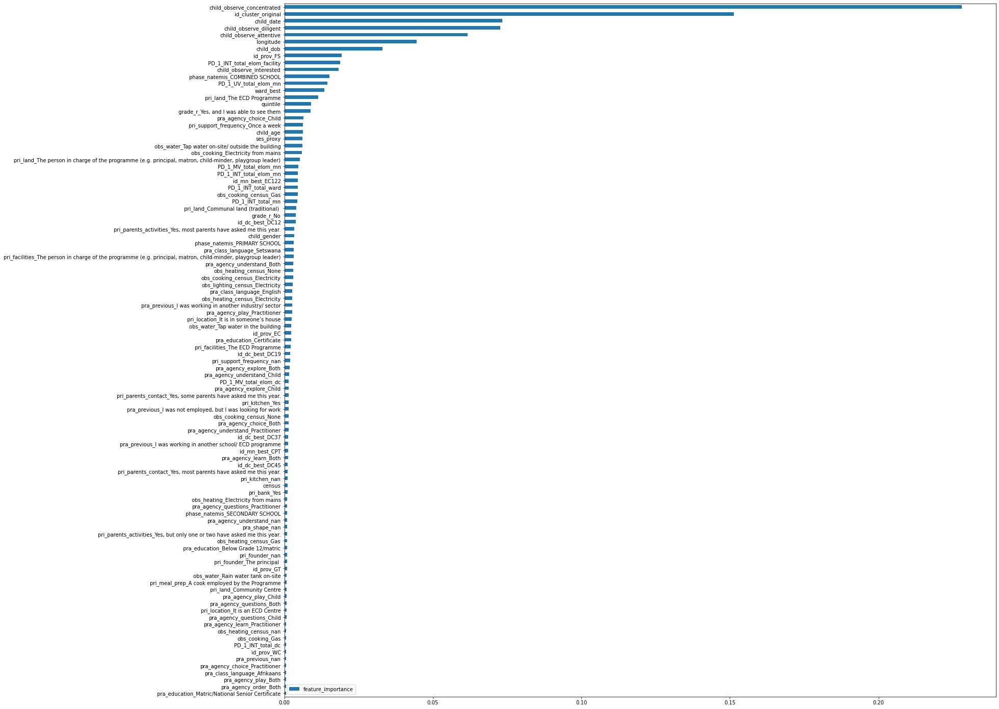

In [ ]:
plt.figure(figsize=(15,25))
# plt.plot(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), X.columns)
# plt.plot()
pd.DataFrame(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), 
             index = X.columns, columns= ['feature_importance']).sort_values('feature_importance', ascending = True).tail(100).plot(
                 kind='barh', figsize = (25,25))
# plt.xticks(rotation = 90)

# plt.bar(= est.feature_importances(max_depth=4, depth_decay_exponent=2.0), y = X.columns, columns= ['feature_importance'])
plt.show()

<Figure size 1080x1800 with 0 Axes>

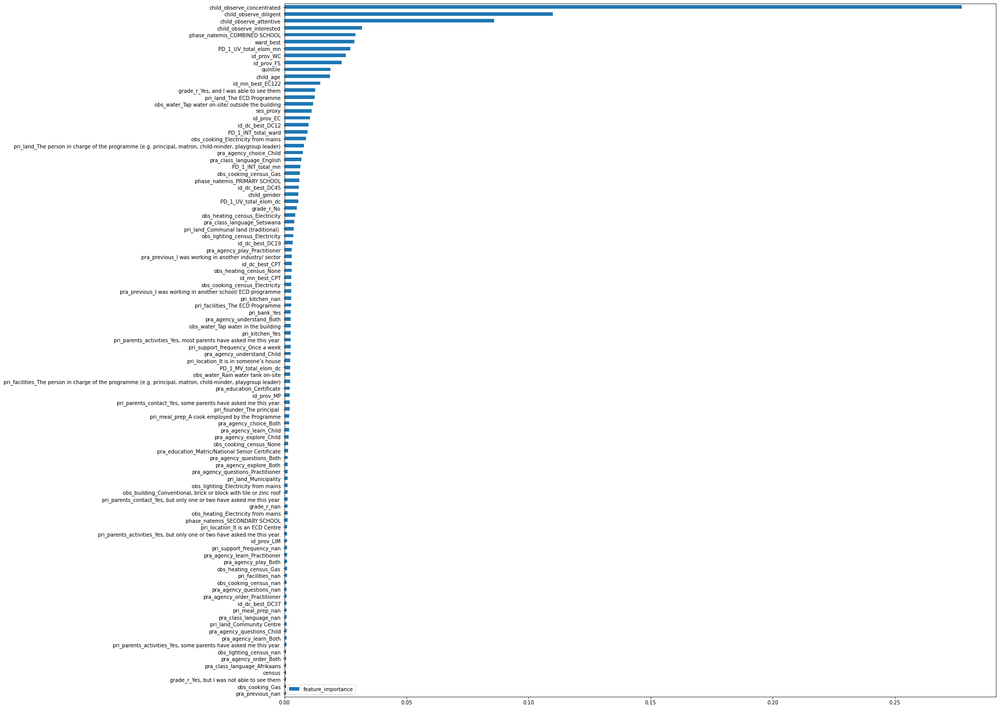

In [ ]:
plt.figure(figsize=(15,25))
# plt.plot(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), X.columns)
# plt.plot()
pd.DataFrame(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), 
             index = X.columns, columns= ['feature_importance']).sort_values('feature_importance', ascending = True).tail(100).plot(
                 kind='barh', figsize = (25,25))
# plt.xticks(rotation = 90)

# plt.bar(= est.feature_importances(max_depth=4, depth_decay_exponent=2.0), y = X.columns, columns= ['feature_importance'])
plt.show()

In [ ]:
explainer = shap.Explainer(est, shap.maskers.Independent(X, max_samples=100))
shap_values = explainer(X[:200])
shap.plots.beeswarm(shap_values, max_display=50)

100%|===================| 4990/4994 [06:04<00:00]       

Exception: ignored

### PD_1_INT_total_elom_facility


In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_total_elom_ward', drop_to_refine_significant_vars_total_elom_facility )


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

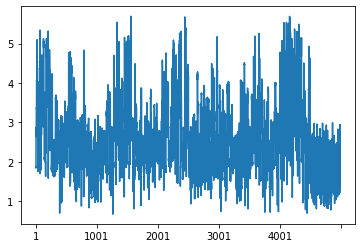

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(993, 2)


,variable,importance
163,ward_count_children_precovid_m,0.017127
81,count_register_race_coloured,0.014325
142,ward_fee_m,0.014132
144,ward_subsidy_m,0.013099
172,dc_meals_m,0.012879
26,pri_fees_amount,0.012861
188,dc_count_children_precovid_m,0.012716
196,mn_toilet_1_m,0.012636
193,mn_water_tap_m,0.012629
162,ward_count_children_usual_m,0.012451


In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_total_elom_dc', drop_to_refine_significant_vars_total_elom_facility )


(6612, 1628)
(4994, 1405)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(6612, 1628)
(4994, 1405)


### 2021

#### Loop Refine variables

In [ ]:
PD_1_INT_total_elom_facility_df = Penultimate_df.copy()
PD_1_INT_total_elom_facility_df = PD_1_INT_total_elom_facility_df[PD_1_INT_total_elom_facility_df['data_year'] == 2021]
print(PD_1_INT_total_elom_facility_df.shape)
PD_1_INT_total_elom_facility_df = PD_1_INT_total_elom_facility_df.dropna(axis = 1, how = 'all')
PD_1_INT_total_elom_facility_df


PD_1_INT_total_elom_facility_df = PD_1_INT_total_elom_facility_df.dropna(subset = ['id_cluster_original'])

Y = PD_1_INT_total_elom_facility_df['PD_1_INT_total_elom_facility']

X = PD_1_INT_total_elom_facility_df.drop(columns = ['PD_1_INT_total_elom_facility'])
print(X.shape)
X = drop_cols_with_substring(X, drop_to_refine_significant_vars_total_elom_facility )


clusters = X['id_cluster_original']
X = X.drop(columns = ['id_cluster_original'])
clusters = clusters.to_numpy()
clusters = pd.Series(clusters) 

X.head(3)

(6612, 1628)
(4994, 1405)


,child_months_enrolment,child_score_item_1,child_score_item_2,child_score_item_3,child_score_item_4,child_score_item_5,child_score_item_6,child_score_item_7,child_score_item_8,child_score_item_9,...,teacher_emotional_adjust,teacher_emotional_confidence,teacher_emotional_selfstarter,certificate_registration_program,certificate_registration_npo,certificate_register,plan,ses_cat,data_year,child_enrolment_date
0,0.368421,1.0,0.576602,0.000000,0.590278,1.000000,1.0,0.795359,0.695988,0.466003,...,1.0,1.0,2.0,NaN,NaN,NaN,NaN,2.0,2021,1.578874e+09
1,0.368421,1.0,0.278552,0.352381,0.590278,1.000000,1.0,1.000000,0.822531,0.671642,...,2.0,2.0,2.0,NaN,NaN,NaN,NaN,2.0,2021,1.579306e+09
2,0.350877,1.0,0.576602,0.000000,0.363889,0.740476,0.0,0.795359,0.609568,0.000000,...,2.0,1.0,1.0,NaN,NaN,NaN,NaN,2.0,2021,1.581725e+09


##### R

###### Regression Forrest

In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

PD_1_INT_total_elom_facility_rf <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o PD_1_INT_total_elom_facility_rf_predictions

PD_1_INT_total_elom_facility_rf_predictions <- predict(PD_1_INT_total_elom_facility_rf, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(PD_1_INT_total_elom_facility_rf, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

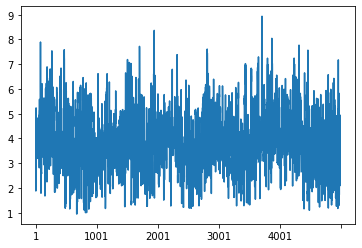

In [ ]:
PD_1_INT_total_elom_facility_rf_predictions_with_se = PD_1_INT_total_elom_facility_rf_predictions['predictions'] / np.sqrt(PD_1_INT_total_elom_facility_rf_predictions['variance.estimates'])
PD_1_INT_total_elom_facility_rf_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1235, 2)


,variable,importance
27,child_sample_wgt,0.014759
16,child_score_item_15,0.013399
235,mn_count_children_usual_m,0.011630
216,mn_water_tap_m,0.011100
103,count_register_race_african,0.010776
233,mn_count_register_all_m,0.010489
108,count_register_race,0.010462
186,ward_count_children_precovid_m,0.009801
189,ward_space_m,0.009598
58,pri_amount_funding_fees,0.009339


###### Multi-Regression Forrest

In [ ]:
%%R -i Y,X

rf_multi <- multi_regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE
                         )

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf_multi)
var_names <- data.frame(colnames(X)) 

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
var_importance_df.head(50)

,variable,importance
136,child_zha,0.017698
4,child_sample_wgt,0.011216
146,teacher_emotional_total,0.010670
161,ward_school_m,0.008746
63,count_children_attendance,0.008360
198,mn_water_tap_m,0.008271
1232,child_enrolment_date,0.008123
82,count_register_race_african,0.008112
1231,child_date,0.008076
168,ward_count_children_precovid_m,0.007861


###### multi-arm Forrest???

In [ ]:
%%R
rf_ll <- ll_regression_forest(X, Y,
                               tune.parameters = "all")

In [ ]:
%%R -o var_importance

var_importance <- variable_importance(rf2)

In [ ]:
%%R
plot(get_tree(rf2, index = 1))

In [ ]:
%%R

get_forest_weights(rf2, newdata = NULL, num.threads = NULL)

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
var_importance_df.head(50)

##### Causal Forest

In [ ]:
PD_1_INT_total_elom_CHILD_df = Penultimate_df.copy()
PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df[PD_1_INT_total_elom_CHILD_df['data_year'] == 2021]
print(PD_1_INT_total_elom_CHILD_df.shape)
PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df.dropna(axis = 1, how = 'all')
PD_1_INT_total_elom_CHILD_df


PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df.dropna(subset = ['id_cluster_original'])
PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df.dropna(axis = 1).dropna()

Y = PD_1_INT_total_elom_CHILD_df['PD_1_INT_total_elom_CHILD']

# X = PD_1_INT_total_elom_CHILD_df.drop(columns = ['PD_1_INT_total_elom_CHILD'])
print(X.shape)



X = PD_1_INT_total_elom_CHILD_df[controls]
X = drop_cols_with_substring(X, drop_to_refine_significant_vars )


W = PD_1_INT_total_elom_CHILD_df.drop(columns = ['PD_1_INT_total_elom_CHILD']).drop(columns = controls)

print(X.shape, W.shape)



clusters = X['id_cluster_original']

X = X.drop(columns = ['id_cluster_original'])
clusters = clusters.to_numpy()
clusters = pd.Series(clusters) 

X.head(3)

(6612, 1628)
(4994, 18)
(4994, 18) (4994, 679)


,id_ward,id_team,id_facility,id_ward_n,id_mn_n,id_dc_n,id_prov_n,child_date,child_dob,ses_proxy,child_age,quintile,ward_best,phase_natemis_COMBINED SCHOOL,child_gender,longitude,latitude
0,0.862855,0.235294,0.0,0.127119,0.047733,0.34116,0.451951,1.634515e+09,1.478650e+09,0.25,0.473684,0.25,0.024194,0,2,0.787846,0.683496
1,0.862855,0.235294,0.0,0.127119,0.047733,0.34116,0.451951,1.634515e+09,1.480291e+09,0.25,0.421053,0.25,0.024194,0,2,0.787846,0.683496
2,0.862855,0.235294,0.0,0.127119,0.047733,0.34116,0.451951,1.634515e+09,1.479686e+09,0.25,0.421053,0.25,0.024194,0,1,0.787846,0.683496


In [ ]:
PD_1_INT_total_elom_CHILD_df.drop(columns = ['PD_1_INT_total_elom_CHILD']).drop(columns = controls)

In [ ]:
W.dropna()

In [ ]:
%%R -i Y,X,W,clusters

clusters <- clusters %>% as.matrix()
W <- W %>% as.matrix()
X <- X %>% as.matrix()
Y <- Y %>% as.matrix()

rf2 <- causal_forest(X, Y, W,
                     num.trees = 20,
                         clusters = clusters,
                         equalize.cluster.weights = TRUE
                        #  tune.parameters = "all"
                         )

  Observations (W, Y, Z or D) must be vectors.




Error in validate_observations(W, X) : 
  Observations (W, Y, Z or D) must be vectors.


RInterpreterError: ignored

In [ ]:
causal_forest(
  X,
  Y,
  W,
  Y.hat = NULL,
  W.hat = NULL,
  num.trees = 2000,
  sample.weights = NULL,
  clusters = NULL,
  equalize.cluster.weights = FALSE,
  sample.fraction = 0.5,
  mtry = min(ceiling(sqrt(ncol(X)) + 20), ncol(X)),
  min.node.size = 5,
  honesty = TRUE,
  honesty.fraction = 0.5,
  honesty.prune.leaves = TRUE,
  alpha = 0.05,
  imbalance.penalty = 0,
  stabilize.splits = TRUE,
  ci.group.size = 2,
  tune.parameters = "none",
  tune.num.trees = 200,
  tune.num.reps = 50,
  tune.num.draws = 1000,
  compute.oob.predictions = TRUE,
  num.threads = NULL,
  seed = runif(1, 0, .Machine$integer.max)
)
A

##### EconMl

In [ ]:
imputed_Data

In [ ]:
X.shape

In [ ]:
X.shape

In [ ]:
PD_1_INT_total_elom_CHILD_df = Penultimate_df.copy()
PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df[PD_1_INT_total_elom_CHILD_df['data_year'] == 2021]
print(PD_1_INT_total_elom_CHILD_df.shape)
PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df.dropna(axis = 1, how = 'all')
PD_1_INT_total_elom_CHILD_df 


PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df.dropna(subset = ['id_cluster_original'])

PD_1_INT_total_elom_CHILD_df = PD_1_INT_total_elom_CHILD_df.dropna(axis = 1).dropna()

Y = PD_1_INT_total_elom_CHILD_df['PD_1_INT_total_elom_CHILD']

X = PD_1_INT_total_elom_CHILD_df.drop(columns = 'PD_1_INT_total_elom_CHILD')
print(X.shape)
X = drop_cols_with_substring(X, drop_to_refine_significant_vars_total_elom_facility)



clusters = X['id_cluster_original']
X = X.drop(columns = ['id_cluster_original'])
clusters = clusters.to_numpy()
clusters = pd.Series(clusters) 

X

(6612, 1628)
(4994, 697)


,child_score_item_1,child_score_item_2,child_score_item_3,child_score_item_4,child_score_item_5,child_score_item_6,child_score_item_7,child_score_item_8,child_score_item_9,child_score_item_10,...,phase_natemis_,phase_natemis_INTERMEDIATE SCHOOL,phase_natemis_PRIMARY SCHOOL,phase_natemis_SECONDARY SCHOOL,phase_natemis_nan,child_observe_attentive,child_observe_concentrated,child_observe_diligent,child_observe_interested,data_year
0,1.000000,0.576602,0.000000,0.590278,1.000000,1.0,0.795359,0.695988,0.466003,0.629712,...,0,0,1,0,0,2.0,2.0,2.0,2.0,2021
1,1.000000,0.278552,0.352381,0.590278,1.000000,1.0,1.000000,0.822531,0.671642,0.629712,...,0,0,1,0,0,2.0,2.0,2.0,2.0,2021
2,1.000000,0.576602,0.000000,0.363889,0.740476,0.0,0.795359,0.609568,0.000000,0.000000,...,0,0,1,0,0,2.0,2.0,2.0,2.0,2021
3,1.000000,0.000000,0.352381,0.000000,1.000000,1.0,0.658228,0.526235,0.466003,0.629712,...,0,0,1,0,0,2.0,2.0,2.0,2.0,2021
4,1.000000,1.000000,0.352381,0.363889,0.740476,0.0,0.795359,0.424383,0.466003,0.000000,...,0,0,0,1,0,2.0,2.0,2.0,2.0,2021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11813,0.467354,0.000000,0.352381,0.363889,1.000000,0.0,0.795359,0.526235,0.000000,0.000000,...,0,0,1,0,0,1.0,1.0,1.0,1.0,2021
11816,1.000000,0.000000,0.352381,0.000000,0.000000,0.0,0.658228,0.424383,0.000000,0.000000,...,0,0,0,1,0,1.0,0.0,1.0,0.0,2021
11817,1.000000,0.576602,0.000000,1.000000,1.000000,0.0,0.795359,0.526235,0.466003,0.629712,...,0,0,1,0,0,2.0,1.0,2.0,3.0,2021
11818,1.000000,0.278552,0.352381,0.363889,1.000000,0.0,0.795359,0.609568,1.000000,0.629712,...,0,0,1,0,0,2.0,2.0,2.0,2.0,2021


In [ ]:
est = RegressionForest(n_estimators=500, min_samples_leaf=5, max_depth=None,
                       min_impurity_decrease = 0.0, max_samples=0.45, min_balancedness_tol=.45,
                       warm_start=False, inference=True, subforest_size=4,
                       honest=True, verbose=0, n_jobs=-1, random_state=1235)

In [ ]:
est.feature_importances(max_depth=4, depth_decay_exponent=2.0)

In [ ]:
est.fit(X, Y)

RegressionForest(n_estimators=500, random_state=1235)

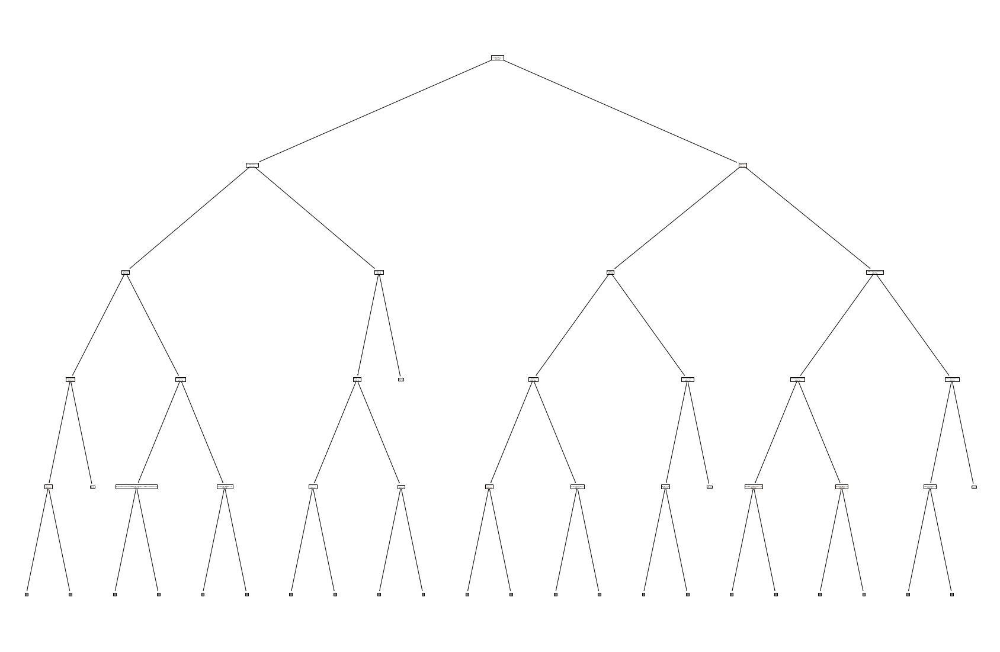

In [ ]:
plt.figure(figsize=(20,20))
plot_tree(est[399], impurity=True, 
          max_depth=4, 
          feature_names = X.columns,
          filled = True)
plt.show()

In [ ]:
pd.DataFrame(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), index = X.columns, columns= ['feature_importance']).sort_values('feature_importance', ascending = False).head(50)

,feature_importance
child_observe_concentrated,0.277494
child_observe_diligent,0.110043
child_observe_attentive,0.085858
child_observe_interested,0.031761
phase_natemis_COMBINED SCHOOL,0.029173
ward_best,0.028616
PD_1_UV_total_elom_mn,0.027116
id_prov_WC,0.025051
id_prov_FS,0.023388
quintile,0.018958


<Figure size 1080x1800 with 0 Axes>

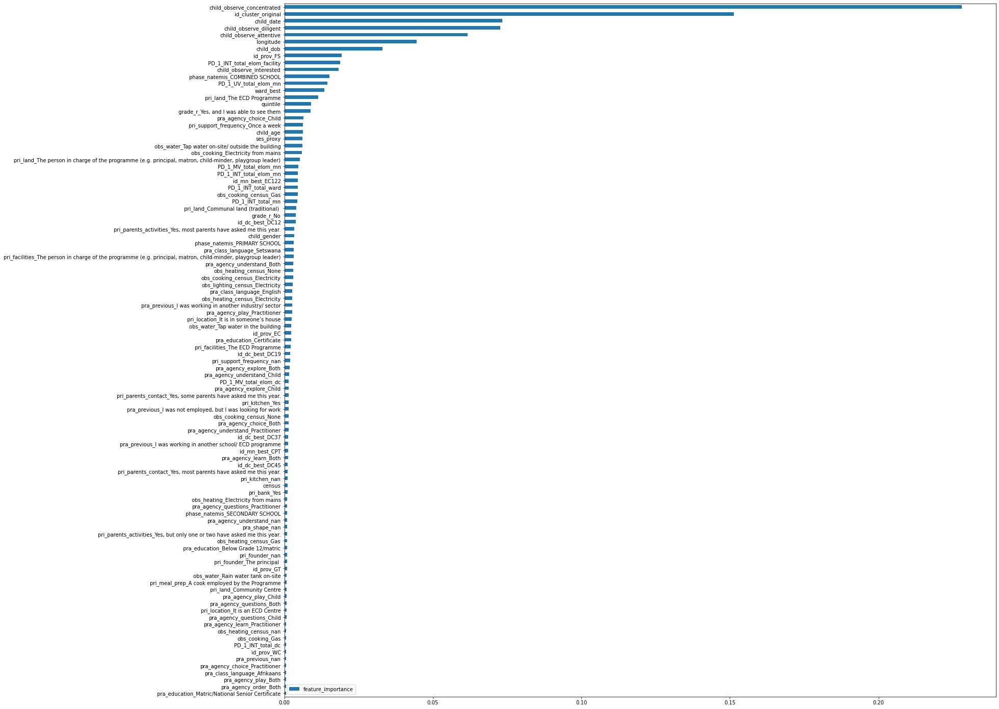

In [ ]:
plt.figure(figsize=(15,25))
# plt.plot(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), X.columns)
# plt.plot()
pd.DataFrame(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), 
             index = X.columns, columns= ['feature_importance']).sort_values('feature_importance', ascending = True).tail(100).plot(
                 kind='barh', figsize = (25,25))
# plt.xticks(rotation = 90)

# plt.bar(= est.feature_importances(max_depth=4, depth_decay_exponent=2.0), y = X.columns, columns= ['feature_importance'])
plt.show()

<Figure size 1080x1800 with 0 Axes>

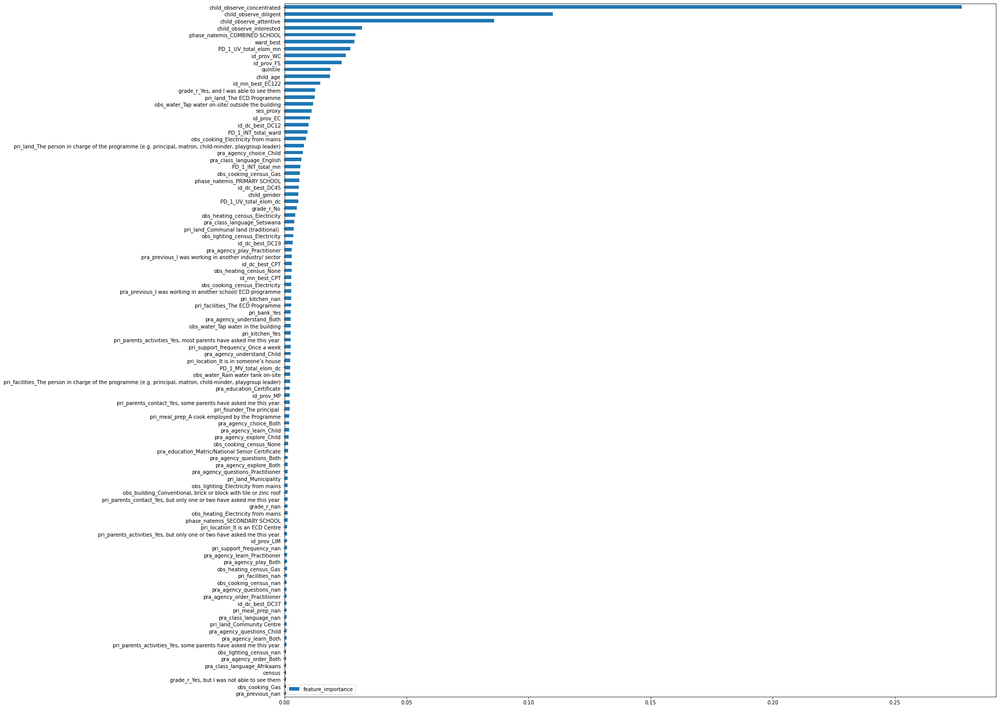

In [ ]:
plt.figure(figsize=(15,25))
# plt.plot(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), X.columns)
# plt.plot()
pd.DataFrame(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), 
             index = X.columns, columns= ['feature_importance']).sort_values('feature_importance', ascending = True).tail(100).plot(
                 kind='barh', figsize = (25,25))
# plt.xticks(rotation = 90)

# plt.bar(= est.feature_importances(max_depth=4, depth_decay_exponent=2.0), y = X.columns, columns= ['feature_importance'])
plt.show()

In [ ]:
explainer = shap.Explainer(est, shap.maskers.Independent(X, max_samples=100))
shap_values = explainer(X[:200])
shap.plots.beeswarm(shap_values, max_display=50)

100%|===================| 4990/4994 [06:04<00:00]       

Exception: ignored

# Eloms

In [ ]:
writer = pd.ExcelWriter(file_path + 'regression_forest_variable_selection_lower3_SES.xlsx', engine='xlsxwriter')


## PD_1_INT_total_elom_CHILD

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_total_elom_CHILD', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1164)
(9984, 1164)
(9984, 1164)
(4505, 1163)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

  The feature matrix X must be numeric. GRF does not currently support non-numeric features. If factor variables are required, we recommend one of the following: Either represent the factor with a 1-vs-all expansion, (e.g., using model.matrix(~. , data=X)), or then encode the factor as a numeric via any natural ordering (e.g., if the factor is a month). For more on GRF and categorical variables see the online vignette: https://grf-labs.github.io/grf/articles/categorical_inputs.html




Error in validate_X(X, allow.na = TRUE) : 
  The feature matrix X must be numeric. GRF does not currently support non-numeric features. If factor variables are required, we recommend one of the following: Either represent the factor with a 1-vs-all expansion, (e.g., using model.matrix(~. , data=X)), or then encode the factor as a numeric via any natural ordering (e.g., if the factor is a month). For more on GRF and categorical variables see the online vignette: https://grf-labs.github.io/grf/articles/categorical_inputs.html


RInterpreterError: ignored

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

  object 'rf2' not found




Error in compute_split_frequencies(forest, max.depth) : 
  object 'rf2' not found


RInterpreterError: ignored

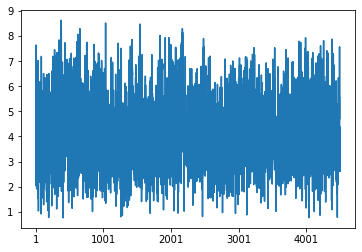

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

NameError: ignored

In [ ]:
# Write each dataframe to a different worksheet.
# var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_total_elom_CHILD')
X

,child_age,child_months_enrolment,child_score_item_1,child_score_item_2,child_score_item_3,child_score_item_4,child_domain_1,child_score_item_5,child_score_item_6,child_score_item_7,...,certificate_registration_npo,certificate_register,plan,rating,gr_1_tt,ses_cat,data_year,child_date,child_enrolment_date,child_dob
0,0.473684,0.368421,1.0,0.576602,0.000000,0.590278,0.4615,1.000000,1.0,0.795359,...,NaN,NaN,NaN,NaN,NaN,2.0,2021,1.634515e+09,1.578874e+09,1.478650e+09
1,0.421053,0.368421,1.0,0.278552,0.352381,0.590278,0.5190,1.000000,1.0,1.000000,...,NaN,NaN,NaN,NaN,NaN,2.0,2021,1.634515e+09,1.579306e+09,1.480291e+09
2,0.421053,0.350877,1.0,0.576602,0.000000,0.363889,0.3800,0.740476,0.0,0.795359,...,NaN,NaN,NaN,NaN,NaN,2.0,2021,1.634515e+09,1.581725e+09,1.479686e+09
3,0.368421,0.333333,1.0,0.000000,0.352381,0.000000,0.2565,1.000000,1.0,0.658228,...,NaN,NaN,NaN,NaN,NaN,2.0,2021,1.634515e+09,1.581984e+09,1.482278e+09
4,0.210526,0.140351,1.0,1.000000,0.352381,0.363889,0.5670,0.740476,0.0,0.795359,...,NaN,NaN,NaN,NaN,NaN,3.0,2021,1.635120e+09,1.612138e+09,1.492474e+09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9956,0.105263,0.000000,1.0,1.000000,0.352381,0.590278,0.6485,1.000000,0.0,0.658228,...,NaN,NaN,NaN,NaN,NaN,3.0,2021,1.635898e+09,1.635898e+09,1.498003e+09
9957,0.473684,0.350877,1.0,0.576602,0.585714,0.000000,0.4335,1.000000,0.0,0.795359,...,NaN,NaN,NaN,NaN,NaN,3.0,2021,1.635898e+09,1.581725e+09,1.479600e+09
9958,0.473684,0.350877,1.0,1.000000,1.000000,1.000000,1.0000,1.000000,0.0,0.658228,...,NaN,NaN,NaN,NaN,NaN,3.0,2021,1.635898e+09,1.581638e+09,1.479946e+09
9959,0.473684,0.719298,1.0,0.278552,0.352381,0.363889,0.4375,1.000000,1.0,1.000000,...,NaN,NaN,NaN,NaN,NaN,3.0,2021,1.635898e+09,1.527984e+09,1.479773e+09


In [ ]:
important_vars_for_imputation = var_importance_df.head(50).variable.to_list()
df_for_imputation = X[important_vars_for_imputation]

     child_total_elom PD_1_MV_CHILD PD_1_UV_CHILD PD_2_MV_CHILD PD_4_MV_CHILD
     PD_2_UV_CHILD PD_4_INT_CHILD child_domain_4 child_domain_3 PD_4_UV_CHILD
     child_domain_5 child_domain_2 PD_2_INT_CHILD child_score_item_15
     child_domain_1 PD_1_UV_domain_4_CHILD child_score_item_9
     PD_1_INT_domain_4_CHILD PD_1_MV_domain_4_CHILD PD_1_UV_domain_5_CHILD
     PD_1_UV_domain_3_CHILD child_score_item_19 child_score_item_4
     PD_1_UV_domain_1_CHILD child_domain_2_cuts PD_1_INT_domain_3_CHILD
     PD_1_INT_total_facility child_score_item_6 child_date
     PD_1_MV_domain_3_CHILD child_observe_total PD_1_UV_domain_2_CHILD
     child_domain_3_cuts child_score_item_21 child_score_item_23
     child_score_item_17 child_score_item_7 child_zha child_sample_wgt
     PD_2_UV_pc_all_ontrack_facility PD_1_MV_total_elom_facility
     PD_1_UV_domain_3_facility PD_2_MV_pc_all_ontrack_facility
     count_register_year_grader count_register_year_2016 dc_meals_m
     ward_count_children_present_m c

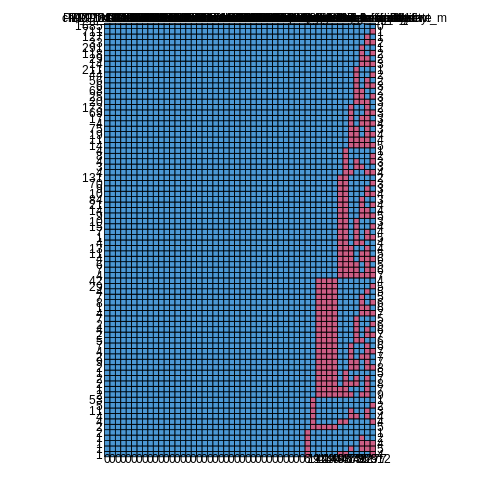

In [ ]:
%%R -i df_for_imputation


md.pattern(df_for_imputation)
# important_vars_for_imputation


 Variables sorted by number of missings: 
                      Variable     Count
          child_enrolment_date 0.2834628
              ward_fees_free_m 0.1840178
        count_toilets_children 0.1769145
 ward_count_children_present_m 0.1440622
                    dc_meals_m 0.1054384
 [ reached 'max' / getOption("max.print") -- omitted 45 rows ]


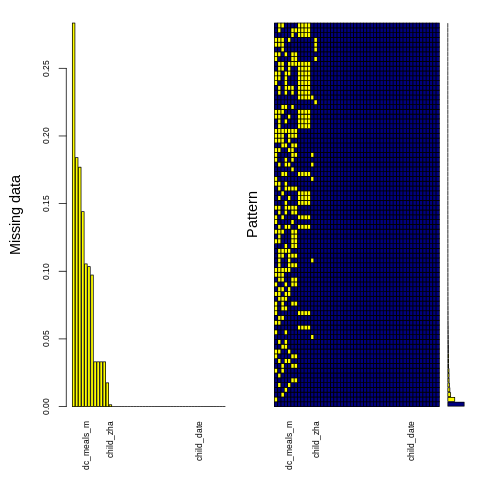

In [ ]:
%%R
 mice_plot <- aggr(df_for_imputation, col=c('navyblue','yellow'),
                    numbers=TRUE, sortVars=TRUE,
                    labels=names(df_for_imputation), cex.axis=.7,
                    gap=3, ylab=c("Missing data","Pattern"))

In [ ]:
%%R
imputed_Data <- mice(df_for_imputation, m=5, maxit = 5, method = 'rf', seed = 500)
summary(imputed_Data)


 iter imp variable
  1   1  PD_2_UV_pc_all_ontrack_facility  count_toilets_children  child_enrolment_date  ward_fees_free_m  child_sample_wgt  PD_1_MV_total_elom_facility  ward_count_children_present_m  PD_1_UV_domain_3_facility  PD_2_MV_pc_all_ontrack_facility  count_register_year_grader  child_zha  dc_meals_m  count_register_year_2016
  1   2  PD_2_UV_pc_all_ontrack_facility  count_toilets_children  child_enrolment_date  ward_fees_free_m  child_sample_wgt  PD_1_MV_total_elom_facility  ward_count_children_present_m  PD_1_UV_domain_3_facility  PD_2_MV_pc_all_ontrack_facility  count_register_year_grader  child_zha  dc_meals_m  count_register_year_2016
  1   3  PD_2_UV_pc_all_ontrack_facility  count_toilets_children  child_enrolment_date  ward_fees_free_m  child_sample_wgt  PD_1_MV_total_elom_facility  ward_count_children_present_m  PD_1_UV_domain_3_facility  PD_2_MV_pc_all_ontrack_facility  count_register_year_grader  child_zha  dc_meals_m  count_register_year_2016
  1   4  PD_2_UV_pc_

In [ ]:
%%R -o imputed_Data
imputed_Data <- imputed_Data %>% as.data.frame()

  cannot coerce class ‘"mids"’ to a data.frame


 

 





Error in as.data.frame.default(.) : 
  cannot coerce class ‘"mids"’ to a data.frame


RInterpreterError: ignored

## PD_1_INT_total_elom_facility


In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_total_elom_facility', drop_to_refine_significant_vars_total_elom_facility )


NameError: ignored

In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

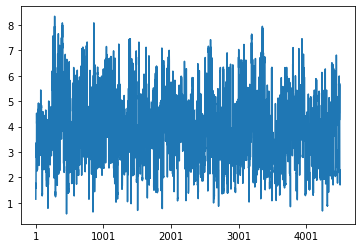

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
236,PD_1_INT_total_facility,0.021684
947,PD_1_MV_total_elom_facility,0.020253
948,PD_4_MV_composite_facility,0.019876
378,PD_4_INT_composite_facility,0.019416
903,PD_1_UV_total_elom_facility,0.015764
898,PD_1_UV_domain_4_facility,0.015711
899,PD_1_UV_domain_3_facility,0.014052
373,PD_1_INT_domain_3_facility,0.013635
372,PD_1_INT_domain_2_facility,0.013420
942,PD_1_MV_domain_4_facility,0.012991


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_total_elom_facility')


## PD_1_INT_total_elom_ward


In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_total_elom_ward', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

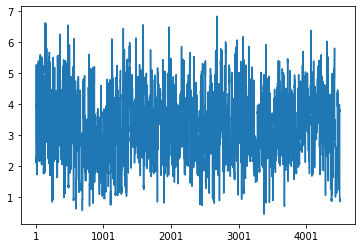

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
237,PD_1_INT_total_ward,0.022746
912,PD_1_UV_total_elom_ward,0.019592
956,PD_1_MV_total_elom_ward,0.019066
952,PD_1_MV_domain_3_ward,0.016608
907,PD_1_UV_domain_4_ward,0.015895
382,PD_1_INT_domain_3_ward,0.015258
259,ward_books_m,0.014795
953,PD_1_MV_domain_5_ward,0.014547
147,id_ward,0.013549
383,PD_1_INT_domain_4_ward,0.012652


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_total_elom_ward')



## PD_1_INT_total_elom_dc

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_total_elom_dc', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.004923876


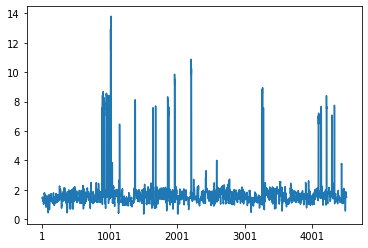

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
239,PD_1_INT_total_dc,0.025782
154,longitude,0.025054
1449,id_dc_best_CPT,0.023905
392,PD_1_INT_domain_4_dc,0.023332
391,PD_1_INT_domain_3_dc,0.021270
355,id_mn_n,0.020742
290,dc_firstaid_m,0.019916
356,id_dc_n,0.018576
1279,id_mn_best_CPT,0.017620
278,dc_toilet_1_m,0.017303


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_total_elom_dc')


## PD_1_INT_total_elom_mn

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_total_elom_mn', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.02782482


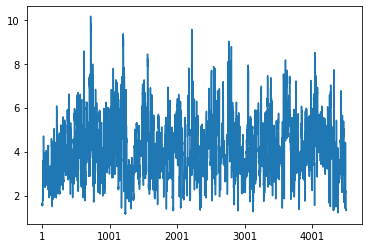

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
930,PD_1_UV_total_elom_mn,0.033295
238,PD_1_INT_total_mn,0.030114
974,PD_1_MV_total_elom_mn,0.027353
969,PD_1_MV_domain_4_mn,0.025031
968,PD_1_MV_domain_2_mn,0.024236
924,PD_1_UV_domain_2_mn,0.023682
931,PD_4_UV_composite_mn,0.022446
306,mn_fees_free_m,0.015595
399,PD_1_INT_domain_2_mn,0.015441
154,longitude,0.014765


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_total_elom_mn')


## PD_1_INT_total_facility

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_total_facility', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.004191579


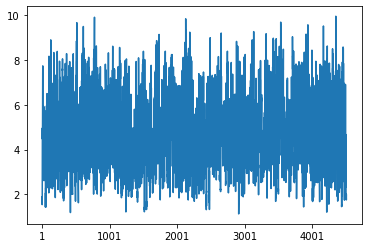

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
904,PD_4_UV_composite_facility,0.028105
902,PD_3_UV_pc_ontrack_facility,0.022692
948,PD_4_MV_composite_facility,0.022337
33,child_total_elom,0.021615
898,PD_1_UV_domain_4_facility,0.018191
899,PD_1_UV_domain_3_facility,0.018079
903,PD_1_UV_total_elom_facility,0.017146
947,PD_1_MV_total_elom_facility,0.016880
374,PD_1_INT_domain_4_facility,0.016372
378,PD_4_INT_composite_facility,0.016252


In [ ]:

# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_total_facility')


## PD_1_INT_total_ward

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_total_ward', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.005316963


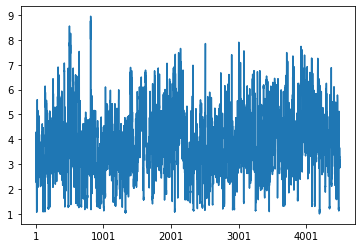

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
953,PD_1_MV_domain_5_ward,0.012649
950,PD_1_MV_domain_2_ward,0.011972
952,PD_1_MV_domain_3_ward,0.011844
908,PD_1_UV_domain_3_ward,0.010530
909,PD_1_UV_domain_5_ward,0.009048
326,prov_transport_m,0.008904
913,PD_4_UV_composite_ward,0.008445
153,latitude,0.008282
147,id_ward,0.008144
323,prov_fee_m,0.007730


In [ ]:

# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_total_ward')

## PD_1_INT_total_mn

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_total_mn', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.007247354


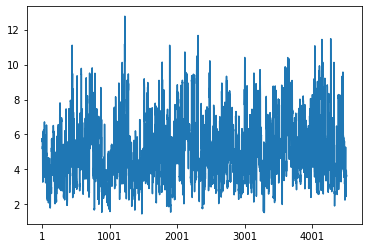

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
974,PD_1_MV_total_elom_mn,0.033366
968,PD_1_MV_domain_2_mn,0.030196
969,PD_1_MV_domain_4_mn,0.024669
926,PD_1_UV_domain_3_mn,0.022762
930,PD_1_UV_total_elom_mn,0.021557
925,PD_1_UV_domain_4_mn,0.018219
931,PD_4_UV_composite_mn,0.016851
970,PD_1_MV_domain_3_mn,0.016826
399,PD_1_INT_domain_2_mn,0.016432
401,PD_1_INT_domain_4_mn,0.016370


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_total_mn')


## PD_1_INT_total_dc

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_total_dc', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.00820362


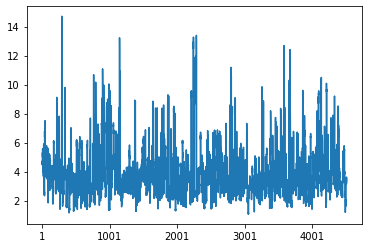

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
355,id_dc_n,0.029343
965,PD_1_MV_total_elom_dc,0.026079
314,mn_firstaid_m,0.024693
154,longitude,0.022150
274,dc_water_tap_m,0.021587
914,PD_1_UV_domain_1_dc,0.021228
918,PD_1_UV_domain_5_dc,0.020959
927,PD_1_UV_domain_5_mn,0.020499
153,latitude,0.020320
289,dc_firstaid_m,0.019465


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_total_dc')


# Domains

In [ ]:
# writer = pd.ExcelWriter('regression_forest_domains_variable_selection.xlsx', engine='xlsxwriter')


## PD_1_INT_domain_1_CHILD

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_1_CHILD', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.0194801


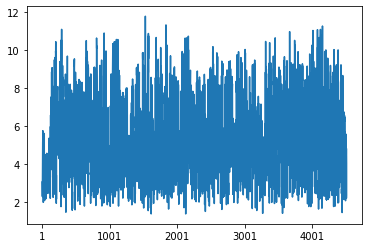

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
7,child_domain_1,0.033780
6,child_score_item_4,0.023473
889,PD_1_UV_domain_1_CHILD,0.023092
933,PD_1_MV_domain_1_CHILD,0.021979
5,child_score_item_3,0.021719
33,child_total_elom,0.017536
896,PD_1_UV_domain_1_facility,0.014490
940,PD_1_MV_domain_1_facility,0.009294
233,child_zha,0.007664
1626,child_dob,0.006200


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_1_CHILD')


## PD_1_INT_domain_2_CHILD

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_2_CHILD', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.01611371


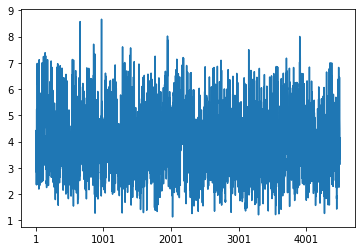

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
12,child_domain_2,0.016598
890,PD_1_UV_domain_2_CHILD,0.015908
33,child_total_elom,0.012403
11,child_score_item_8,0.011097
934,PD_1_MV_domain_2_CHILD,0.010802
23,child_domain_4,0.010117
1512,child_domain_2_cuts,0.009716
897,PD_1_UV_domain_2_facility,0.009045
18,child_domain_3,0.009030
939,PD_4_MV_CHILD,0.008911


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_2_CHILD')


## PD_1_INT_domain_3_CHILD

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_3_CHILD', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.02098483


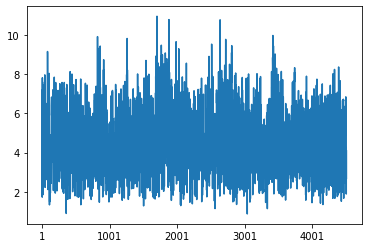

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
18,child_domain_3,0.032098
33,child_total_elom,0.029502
891,PD_1_UV_domain_3_CHILD,0.028043
13,child_score_item_9,0.021526
23,child_domain_4,0.021266
14,child_score_item_10,0.020080
935,PD_1_MV_domain_3_CHILD,0.016224
20,child_score_item_15,0.014853
30,child_domain_5,0.012923
892,PD_1_UV_domain_4_CHILD,0.012354


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_3_CHILD')


## PD_1_INT_domain_4_CHILD

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_4_CHILD', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.01767574


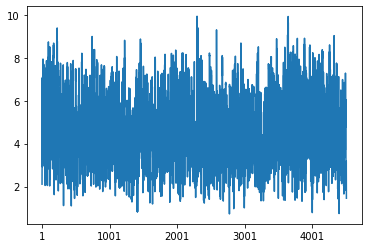

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
23,child_domain_4,0.029915
936,PD_1_MV_domain_4_CHILD,0.028944
33,child_total_elom,0.021797
892,PD_1_UV_domain_4_CHILD,0.020791
20,child_score_item_15,0.019280
895,PD_4_UV_CHILD,0.015427
18,child_domain_3,0.014156
939,PD_4_MV_CHILD,0.014004
932,PD_1_MV_CHILD,0.013176
369,PD_4_INT_CHILD,0.012643


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_4_CHILD')


## PD_1_INT_domain_5_CHILD

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_5_CHILD', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.008216281


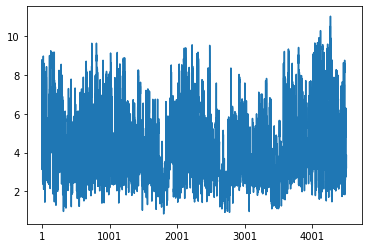

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
30,child_domain_5,0.031998
893,PD_1_UV_domain_5_CHILD,0.022124
33,child_total_elom,0.014231
18,child_domain_3,0.010451
98,pri_amount_funding_dsd,0.009891
323,mn_space_m,0.008901
280,dc_building_con_m,0.008275
270,ward_count_children_precovid_m,0.008055
171,count_register_race_african,0.007937
244,pra_class_space,0.007766


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_5_CHILD')


## PD_1_INT_domain_1_facility

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_1_facility', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.01453897


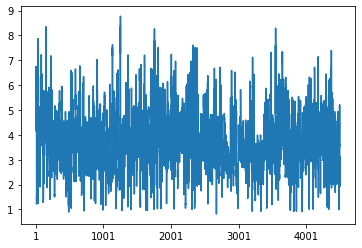

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
896,PD_1_UV_domain_1_facility,0.027907
940,PD_1_MV_domain_1_facility,0.025233
236,PD_1_INT_total_facility,0.024479
7,child_domain_1,0.016058
150,count_children_present,0.009315
889,PD_1_UV_domain_1_CHILD,0.009276
33,child_total_elom,0.008993
305,mn_building_con_m,0.008382
91,pri_year,0.008343
6,child_score_item_4,0.007683


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_1_facility')

## PD_1_INT_domain_2_facility

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_2_facility', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.008458288


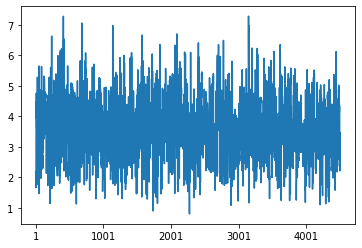

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
236,PD_1_INT_total_facility,0.026215
12,child_domain_2,0.024512
941,PD_1_MV_domain_2_facility,0.021775
899,PD_1_UV_domain_3_facility,0.019894
897,PD_1_UV_domain_2_facility,0.017719
904,PD_4_UV_composite_facility,0.016350
948,PD_4_MV_composite_facility,0.012933
148,count_register_all,0.011921
97,pri_capacity,0.011273
272,ward_count_staff_cat_prac_m,0.010622


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_2_facility')

## PD_1_INT_domain_3_facility

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_3_facility', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.01094533


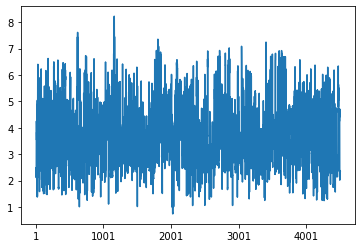

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
236,PD_1_INT_total_facility,0.024510
943,PD_1_MV_domain_3_facility,0.023800
948,PD_4_MV_composite_facility,0.017843
899,PD_1_UV_domain_3_facility,0.016833
18,child_domain_3,0.016769
378,PD_4_INT_composite_facility,0.016256
903,PD_1_UV_total_elom_facility,0.015273
371,PD_1_INT_total_elom_facility,0.012466
947,PD_1_MV_total_elom_facility,0.010606
904,PD_4_UV_composite_facility,0.010483


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_3_facility')


## PD_1_INT_domain_4_facility

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_4_facility', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.01625404


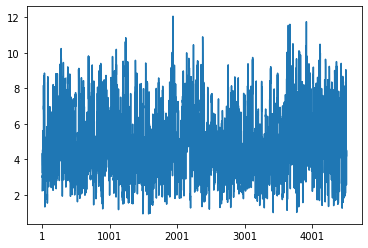

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
898,PD_1_UV_domain_4_facility,0.028694
236,PD_1_INT_total_facility,0.026264
942,PD_1_MV_domain_4_facility,0.026079
904,PD_4_UV_composite_facility,0.024037
23,child_domain_4,0.021318
902,PD_3_UV_pc_ontrack_facility,0.013168
33,child_total_elom,0.012165
892,PD_1_UV_domain_4_CHILD,0.012157
900,PD_1_UV_domain_5_facility,0.009597
30,child_domain_5,0.008838


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_4_facility')


## PD_1_INT_domain_5_facility

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_5_facility', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.01231603


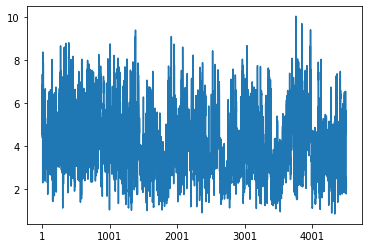

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
900,PD_1_UV_domain_5_facility,0.029212
944,PD_1_MV_domain_5_facility,0.026864
30,child_domain_5,0.022407
236,PD_1_INT_total_facility,0.022151
902,PD_3_UV_pc_ontrack_facility,0.017390
893,PD_1_UV_domain_5_CHILD,0.017063
904,PD_4_UV_composite_facility,0.012945
899,PD_1_UV_domain_3_facility,0.012144
903,PD_1_UV_total_elom_facility,0.011476
298,dc_space_m,0.010682


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_5_facility')


## PD_1_INT_domain_1_ward

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_1_ward', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.01419255


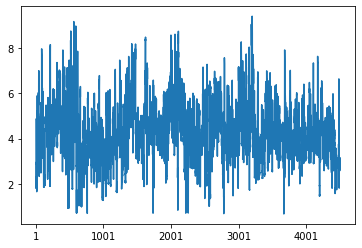

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
949,PD_1_MV_domain_1_ward,0.036324
905,PD_1_UV_domain_1_ward,0.029236
237,PD_1_INT_total_ward,0.027852
356,id_dc_n,0.018622
269,ward_count_children_usual_m,0.016312
238,PD_1_INT_total_mn,0.015843
147,id_ward,0.013861
963,PD_2_MV_pc_all_ontrack_dc,0.012312
281,dc_fees_free_m,0.012269
959,PD_1_MV_domain_2_dc,0.012198


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_1_ward')


## PD_1_INT_domain_2_ward

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_2_ward', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.01680071


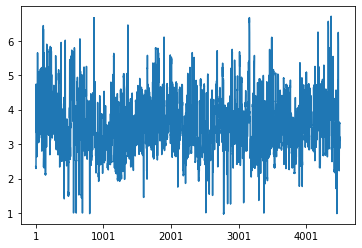

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
950,PD_1_MV_domain_2_ward,0.027006
237,PD_1_INT_total_ward,0.019277
319,mn_count_children_usual_m,0.016879
906,PD_1_UV_domain_2_ward,0.016114
147,id_ward,0.014192
383,PD_1_INT_domain_4_ward,0.012701
317,mn_count_register_all_m,0.012031
252,ward_transport_m,0.011555
907,PD_1_UV_domain_4_ward,0.010547
346,prov_count_staff_cat_educ_m,0.010127


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_2_ward')


## PD_1_INT_domain_3_ward

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_3_ward', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.02050069


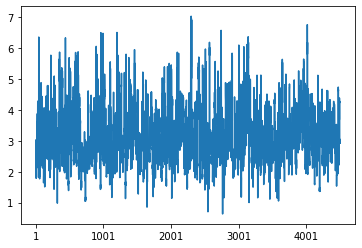

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
237,PD_1_INT_total_ward,0.022333
908,PD_1_UV_domain_3_ward,0.020316
952,PD_1_MV_domain_3_ward,0.020122
913,PD_4_UV_composite_ward,0.012979
297,dc_count_staff_cat_prac_m,0.011126
301,mn_subsidy_m,0.010711
899,PD_1_UV_domain_3_facility,0.009877
320,mn_count_children_precovid_m,0.008221
951,PD_1_MV_domain_4_ward,0.008195
263,ward_school_m,0.008009


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_3_ward')


## PD_1_INT_domain_4_ward

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_4_ward', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.01223233


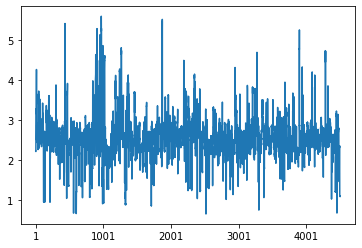

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
237,PD_1_INT_total_ward,0.018849
383,PD_1_INT_domain_3_ward,0.015819
912,PD_1_UV_total_elom_ward,0.015496
956,PD_1_MV_total_elom_ward,0.015404
951,PD_1_MV_domain_4_ward,0.014562
907,PD_1_UV_domain_4_ward,0.014339
952,PD_1_MV_domain_3_ward,0.012465
950,PD_1_MV_domain_2_ward,0.010878
113,pri_fees_amount_0_1,0.010696
387,PD_4_INT_composite_ward,0.010465


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_4_ward')


## PD_1_INT_domain_5_ward

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_5_ward', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.02101438


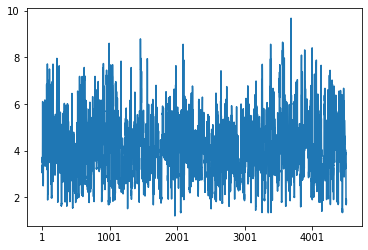

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
237,PD_1_INT_total_ward,0.031814
953,PD_1_MV_domain_5_ward,0.020108
354,id_ward_n,0.011739
909,PD_1_UV_domain_5_ward,0.011287
300,mn_water_tap_m,0.010843
256,ward_fees_free_m,0.009866
911,PD_3_UV_pc_ontrack_ward,0.009489
171,count_register_race_african,0.009149
147,id_ward,0.009135
265,ward_firstaid_m,0.008975


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_5_ward')


## PD_1_INT_domain_1_dc

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_1_dc', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.01389764


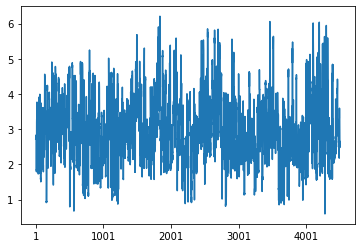

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
958,PD_1_MV_domain_1_dc,0.030124
290,dc_firstaid_m,0.024834
282,dc_registered_dsd_fc_m,0.022952
1494,id_dc_best_JHB,0.022930
289,dc_aftercare_m,0.022353
299,mn_fee_m,0.022145
1321,id_mn_best_JHB,0.021897
239,PD_1_INT_total_dc,0.021458
914,PD_1_UV_domain_1_dc,0.021046
307,mn_registered_dsd_fc_m,0.020075


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_1_dc')


## PD_1_INT_domain_2_dc

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_2_dc', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0


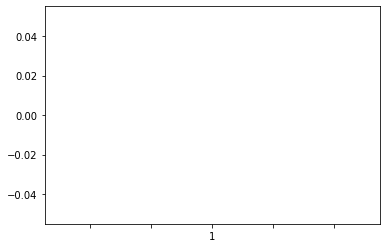

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
1,child_age,0.0
1081,"pri_land_Religious institution (e.g. church, m...",0.0
1091,pri_land_nan,0.0
1090,pri_land_Other,0.0
1089,pri_land_Communal land (traditional),0.0
1088,pri_land_Private business,0.0
1087,pri_land_Another private individual,0.0
1086,pri_land_The person in charge of the programme...,0.0
1085,pri_land_Other government institution (not mun...,0.0
1084,pri_land_Municipality,0.0


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_2_dc')


## PD_1_INT_domain_3_dc

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_3_dc', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.009286743


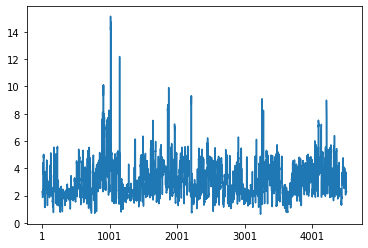

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
275,dc_water_tap_m,0.027059
153,latitude,0.023046
154,longitude,0.022757
277,dc_transport_m,0.020315
239,PD_1_INT_total_dc,0.020165
302,mn_transport_m,0.019533
284,dc_books_m,0.018404
356,id_dc_n,0.018264
355,id_mn_n,0.017515
147,id_ward,0.017008


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_3_dc')


## PD_1_INT_domain_4_dc

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_4_dc', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.006032614


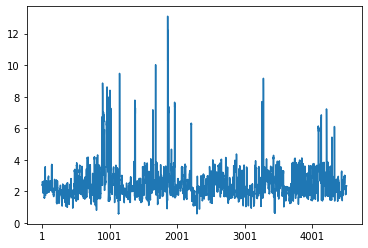

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
154,longitude,0.026146
153,latitude,0.021740
356,id_dc_n,0.021453
921,PD_1_UV_total_elom_dc,0.020721
275,dc_water_tap_m,0.019844
309,mn_books_m,0.019438
355,id_mn_n,0.018418
290,dc_firstaid_m,0.017168
181,id_team,0.017098
357,id_prov_n,0.016632


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_4_dc')


## PD_1_INT_domain_5_dc

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_5_dc', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.01626542


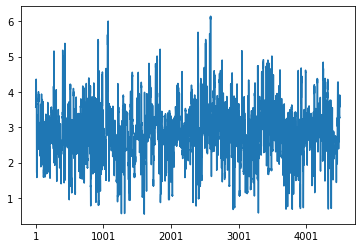

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
918,PD_1_UV_domain_5_dc,0.029038
239,PD_1_INT_total_dc,0.026877
288,dc_school_m,0.026808
965,PD_1_MV_total_elom_dc,0.026567
962,PD_1_MV_domain_5_dc,0.025740
279,dc_meals_m,0.023561
298,dc_space_m,0.023495
356,id_dc_n,0.023408
931,PD_4_UV_composite_mn,0.021036
1442,id_prov_MP,0.019208


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_5_dc')


## PD_1_INT_domain_1_mn

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_1_mn', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.0282695


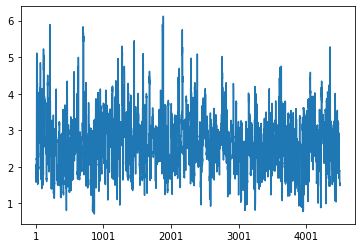

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
967,PD_1_MV_domain_1_mn,0.032855
238,PD_1_INT_total_mn,0.028961
289,dc_aftercare_m,0.023053
279,dc_meals_m,0.021589
300,mn_water_tap_m,0.020176
288,dc_school_m,0.019872
313,mn_school_m,0.015110
277,dc_transport_m,0.015070
309,mn_books_m,0.014262
314,mn_aftercare_m,0.014081


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_1_mn')


## PD_1_INT_domain_2_mn

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_2_mn', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.03221945


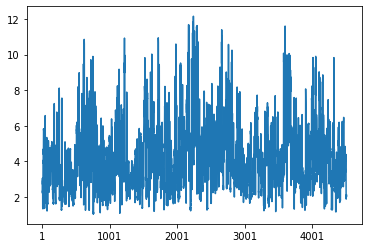

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
924,PD_1_UV_domain_2_mn,0.029514
968,PD_1_MV_domain_2_mn,0.028421
238,PD_1_INT_total_mn,0.028277
154,longitude,0.023621
930,PD_1_UV_total_elom_mn,0.019955
287,dc_separate_m,0.016610
279,dc_meals_m,0.016513
974,PD_1_MV_total_elom_mn,0.015612
291,dc_bank_m,0.014874
401,PD_1_INT_domain_4_mn,0.014642


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_2_mn')


## PD_1_INT_domain_3_mn

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_3_mn', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.02718022


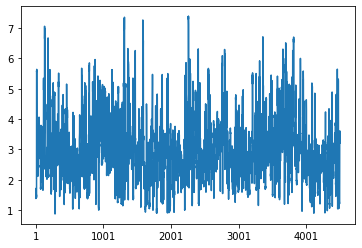

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
970,PD_1_MV_domain_3_mn,0.033639
926,PD_1_UV_domain_3_mn,0.031242
291,dc_bank_m,0.026935
238,PD_1_INT_total_mn,0.026892
286,dc_potable_m,0.023090
323,mn_space_m,0.022029
282,dc_registered_dsd_fc_m,0.018607
307,mn_registered_dsd_fc_m,0.017509
1474,id_dc_best_DC33,0.017173
294,dc_count_children_usual_m,0.014990


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_3_mn')


## PD_1_INT_domain_4_mn

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_4_mn', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.03414072


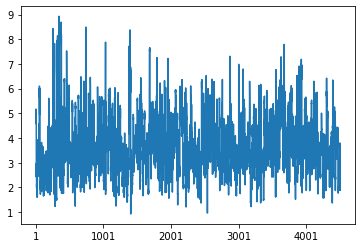

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
974,PD_1_MV_total_elom_mn,0.035445
925,PD_1_UV_domain_4_mn,0.031616
238,PD_1_INT_total_mn,0.026927
969,PD_1_MV_domain_4_mn,0.025817
975,PD_4_MV_composite_mn,0.024365
931,PD_4_UV_composite_mn,0.021185
286,dc_potable_m,0.020567
311,mn_potable_m,0.017455
304,mn_meals_m,0.017192
968,PD_1_MV_domain_2_mn,0.015508


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_4_mn')


## PD_1_INT_domain_5_mn

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_domain_5_mn', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.01856992


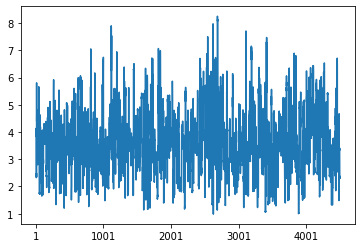

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
971,PD_1_MV_domain_5_mn,0.022941
927,PD_1_UV_domain_5_mn,0.021839
276,dc_subsidy_m,0.019062
238,PD_1_INT_total_mn,0.017326
301,mn_subsidy_m,0.014890
308,mn_capacity_m,0.013392
320,mn_count_children_precovid_m,0.013147
974,PD_1_MV_total_elom_mn,0.012911
305,mn_building_con_m,0.012438
975,PD_4_MV_composite_mn,0.012378


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_domain_5_mn')


## PD_1_INT_total_ward

In [ ]:
X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, 'PD_1_INT_total_ward', drop_to_refine_significant_vars_total_elom_facility )


(11822, 1628)
(9984, 1628)
(9984, 1628)
(4505, 1627)


In [ ]:
%%R -i Y,X,clusters

clusters <- clusters %>% as.matrix()

rf2 <- regression_forest(X, Y, 
                         clusters = clusters,
                         equalize.cluster.weights = TRUE,
                         tune.parameters = "all"
                         )

In [ ]:
%%R -o rf2_predictions

rf2_predictions <- predict(rf2, X, estimate.variance = TRUE, num.trees = 2000)

In [ ]:
%%R -o var_importance,var_names 

var_importance <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.004839084


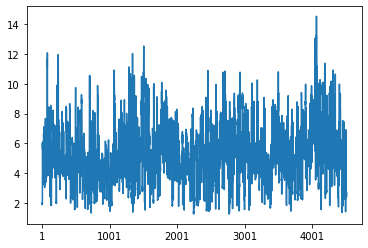

In [ ]:
rf2_predictions_with_se = rf2_predictions['predictions'] / np.sqrt(rf2_predictions['variance.estimates'])
rf2_predictions_with_se.plot()

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
print(var_importance_df.shape)
var_importance_df.head(50)

(1626, 2)


,variable,importance
953,PD_1_MV_domain_5_ward,0.029443
952,PD_1_MV_domain_3_ward,0.020355
951,PD_1_MV_domain_4_ward,0.016864
908,PD_1_UV_domain_3_ward,0.016082
382,PD_1_INT_domain_3_ward,0.016068
153,latitude,0.015745
912,PD_1_UV_total_elom_ward,0.015223
909,PD_1_UV_domain_5_ward,0.014508
956,PD_1_MV_total_elom_ward,0.013665
384,PD_1_INT_domain_5_ward,0.010891


In [ ]:
# Write each dataframe to a different worksheet.
var_importance_df.head(50).to_excel(writer, sheet_name='PD_1_INT_total_ward')


In [ ]:
# Close the Pandas Excel writer and output the Excel file.
writer.save()

# Dummy DataFrame

## part 1 (naive)

In [ ]:
temp_names = ['child_sample_wgt',
              'ward_best',
              'pra_class_present',
              'pra_class_attendance',
              'pri_fees_amount',
              'pri_amount_funding_fees'
              ]

X = raw_data_df.select_dtypes(include=[np.float64]) #raw_data_df[temp_names]
X.head()

,child_age,child_months_enrolment,child_score_item_1,child_score_item_2,child_score_item_3,child_score_item_4,child_domain_1,child_score_item_5,child_score_item_6,child_score_item_7,...,count_staff_cat_educator,count_assistants,duration_elom,saspri_datazone_quintile,duration_w2,programme_exposure,gr_r,gr_c1,gr_c2,gr_c3
0,59.0,21.0,2.91,2.07,0.00,4.25,9.23,4.20,4.58,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,58.0,21.0,2.91,1.00,2.22,4.25,10.38,4.20,4.58,4.74,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,58.0,20.0,2.91,2.07,0.00,2.62,7.60,3.11,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,57.0,19.0,2.91,0.00,2.22,0.00,5.13,4.20,4.58,3.12,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,54.0,8.0,2.91,3.59,2.22,2.62,11.34,3.11,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
Y = pd.read_stata(file_path + data_file_name, convert_categoricals=False)['PD_1_INT_total_elom_CHILD']
Y.head()

0    0.0
1    0.0
2    0.0
3    0.0
4    0.0
Name: PD_1_INT_total_elom_CHILD, dtype: float32

In [ ]:
transport_Df = X.copy()
transport_Df['Y'] = Y
transport_Df #= transport_Df.dropna()

,child_age,child_months_enrolment,child_score_item_1,child_score_item_2,child_score_item_3,child_score_item_4,child_domain_1,child_score_item_5,child_score_item_6,child_score_item_7,...,count_assistants,duration_elom,saspri_datazone_quintile,duration_w2,programme_exposure,gr_r,gr_c1,gr_c2,gr_c3,Y
0,59.00000,21.0,2.91,2.07,0.00,4.25,9.230000,4.20,4.58,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
1,58.00000,21.0,2.91,1.00,2.22,4.25,10.380000,4.20,4.58,4.74,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
2,58.00000,20.0,2.91,2.07,0.00,2.62,7.600000,3.11,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
3,57.00000,19.0,2.91,0.00,2.22,0.00,5.130000,4.20,4.58,3.12,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
4,54.00000,8.0,2.91,3.59,2.22,2.62,11.340000,3.11,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11817,55.00000,NaN,2.91,2.07,0.00,7.20,12.180000,4.20,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
11818,56.00000,8.0,2.91,1.00,2.22,2.62,8.750000,4.20,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
11819,57.80328,NaN,2.91,2.07,2.22,4.25,11.450000,4.20,0.00,4.74,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
11820,53.00000,45.0,2.91,3.59,6.30,4.25,17.049999,4.20,0.00,3.12,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0


In [ ]:
Y = transport_Df.iloc[:,-1]
X = transport_Df.iloc[:, :-1]
X

,child_age,child_months_enrolment,child_score_item_1,child_score_item_2,child_score_item_3,child_score_item_4,child_domain_1,child_score_item_5,child_score_item_6,child_score_item_7,...,count_staff_cat_educator,count_assistants,duration_elom,saspri_datazone_quintile,duration_w2,programme_exposure,gr_r,gr_c1,gr_c2,gr_c3
0,59.00000,21.0,2.91,2.07,0.00,4.25,9.230000,4.20,4.58,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,58.00000,21.0,2.91,1.00,2.22,4.25,10.380000,4.20,4.58,4.74,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,58.00000,20.0,2.91,2.07,0.00,2.62,7.600000,3.11,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,57.00000,19.0,2.91,0.00,2.22,0.00,5.130000,4.20,4.58,3.12,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,54.00000,8.0,2.91,3.59,2.22,2.62,11.340000,3.11,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11817,55.00000,NaN,2.91,2.07,0.00,7.20,12.180000,4.20,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11818,56.00000,8.0,2.91,1.00,2.22,2.62,8.750000,4.20,0.00,3.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11819,57.80328,NaN,2.91,2.07,2.22,4.25,11.450000,4.20,0.00,4.74,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11820,53.00000,45.0,2.91,3.59,6.30,4.25,17.049999,4.20,0.00,3.12,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
%%R -i Y,X
# rf <- regression_forest(X=X, Y=Y)
X = data.frame(X)
Y = data.frame(Y)
#Y = data.matrix(Y)
# # Y = <- model.matrix(~ 0 + ., Y)
# dim(Y)
#X2 <- model.matrix(~ 0 + ., X)
# rf2 <- regression_forest(X2, Y)

rf2 <- regression_forest(X, Y$Y)
rf2

GRF forest object of type regression_forest 
Number of trees: 2000 
Number of training samples: 11822 
Variable importance: 
    1     2     3     4     5     6     7     8     9    10 
0.006 0.002 0.001 0.004 0.019 0.029 0.070 0.003 0.018 0.011 
 [ reached getOption("max.print") -- omitted 222 entries ]


In [ ]:
%%R
rf2

GRF forest object of type regression_forest 
Number of trees: 2000 
Number of training samples: 11822 
Variable importance: 
    1     2     3     4     5     6     7     8     9    10 
0.006 0.002 0.001 0.004 0.019 0.029 0.070 0.003 0.018 0.011 
 [ reached getOption("max.print") -- omitted 222 entries ]


In [ ]:

get_forest_weights()

# Given a trained forest and test data, compute the kernel weights for each test point.

get_leaf_node()

# Find the leaf node for a test sample.

get_tree()

# Retrieve a single tree from a trained forest object.

merge_forests()

# Merges a list of forests that were grown using the same data into one large forest.

split_frequencies()

# Calculate which features the forest split on at each depth.

test_calibration()

# Omnibus evaluation of the quality of the random forest estimates via calibration.

variable_importance()

# Calculate a simple measure of 'importance' for each feature.

NameError: ignored

## get_forest_weights()

In [ ]:
print("hey")

In [ ]:
## EATS MEMORY WHEN DISPLAYED
# %%R
# get_forest_weights(rf2)

## get_leaf_node()

In [ ]:
%%R
get_leaf_node(rf2)

### VAriable Importance

In [ ]:
%%R -o var_names
var_names <- data.frame(colnames(X)) 

In [ ]:
%%R -o var_importance
# var_importance <- variable_importance(rf2) %>% tidy() %>% order() %>% data.frame()
# var_importance %>% str()
var_importance <- variable_importance(rf2)

In [ ]:
%%R
variable_importance(rf2)

In [ ]:
X

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
var_importance_df.head(50)

In [ ]:
raw_data_df['id_ward']

## test Calibration

In [ ]:
%%R
test_calibration(rf2)

## split_frequencies

In [ ]:
%%R
split_frequencies(rf2) %>% head()

## Merge Forest

In [ ]:
%%R

# Predict on out-of-bag training samples.
r.pred <- predict(rf2)
# P

In [ ]:
%%R
plot(rf2)

In [ ]:
%%R
cbind(var_names, var_importance)

In [ ]:
%%R

get_tree(rf2, index = 2)


In [ ]:
%%R

# boost.pred <- predict(rf2)
# print(length(rf2$forests))

# rf2$forest
plot(get_leaf_node(tree, X)) # $$
# get_leaf_node


In [ ]:
%%R
typeof(rf2)

In [ ]:
%%R
plot(rf2)

In [ ]:
rf2

In [ ]:
X.columns

In [ ]:
for i in range(len(rf2)):
  print(rf2[i])

In [ ]:
rf2[i]

In [ ]:
%%R -o rf2 
print("yaya")

In [ ]:
import shap
explainer = shap.Explainer(rf2[3], shap.maskers.Independent(X, max_samples=100))
shap_values = explainer(X[:200])

## Part 2 

In [ ]:
# VARS TO DROP

In [ ]:
%%R -i Y,X

rf2 <- regression_forest(X, Y)

In [ ]:
%%R -o var_names 

var_names <- data.frame(colnames(X)) 


In [ ]:
%%R -o var_importance

var_importance <- variable_importance(rf2)

In [ ]:
var_importance_df = var_names.copy()
var_importance_df['importance'] = var_importance
var_importance_df = var_importance_df.rename(columns = {"colnames.X." : "variable"})
var_importance_df = var_importance_df.sort_values('importance', ascending = False)
var_importance_df.head(50)

In [ ]:
regression_forest(
  X,
  Y,
  num.trees = 2000,
  sample.weights = NULL,
  clusters = NULL,
  equalize.cluster.weights = FALSE,
  sample.fraction = 0.5,
  mtry = min(ceiling(sqrt(ncol(X)) + 20), ncol(X)),
  min.node.size = 5,
  honesty = TRUE,
  honesty.fraction = 0.5,
  honesty.prune.leaves = TRUE,
  alpha = 0.05,
  imbalance.penalty = 0,
  ci.group.size = 2,
  tune.parameters = "none",
  tune.num.trees = 50,
  tune.num.reps = 100,
  tune.num.draws = 1000,
  compute.oob.predictions = TRUE,
  num.threads = NULL,
  seed = runif(1, 0, .Machine$integer.max)
)

# ML

In [ ]:
%%R


In [ ]:
%%R
# Create a categorical column with brand name
df <- within(mtcars, {
  # E.g. 'Mazda RX4' --> 'Mazda'
  brand <- factor(sapply(rownames(mtcars), function(x) strsplit(x, " ")[[1]][1]))
})

x <- c("cyl", "qsec") # Continuous variables
g <- c("brand")       # Categorical variable

head(df[c(x, g)])
#>                   cyl  qsec   brand
#> Mazda RX4           6 16.46   Mazda
#> Mazda RX4 Wag       6 17.02   Mazda
#> Datsun 710          4 18.61  Datsun
#> Hornet 4 Drive      6 19.44  Hornet
#> Hornet Sportabout   8 17.02  Hornet
#> Valiant             6 20.22 Valiant

                  cyl  qsec   brand
Mazda RX4           6 16.46   Mazda
Mazda RX4 Wag       6 17.02   Mazda
Datsun 710          4 18.61  Datsun
Hornet 4 Drive      6 19.44  Hornet
Hornet Sportabout   8 17.02  Hornet
Valiant             6 20.22 Valiant


In [ ]:
%%R
rf <- regression_forest(X=df[c(x, g)], Y=df$mpg)

In [ ]:
%%R
# Solution 2: One-hot encoding
X2 <- model.matrix(~ 0 + ., df[c(x, g)])
rf2 <- regression_forest(X2, df$mpg)

# Solution 3: 'Means' encoding using the 'sufrep' package
encoder <- make_encoder(df[x], df$brand, method="means")
X3 <- encoder(df[x], df$brand)
#> [1] 22  2
rf3 <- regression_forest(X3, df$mpg)

[1] 22  2


In [ ]:
%%R
rf2_mean <- mean(rf2$debiased.error)
rf2_mean

[1] 0.01437416


In [ ]:
%%R -o temp
temp <- variable_importance(rf2, decay.exponent = 2, max.depth = 4)
data.frame(temp)

           temp
1  0.0022538885
2  0.0046341033
3  0.0083327275
4  0.0102155704
5  0.0027942465
6  0.0014939802
7  0.0016858926
8  0.0005596464
9  0.0008238675
10 0.0015823796
 [ reached 'max' / getOption("max.print") -- omitted 1223 rows ]


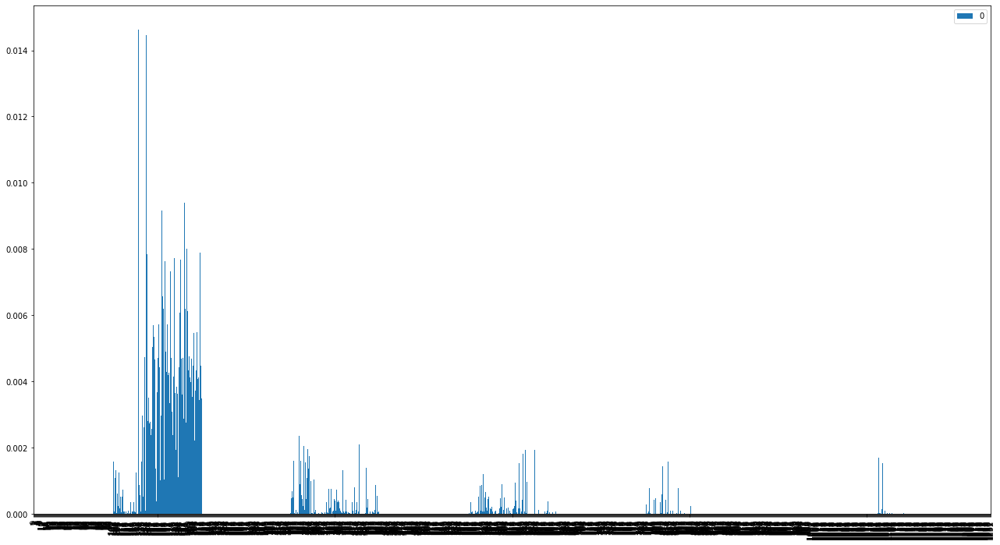

In [ ]:
pd.DataFrame(temp).plot(kind = 'bar', figsize = (22,12))

In [ ]:
%%R

mse2 <- mean(rf2$debiased.error)
mse3 <- mean(rf3$debiased.error)


#> [1] "Integers: 15.6558414382405"
print(paste0("One-hot vectors: ", mse2))
#> [1] "One-hot vectors: 14.6681216279153"
print(paste0("'Means' encoding [sufrep]: ", mse3))
#> [1] "'Means' encoding [sufrep]: 14.4303582052086"

[1] "One-hot vectors: 14.5264148471875"
[1] "'Means' encoding [sufrep]: 14.2080533041086"


## ECONML

In [ ]:
temp_names = ['child_sample_wgt',
              'ward_best',
              'pra_class_present',
              'pra_class_attendance',
              'pri_fees_amount',
              'pri_amount_funding_fees'
              ]

X = raw_data_df[temp_names]
X = X.dropna()
X

,child_sample_wgt,ward_best,pra_class_present,pra_class_attendance,pri_fees_amount,pri_amount_funding_fees
28,689.911194,14.0,12.0,14.0,100.0,1500.0
29,689.911194,14.0,12.0,14.0,100.0,1500.0
30,689.911194,14.0,12.0,14.0,100.0,1500.0
31,689.911194,14.0,12.0,14.0,100.0,1500.0
36,1129.411743,3.0,19.0,21.0,150.0,6000.0
...,...,...,...,...,...,...
11807,1417.384644,10.0,8.0,22.0,1200.0,48000.0
11811,1822.500000,13.0,23.0,23.0,1500.0,105000.0
11813,611.555542,70.0,18.0,18.0,900.0,45000.0
11816,2011.928589,70.0,14.0,14.0,800.0,43000.0


In [ ]:
transport_Df

,child_age,child_months_enrolment,child_score_item_1,child_score_item_2,child_score_item_3,child_score_item_4,child_domain_1,child_score_item_5,child_score_item_6,child_score_item_7,child_score_item_8,child_domain_2,child_score_item_9,child_score_item_10,child_score_item_11,child_score_item_12,child_score_item_13,child_domain_3,child_score_item_14,child_score_item_15,child_score_item_16,child_score_item_17,child_domain_4,child_score_item_18,child_score_item_19,child_score_item_20,child_score_item_21,child_score_item_22,child_score_item_23,child_domain_5,child_height,child_observe_total,child_total_elom,child_sample_wgt,child_age_w2,child_score_item_1_w2,child_score_item_2_w2,child_score_item_3_w2,child_score_item_4_w2,child_domain_1_w2,child_score_item_5_w2,child_score_item_6_w2,child_score_item_7_w2,child_score_item_8_w2,child_domain_2_w2,child_score_item_9_w2,child_score_item_10_w2,child_score_item_11_w2,child_score_item_12_w2,child_score_item_13_w2,child_domain_3_w2,child_score_item_14_w2,child_score_item_15_w2,child_score_item_16_w2,child_score_item_17_w2,child_domain_4_w2,child_score_item_18_w2,child_score_item_19_w2,child_score_item_20_w2,child_score_item_21_w2,child_score_item_22_w2,child_score_item_23_w2,child_domain_5_w2,child_total_elom_w2,child_height_w2,child_observe_total_w2,ward_best,id_enumerator,pqa_class_assistants,pqa_score_environment,pqa_score_assessment,pqa_score_relationships,pqa_score_curriculum,pqa_score_teaching,pra_class_present,pra_class_size,pra_class_attendance,pra_class_attendance_precovid,pra_hhsize,pra_measure_lshape_length_1,pra_measure_lshape_width_1,pra_measure_lshape_length_2,pra_measure_lshape_width_2,pra_measure_circle_diameter,pra_parent_enrolment,pra_parent_regular_attendance,pra_tuc_training_participation,pra_satisfaction_resources,pra_satisfaction_support,pri_days,pri_year,pri_toy_members_orgs,pri_toy_members_individuals,pri_toy_count,pri_fees_amount,pri_dsd_year,pri_capacity,pri_amount_funding_dsd,pri_amount_funding_dbe,pri_amount_funding_doh,pri_amount_funding_donations,pri_amount_funding_fundraising,pri_amount_funding_other,pri_amount_funding_fees,pri_children_4_6_years,pri_difficult_see,pri_difficult_hear,pri_difficult_walk,pri_difficult_hold,pri_difficult_communicate,pri_difficult_learn,pri_covid_staff_retrench,pri_fees_amount_0_1,pri_fees_amount_2_3,pri_expense_food,pri_expense_staff,pri_expense_rent,pri_expense_materials,pri_expense_maintenance,pri_expense_admin,pri_expense_other,pri_clinic_time,pri_fees_amount_4_6,pri_learners_n_gr_r,pri_learners_n_gr_1,pri_learners_n_gr_2,pri_learners_n_gr_3,pri_learners_n_gr_4,pri_learners_n_gr_5,pri_learners_n_gr_6,pri_learners_n_gr_7,obs_classrooms,obs_toilets_n_girls,obs_toilets_n_boys,obs_toilets_n_unisex,teacher_duration,teacher_social_total,teacher_selfcare_total,hle_burdenofcare,hle_picturebooks,hle_home_learning_opportunity,hle_early_learning_resources,hle_time_for_stimulation,hle_books,hle_range_play_resources,hle_activity_score,id_ward,count_register_all,count_staff_all,count_children_present,count_children_attendance,count_children_precovid,latitude,longitude,count_aftercare,count_register_gender_female,count_register_gender_male,count_register_gender_other,count_register_gender,count_register_year_2021,count_register_year_2020,count_register_year_2019,count_register_year_2018,count_register_year_2017,count_register_year_2016,count_register_year_2015,count_register_year_2014,count_register_year_2013,count_register_year_school,count_register_year_grader,count_register_race_african,count_register_race_coloured,count_register_race_indian,count_register_race_white,count_register_race_other,count_register_race,count_staff_qual_skills,count_staff_qual_nqf4_5,count_staff_qual_nqf6_9,count_toilets_adults,id_team,quintile,count_register_foreign,count_present_girls,count_present_boys,count_staff_gender_female,count_staff_gender_male,count_staff_gender_other,count_staff_gender,count_staff_contract_permanent,count_staff_contract_temporary,coun

In [ ]:
transport_Df = X.copy() #
transport_Df['Y'] = Y #.loc[:1000] #, :]
transport_Df = transport_Df.dropna()
for i in transport_Df.columns:
   display(transport_Df[i].sort_values(ascending = False).head()) #.sum()

   

In [ ]:
y = raw_data_df['PD_1_INT_total_elom_CHILD']
X = raw_data_df.select_dtypes(include=[np.float64])

In [ ]:
np.random.seed(123)
n_samples = 200
n_features = 10
n_outputs = 2
true_te = lambda X: np.hstack([X[:, [0]]**2 + 1, np.ones((X.shape[0], n_outputs - 1))])
# true_te = lambda X: np.hstack([X[:, [0]]>0, np.ones((X.shape[0], n_outputs - 1))])
# true_te = lambda X: np.hstack([(X[:, [0]]>0) * X[:, [0]],
#                                np.ones((X.shape[0], n_outputs - 1))*np.arange(1, n_outputs).reshape(1, -1)])
X = np.random.normal(0, 1, size=(n_samples, n_features))
y = true_te(X) + 0.0 * X[:, [0]] + np.random.normal(0, .1, size=(n_samples, 1))
X_test = X[:min(100, n_samples)].copy()
X_test[:, 0] = np.linspace(np.percentile(X[:, 0], 1), np.percentile(X[:, 0], 99), min(100, n_samples))

In [ ]:
est = RegressionForest(n_estimators=400, min_samples_leaf=5, max_depth=None,
                       min_impurity_decrease = 0.0, max_samples=0.45, min_balancedness_tol=.45,
                       warm_start=False, inference=True, subforest_size=4,
                       honest=True, verbose=0, n_jobs=-1, random_state=1235)

In [ ]:
print("hey")

hey


In [ ]:
est.fit(X, Y)

RegressionForest(n_estimators=400, random_state=1235)

In [ ]:
for t in range(n_outputs):
    plt.plot(X_test[:, 0], point[:, t])
    if est.inference:
        plt.fill_between(X_test[:, 0], lb[:, t], ub[:, t], alpha=.4)
    plt.plot(X_test[:, 0], true_te(X_test)[:, t])
plt.show()

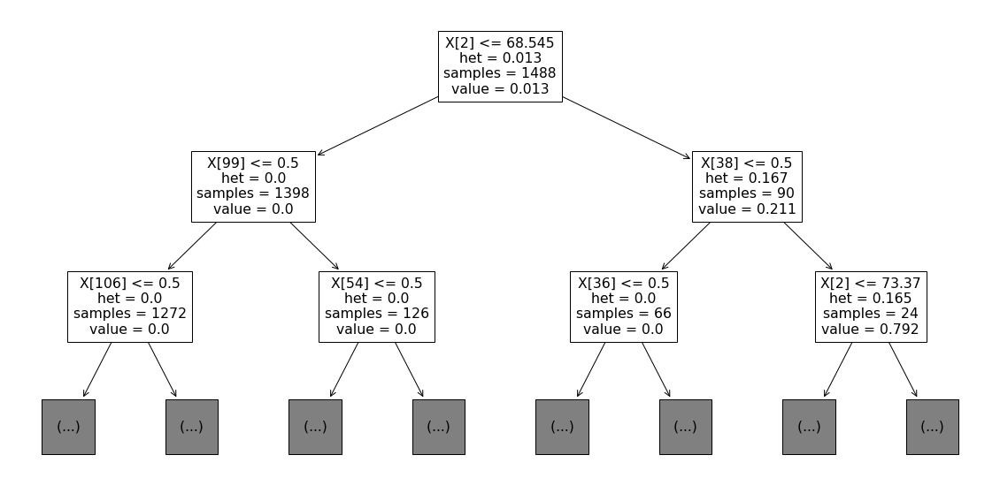

In [ ]:
plt.figure(figsize=(20, 10))
plot_tree(est[0], impurity=True, max_depth=2)
plt.show()

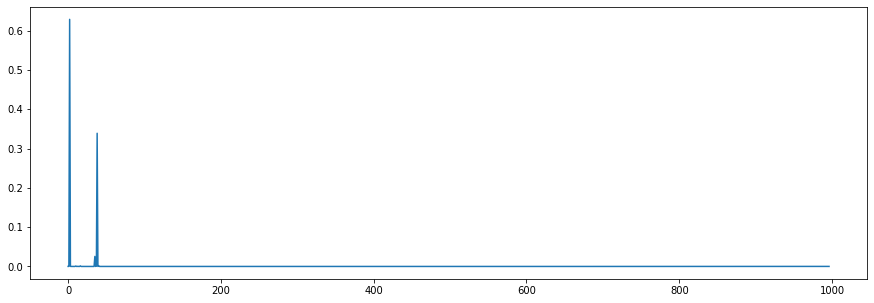

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(est.feature_importances(max_depth=4, depth_decay_exponent=2.0))
plt.show()

In [ ]:
import shap
explainer = shap.Explainer(est, shap.maskers.Independent(X, max_samples=100))
shap_values = explainer(X[:200])


 98%|===================| 195/200 [00:23<00:00]       

 96%|=================== | 193/200 [00:22<00:00]       

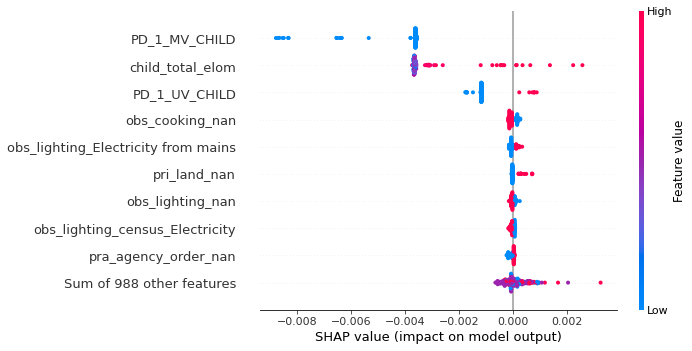

In [ ]:
explainer = shap.Explainer(est, shap.maskers.Independent(X, max_samples=100))
shap_values = explainer(X[:200])
shap.plots.beeswarm(shap_values, max_display=20)

In [ ]:
shap.plots.beeswarm(shap_values[:, 0])
shap.plots.beeswarm(shap_values[:, 1])

ValueError: ignored

# All Shap

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_elom_CHILD


<Figure size 1080x1800 with 0 Axes>

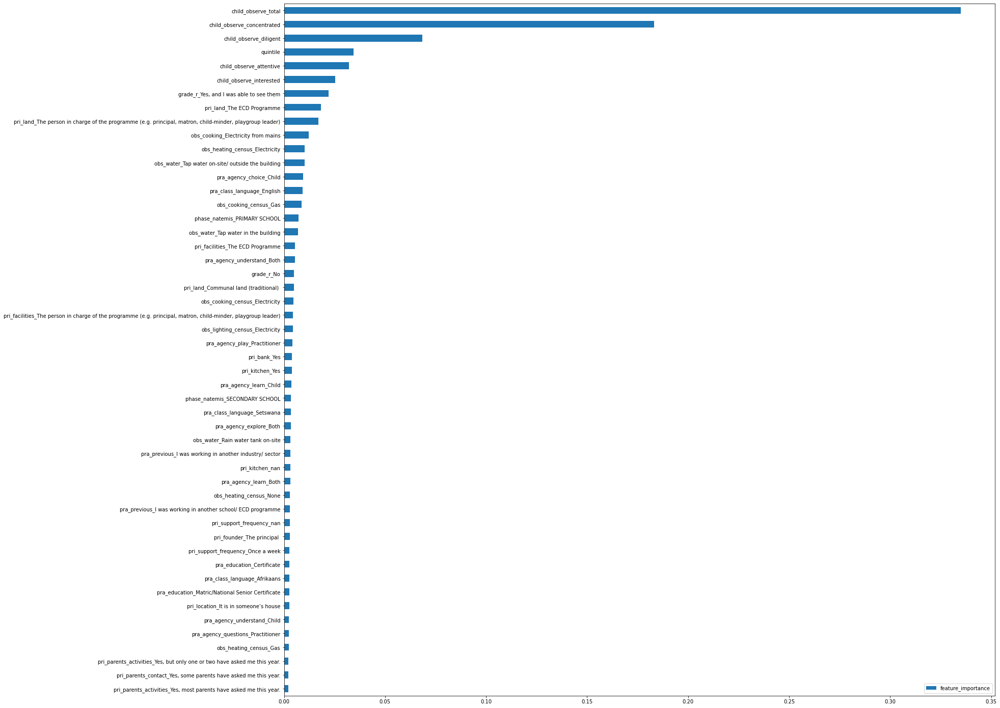

,feature_importance
child_observe_total,0.335015
child_observe_concentrated,0.183139
child_observe_diligent,0.068377
quintile,0.034438
child_observe_attentive,0.032229
child_observe_interested,0.025368
"grade_r_Yes, and I was able to see them",0.022166
pri_land_The ECD Programme,0.018209
"pri_land_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.016975
obs_cooking_Electricity from mains,0.012265


100%|===================| 199/200 [00:41<00:00]       

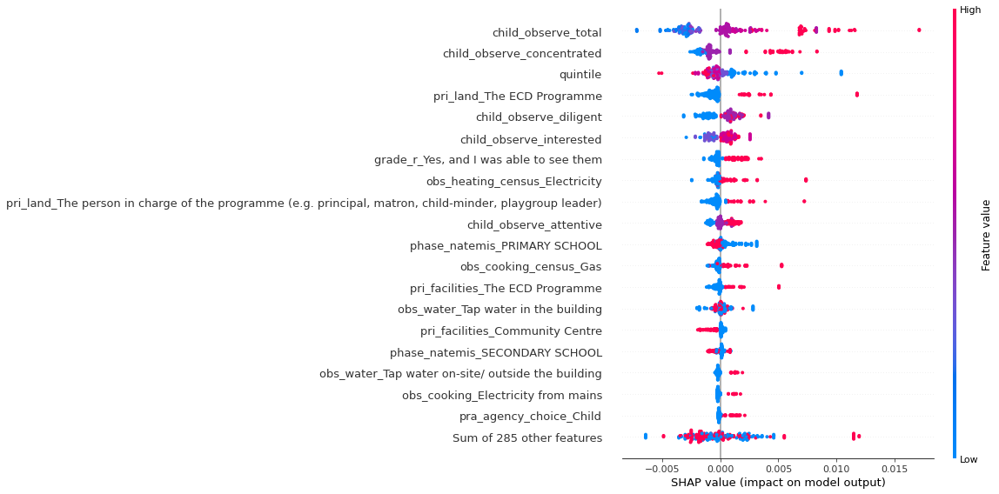

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_elom_facility


<Figure size 1080x1800 with 0 Axes>

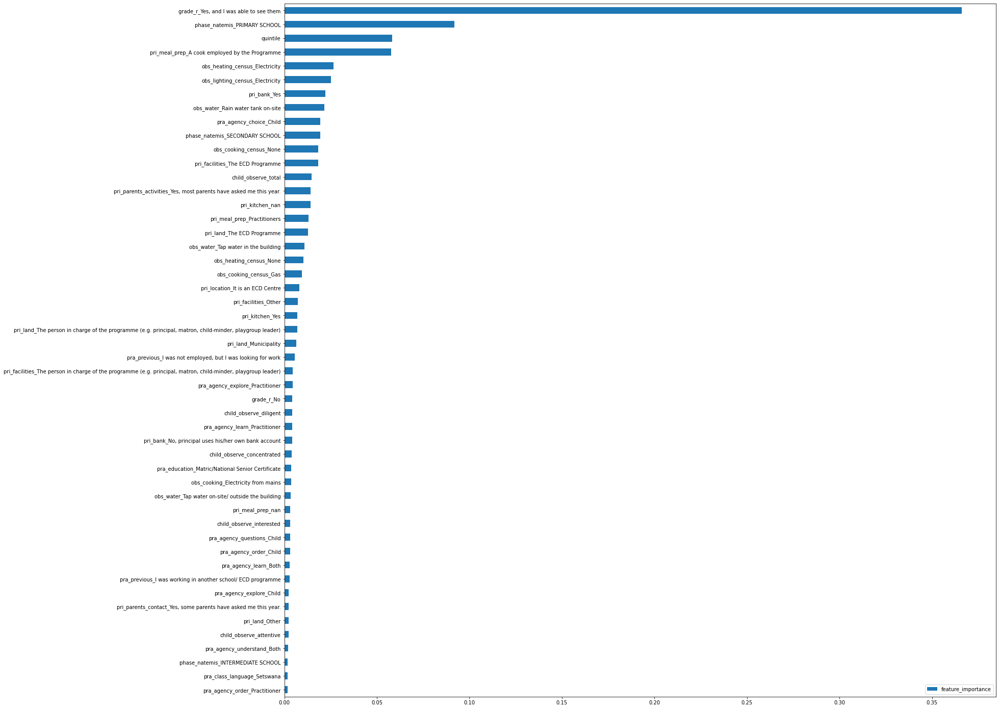

,feature_importance
"grade_r_Yes, and I was able to see them",0.366094
phase_natemis_PRIMARY SCHOOL,0.091815
quintile,0.058136
pri_meal_prep_A cook employed by the Programme,0.057733
obs_heating_census_Electricity,0.026538
obs_lighting_census_Electricity,0.025147
pri_bank_Yes,0.022271
obs_water_Rain water tank on-site,0.021595
pra_agency_choice_Child,0.019495
phase_natemis_SECONDARY SCHOOL,0.019488


100%|===================| 199/200 [00:41<00:00]       

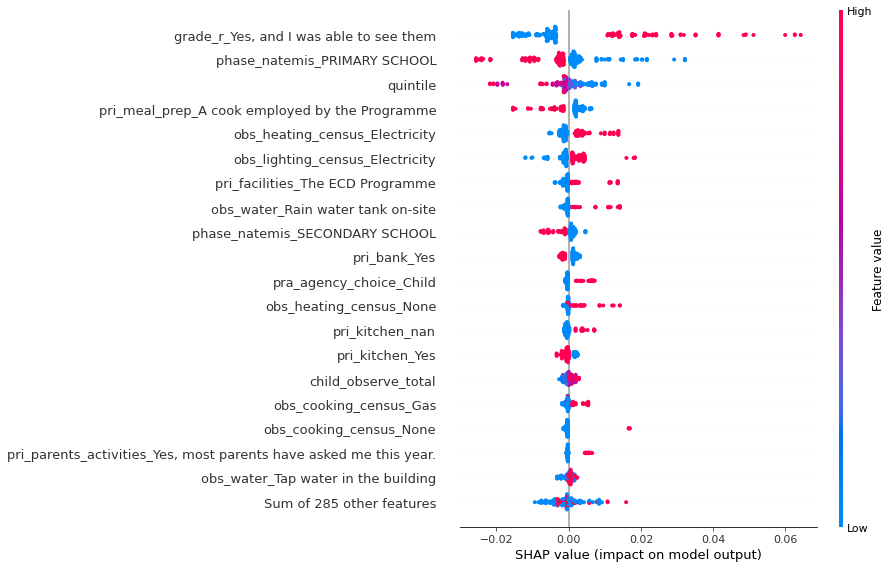

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_elom_ward


<Figure size 1080x1800 with 0 Axes>

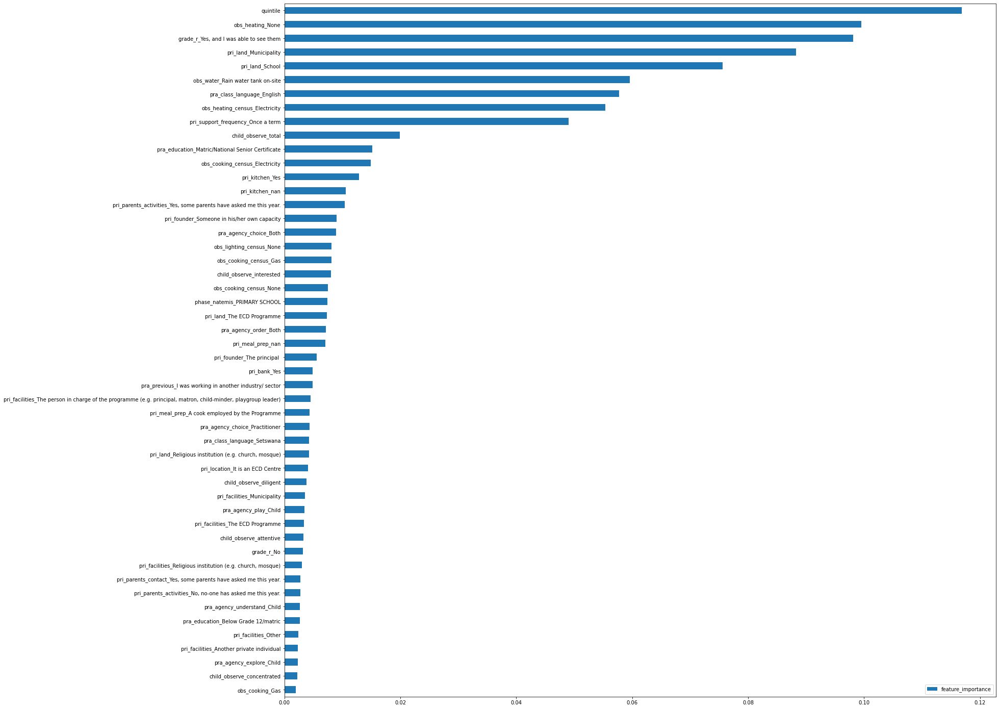

,feature_importance
quintile,0.116865
obs_heating_None,0.099492
"grade_r_Yes, and I was able to see them",0.098123
pri_land_Municipality,0.088259
pri_land_School,0.075573
obs_water_Rain water tank on-site,0.059583
pra_class_language_English,0.057727
obs_heating_census_Electricity,0.055350
pri_support_frequency_Once a term,0.049020
child_observe_total,0.019938


 98%|===================| 195/200 [00:42<00:01]       

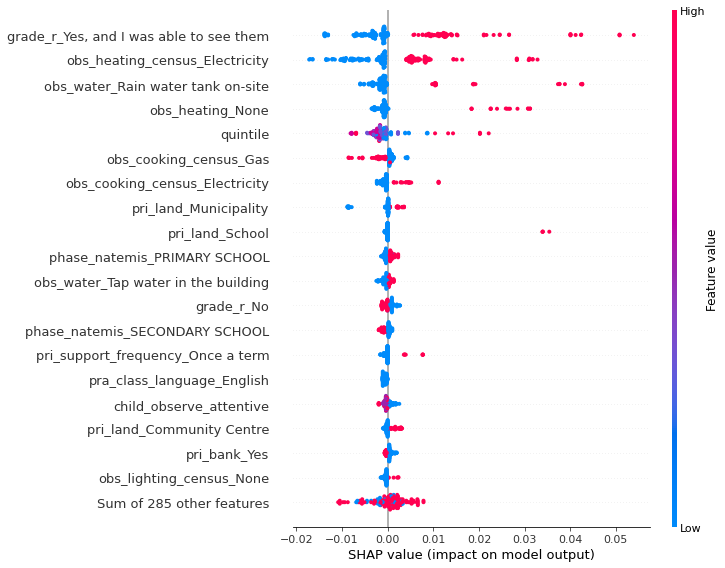

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_elom_dc


<Figure size 1080x1800 with 0 Axes>

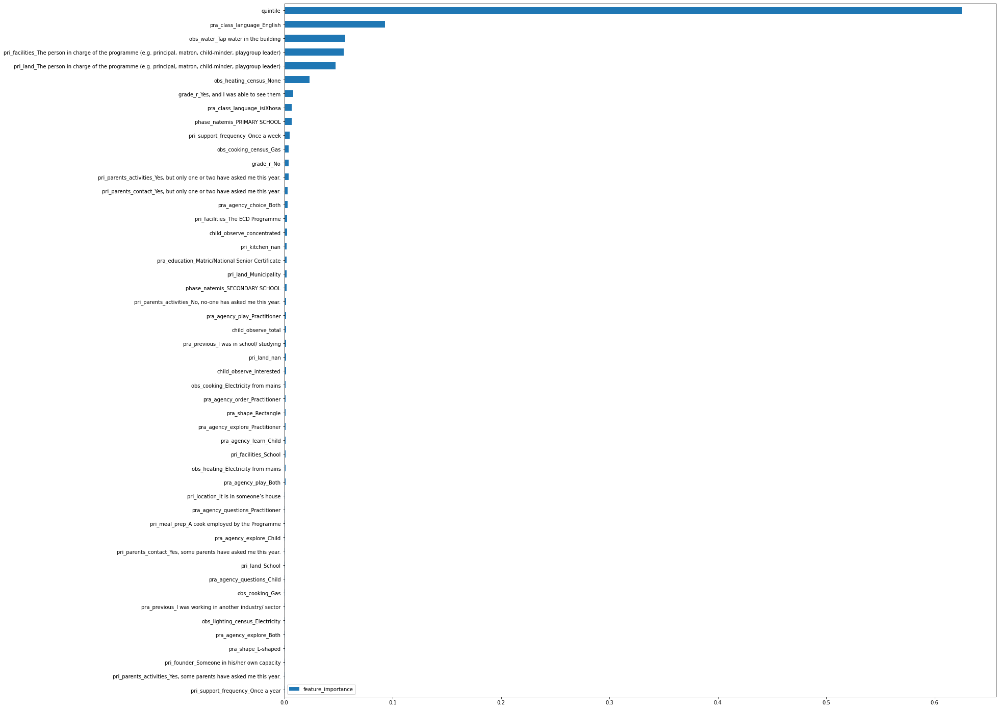

,feature_importance
quintile,0.625112
pra_class_language_English,0.093083
obs_water_Tap water in the building,0.056219
"pri_facilities_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.054757
"pri_land_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.047381
obs_heating_census_None,0.023068
"grade_r_Yes, and I was able to see them",0.008038
pra_class_language_isiXhosa,0.006852
phase_natemis_PRIMARY SCHOOL,0.006740
pri_support_frequency_Once a week,0.004876


100%|===================| 199/200 [00:43<00:00]       

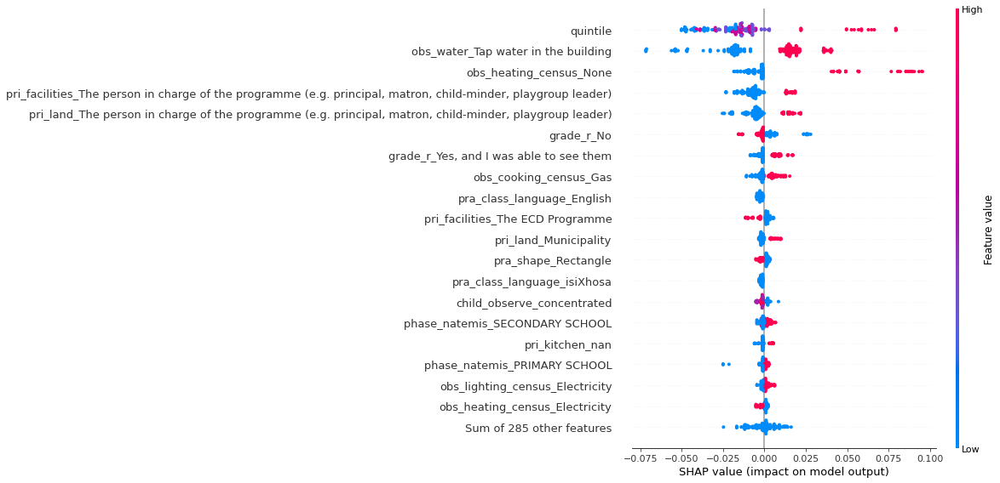

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_elom_mn


<Figure size 1080x1800 with 0 Axes>

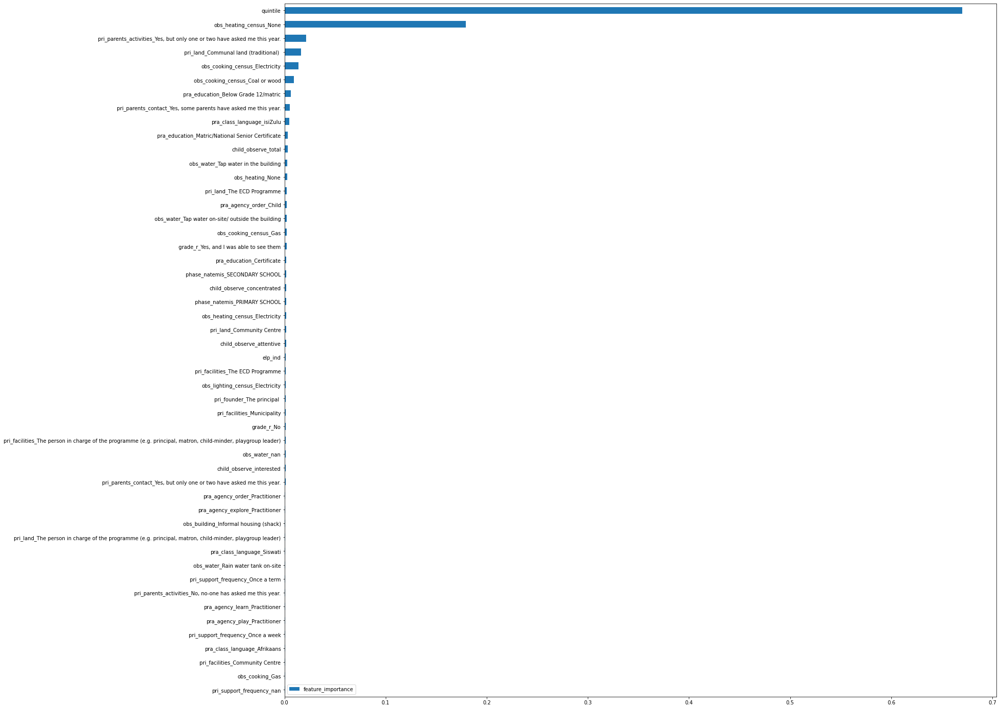

,feature_importance
quintile,0.670242
obs_heating_census_None,0.179235
"pri_parents_activities_Yes, but only one or two have asked me this year.",0.021405
pri_land_Communal land (traditional),0.016320
obs_cooking_census_Electricity,0.013592
obs_cooking_census_Coal or wood,0.009543
pra_education_Below Grade 12/matric,0.006384
"pri_parents_contact_Yes, some parents have asked me this year.",0.005343
pra_class_language_isiZulu,0.004723
pra_education_Matric/National Senior Certificate,0.003214


100%|===================| 199/200 [00:46<00:00]       

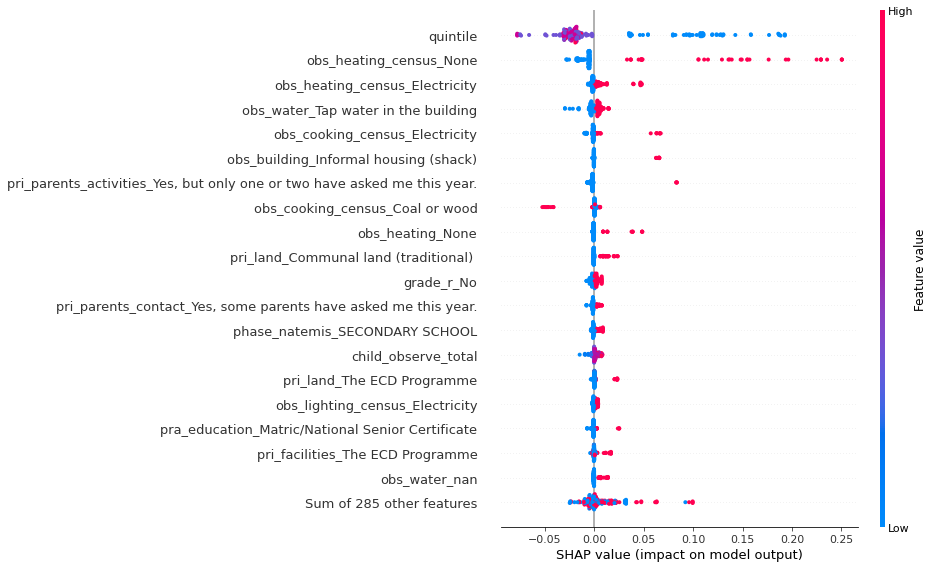

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_facility


<Figure size 1080x1800 with 0 Axes>

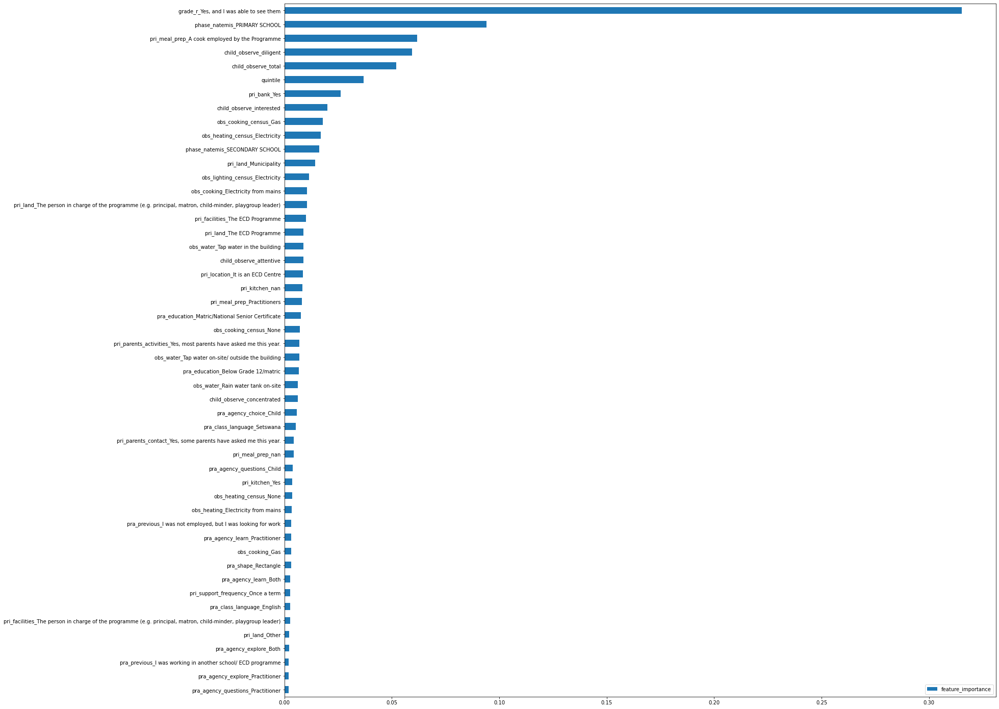

,feature_importance
"grade_r_Yes, and I was able to see them",0.315295
phase_natemis_PRIMARY SCHOOL,0.094177
pri_meal_prep_A cook employed by the Programme,0.061902
child_observe_diligent,0.059461
child_observe_total,0.052018
quintile,0.036941
pri_bank_Yes,0.026289
child_observe_interested,0.020012
obs_cooking_census_Gas,0.017966
obs_heating_census_Electricity,0.017047


 98%|===================| 196/200 [00:43<00:00]       

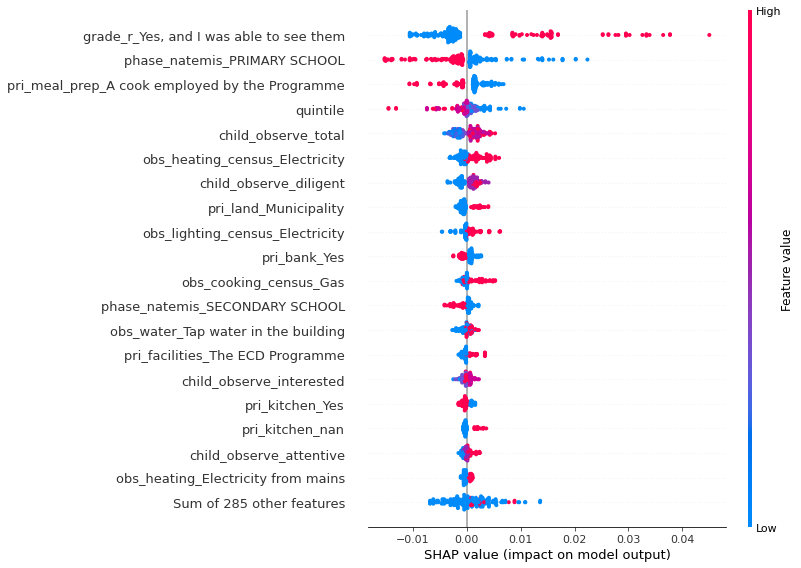

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_ward


<Figure size 1080x1800 with 0 Axes>

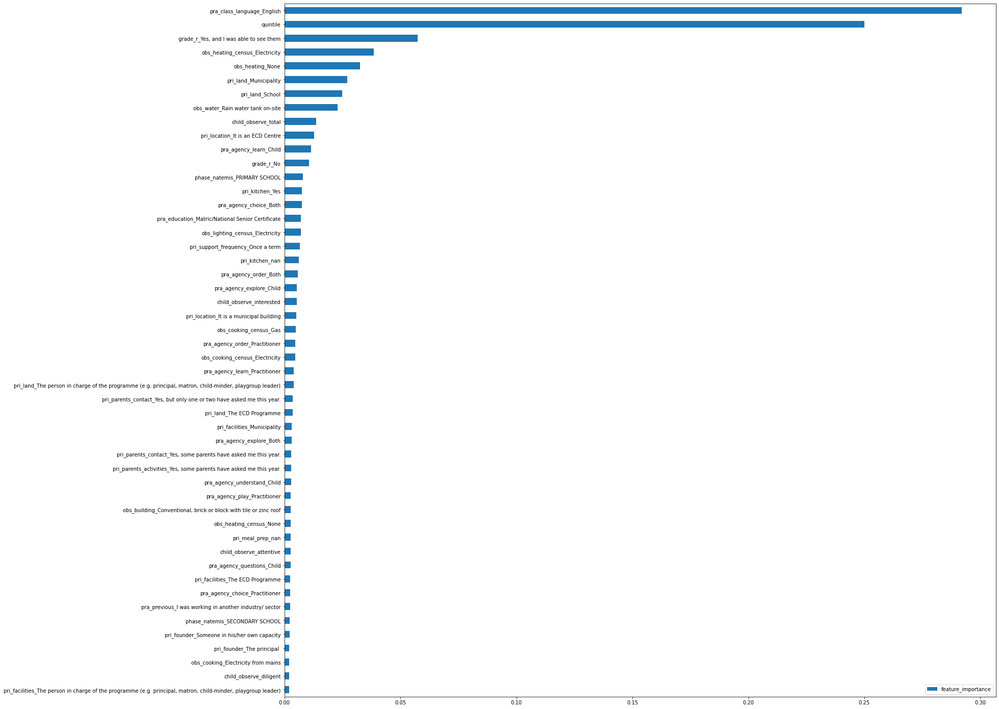

,feature_importance
pra_class_language_English,0.292017
quintile,0.250059
"grade_r_Yes, and I was able to see them",0.057508
obs_heating_census_Electricity,0.038650
obs_heating_None,0.032541
pri_land_Municipality,0.027156
pri_land_School,0.024979
obs_water_Rain water tank on-site,0.023036
child_observe_total,0.013659
pri_location_It is an ECD Centre,0.012752


 99%|===================| 198/200 [00:39<00:00]       

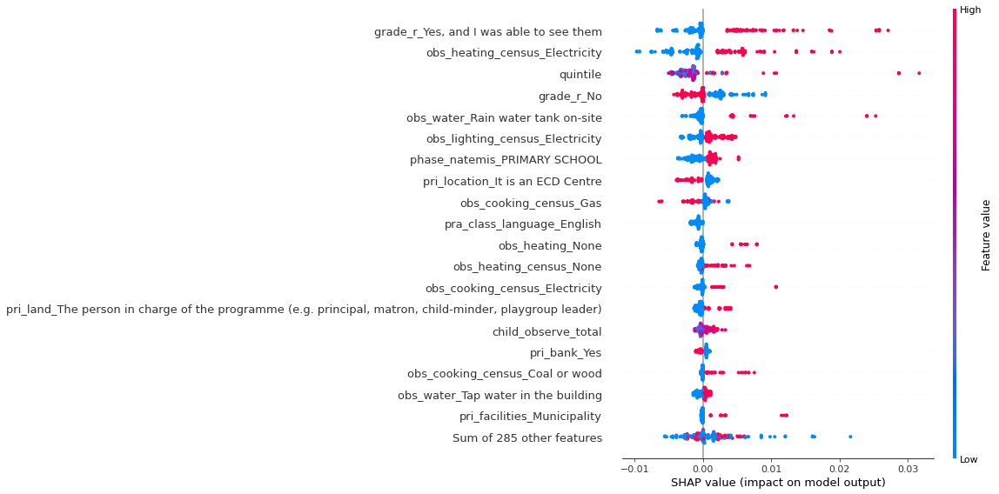

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_mn


<Figure size 1080x1800 with 0 Axes>

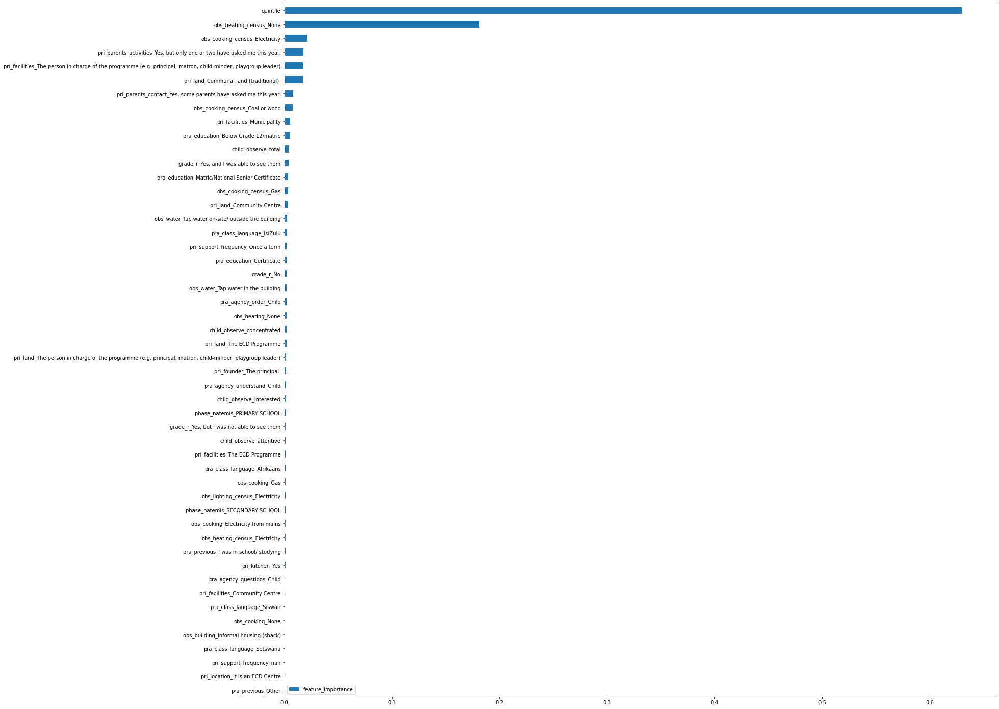

,feature_importance
quintile,0.629812
obs_heating_census_None,0.181109
obs_cooking_census_Electricity,0.021248
"pri_parents_activities_Yes, but only one or two have asked me this year.",0.017711
"pri_facilities_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.017309
pri_land_Communal land (traditional),0.017114
"pri_parents_contact_Yes, some parents have asked me this year.",0.008041
obs_cooking_census_Coal or wood,0.007613
pri_facilities_Municipality,0.005322
pra_education_Below Grade 12/matric,0.004972


 99%|===================| 198/200 [00:38<00:00]       

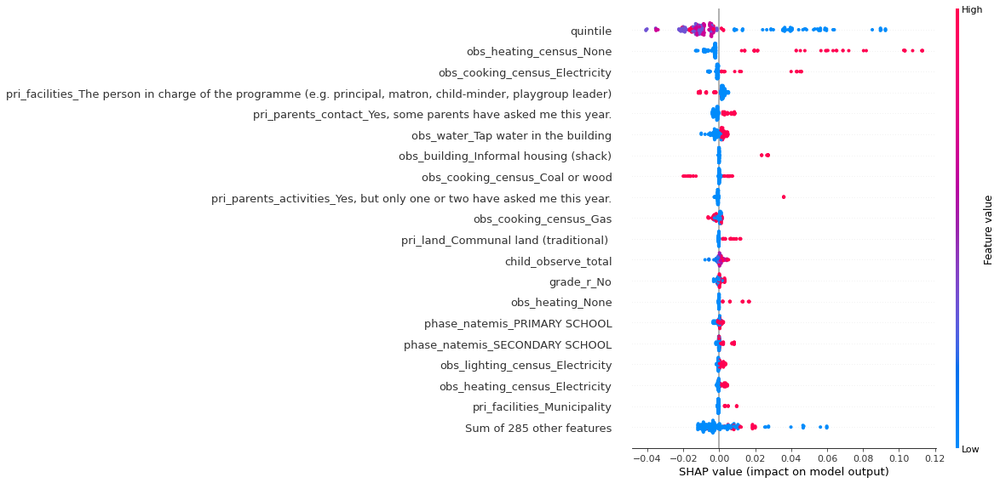

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_dc


<Figure size 1080x1800 with 0 Axes>

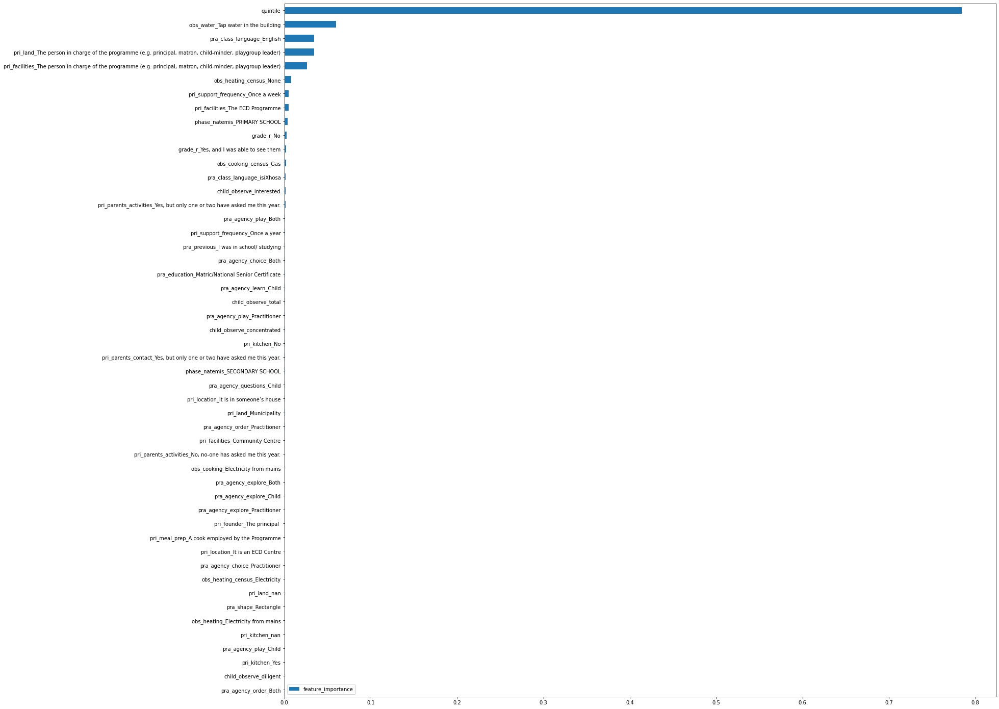

,feature_importance
quintile,0.784425
obs_water_Tap water in the building,0.060067
pra_class_language_English,0.034560
"pri_land_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.034414
"pri_facilities_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.026515
obs_heating_census_None,0.007811
pri_support_frequency_Once a week,0.005244
pri_facilities_The ECD Programme,0.004975
phase_natemis_PRIMARY SCHOOL,0.004039
grade_r_No,0.002321


100%|===================| 199/200 [00:41<00:00]       

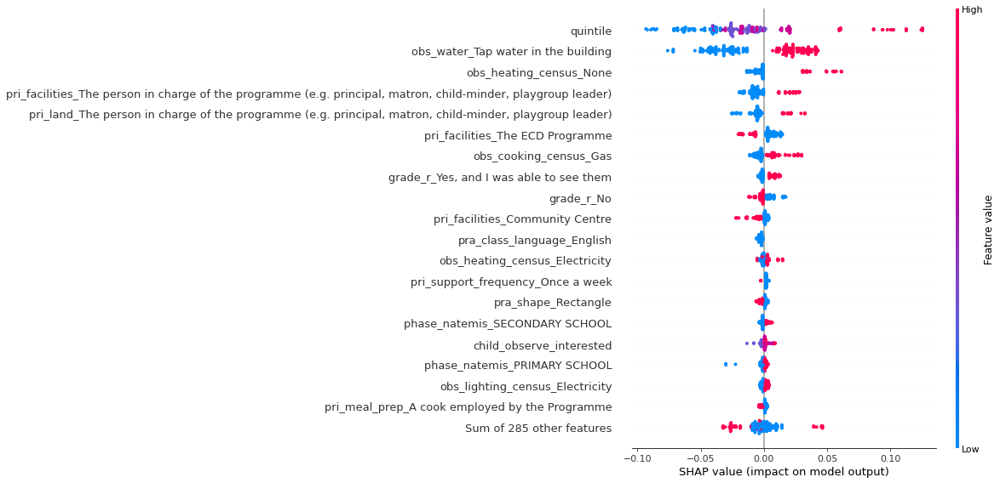

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_1_CHILD


<Figure size 1080x1800 with 0 Axes>

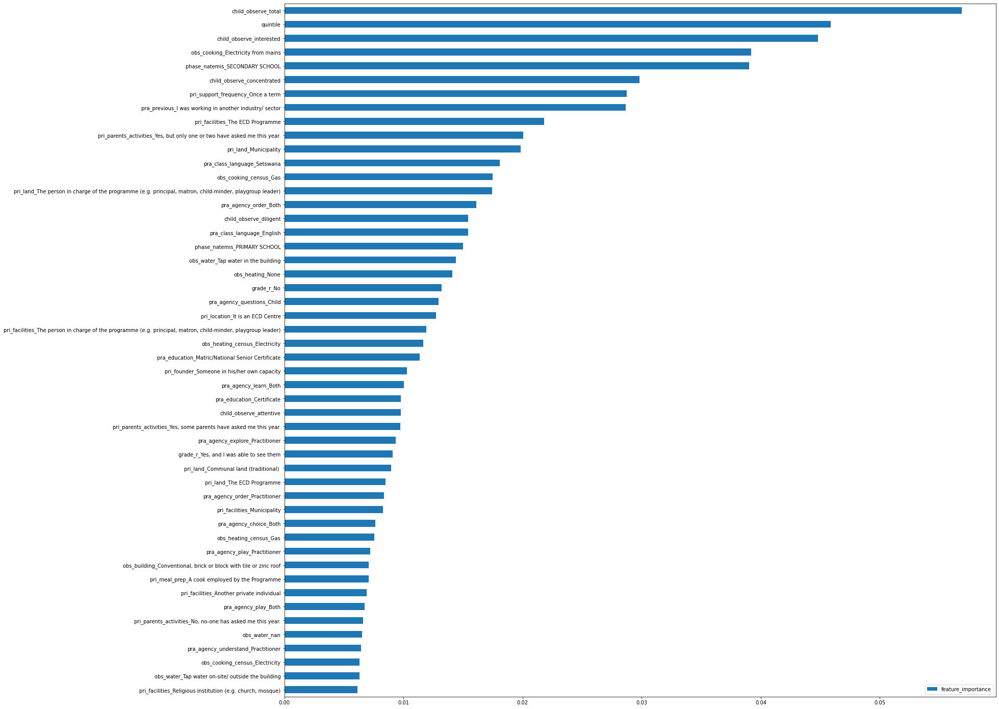

,feature_importance
child_observe_total,0.056879
quintile,0.045853
child_observe_interested,0.044792
obs_cooking_Electricity from mains,0.039195
phase_natemis_SECONDARY SCHOOL,0.039011
child_observe_concentrated,0.029812
pri_support_frequency_Once a term,0.028733
pra_previous_I was working in another industry/ sector,0.028657
pri_facilities_The ECD Programme,0.021813
"pri_parents_activities_Yes, but only one or two have asked me this year.",0.020075


 98%|===================| 197/200 [00:43<00:00]       

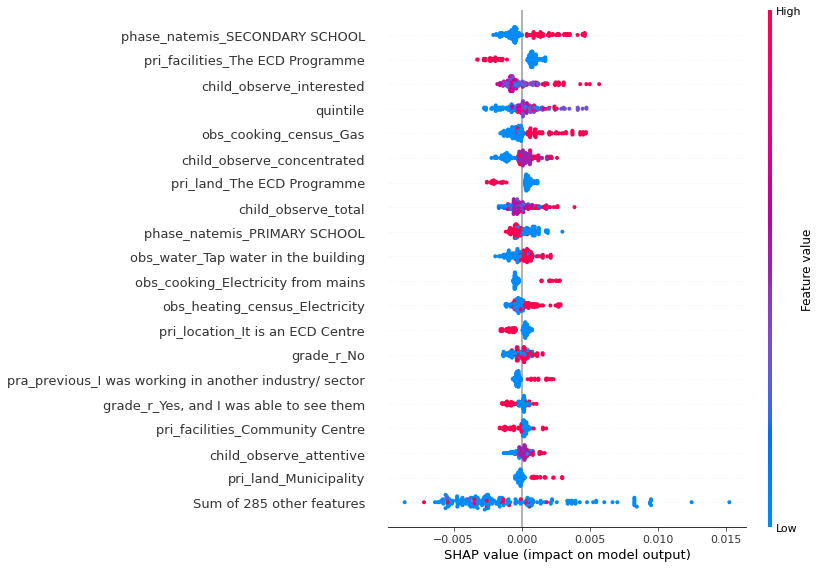

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_2_CHILD


<Figure size 1080x1800 with 0 Axes>

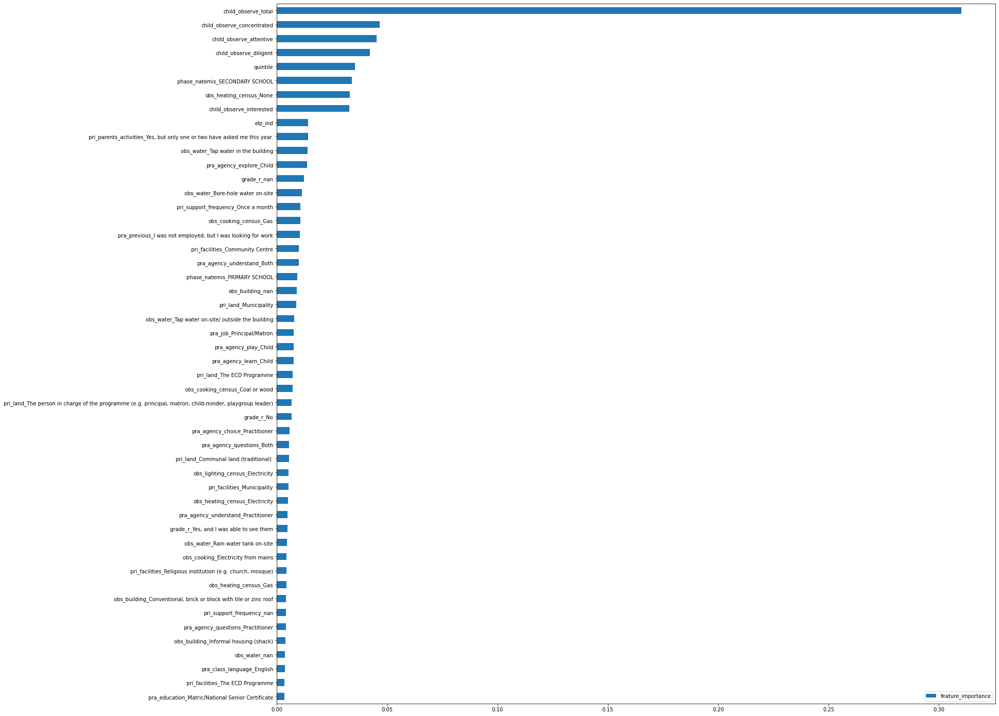

,feature_importance
child_observe_total,0.310142
child_observe_concentrated,0.046652
child_observe_attentive,0.045318
child_observe_diligent,0.042252
quintile,0.035301
phase_natemis_SECONDARY SCHOOL,0.033891
obs_heating_census_None,0.033075
child_observe_interested,0.032777
elp_ind,0.014255
"pri_parents_activities_Yes, but only one or two have asked me this year.",0.014142


 99%|===================| 198/200 [00:46<00:00]       

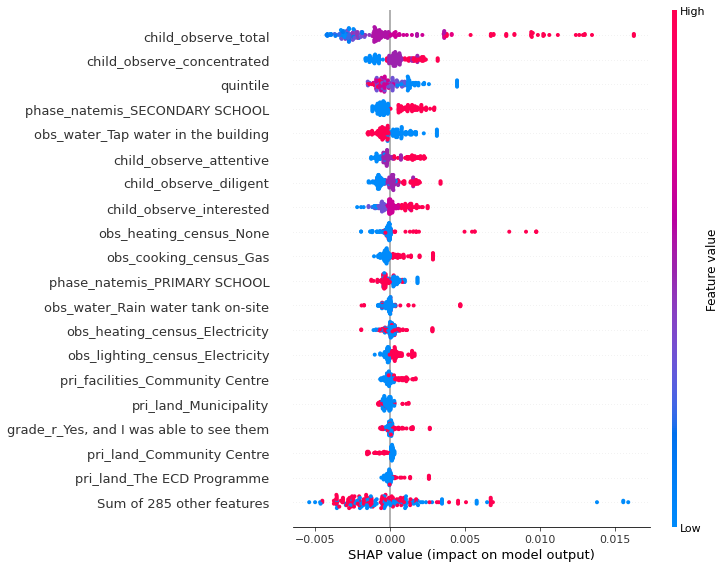

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_3_CHILD


<Figure size 1080x1800 with 0 Axes>

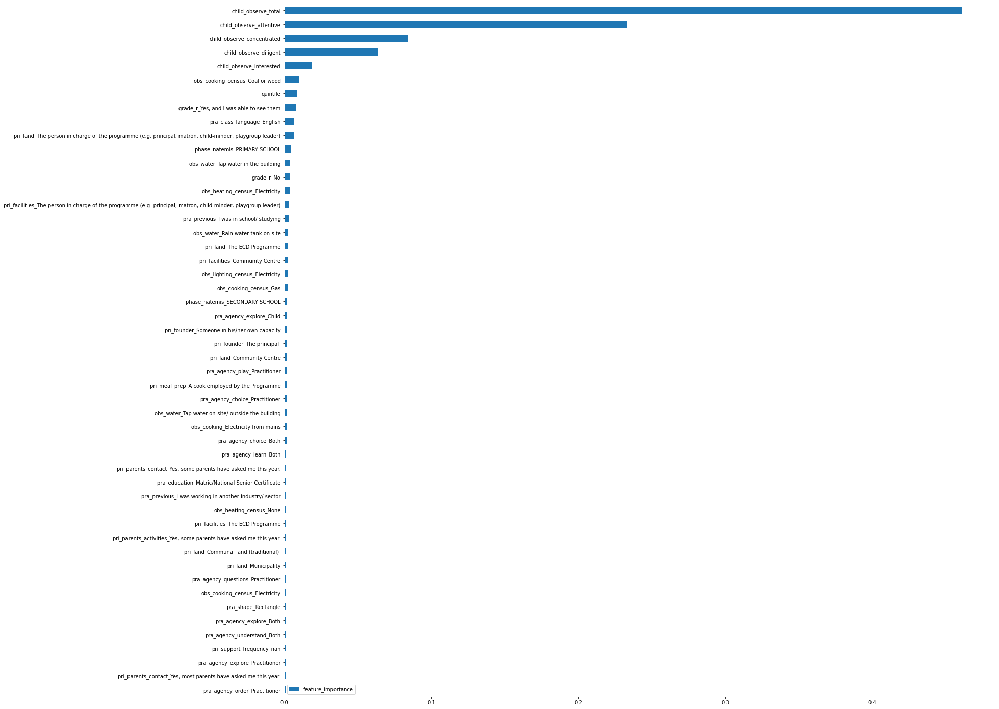

,feature_importance
child_observe_total,0.460894
child_observe_attentive,0.232981
child_observe_concentrated,0.084320
child_observe_diligent,0.063661
child_observe_interested,0.018810
obs_cooking_census_Coal or wood,0.009821
quintile,0.008605
"grade_r_Yes, and I was able to see them",0.007962
pra_class_language_English,0.006845
"pri_land_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.006238


100%|===================| 199/200 [00:43<00:00]       

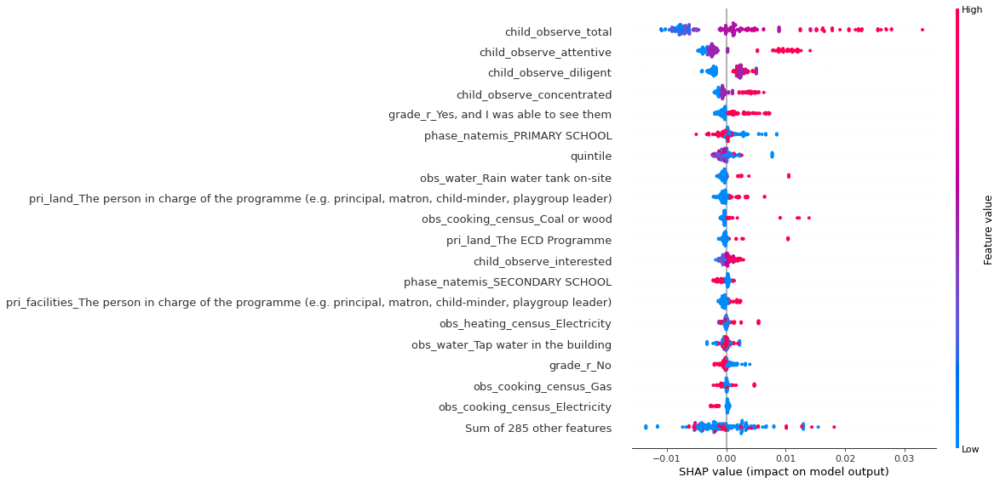

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_4_CHILD


<Figure size 1080x1800 with 0 Axes>

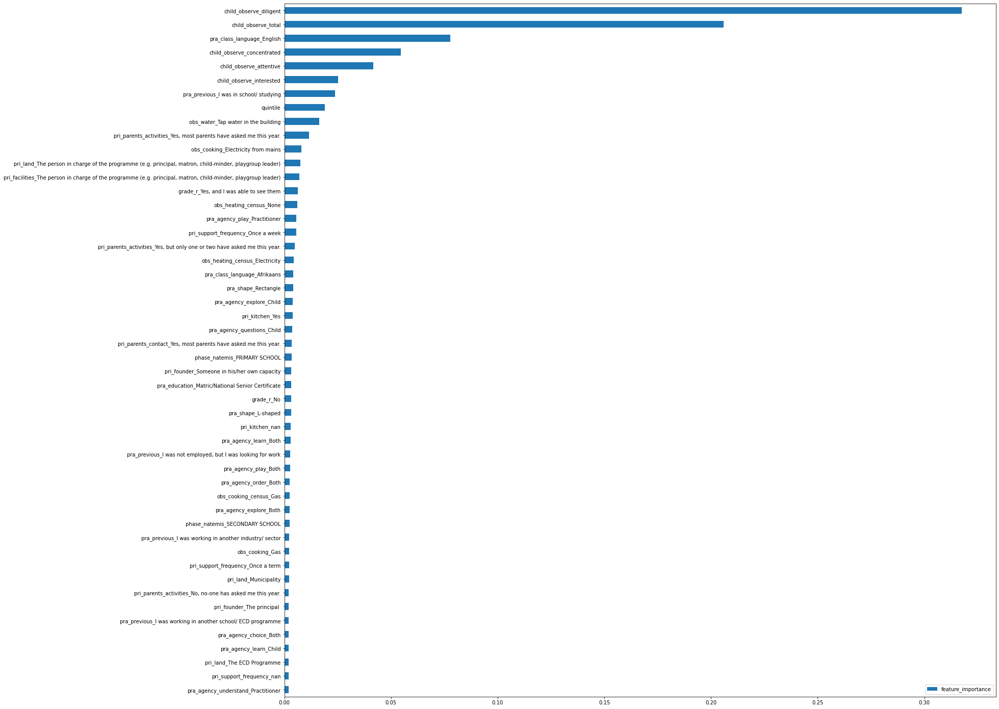

,feature_importance
child_observe_diligent,0.317583
child_observe_total,0.205827
pra_class_language_English,0.077727
child_observe_concentrated,0.054630
child_observe_attentive,0.041711
child_observe_interested,0.025252
pra_previous_I was in school/ studying,0.023831
quintile,0.018892
obs_water_Tap water in the building,0.016271
"pri_parents_activities_Yes, most parents have asked me this year.",0.011621


 99%|===================| 198/200 [00:43<00:00]       

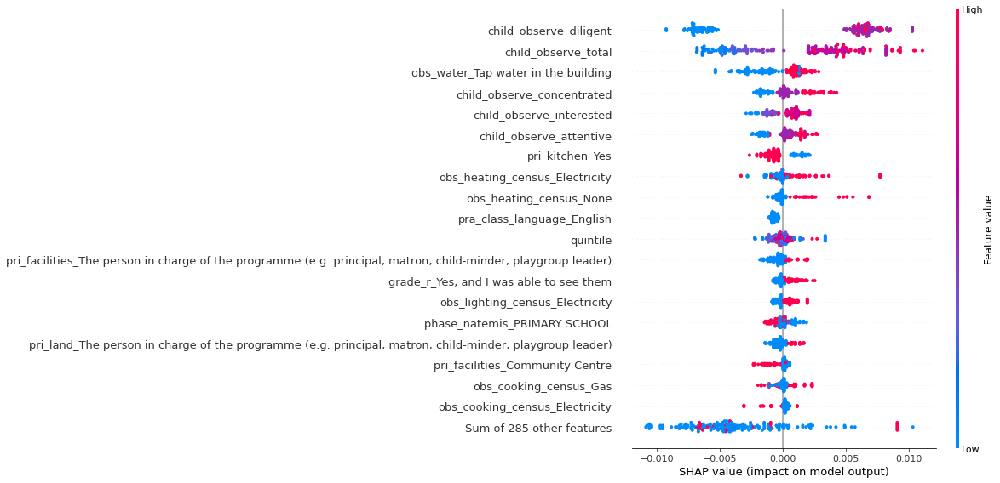

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_5_CHILD


<Figure size 1080x1800 with 0 Axes>

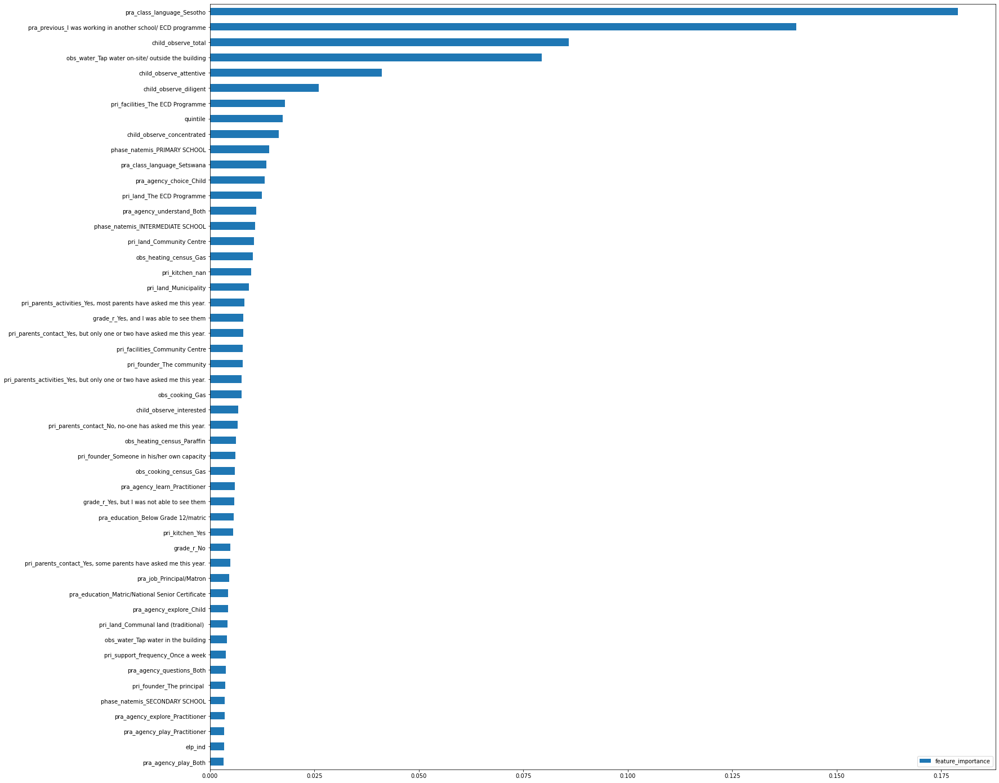

,feature_importance
pra_class_language_Sesotho,0.179037
pra_previous_I was working in another school/ ECD programme,0.140339
child_observe_total,0.085832
obs_water_Tap water on-site/ outside the building,0.079377
child_observe_attentive,0.041124
child_observe_diligent,0.026005
pri_facilities_The ECD Programme,0.018016
quintile,0.017395
child_observe_concentrated,0.016503
phase_natemis_PRIMARY SCHOOL,0.014145


100%|===================| 199/200 [00:41<00:00]       

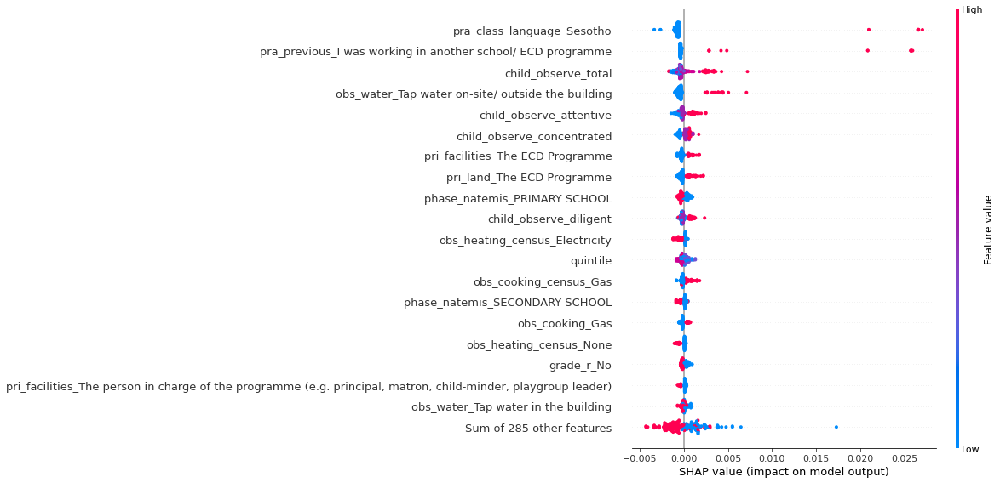

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_1_facility


<Figure size 1080x1800 with 0 Axes>

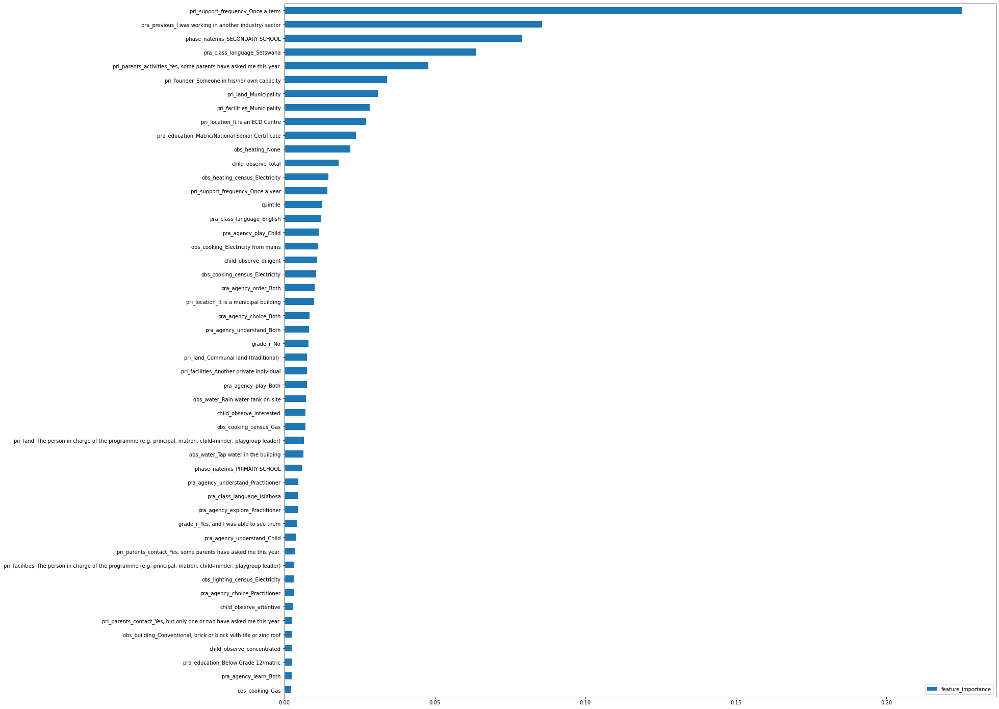

,feature_importance
pri_support_frequency_Once a term,0.225054
pra_previous_I was working in another industry/ sector,0.085537
phase_natemis_SECONDARY SCHOOL,0.079052
pra_class_language_Setswana,0.063715
"pri_parents_activities_Yes, some parents have asked me this year.",0.047849
pri_founder_Someone in his/her own capacity,0.034076
pri_land_Municipality,0.031082
pri_facilities_Municipality,0.028370
pri_location_It is an ECD Centre,0.027230
pra_education_Matric/National Senior Certificate,0.023716


 99%|===================| 198/200 [00:41<00:00]       

Exception: ignored

In [ ]:
for var in variables_of_interest:
  X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, var, drop_to_refine_significant_vars_total_elom_facility , dropNa = True)

  est = RegressionForest(n_estimators=1000, min_samples_leaf=5, max_depth=None,
                        min_impurity_decrease = 0.0, max_samples=0.45, min_balancedness_tol=.45,
                        warm_start=False, inference=True, subforest_size=4,
                        honest=True, verbose=0, n_jobs=-1, random_state=1235)

  est.fit(X, Y)

  plt.figure(figsize=(15,25))
  # plt.plot(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), X.columns)
  # plt.plot()
  print('*************************************************************************************************')
  print(var)
  pd.DataFrame(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), 
              index = X.columns, columns= ['feature_importance']).sort_values('feature_importance', ascending = True).tail(50).plot(
                  kind='barh', figsize = (25,25))
  
  plt.show()

  most_important_vars = pd.DataFrame(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), index = X.columns, columns= ['feature_importance']).sort_values('feature_importance', ascending = False).head(50)
  display(most_important_vars)


  explainer = shap.Explainer(est, shap.maskers.Independent(X, max_samples=100))

  shap_values = explainer(X[:200])
  shap.plots.beeswarm(shap_values, max_display=50)

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_elom_CHILD


<Figure size 1080x1800 with 0 Axes>

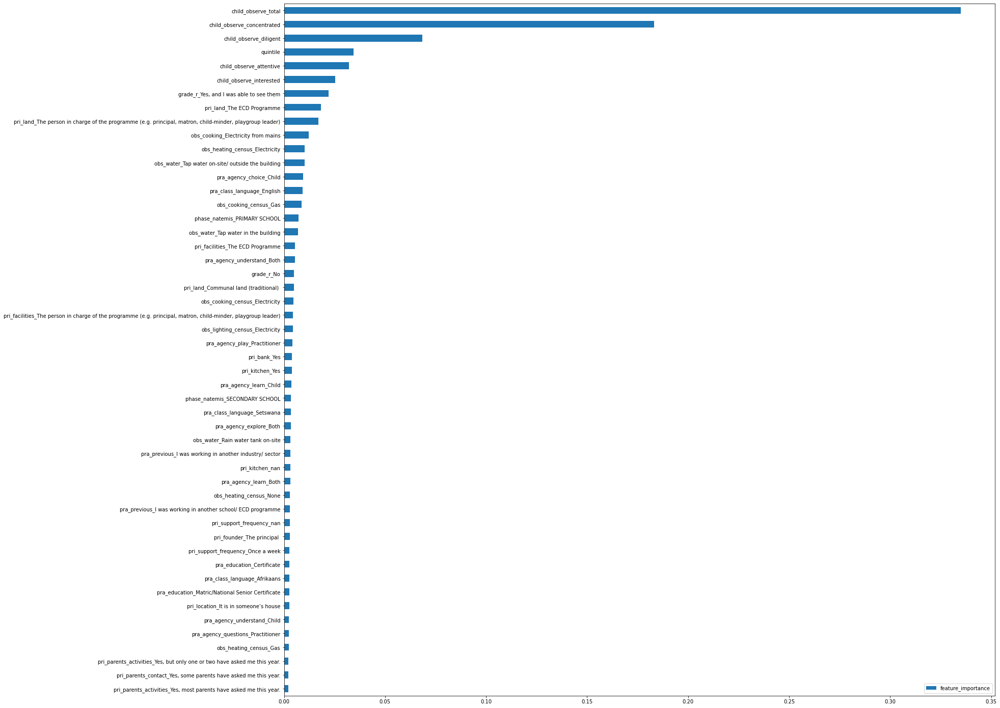

,feature_importance
child_observe_total,0.335015
child_observe_concentrated,0.183139
child_observe_diligent,0.068377
quintile,0.034438
child_observe_attentive,0.032229
child_observe_interested,0.025368
"grade_r_Yes, and I was able to see them",0.022166
pri_land_The ECD Programme,0.018209
"pri_land_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.016975
obs_cooking_Electricity from mains,0.012265


100%|===================| 995/1000 [03:48<00:01]       

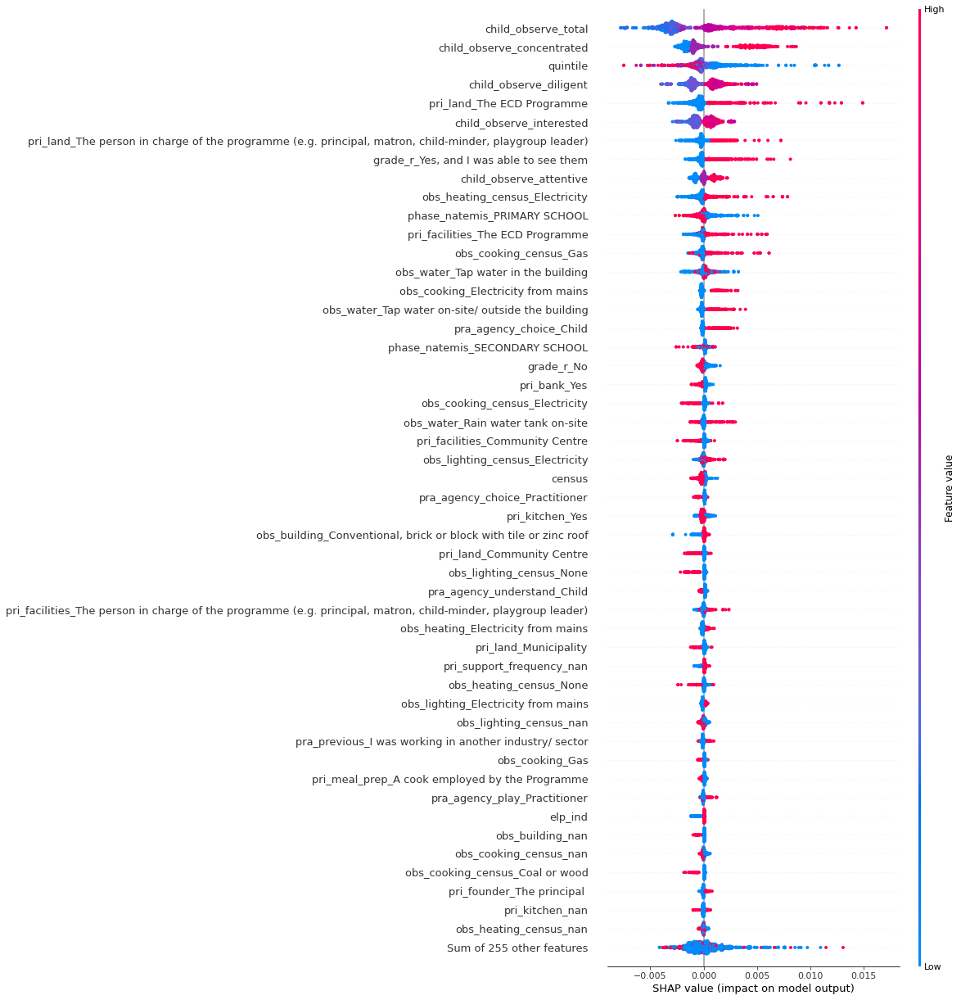

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_elom_facility


<Figure size 1080x1800 with 0 Axes>

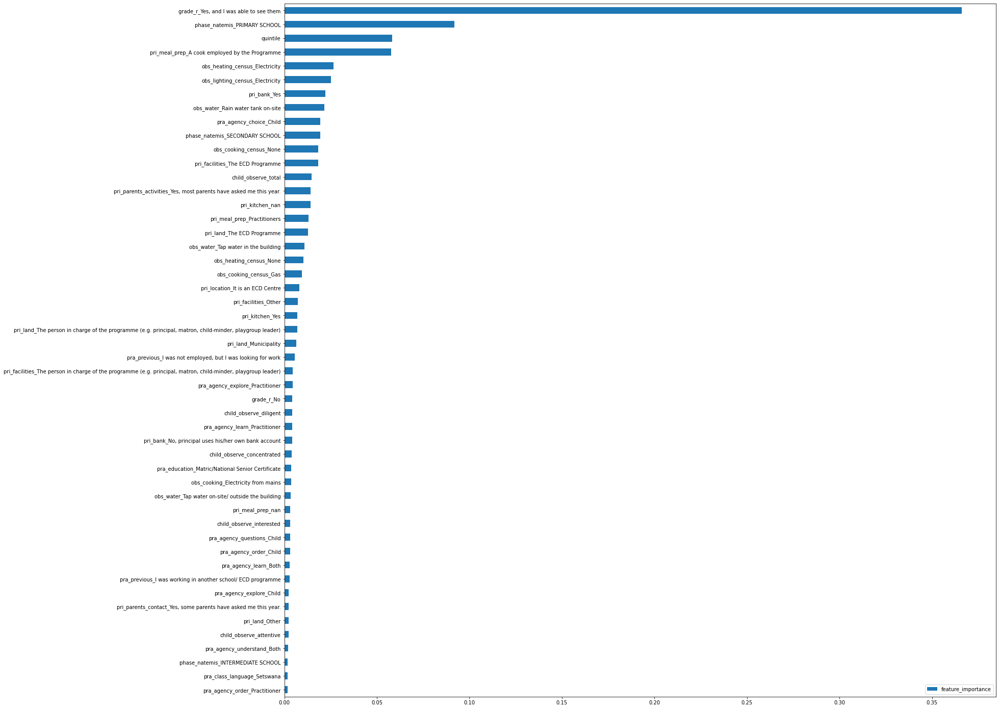

,feature_importance
"grade_r_Yes, and I was able to see them",0.366094
phase_natemis_PRIMARY SCHOOL,0.091815
quintile,0.058136
pri_meal_prep_A cook employed by the Programme,0.057733
obs_heating_census_Electricity,0.026538
obs_lighting_census_Electricity,0.025147
pri_bank_Yes,0.022271
obs_water_Rain water tank on-site,0.021595
pra_agency_choice_Child,0.019495
phase_natemis_SECONDARY SCHOOL,0.019488


100%|===================| 997/1000 [03:35<00:00]       

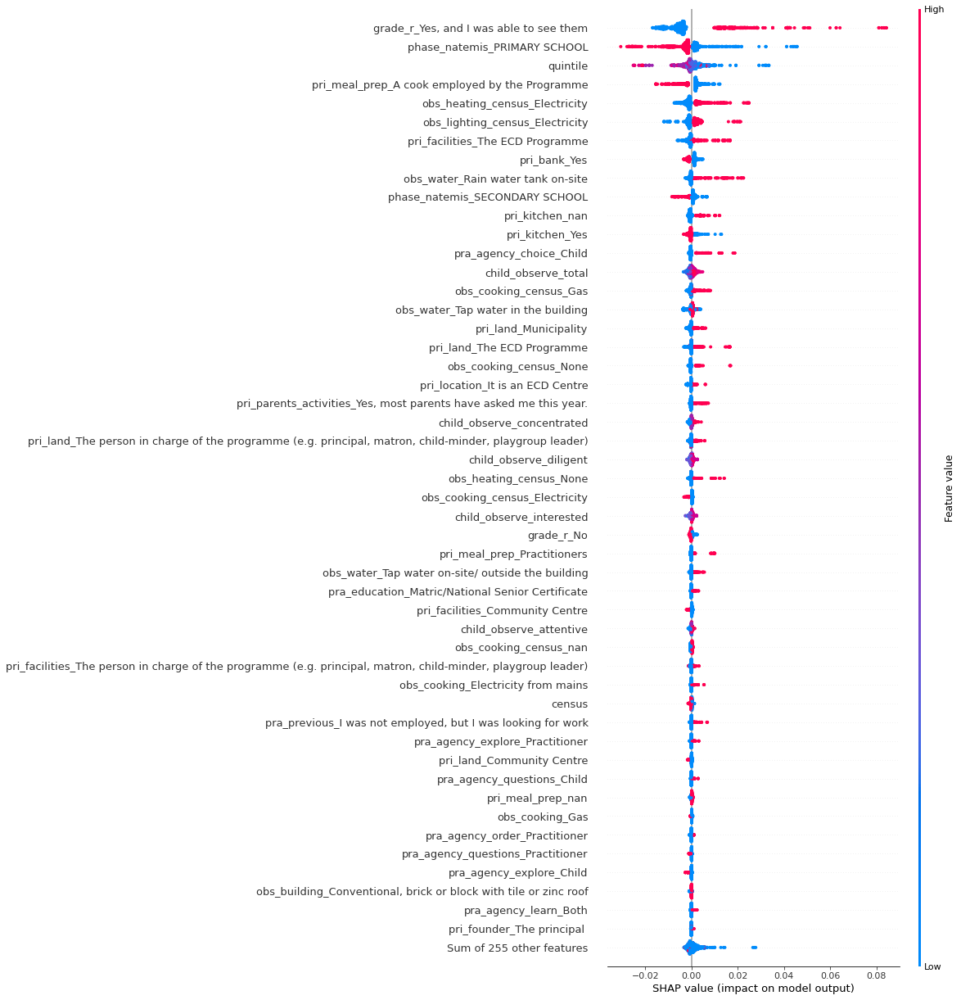

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_elom_ward


<Figure size 1080x1800 with 0 Axes>

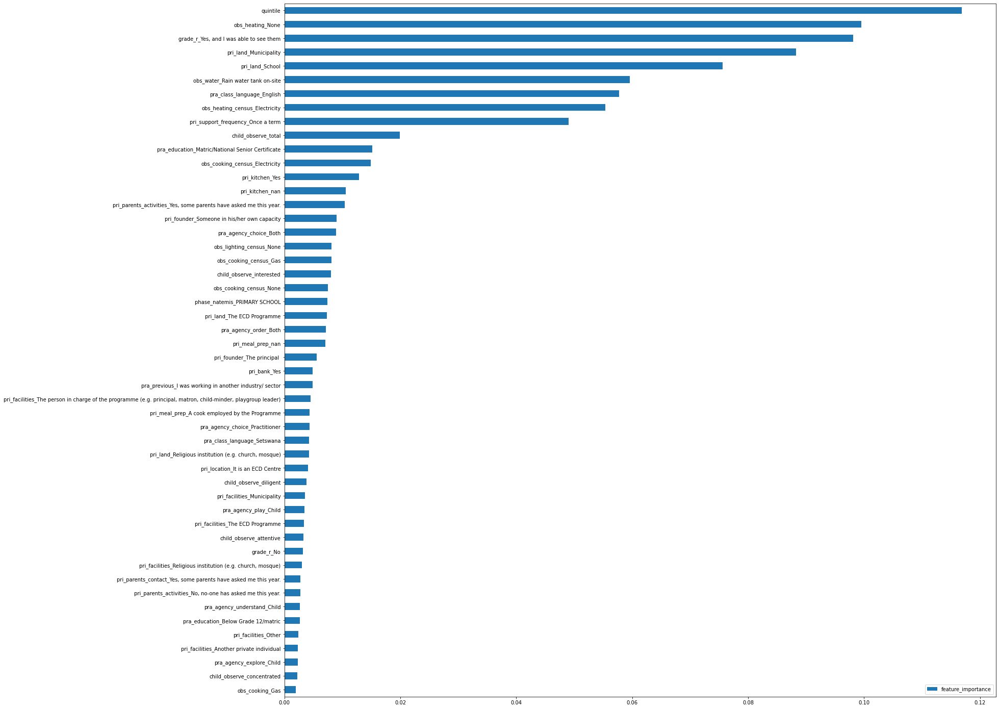

,feature_importance
quintile,0.116865
obs_heating_None,0.099492
"grade_r_Yes, and I was able to see them",0.098123
pri_land_Municipality,0.088259
pri_land_School,0.075573
obs_water_Rain water tank on-site,0.059583
pra_class_language_English,0.057727
obs_heating_census_Electricity,0.055350
pri_support_frequency_Once a term,0.049020
child_observe_total,0.019938


100%|===================| 995/1000 [03:28<00:01]       

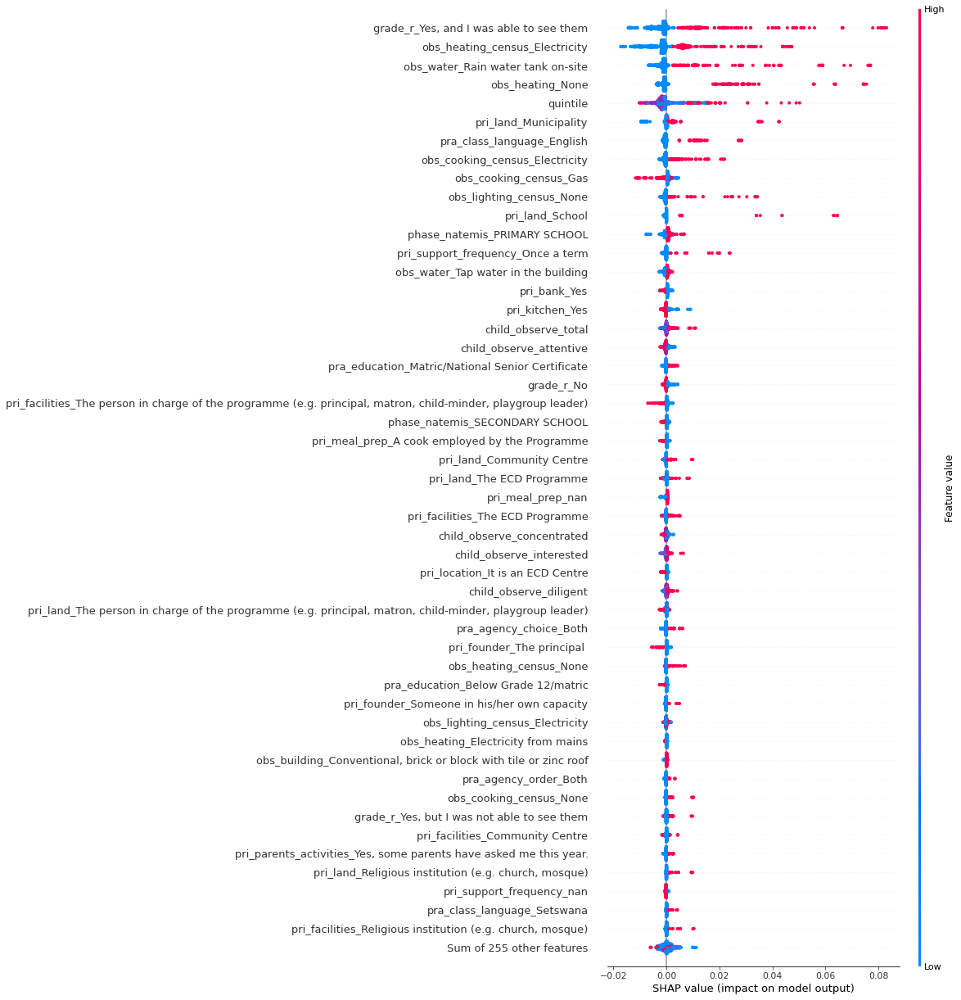

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_elom_dc


<Figure size 1080x1800 with 0 Axes>

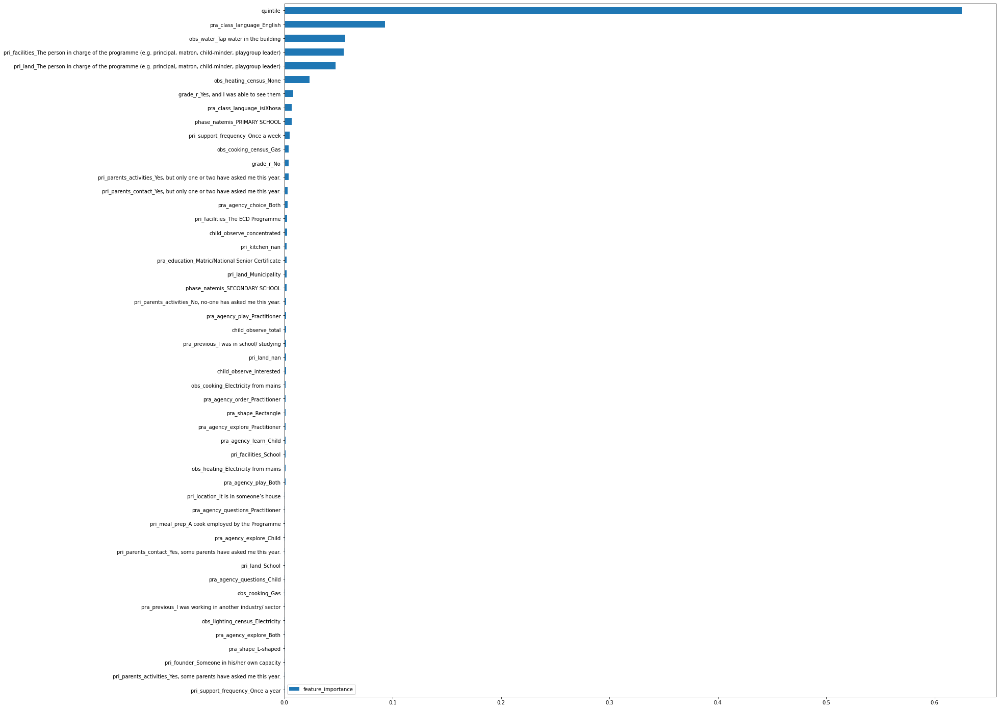

,feature_importance
quintile,0.625112
pra_class_language_English,0.093083
obs_water_Tap water in the building,0.056219
"pri_facilities_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.054757
"pri_land_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.047381
obs_heating_census_None,0.023068
"grade_r_Yes, and I was able to see them",0.008038
pra_class_language_isiXhosa,0.006852
phase_natemis_PRIMARY SCHOOL,0.006740
pri_support_frequency_Once a week,0.004876


100%|===================| 998/1000 [03:27<00:00]       

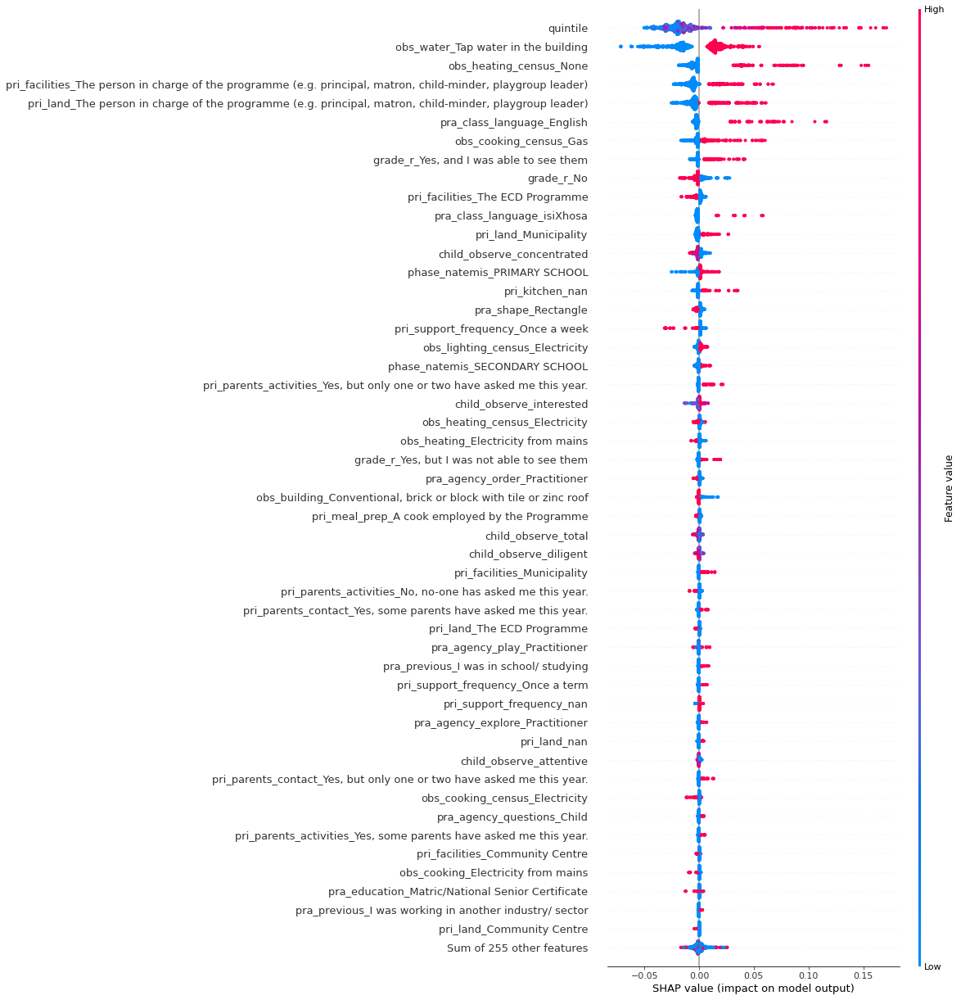

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_elom_mn


<Figure size 1080x1800 with 0 Axes>

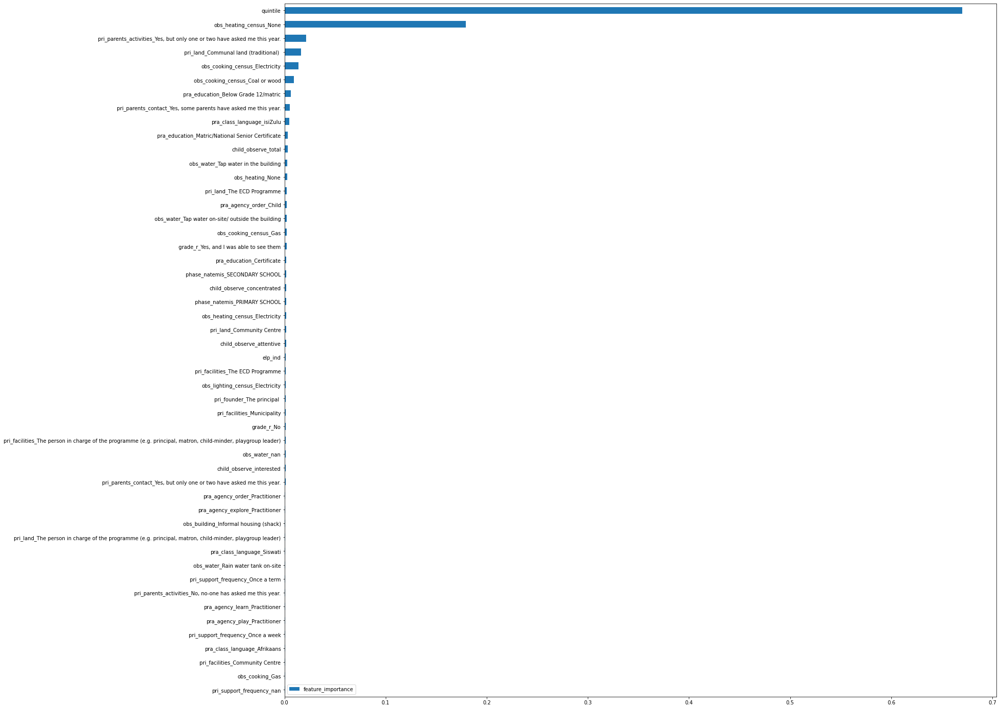

,feature_importance
quintile,0.670242
obs_heating_census_None,0.179235
"pri_parents_activities_Yes, but only one or two have asked me this year.",0.021405
pri_land_Communal land (traditional),0.016320
obs_cooking_census_Electricity,0.013592
obs_cooking_census_Coal or wood,0.009543
pra_education_Below Grade 12/matric,0.006384
"pri_parents_contact_Yes, some parents have asked me this year.",0.005343
pra_class_language_isiZulu,0.004723
pra_education_Matric/National Senior Certificate,0.003214


100%|===================| 999/1000 [03:23<00:00]       

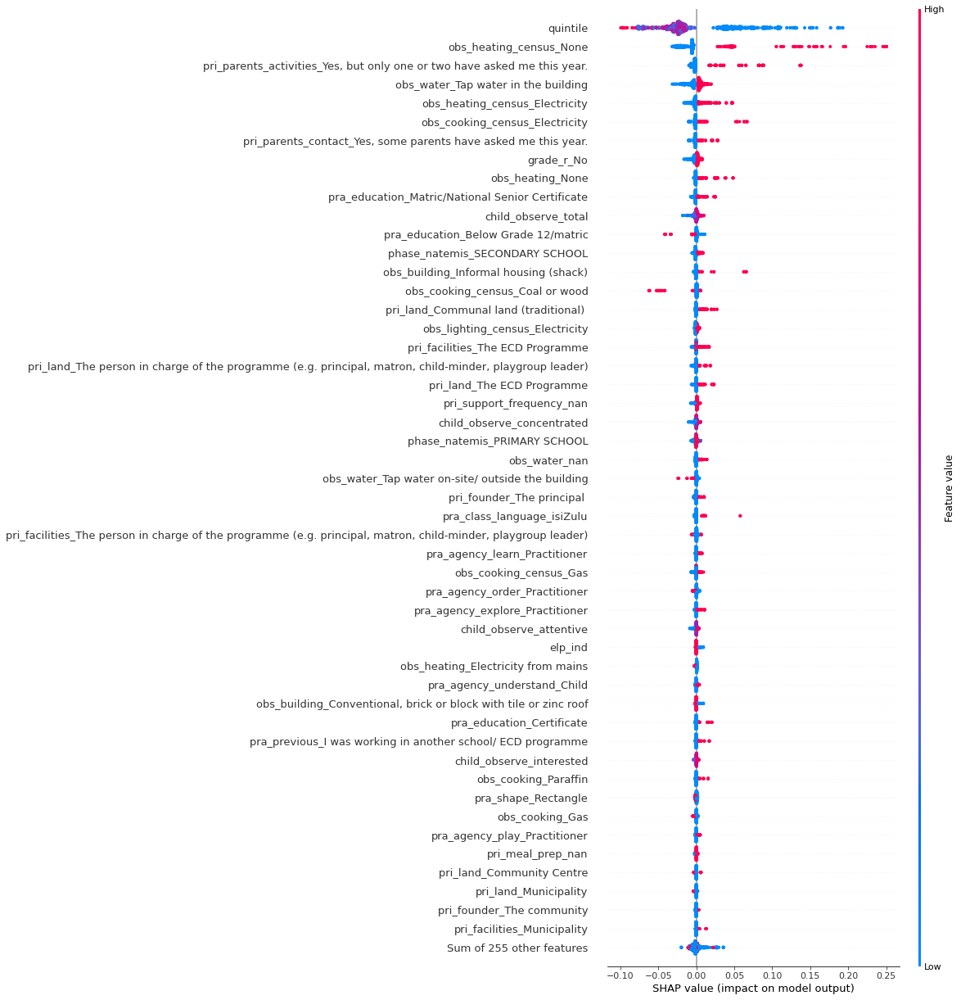

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_facility


<Figure size 1080x1800 with 0 Axes>

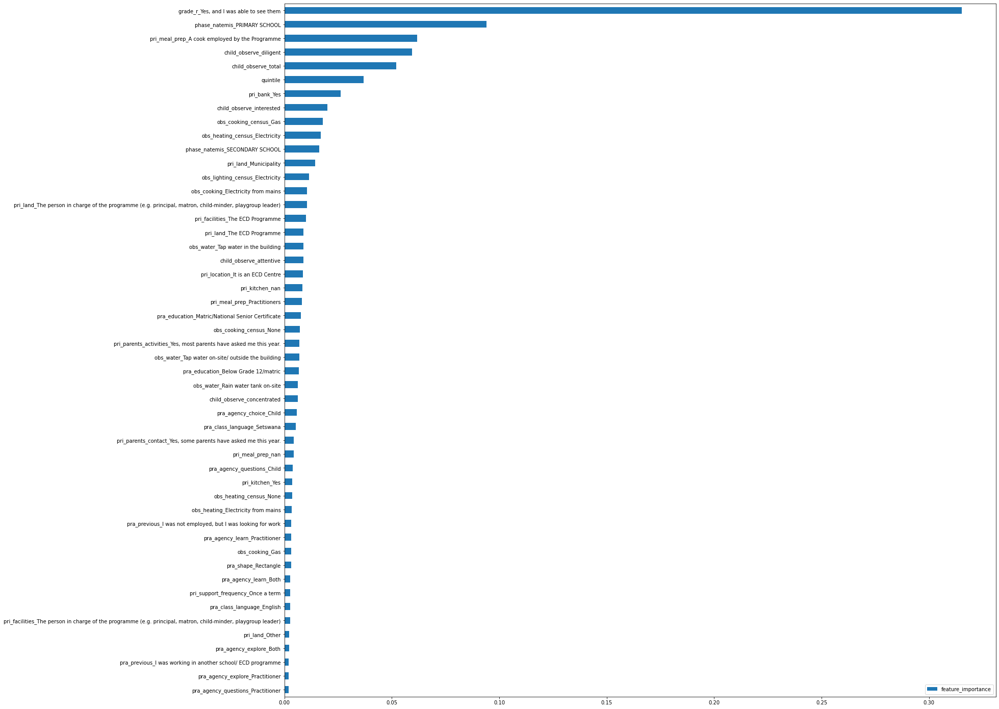

,feature_importance
"grade_r_Yes, and I was able to see them",0.315295
phase_natemis_PRIMARY SCHOOL,0.094177
pri_meal_prep_A cook employed by the Programme,0.061902
child_observe_diligent,0.059461
child_observe_total,0.052018
quintile,0.036941
pri_bank_Yes,0.026289
child_observe_interested,0.020012
obs_cooking_census_Gas,0.017966
obs_heating_census_Electricity,0.017047


100%|===================| 997/1000 [03:21<00:00]       

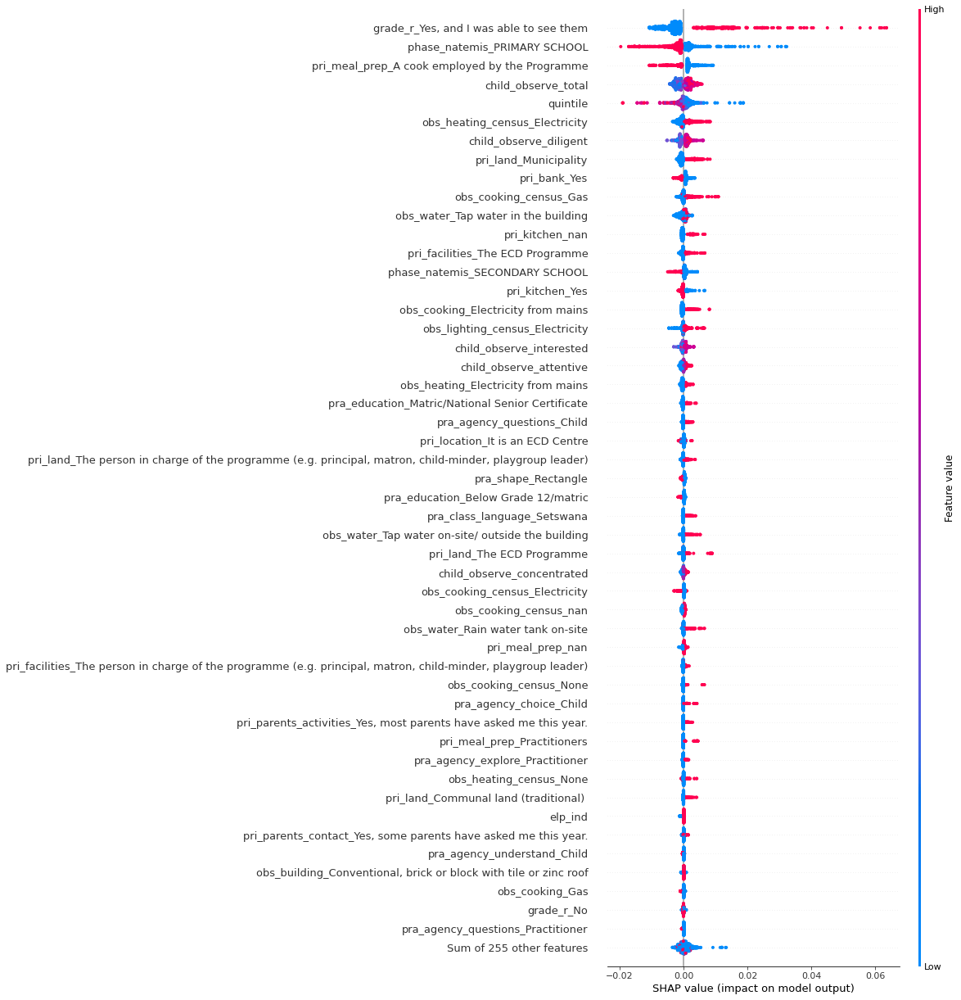

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_ward


<Figure size 1080x1800 with 0 Axes>

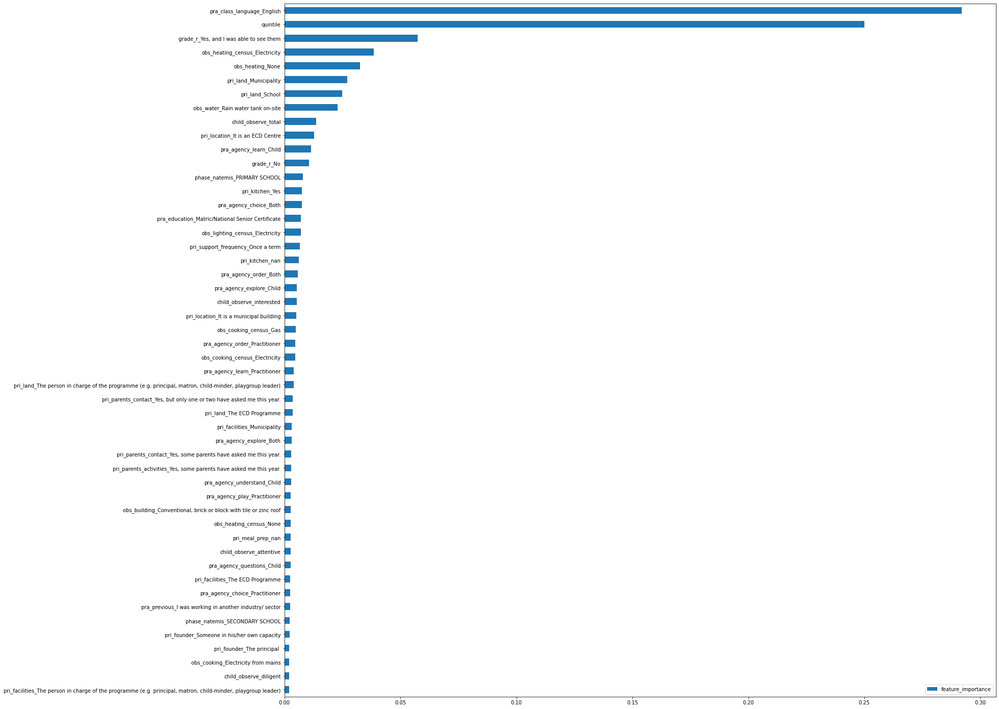

,feature_importance
pra_class_language_English,0.292017
quintile,0.250059
"grade_r_Yes, and I was able to see them",0.057508
obs_heating_census_Electricity,0.038650
obs_heating_None,0.032541
pri_land_Municipality,0.027156
pri_land_School,0.024979
obs_water_Rain water tank on-site,0.023036
child_observe_total,0.013659
pri_location_It is an ECD Centre,0.012752


100%|===================| 997/1000 [03:17<00:00]       

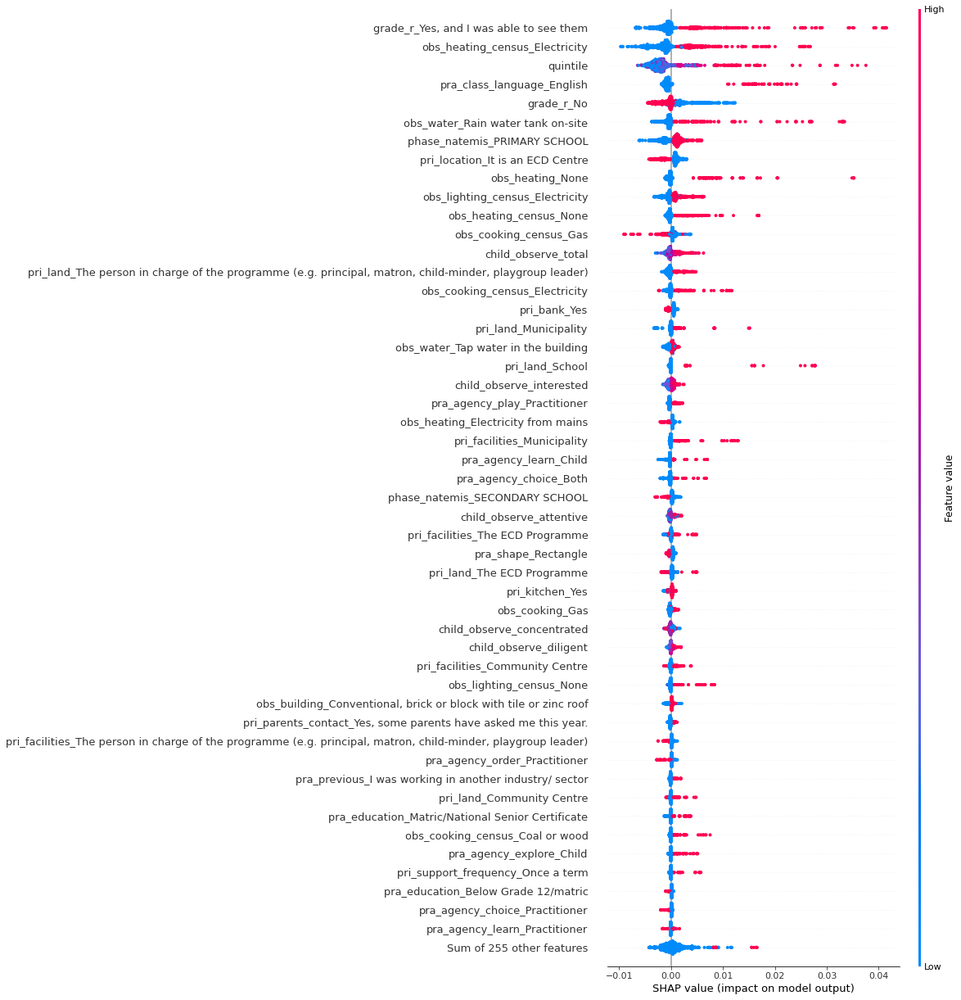

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_mn


<Figure size 1080x1800 with 0 Axes>

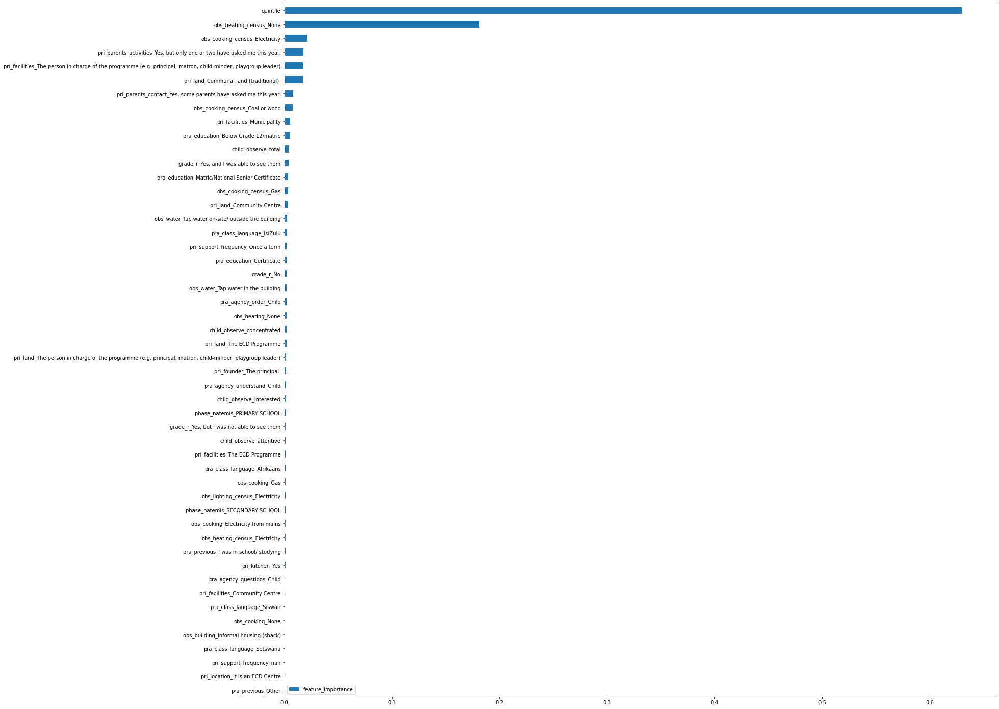

,feature_importance
quintile,0.629812
obs_heating_census_None,0.181109
obs_cooking_census_Electricity,0.021248
"pri_parents_activities_Yes, but only one or two have asked me this year.",0.017711
"pri_facilities_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.017309
pri_land_Communal land (traditional),0.017114
"pri_parents_contact_Yes, some parents have asked me this year.",0.008041
obs_cooking_census_Coal or wood,0.007613
pri_facilities_Municipality,0.005322
pra_education_Below Grade 12/matric,0.004972


100%|===================| 996/1000 [03:12<00:00]       

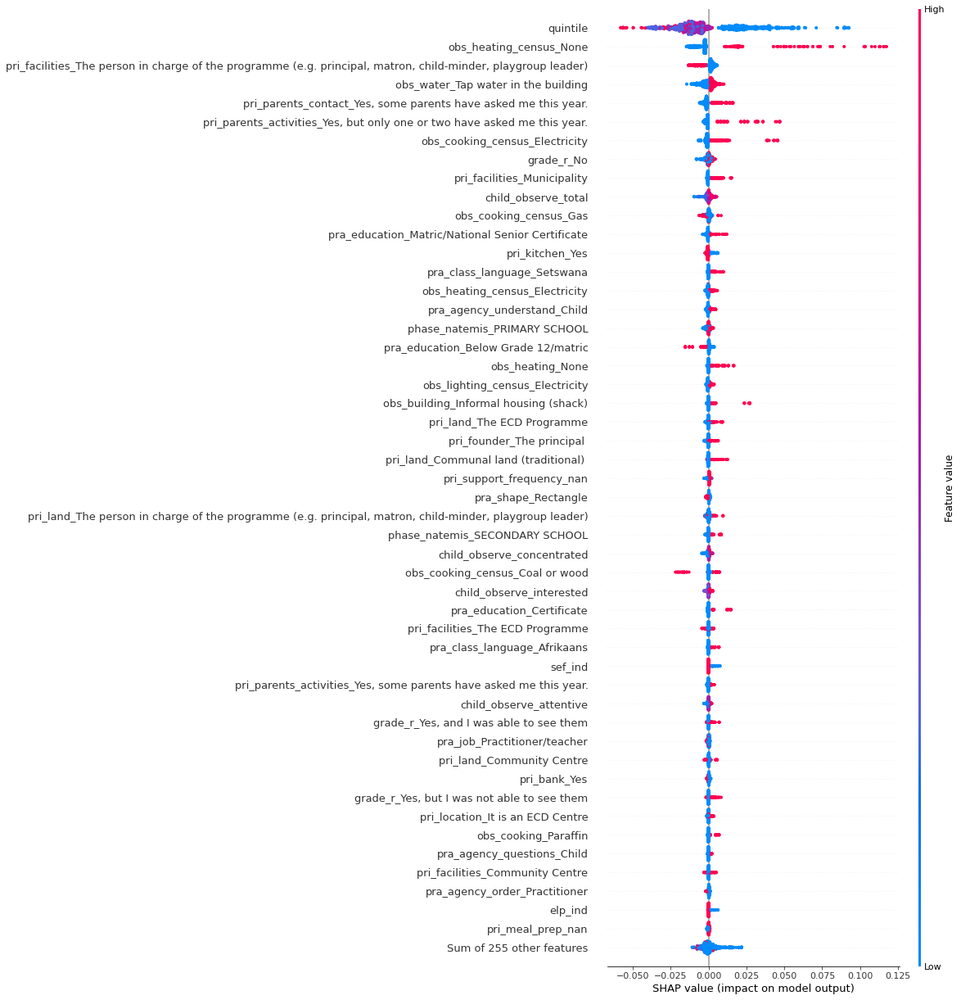

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_dc


<Figure size 1080x1800 with 0 Axes>

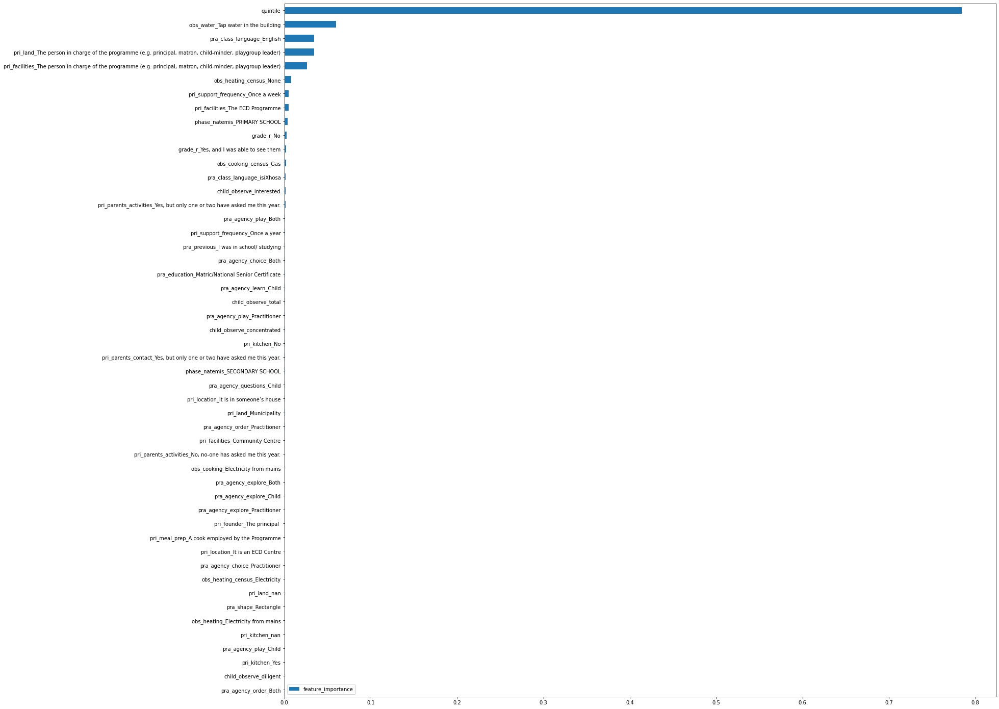

,feature_importance
quintile,0.784425
obs_water_Tap water in the building,0.060067
pra_class_language_English,0.034560
"pri_land_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.034414
"pri_facilities_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.026515
obs_heating_census_None,0.007811
pri_support_frequency_Once a week,0.005244
pri_facilities_The ECD Programme,0.004975
phase_natemis_PRIMARY SCHOOL,0.004039
grade_r_No,0.002321


100%|===================| 999/1000 [03:12<00:00]       

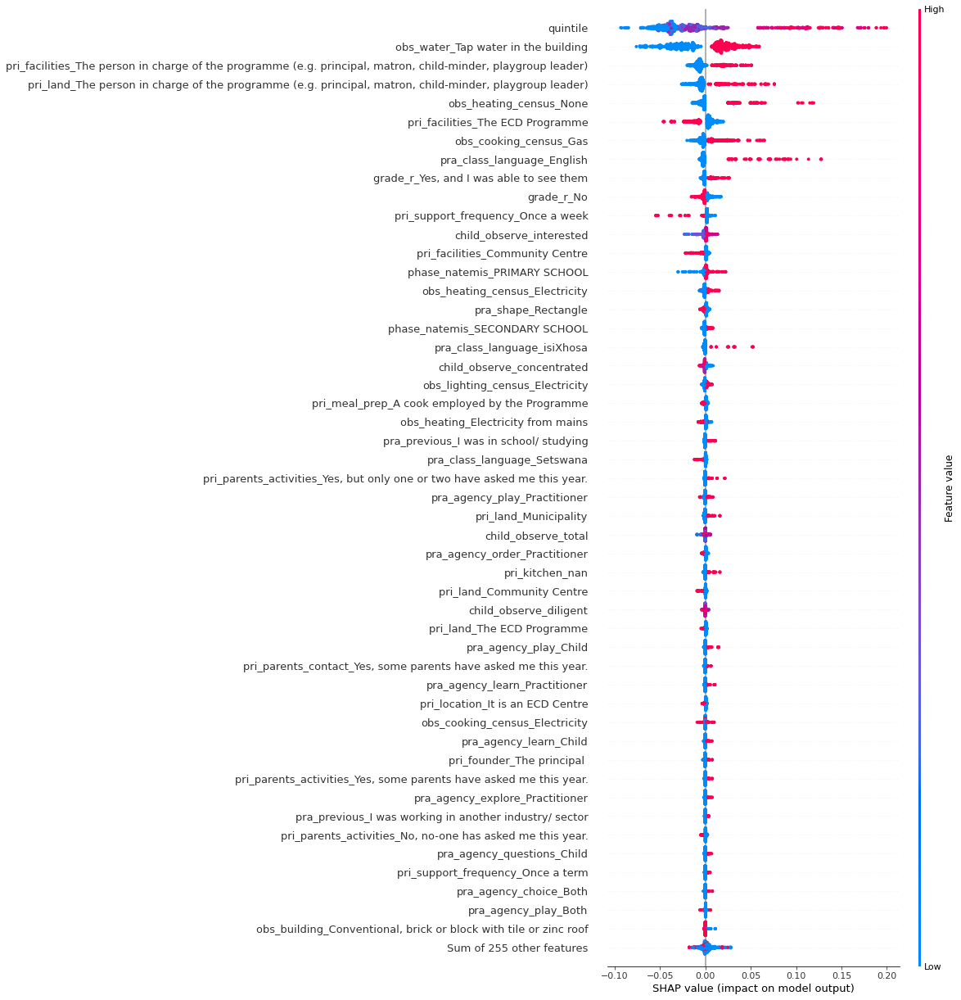

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_1_CHILD


<Figure size 1080x1800 with 0 Axes>

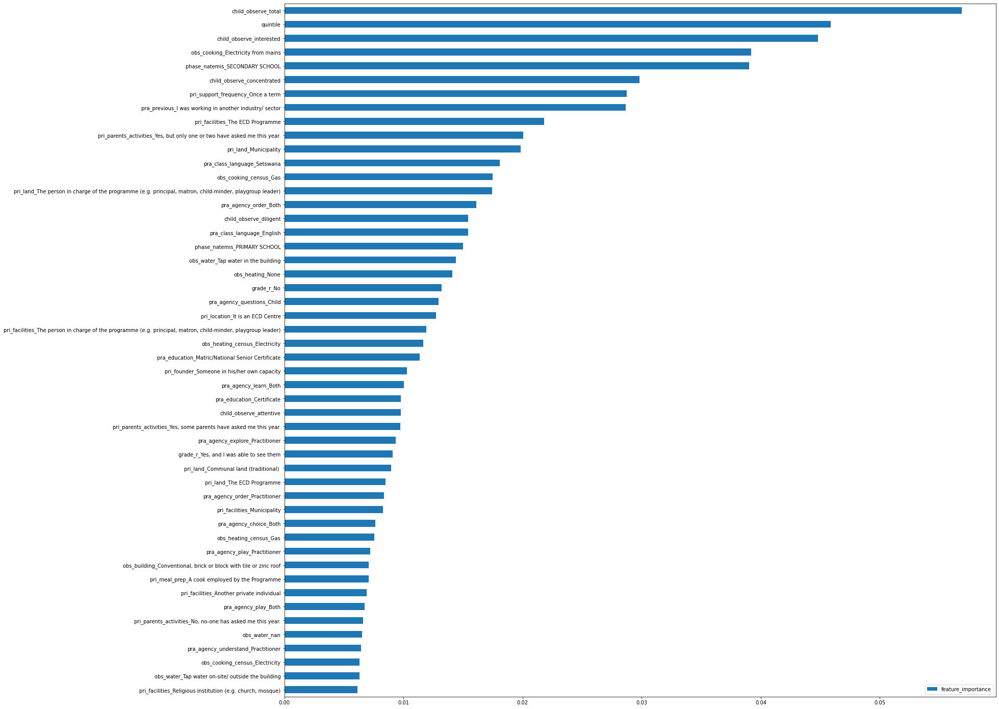

,feature_importance
child_observe_total,0.056879
quintile,0.045853
child_observe_interested,0.044792
obs_cooking_Electricity from mains,0.039195
phase_natemis_SECONDARY SCHOOL,0.039011
child_observe_concentrated,0.029812
pri_support_frequency_Once a term,0.028733
pra_previous_I was working in another industry/ sector,0.028657
pri_facilities_The ECD Programme,0.021813
"pri_parents_activities_Yes, but only one or two have asked me this year.",0.020075


100%|===================| 997/1000 [03:26<00:00]       

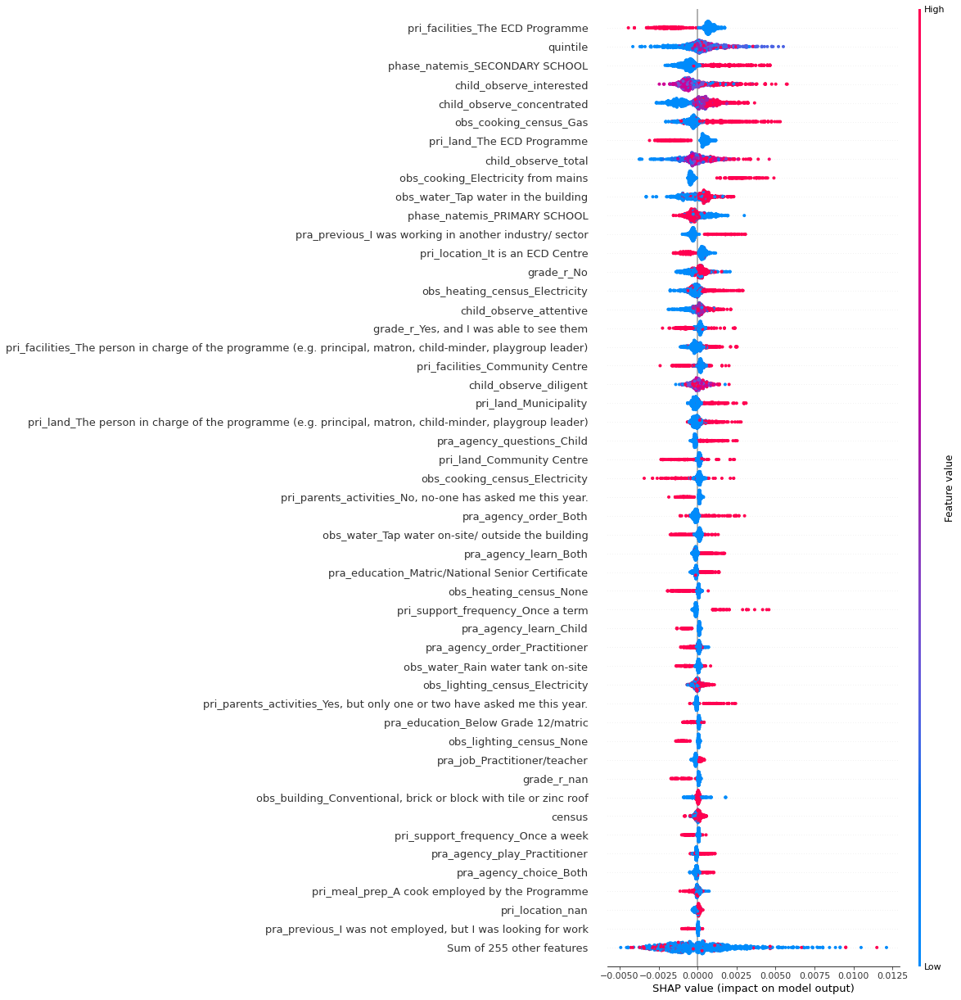

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_2_CHILD


<Figure size 1080x1800 with 0 Axes>

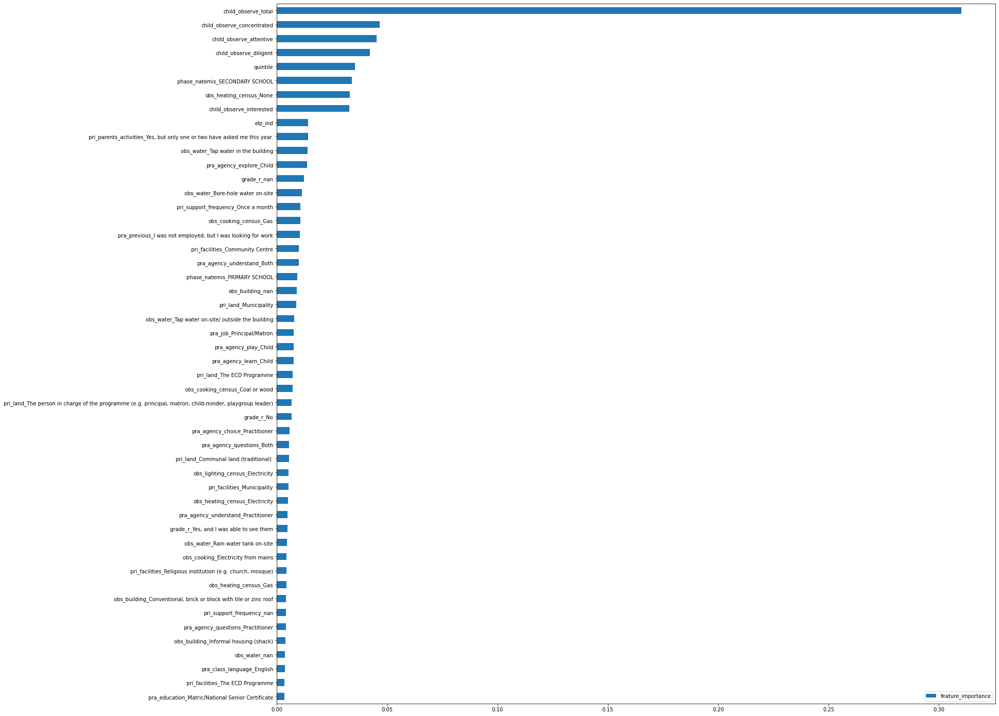

,feature_importance
child_observe_total,0.310142
child_observe_concentrated,0.046652
child_observe_attentive,0.045318
child_observe_diligent,0.042252
quintile,0.035301
phase_natemis_SECONDARY SCHOOL,0.033891
obs_heating_census_None,0.033075
child_observe_interested,0.032777
elp_ind,0.014255
"pri_parents_activities_Yes, but only one or two have asked me this year.",0.014142


100%|===================| 995/1000 [03:17<00:00]       

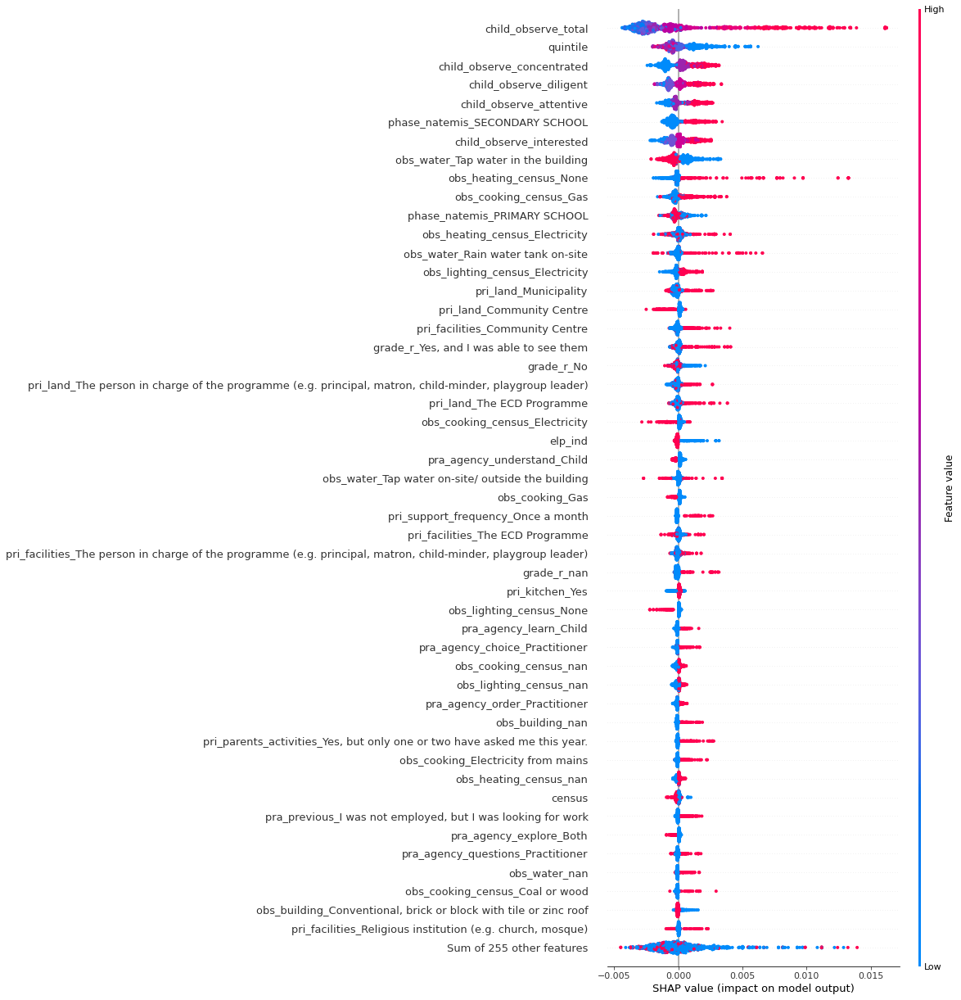

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_3_CHILD


<Figure size 1080x1800 with 0 Axes>

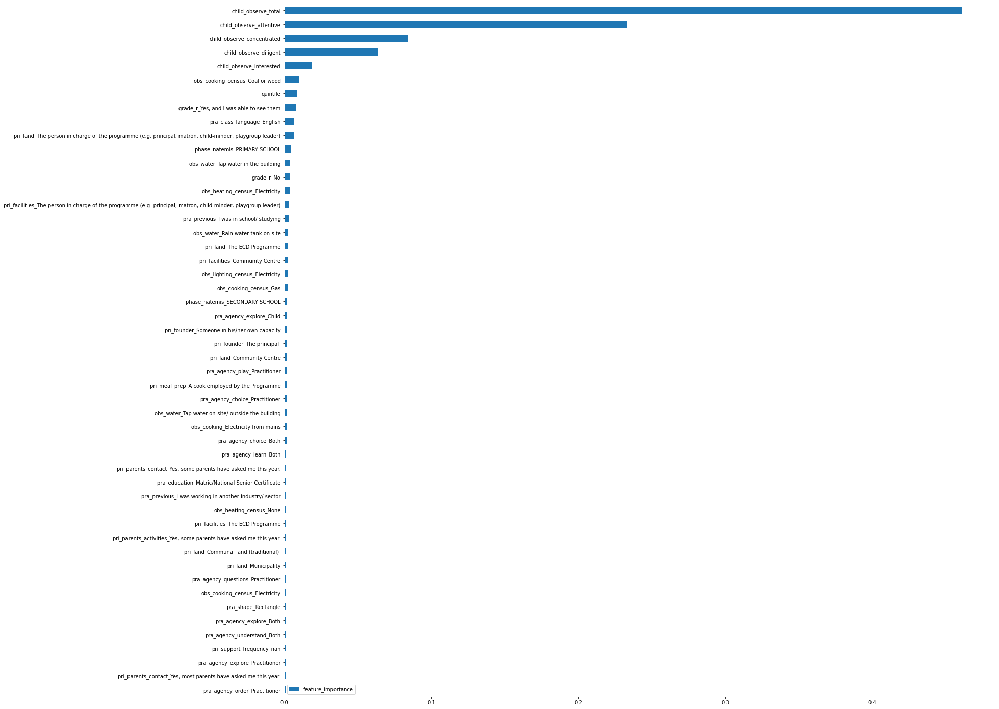

,feature_importance
child_observe_total,0.460894
child_observe_attentive,0.232981
child_observe_concentrated,0.084320
child_observe_diligent,0.063661
child_observe_interested,0.018810
obs_cooking_census_Coal or wood,0.009821
quintile,0.008605
"grade_r_Yes, and I was able to see them",0.007962
pra_class_language_English,0.006845
"pri_land_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.006238


100%|===================| 998/1000 [03:22<00:00]       

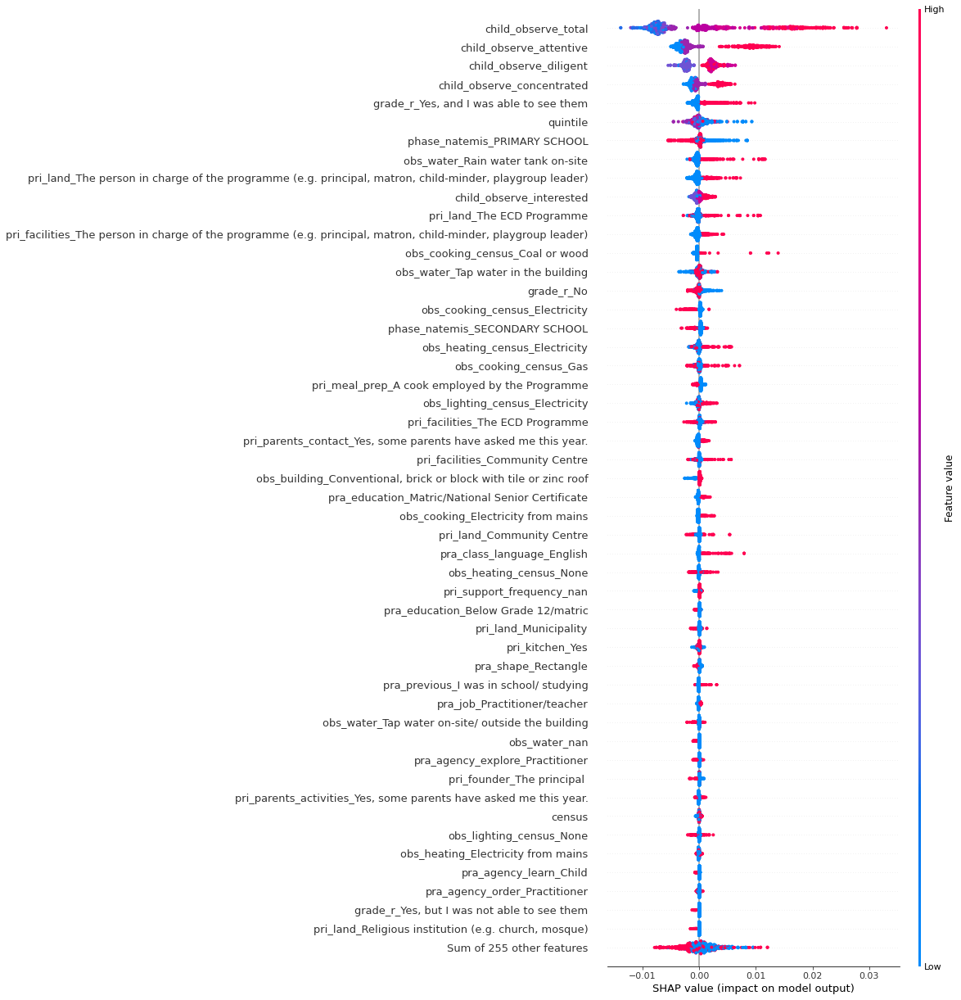

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_4_CHILD


<Figure size 1080x1800 with 0 Axes>

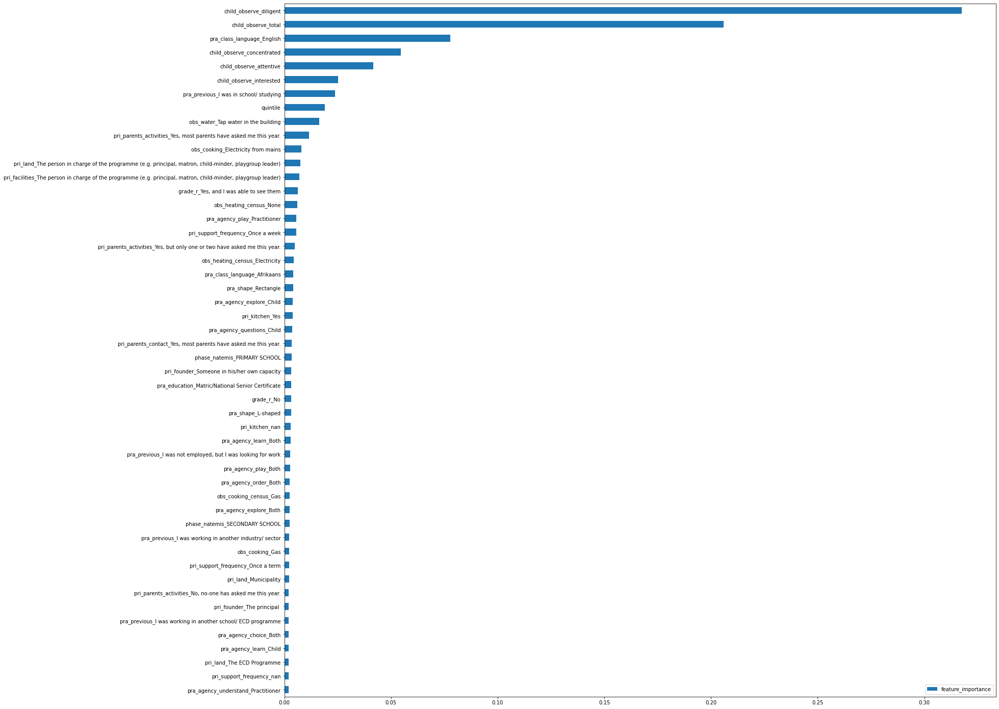

,feature_importance
child_observe_diligent,0.317583
child_observe_total,0.205827
pra_class_language_English,0.077727
child_observe_concentrated,0.054630
child_observe_attentive,0.041711
child_observe_interested,0.025252
pra_previous_I was in school/ studying,0.023831
quintile,0.018892
obs_water_Tap water in the building,0.016271
"pri_parents_activities_Yes, most parents have asked me this year.",0.011621


100%|===================| 999/1000 [03:27<00:00]       

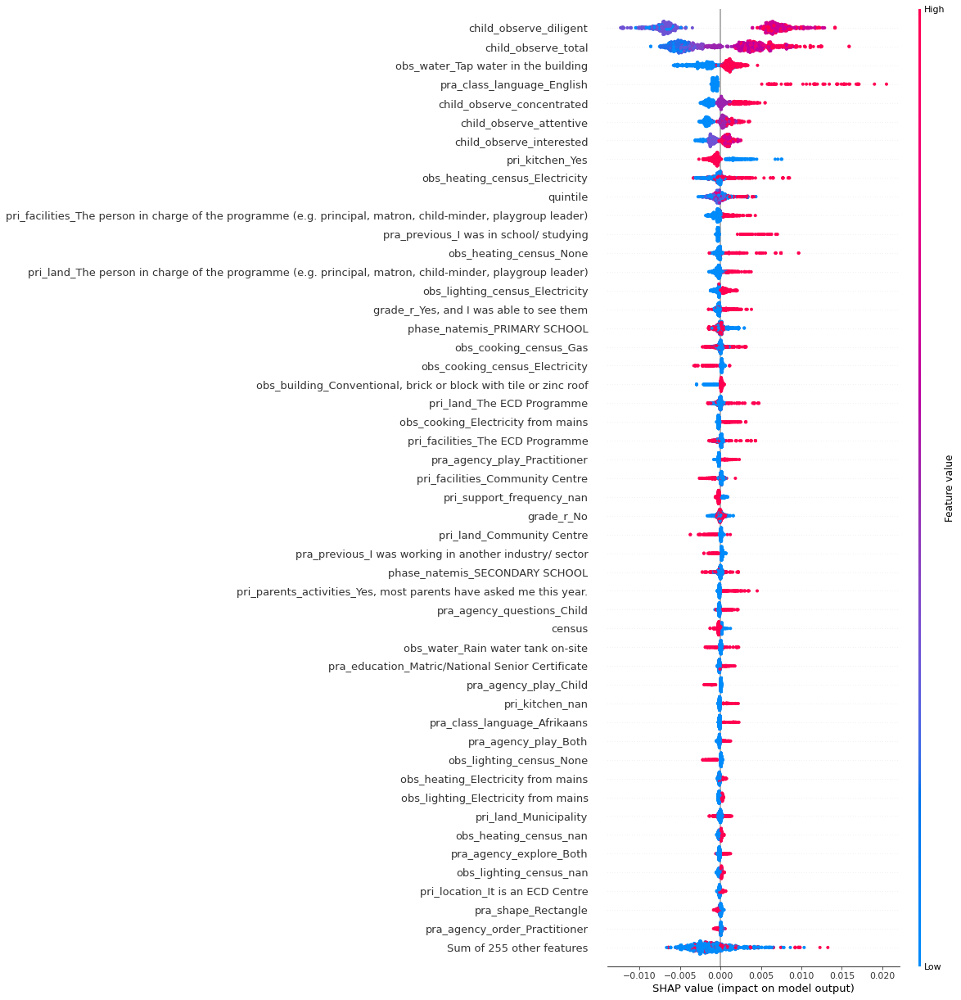

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_5_CHILD


<Figure size 1080x1800 with 0 Axes>

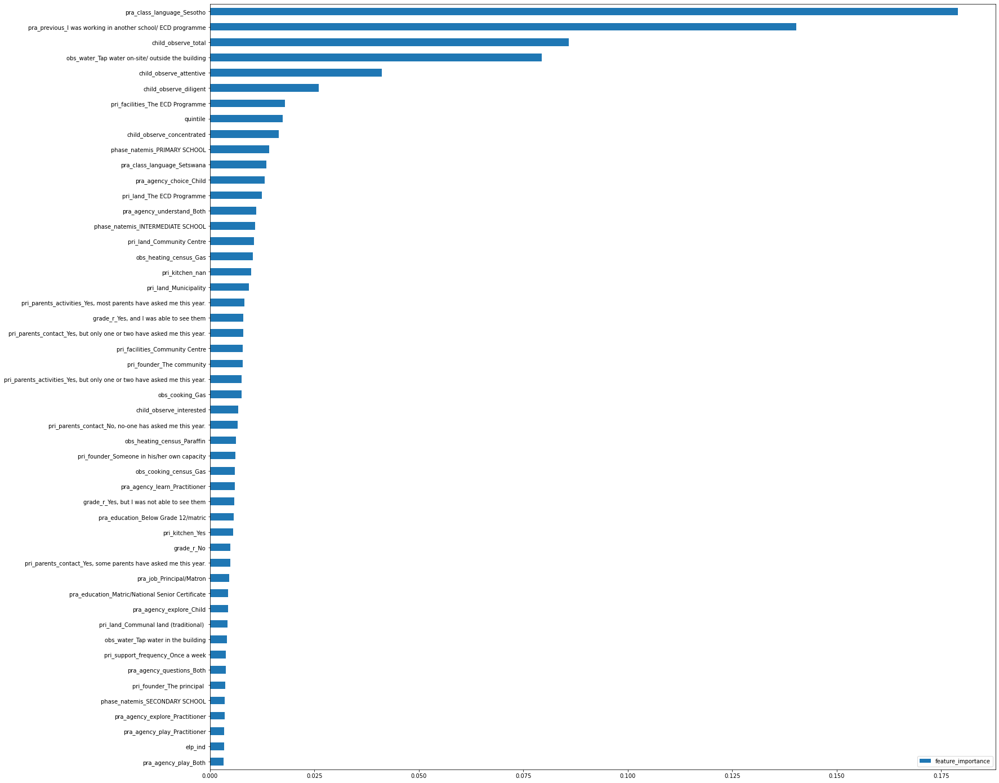

,feature_importance
pra_class_language_Sesotho,0.179037
pra_previous_I was working in another school/ ECD programme,0.140339
child_observe_total,0.085832
obs_water_Tap water on-site/ outside the building,0.079377
child_observe_attentive,0.041124
child_observe_diligent,0.026005
pri_facilities_The ECD Programme,0.018016
quintile,0.017395
child_observe_concentrated,0.016503
phase_natemis_PRIMARY SCHOOL,0.014145


100%|===================| 998/1000 [03:19<00:00]       

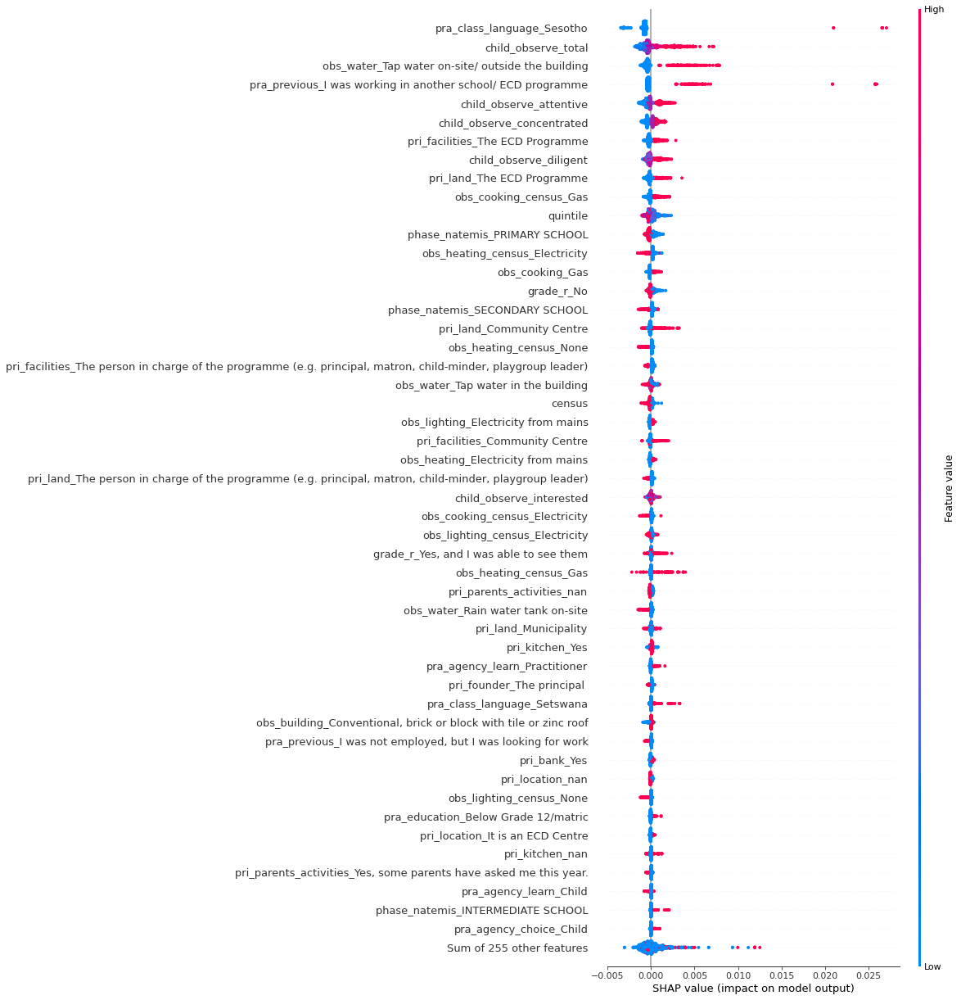

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_1_facility


<Figure size 1080x1800 with 0 Axes>

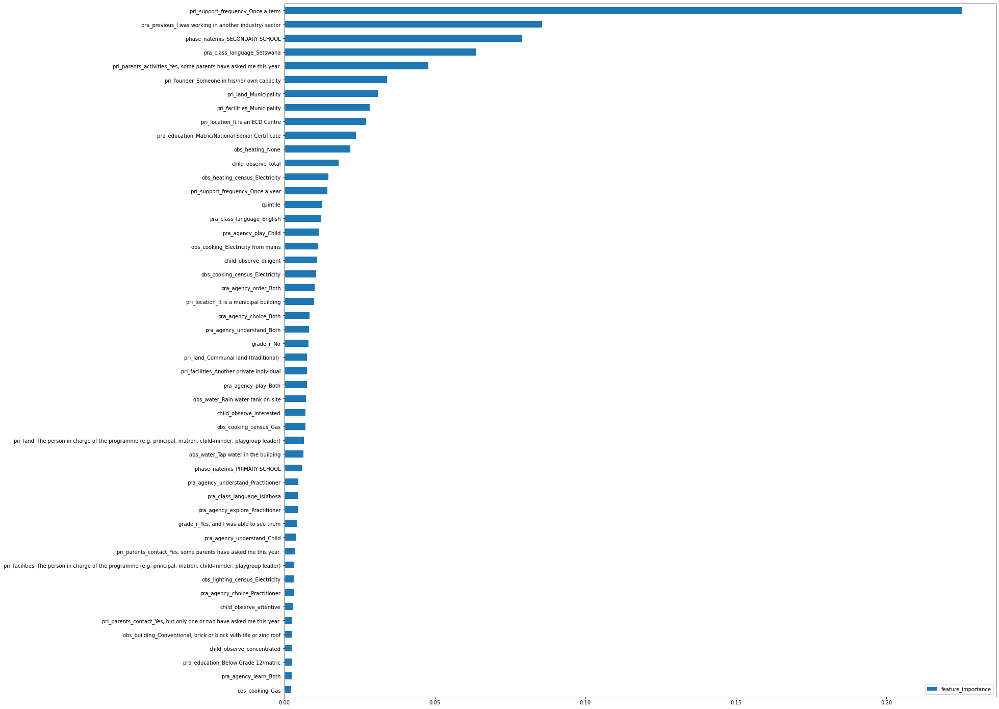

,feature_importance
pri_support_frequency_Once a term,0.225054
pra_previous_I was working in another industry/ sector,0.085537
phase_natemis_SECONDARY SCHOOL,0.079052
pra_class_language_Setswana,0.063715
"pri_parents_activities_Yes, some parents have asked me this year.",0.047849
pri_founder_Someone in his/her own capacity,0.034076
pri_land_Municipality,0.031082
pri_facilities_Municipality,0.028370
pri_location_It is an ECD Centre,0.027230
pra_education_Matric/National Senior Certificate,0.023716


100%|===================| 998/1000 [03:24<00:00]       

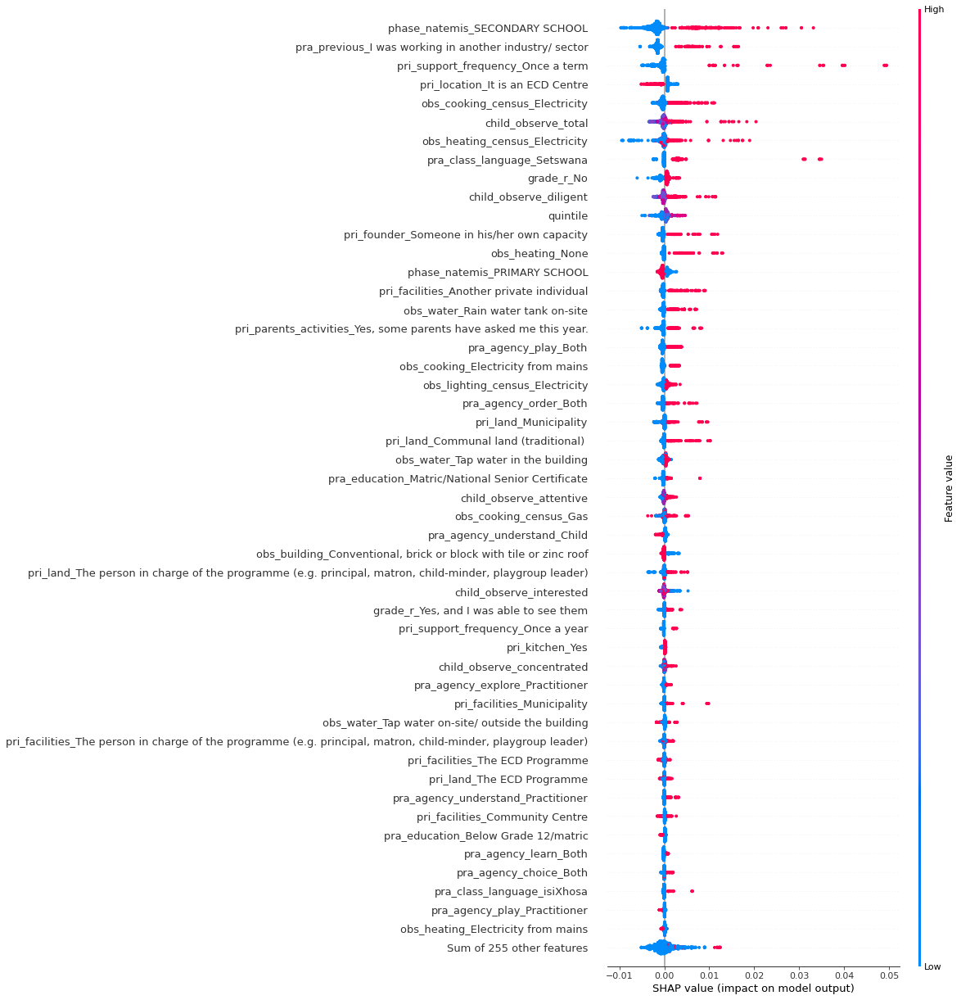

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_2_facility


<Figure size 1080x1800 with 0 Axes>

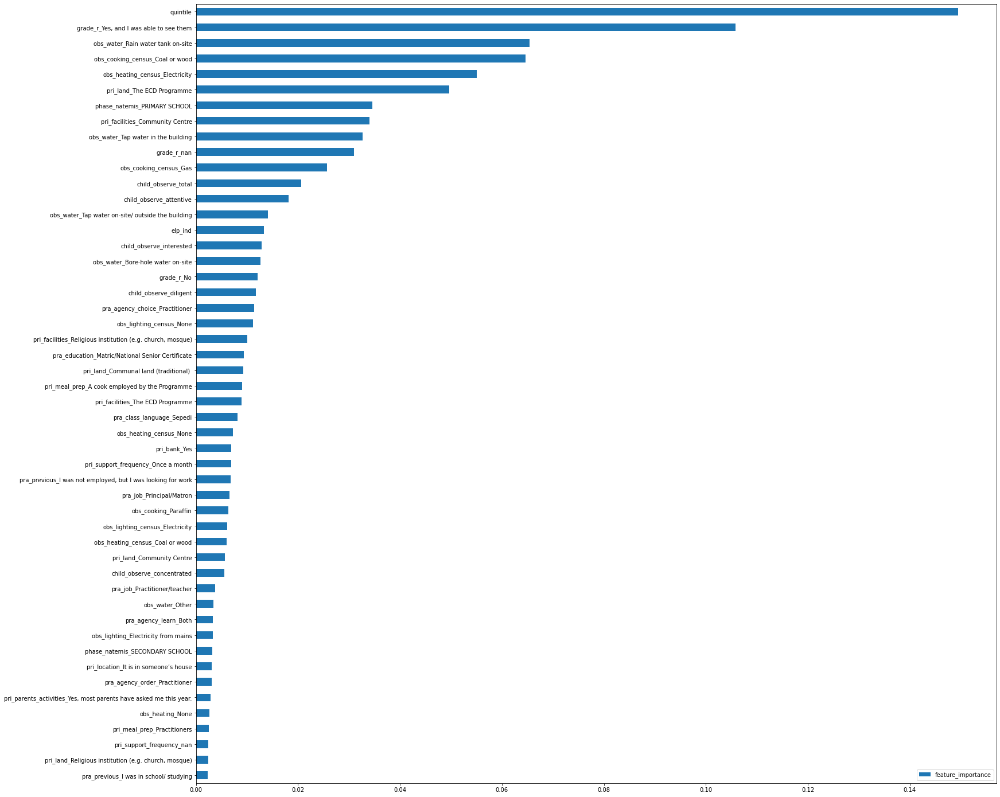

,feature_importance
quintile,0.149504
"grade_r_Yes, and I was able to see them",0.105810
obs_water_Rain water tank on-site,0.065363
obs_cooking_census_Coal or wood,0.064612
obs_heating_census_Electricity,0.055086
pri_land_The ECD Programme,0.049712
phase_natemis_PRIMARY SCHOOL,0.034606
pri_facilities_Community Centre,0.034044
obs_water_Tap water in the building,0.032615
grade_r_nan,0.030930


100%|===================| 995/1000 [03:24<00:01]       

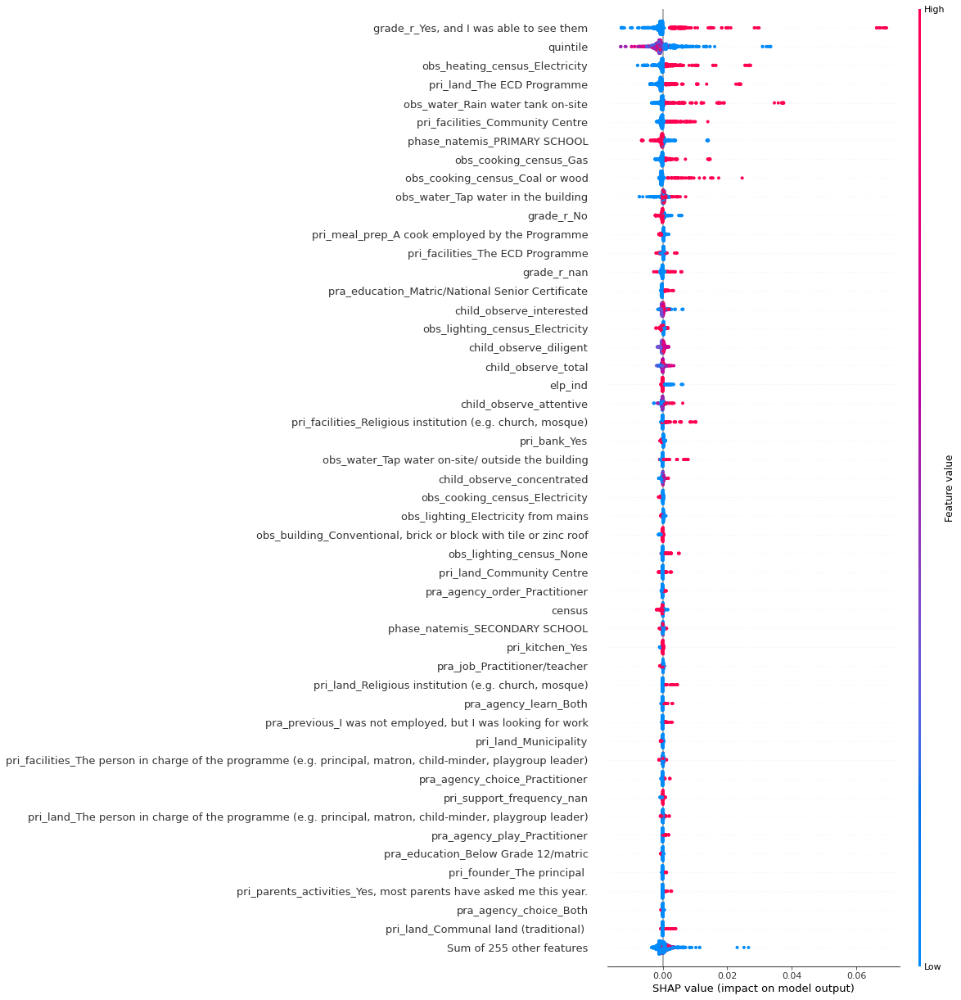

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_3_facility


<Figure size 1080x1800 with 0 Axes>

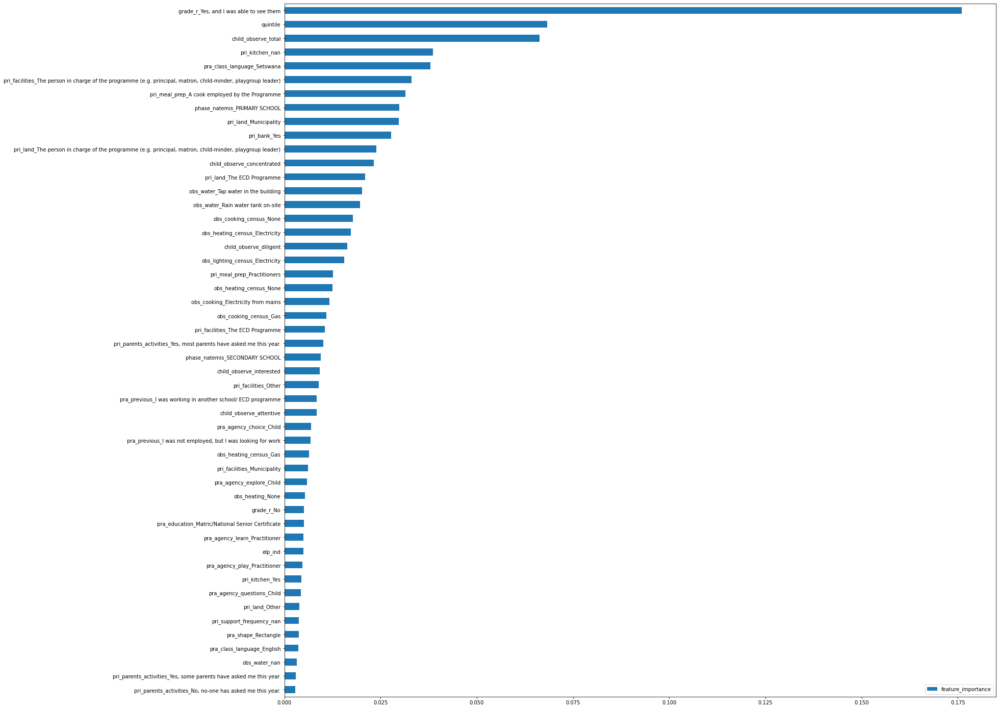

,feature_importance
"grade_r_Yes, and I was able to see them",0.176048
quintile,0.068302
child_observe_total,0.066361
pri_kitchen_nan,0.038612
pra_class_language_Setswana,0.037918
"pri_facilities_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.033094
pri_meal_prep_A cook employed by the Programme,0.031498
phase_natemis_PRIMARY SCHOOL,0.029844
pri_land_Municipality,0.029741
pri_bank_Yes,0.027808


100%|===================| 998/1000 [03:29<00:00]       

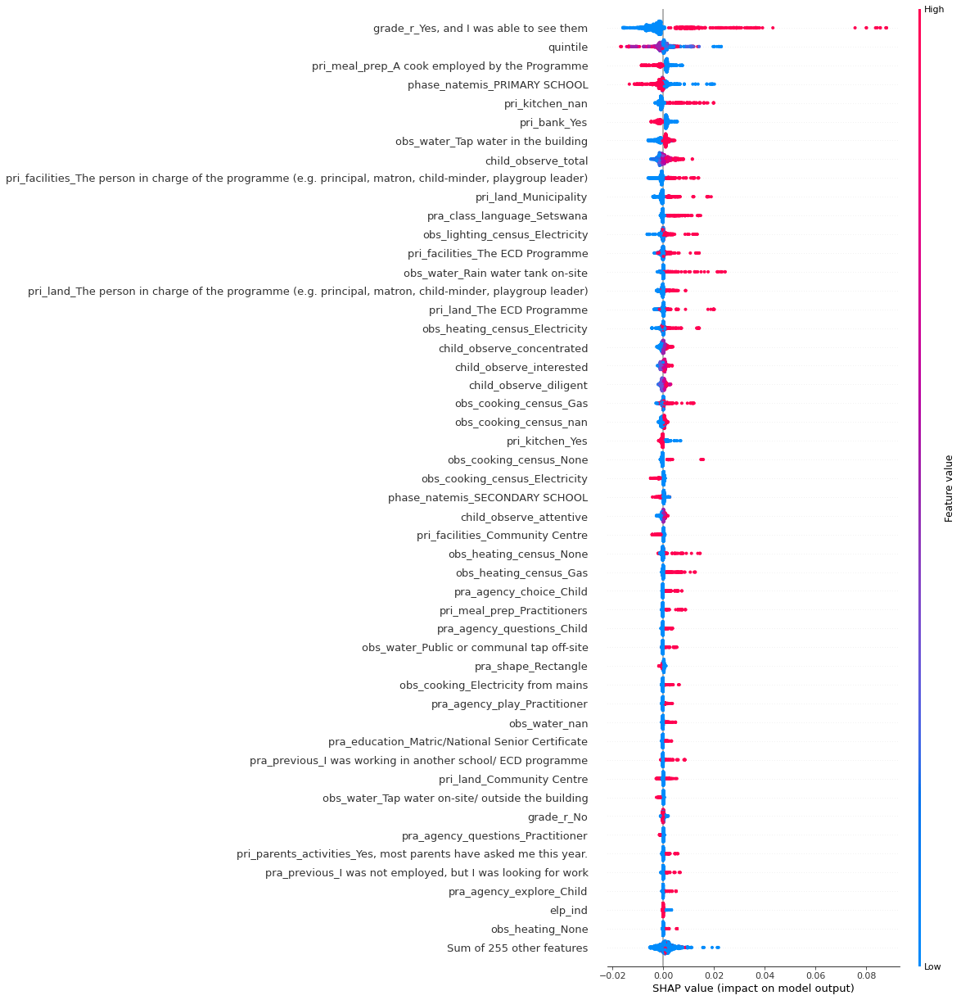

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_4_facility


<Figure size 1080x1800 with 0 Axes>

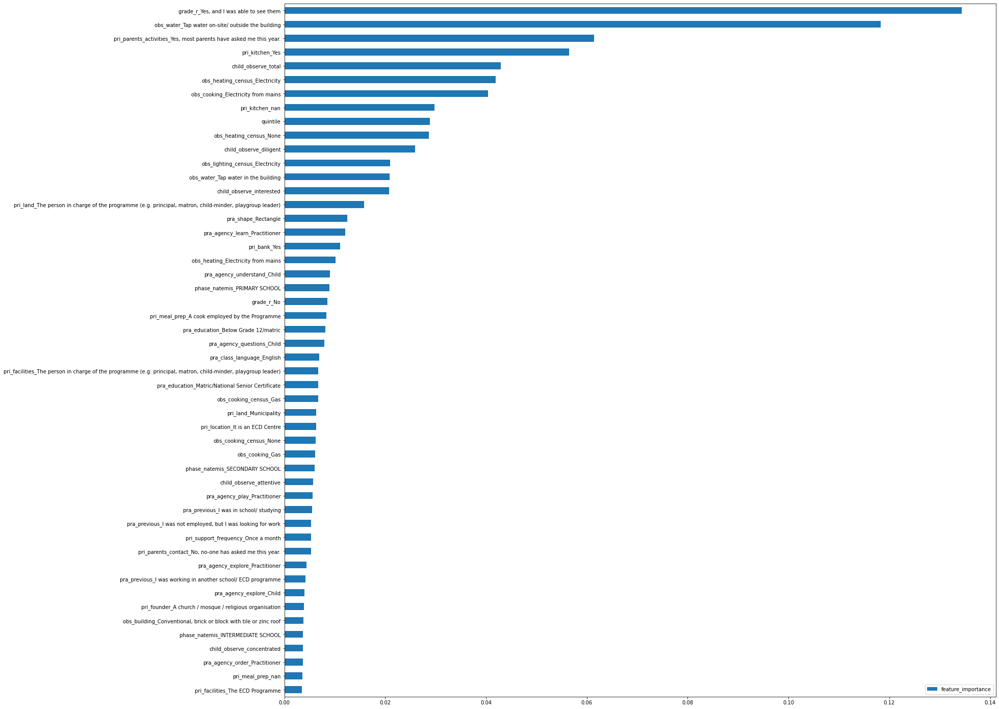

,feature_importance
"grade_r_Yes, and I was able to see them",0.134398
obs_water_Tap water on-site/ outside the building,0.118275
"pri_parents_activities_Yes, most parents have asked me this year.",0.061481
pri_kitchen_Yes,0.056493
child_observe_total,0.042905
obs_heating_census_Electricity,0.041957
obs_cooking_Electricity from mains,0.040402
pri_kitchen_nan,0.029785
quintile,0.028838
obs_heating_census_None,0.028664


100%|===================| 999/1000 [03:25<00:00]       

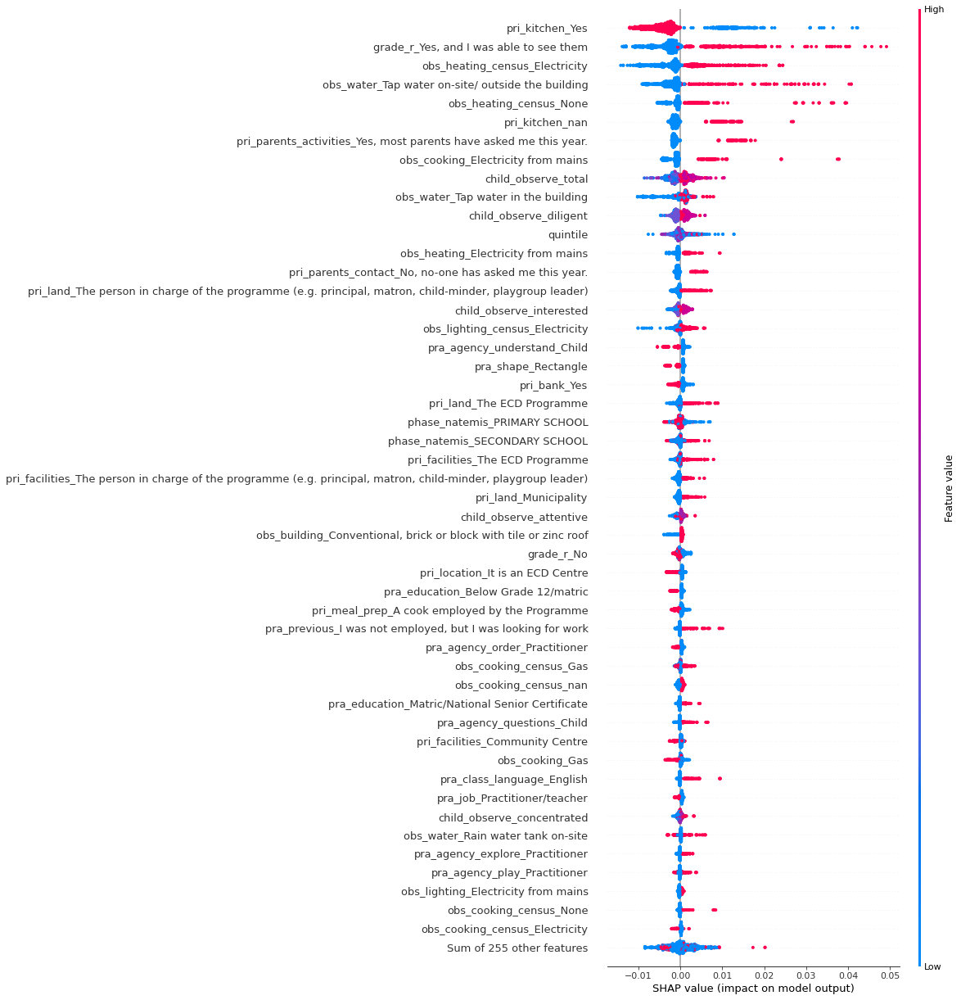

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_5_facility


<Figure size 1080x1800 with 0 Axes>

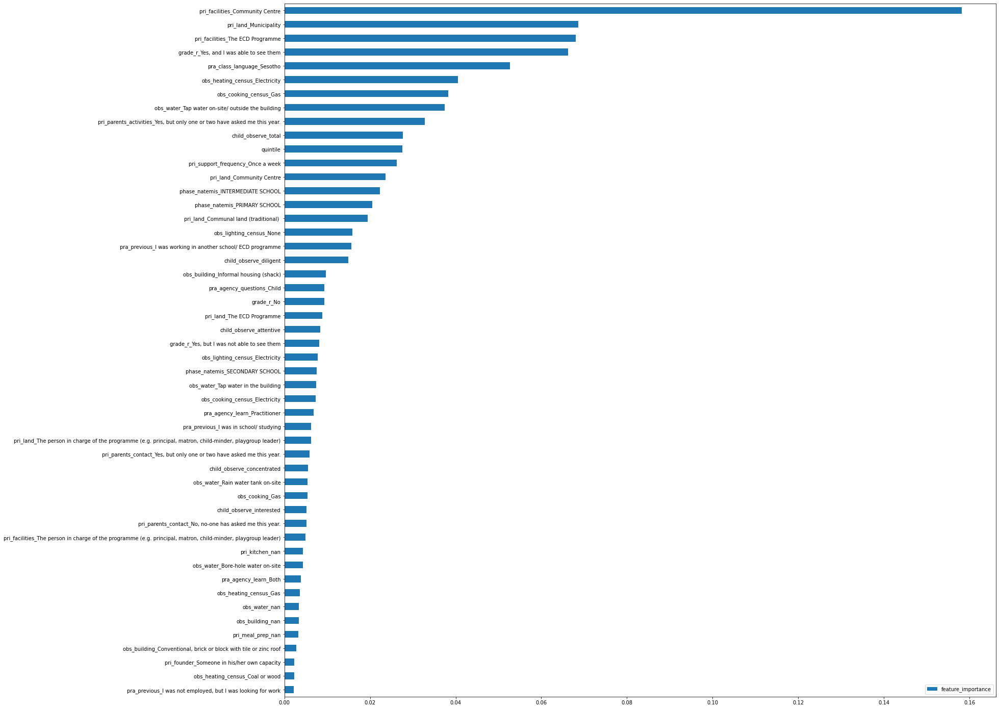

,feature_importance
pri_facilities_Community Centre,0.158189
pri_land_Municipality,0.068683
pri_facilities_The ECD Programme,0.068036
"grade_r_Yes, and I was able to see them",0.066235
pra_class_language_Sesotho,0.052708
obs_heating_census_Electricity,0.040566
obs_cooking_census_Gas,0.038233
obs_water_Tap water on-site/ outside the building,0.037381
"pri_parents_activities_Yes, but only one or two have asked me this year.",0.032740
child_observe_total,0.027654


 99%|===================| 994/1000 [03:22<00:01]       

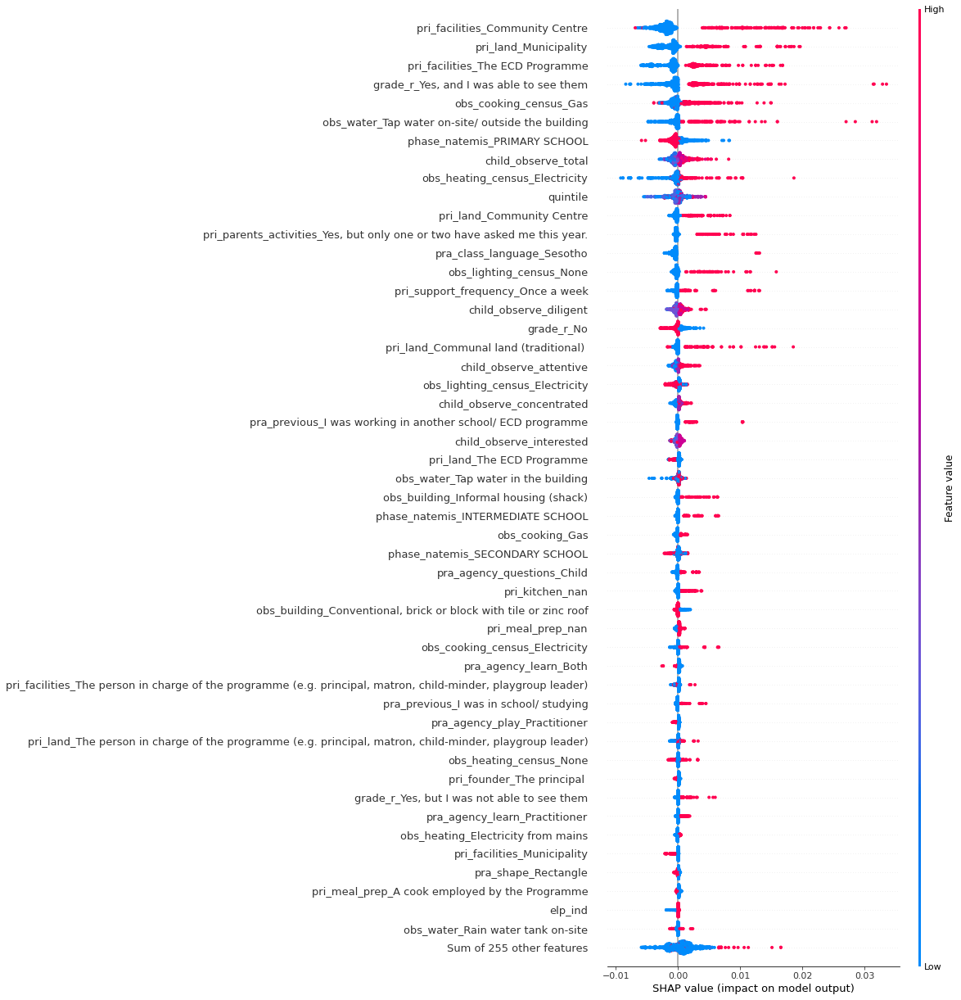

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_1_ward


<Figure size 1080x1800 with 0 Axes>

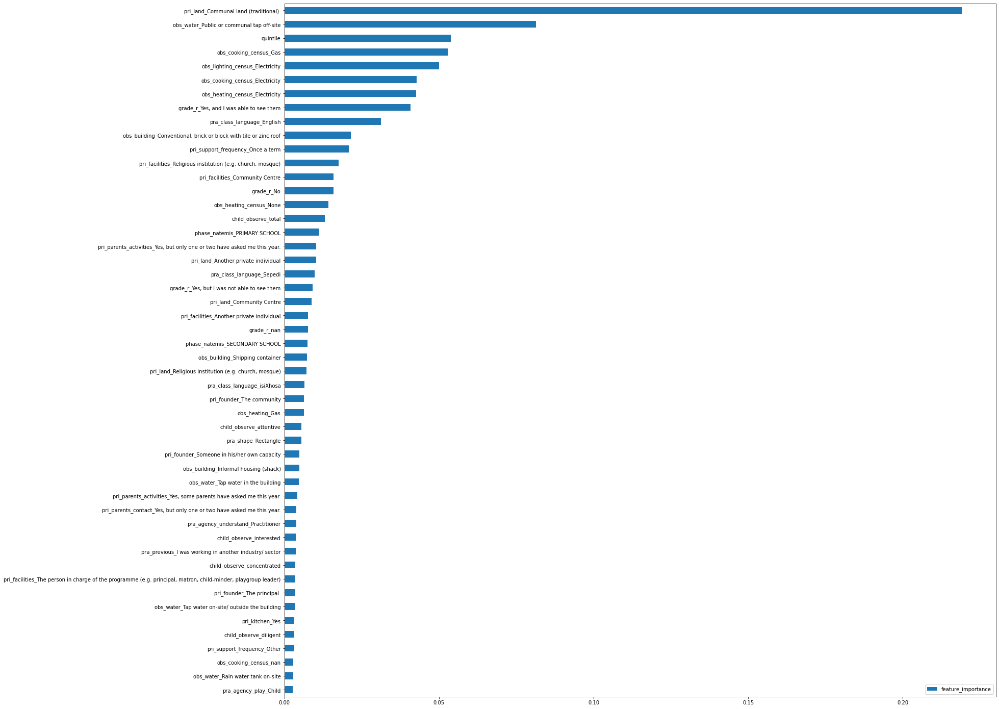

,feature_importance
pri_land_Communal land (traditional),0.219083
obs_water_Public or communal tap off-site,0.081287
quintile,0.053832
obs_cooking_census_Gas,0.052906
obs_lighting_census_Electricity,0.049966
obs_cooking_census_Electricity,0.042836
obs_heating_census_Electricity,0.042583
"grade_r_Yes, and I was able to see them",0.040784
pra_class_language_English,0.031249
"obs_building_Conventional, brick or block with tile or zinc roof",0.021523


100%|===================| 999/1000 [03:27<00:00]       

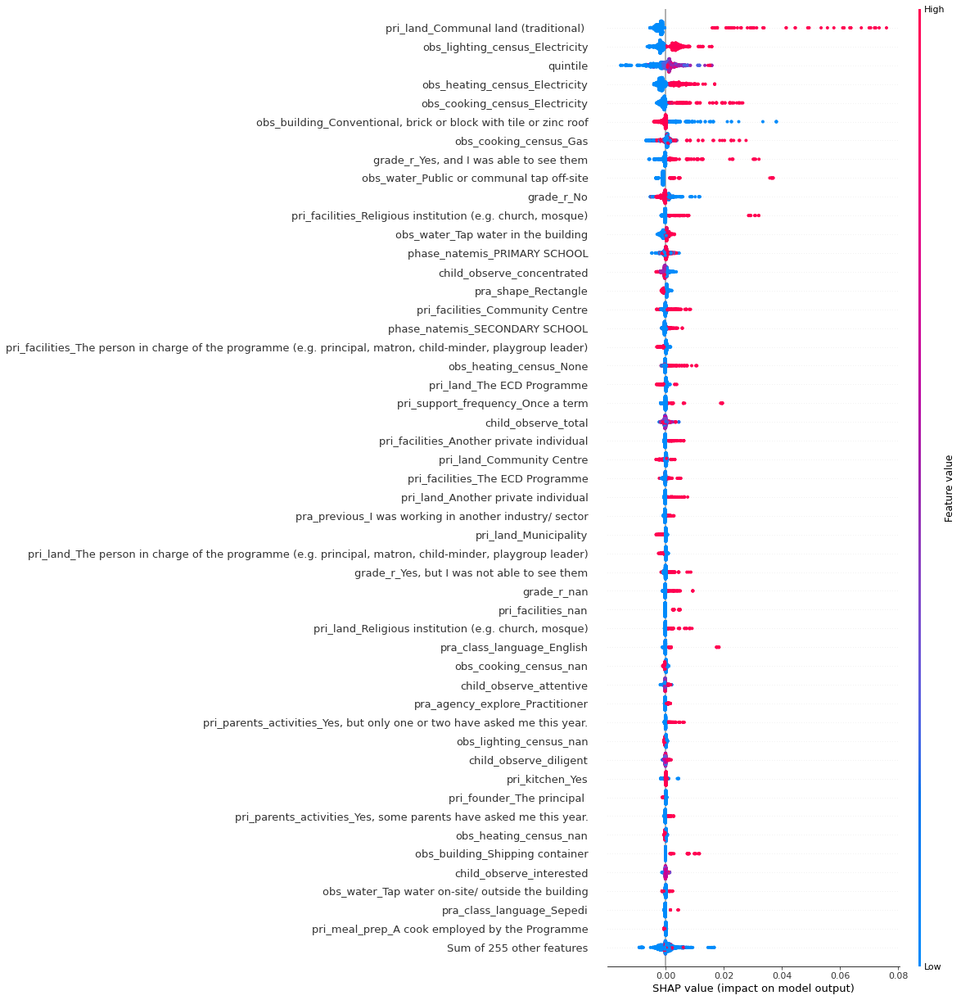

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_2_ward


<Figure size 1080x1800 with 0 Axes>

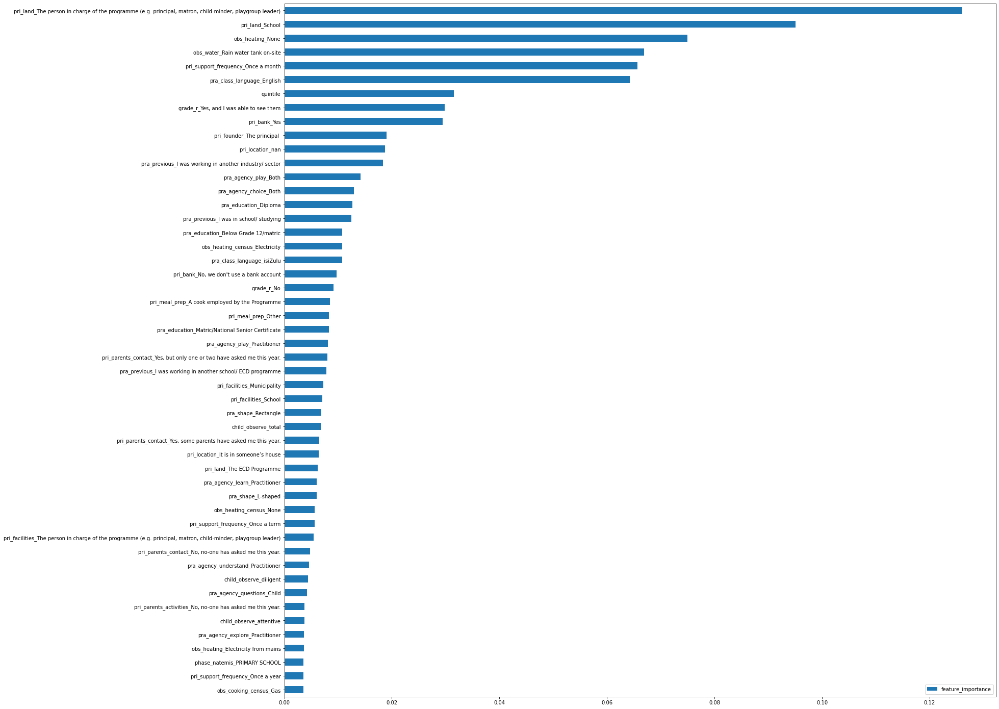

,feature_importance
"pri_land_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.126002
pri_land_School,0.095092
obs_heating_None,0.075005
obs_water_Rain water tank on-site,0.066915
pri_support_frequency_Once a month,0.065646
pra_class_language_English,0.064286
quintile,0.031561
"grade_r_Yes, and I was able to see them",0.029844
pri_bank_Yes,0.029440
pri_founder_The principal,0.019015


100%|===================| 996/1000 [03:23<00:00]       

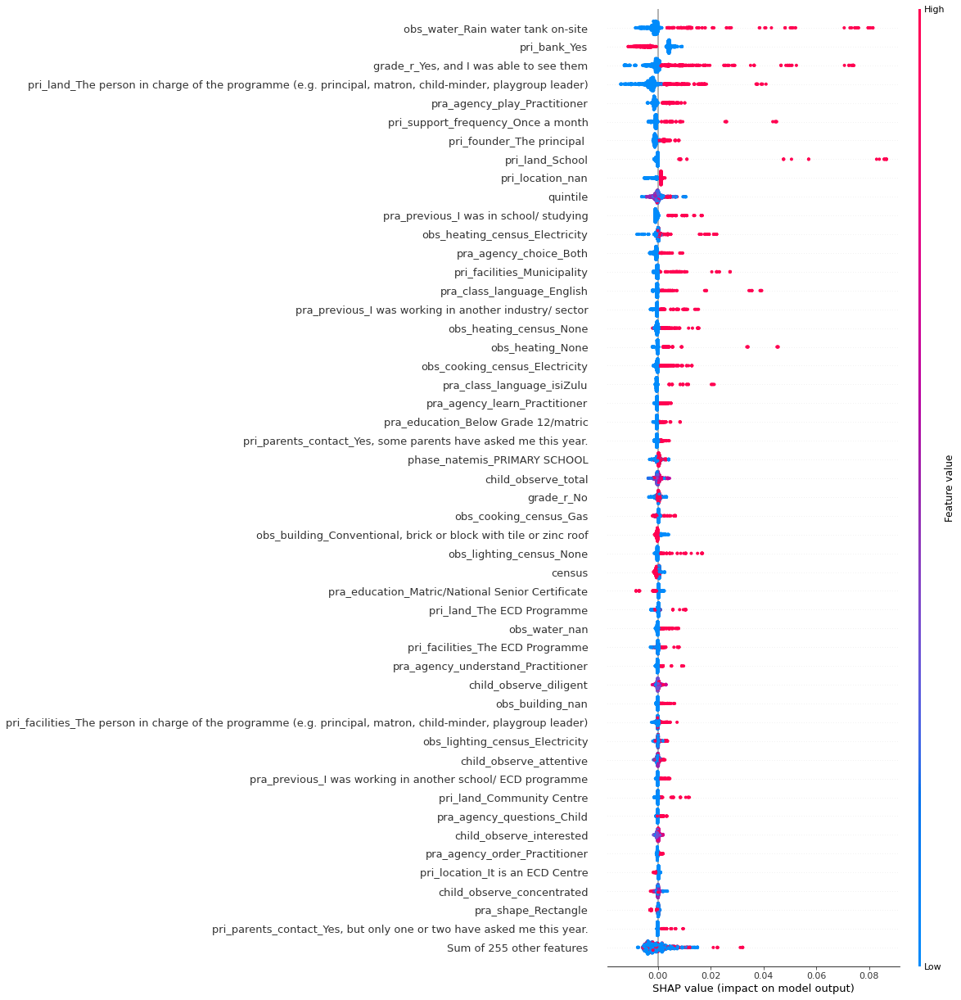

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_3_ward


<Figure size 1080x1800 with 0 Axes>

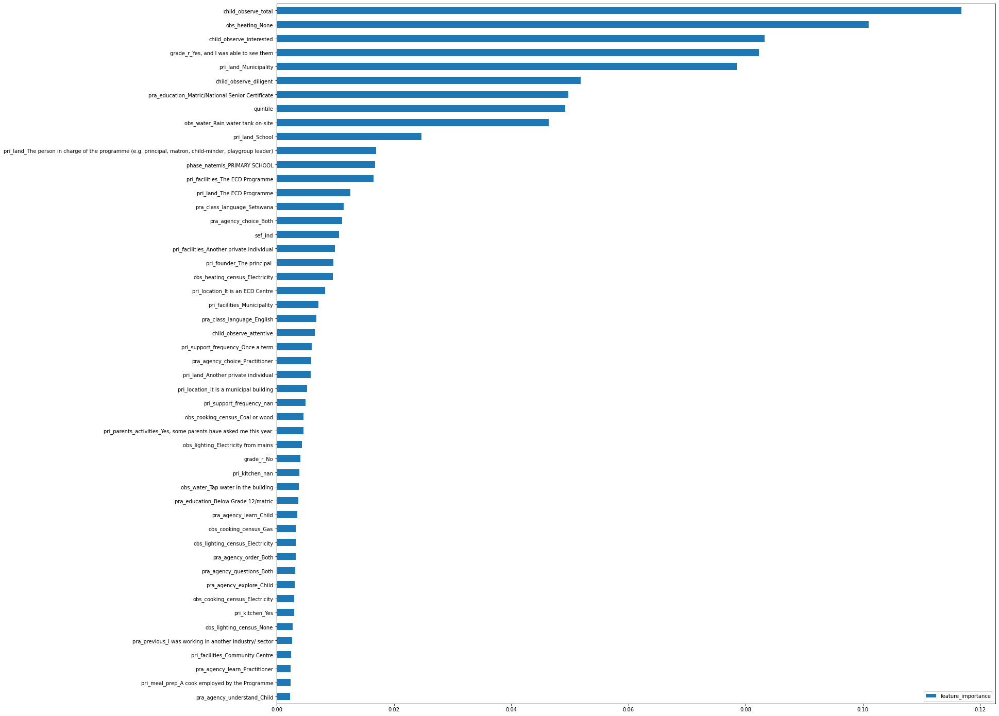

,feature_importance
child_observe_total,0.116800
obs_heating_None,0.100945
child_observe_interested,0.083267
"grade_r_Yes, and I was able to see them",0.082263
pri_land_Municipality,0.078496
child_observe_diligent,0.051859
pra_education_Matric/National Senior Certificate,0.049774
quintile,0.049179
obs_water_Rain water tank on-site,0.046405
pri_land_School,0.024694


100%|===================| 999/1000 [03:37<00:00]       

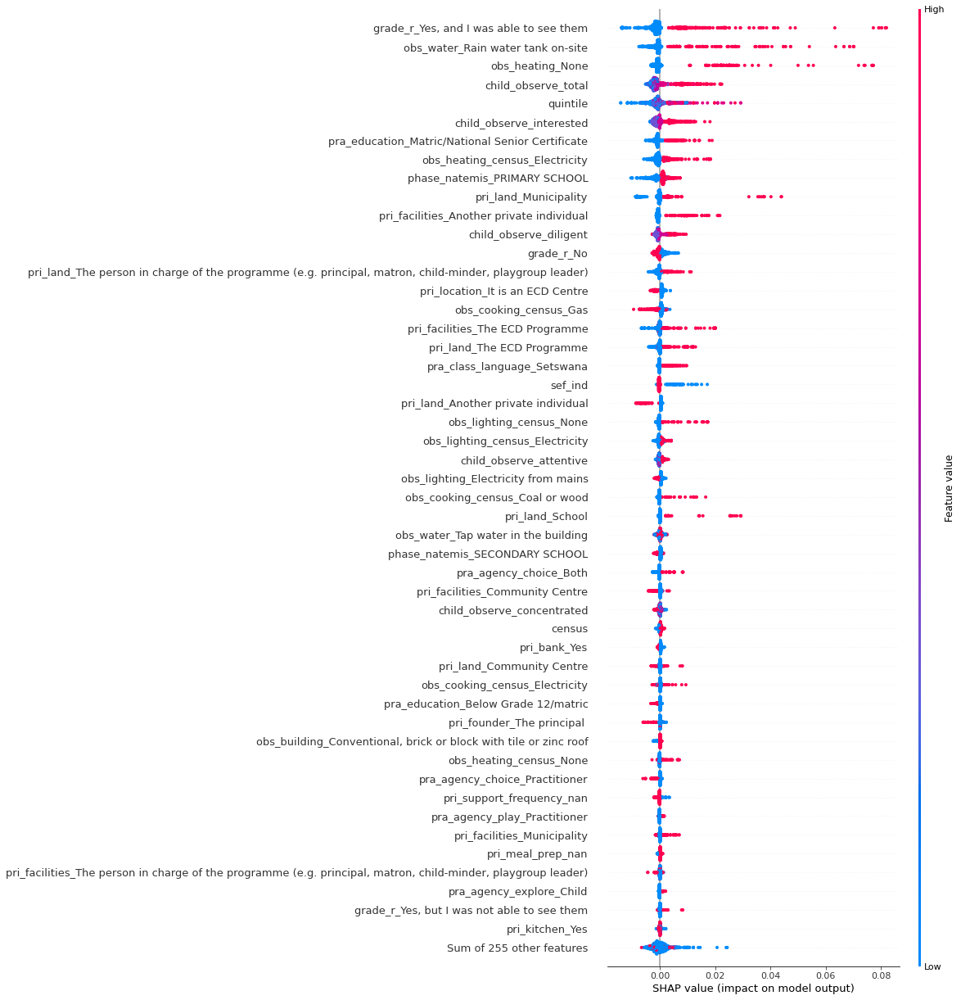

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_4_ward


<Figure size 1080x1800 with 0 Axes>

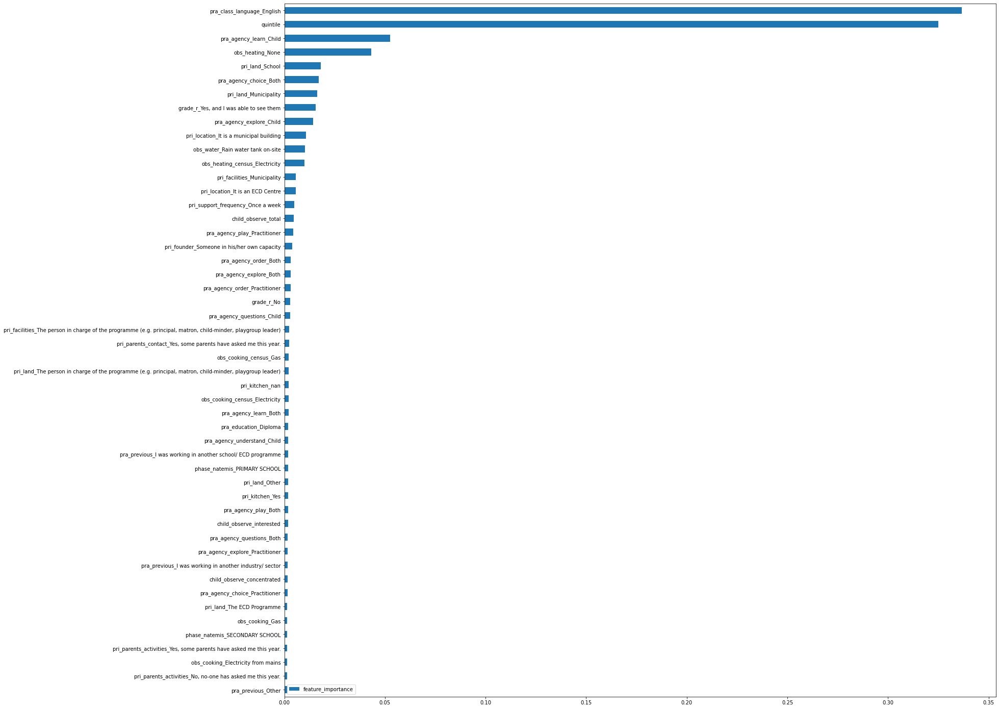

,feature_importance
pra_class_language_English,0.336692
quintile,0.324956
pra_agency_learn_Child,0.052592
obs_heating_None,0.043230
pri_land_School,0.018069
pra_agency_choice_Both,0.017006
pri_land_Municipality,0.016447
"grade_r_Yes, and I was able to see them",0.015453
pra_agency_explore_Child,0.014248
pri_location_It is a municipal building,0.010701


100%|===================| 996/1000 [03:20<00:00]       

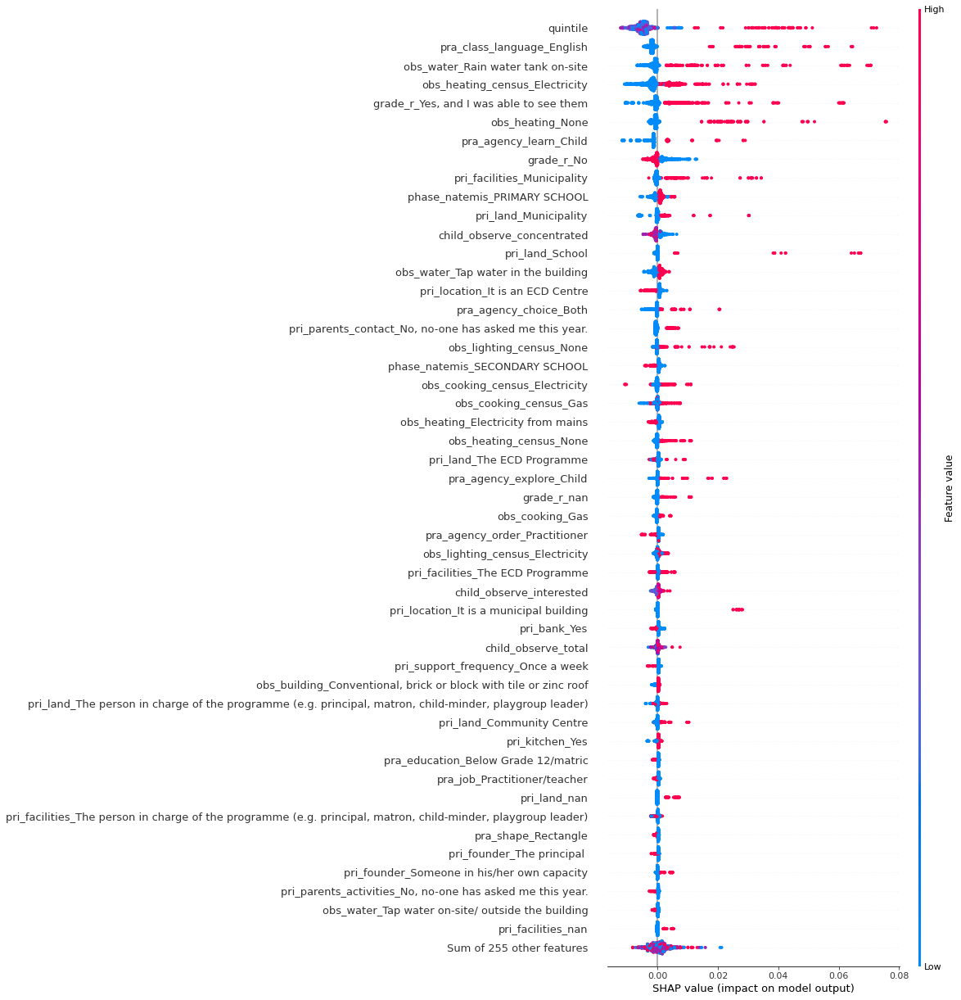

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_5_ward


<Figure size 1080x1800 with 0 Axes>

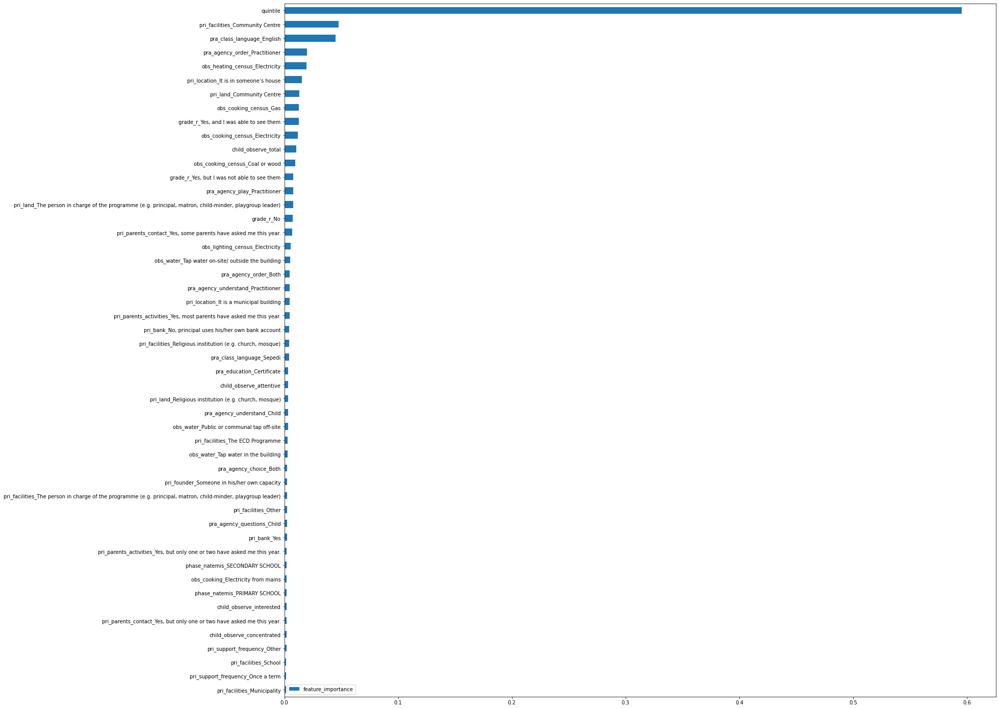

,feature_importance
quintile,0.595625
pri_facilities_Community Centre,0.047691
pra_class_language_English,0.044804
pra_agency_order_Practitioner,0.019884
obs_heating_census_Electricity,0.019652
pri_location_It is in someone’s house,0.015286
pri_land_Community Centre,0.013171
obs_cooking_census_Gas,0.012941
"grade_r_Yes, and I was able to see them",0.012895
obs_cooking_census_Electricity,0.011652


100%|===================| 999/1000 [03:22<00:00]       

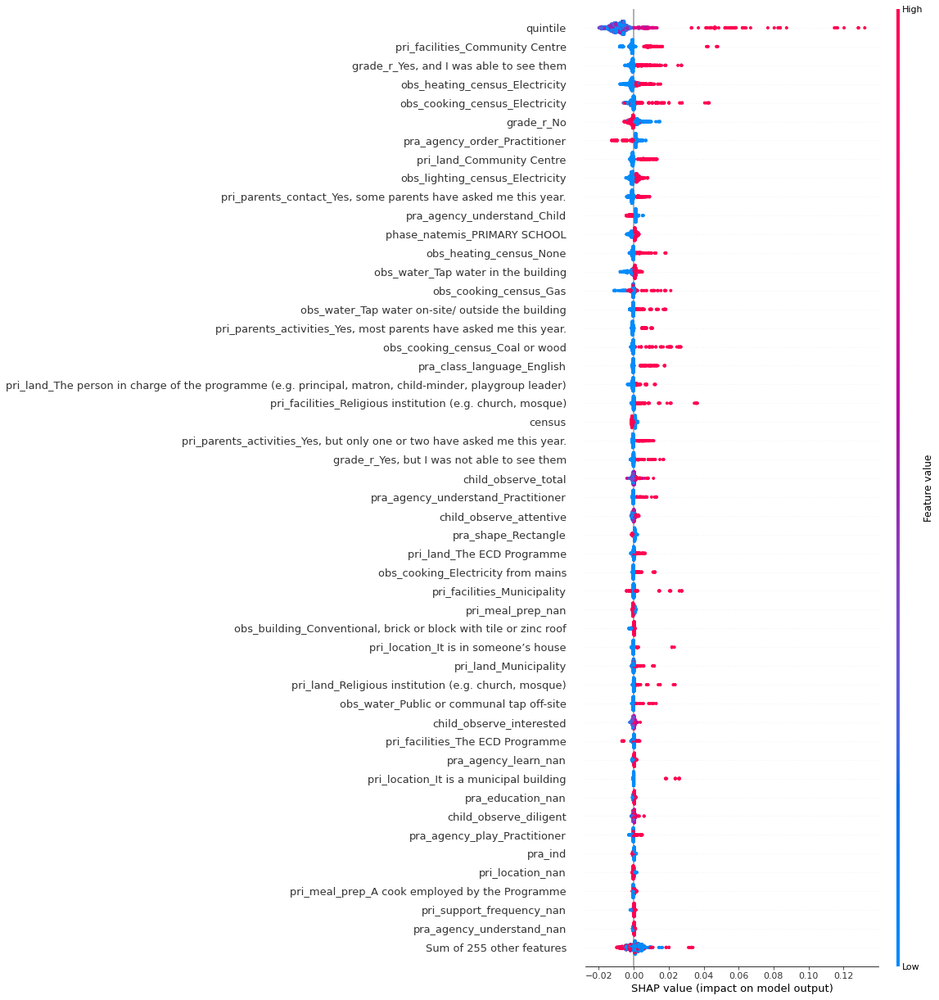

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_1_dc


<Figure size 1080x1800 with 0 Axes>

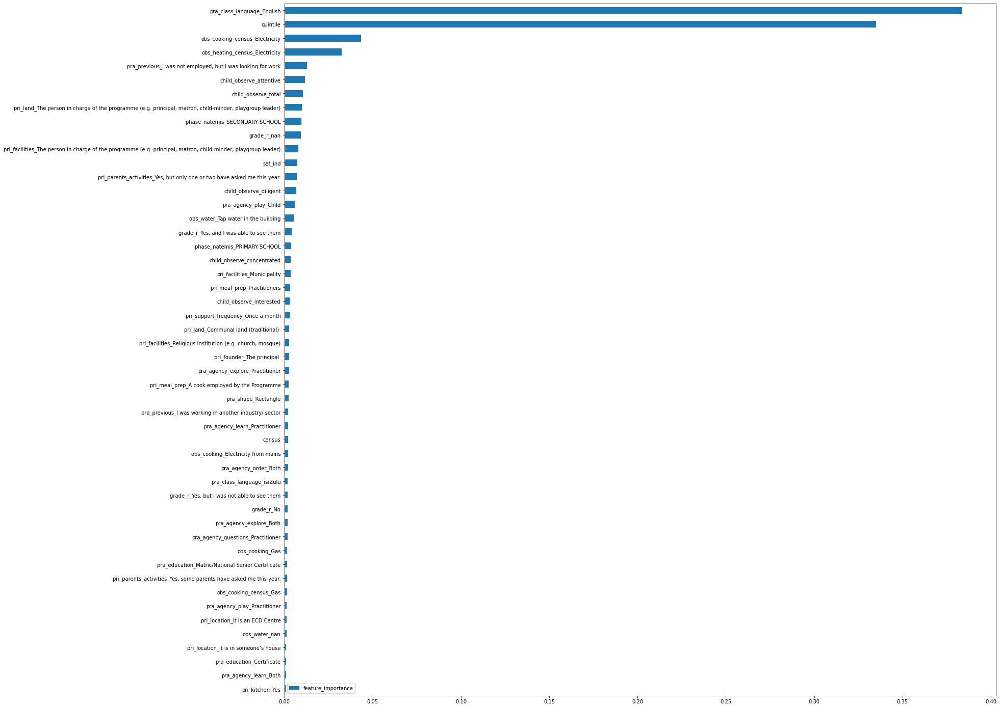

,feature_importance
pra_class_language_English,0.383573
quintile,0.334895
obs_cooking_census_Electricity,0.043542
obs_heating_census_Electricity,0.032444
"pra_previous_I was not employed, but I was looking for work",0.012798
child_observe_attentive,0.011675
child_observe_total,0.010509
"pri_land_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.009835
phase_natemis_SECONDARY SCHOOL,0.009774
grade_r_nan,0.009282


100%|===================| 997/1000 [03:28<00:00]       

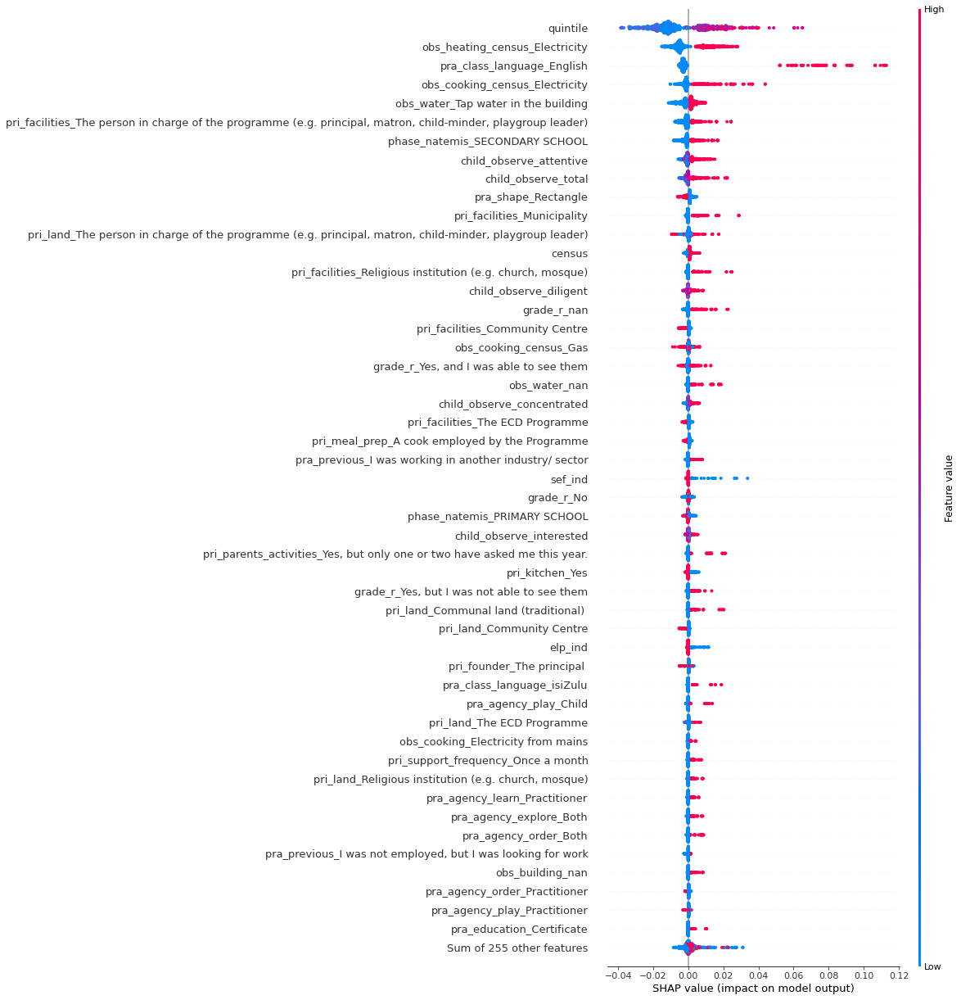

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_2_dc


invalid value encountered in true_divide


<Figure size 1080x1800 with 0 Axes>

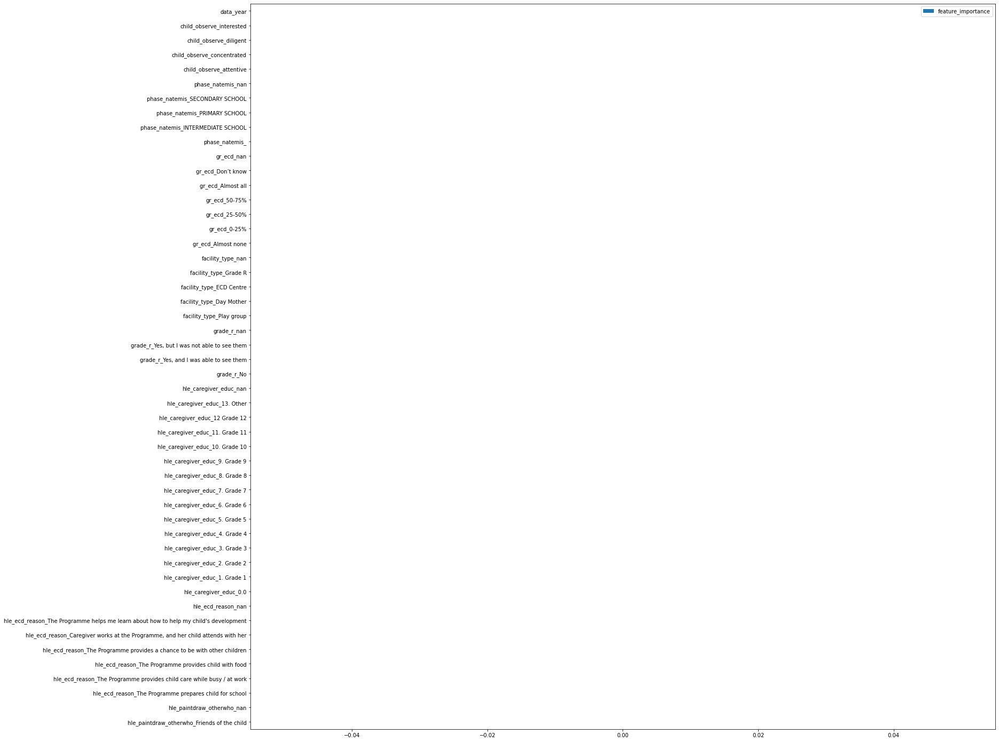

,feature_importance
child_observe_total,NaN
quintile,NaN
language_match,NaN
pra_ind,NaN
hle_ind,NaN
census,NaN
sef_ind,NaN
elp_ind,NaN
gps_ind,NaN
pre_covid,NaN


100%|===================| 999/1000 [03:40<00:00]       

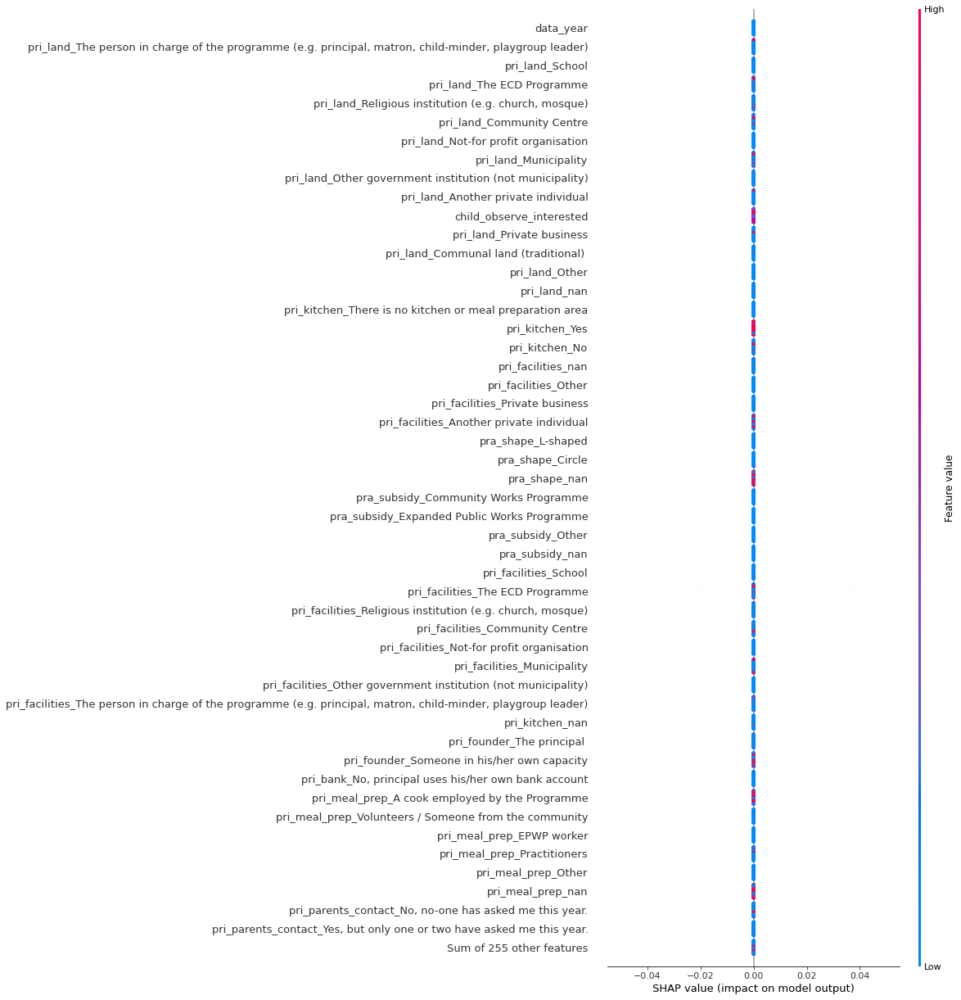

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_3_dc


<Figure size 1080x1800 with 0 Axes>

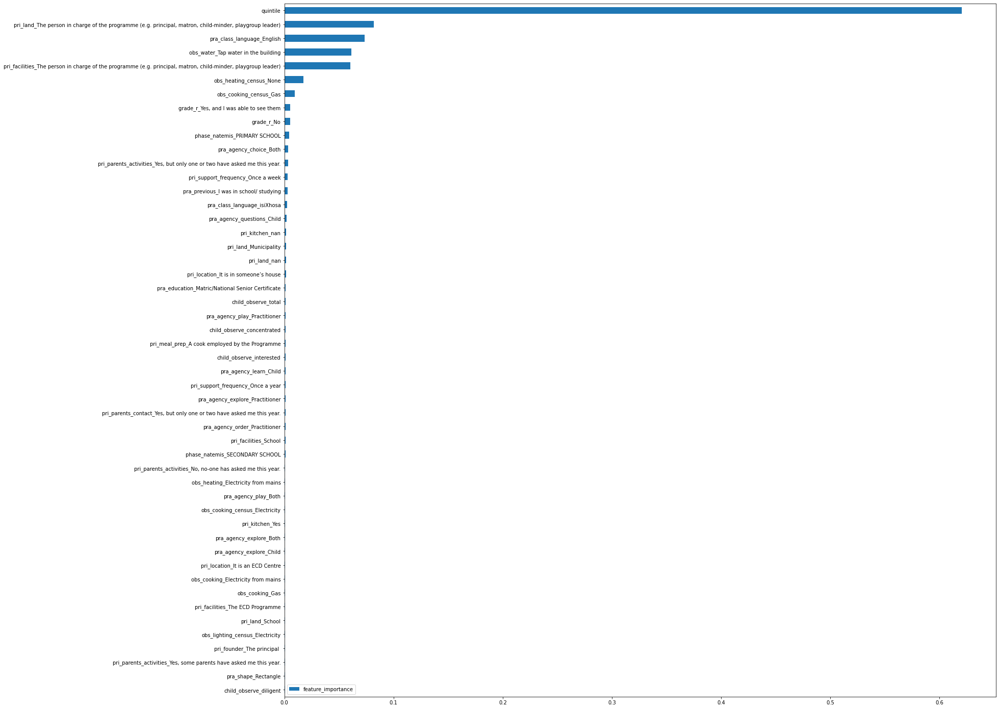

,feature_importance
quintile,0.620402
"pri_land_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.081975
pra_class_language_English,0.073701
obs_water_Tap water in the building,0.061292
"pri_facilities_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.060597
obs_heating_census_None,0.017402
obs_cooking_census_Gas,0.009495
"grade_r_Yes, and I was able to see them",0.005252
grade_r_No,0.005199
phase_natemis_PRIMARY SCHOOL,0.004467


100%|===================| 997/1000 [03:33<00:00]       

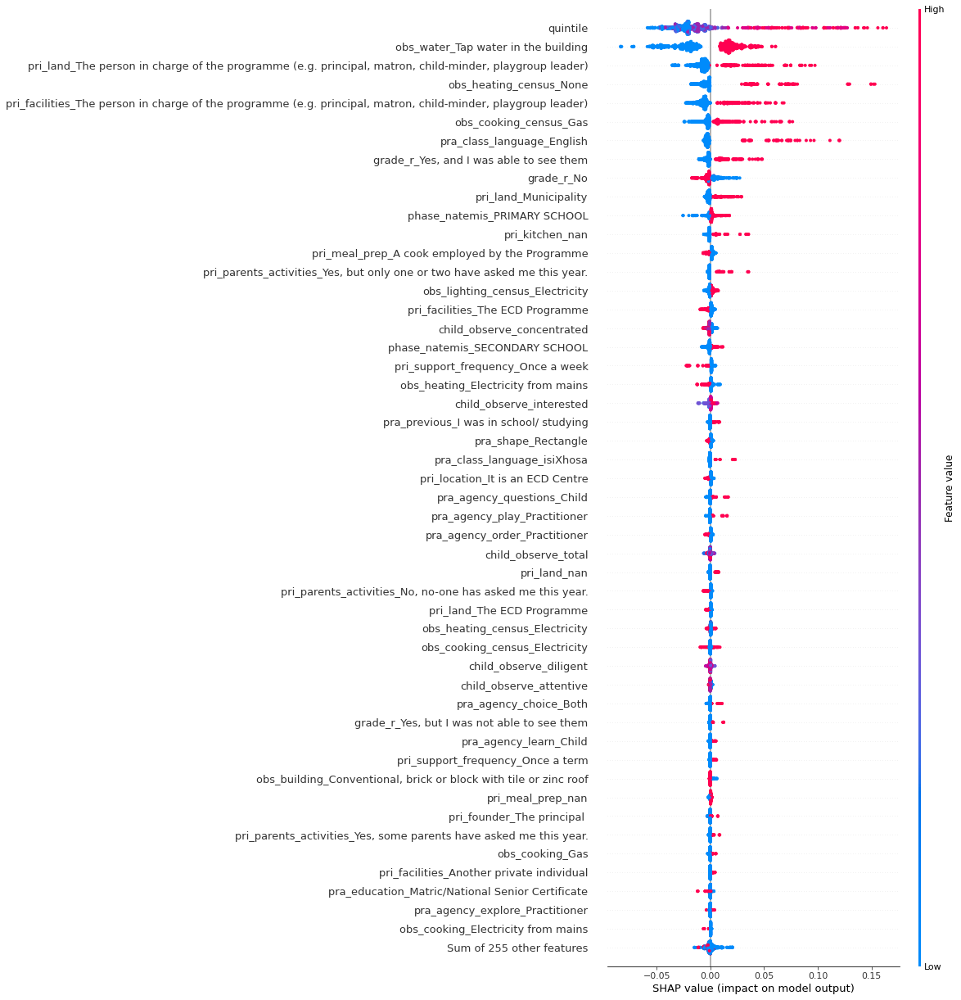

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_4_dc


<Figure size 1080x1800 with 0 Axes>

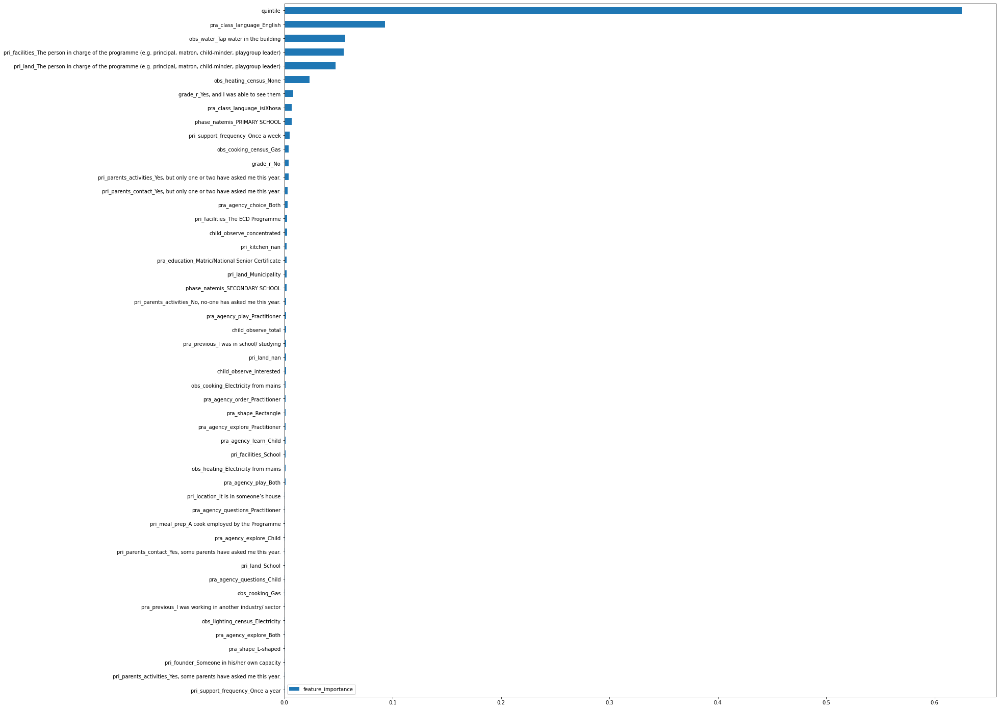

,feature_importance
quintile,0.625112
pra_class_language_English,0.093083
obs_water_Tap water in the building,0.056219
"pri_facilities_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.054757
"pri_land_The person in charge of the programme (e.g. principal, matron, child-minder, playgroup leader)",0.047381
obs_heating_census_None,0.023068
"grade_r_Yes, and I was able to see them",0.008038
pra_class_language_isiXhosa,0.006852
phase_natemis_PRIMARY SCHOOL,0.006740
pri_support_frequency_Once a week,0.004876


100%|===================| 996/1000 [03:29<00:00]       

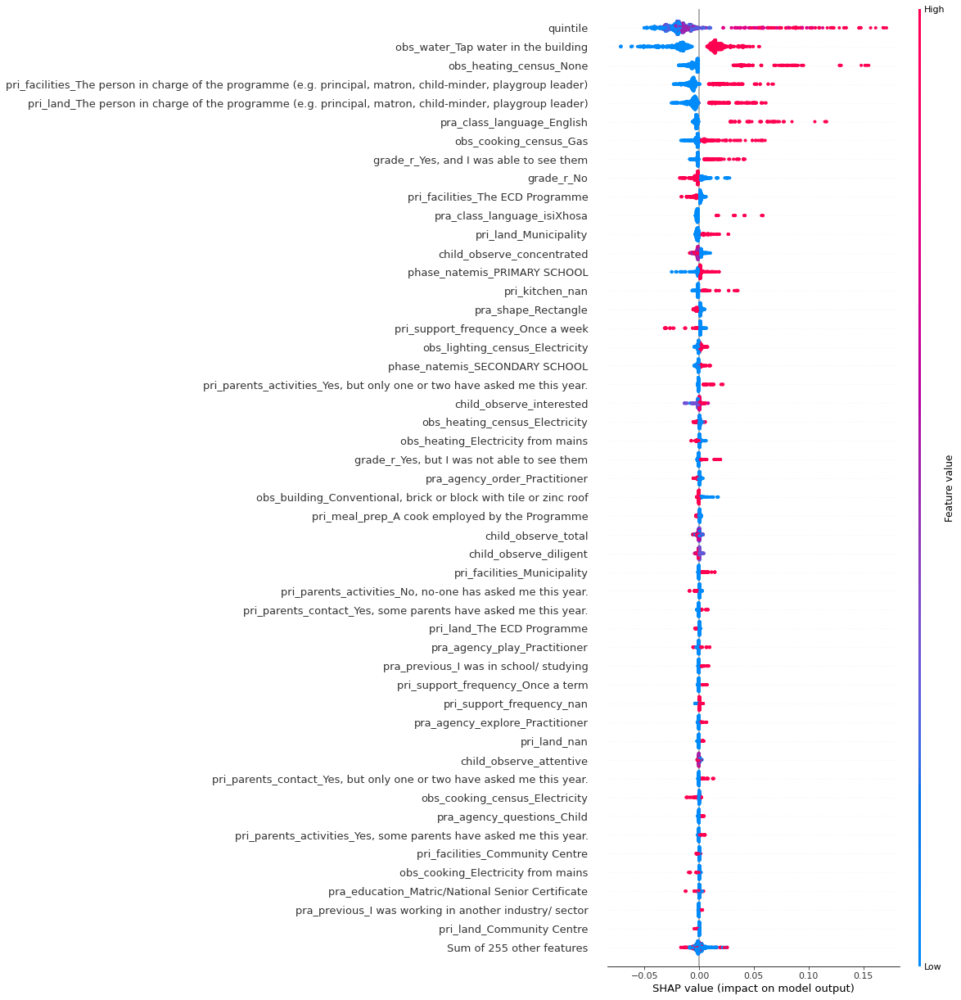

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_5_dc


<Figure size 1080x1800 with 0 Axes>

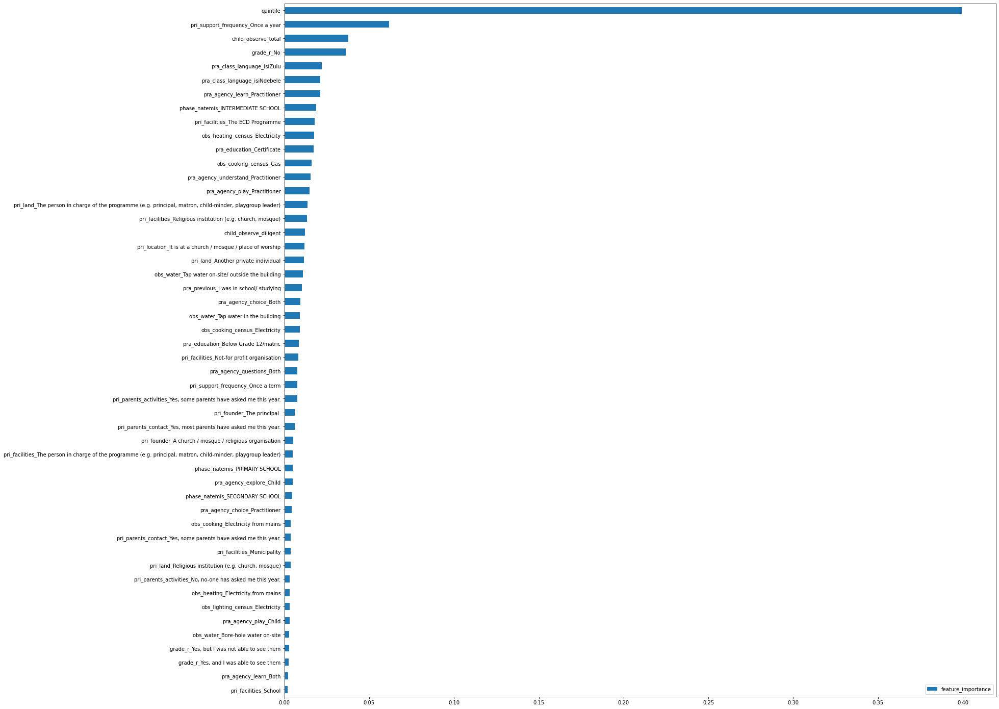

,feature_importance
quintile,0.399410
pri_support_frequency_Once a year,0.061675
child_observe_total,0.037566
grade_r_No,0.036251
pra_class_language_isiZulu,0.022136
pra_class_language_isiNdebele,0.021143
pra_agency_learn_Practitioner,0.021064
phase_natemis_INTERMEDIATE SCHOOL,0.018841
pri_facilities_The ECD Programme,0.017922
obs_heating_census_Electricity,0.017465


100%|===================| 996/1000 [03:27<00:00]       

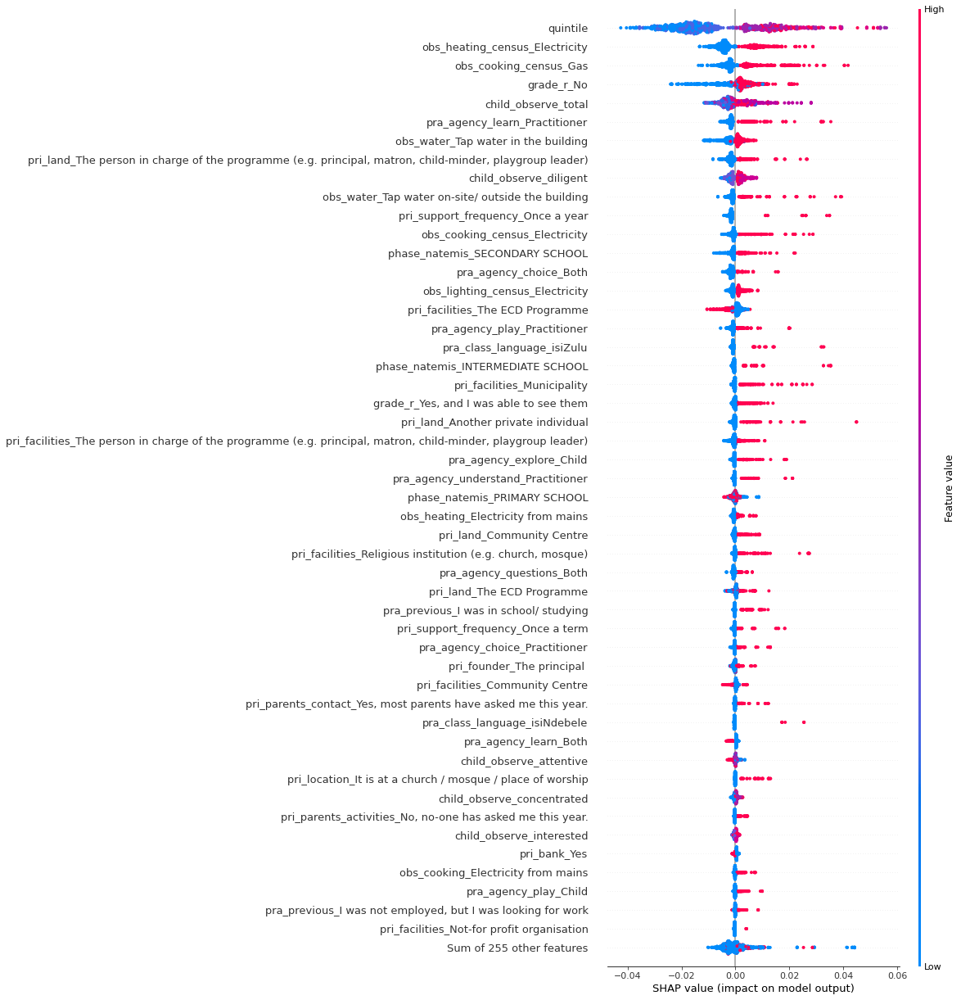

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_1_mn


<Figure size 1080x1800 with 0 Axes>

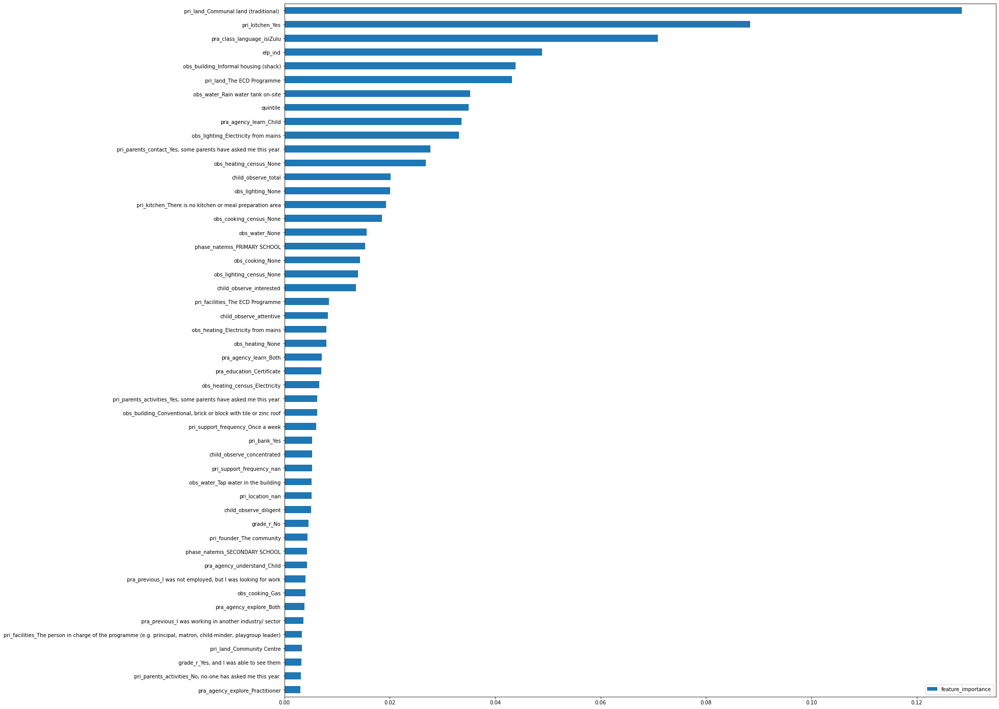

,feature_importance
pri_land_Communal land (traditional),0.128537
pri_kitchen_Yes,0.088339
pra_class_language_isiZulu,0.070866
elp_ind,0.048945
obs_building_Informal housing (shack),0.043901
pri_land_The ECD Programme,0.043169
obs_water_Rain water tank on-site,0.035211
quintile,0.034990
pra_agency_learn_Child,0.033657
obs_lighting_Electricity from mains,0.033097


100%|===================| 999/1000 [03:29<00:00]       

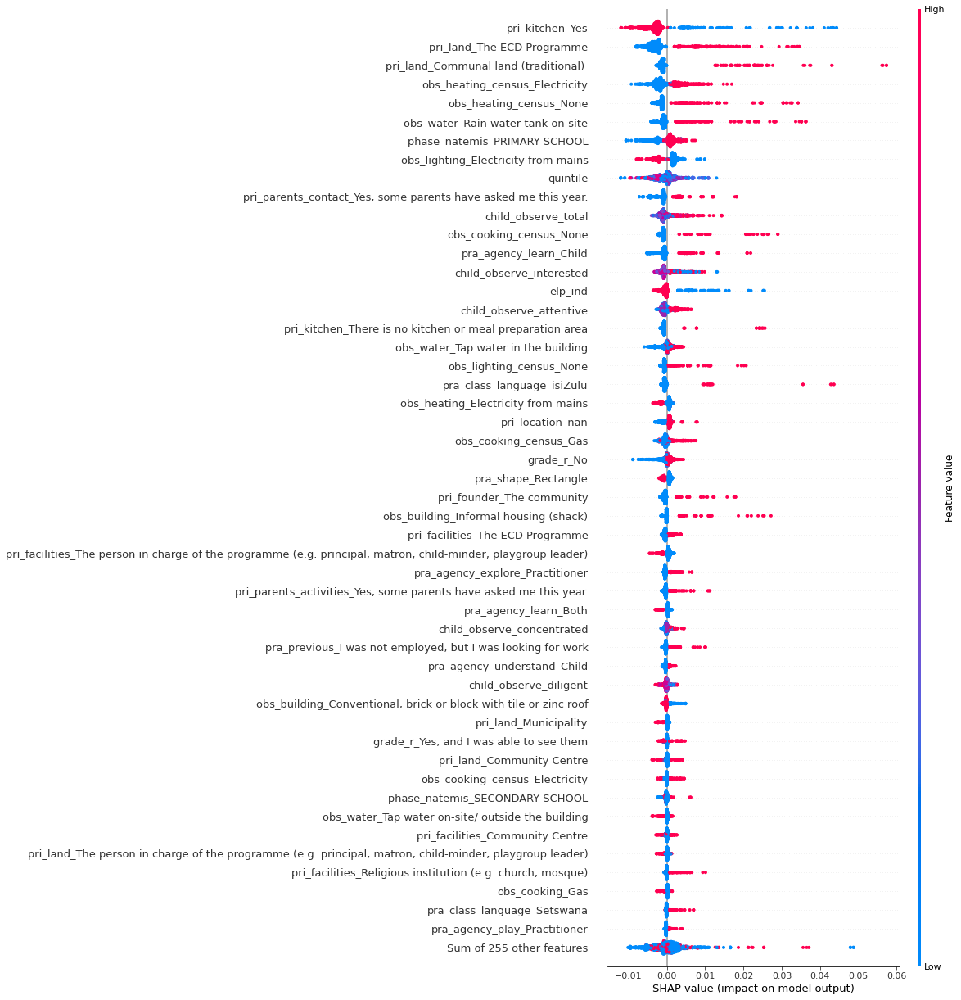

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_2_mn


<Figure size 1080x1800 with 0 Axes>

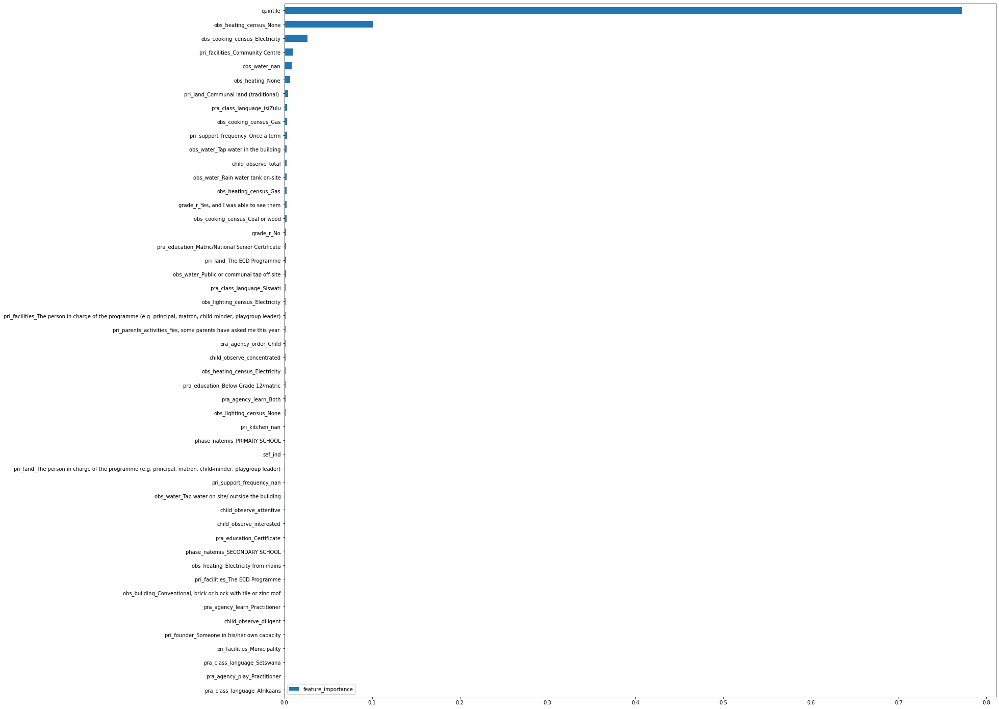

,feature_importance
quintile,0.772205
obs_heating_census_None,0.100739
obs_cooking_census_Electricity,0.026320
pri_facilities_Community Centre,0.010019
obs_water_nan,0.008271
obs_heating_None,0.006396
pri_land_Communal land (traditional),0.004259
pra_class_language_isiZulu,0.003148
obs_cooking_census_Gas,0.003145
pri_support_frequency_Once a term,0.003091


100%|===================| 996/1000 [03:25<00:00]       

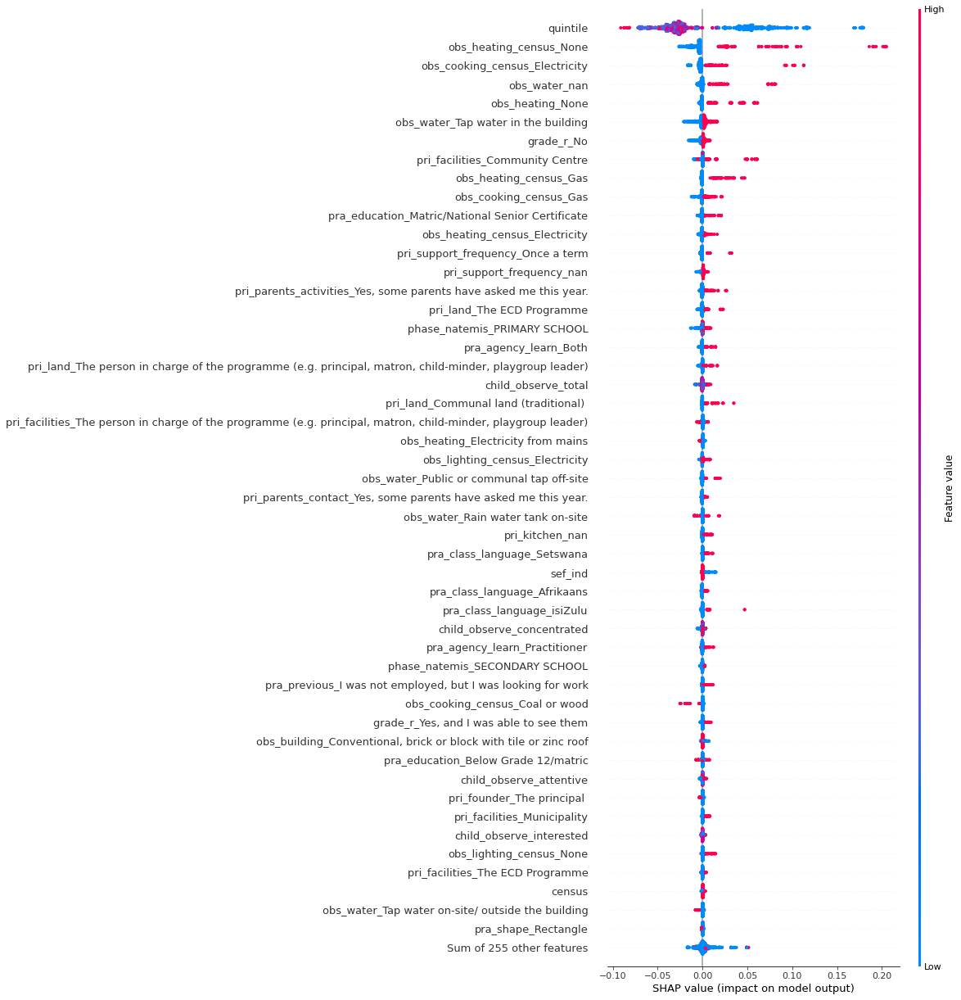

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_3_mn


<Figure size 1080x1800 with 0 Axes>

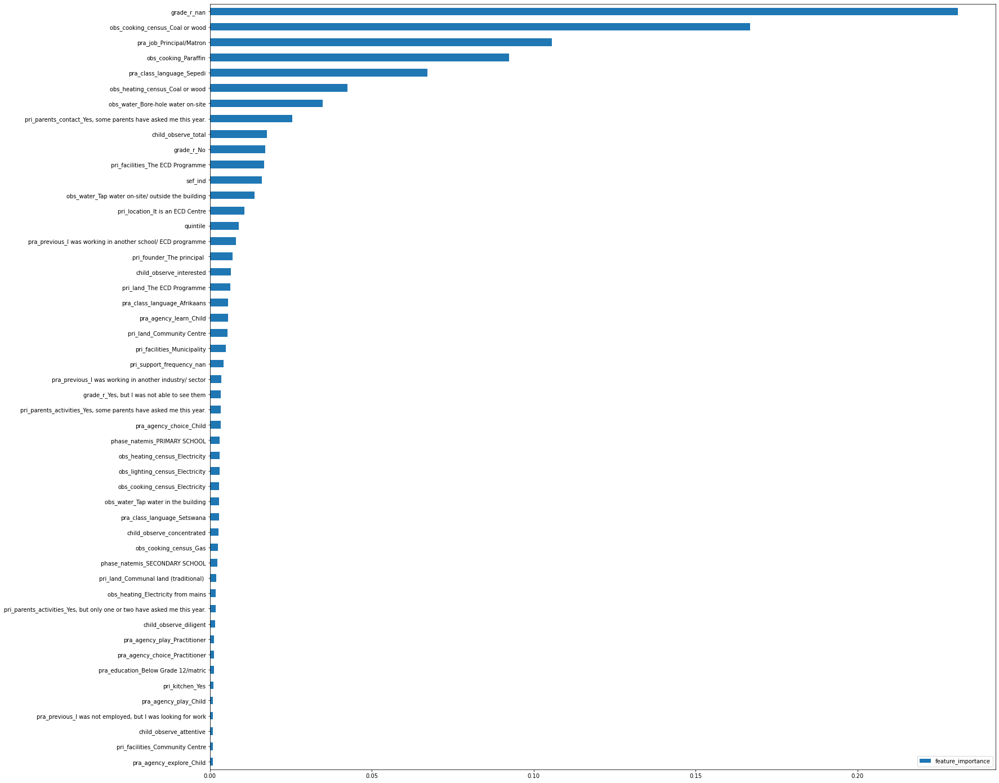

,feature_importance
grade_r_nan,0.231073
obs_cooking_census_Coal or wood,0.166881
pra_job_Principal/Matron,0.105593
obs_cooking_Paraffin,0.092380
pra_class_language_Sepedi,0.067200
obs_heating_census_Coal or wood,0.042414
obs_water_Bore-hole water on-site,0.034922
"pri_parents_contact_Yes, some parents have asked me this year.",0.025402
child_observe_total,0.017604
grade_r_No,0.017099


100%|===================| 999/1000 [03:23<00:00]       

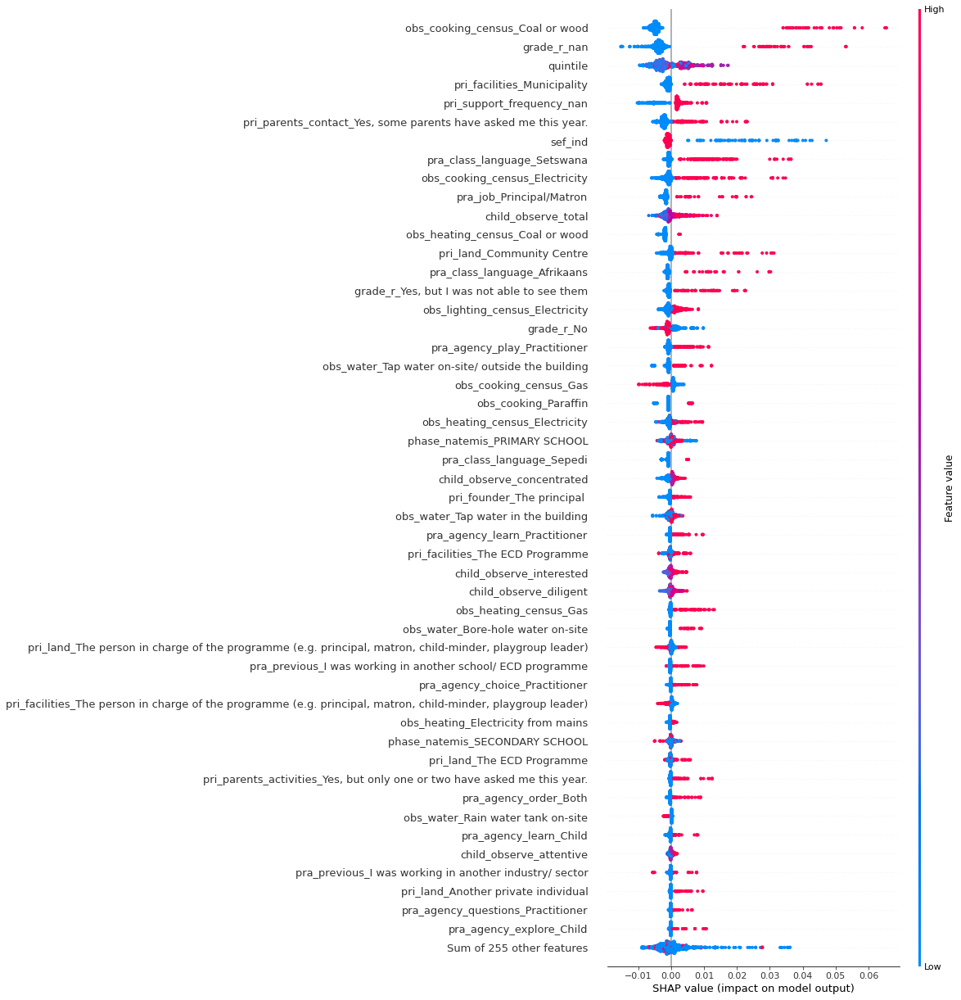

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_4_mn


<Figure size 1080x1800 with 0 Axes>

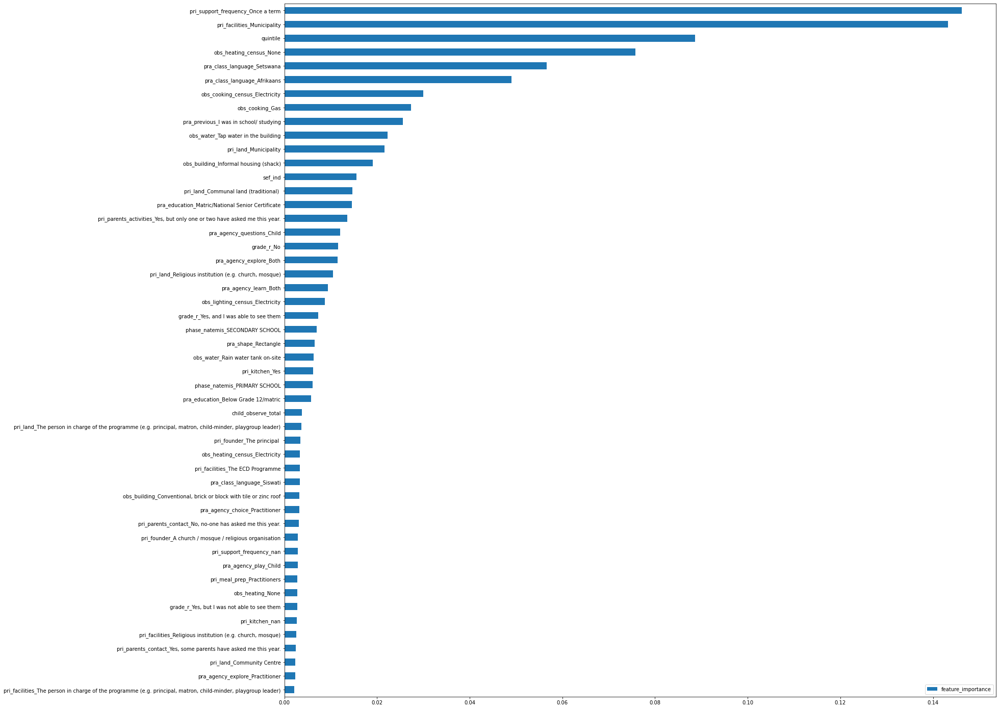

,feature_importance
pri_support_frequency_Once a term,0.146230
pri_facilities_Municipality,0.143252
quintile,0.088693
obs_heating_census_None,0.075718
pra_class_language_Setswana,0.056647
pra_class_language_Afrikaans,0.049033
obs_cooking_census_Electricity,0.029957
obs_cooking_Gas,0.027354
pra_previous_I was in school/ studying,0.025581
obs_water_Tap water in the building,0.022306


100%|===================| 998/1000 [03:28<00:00]       

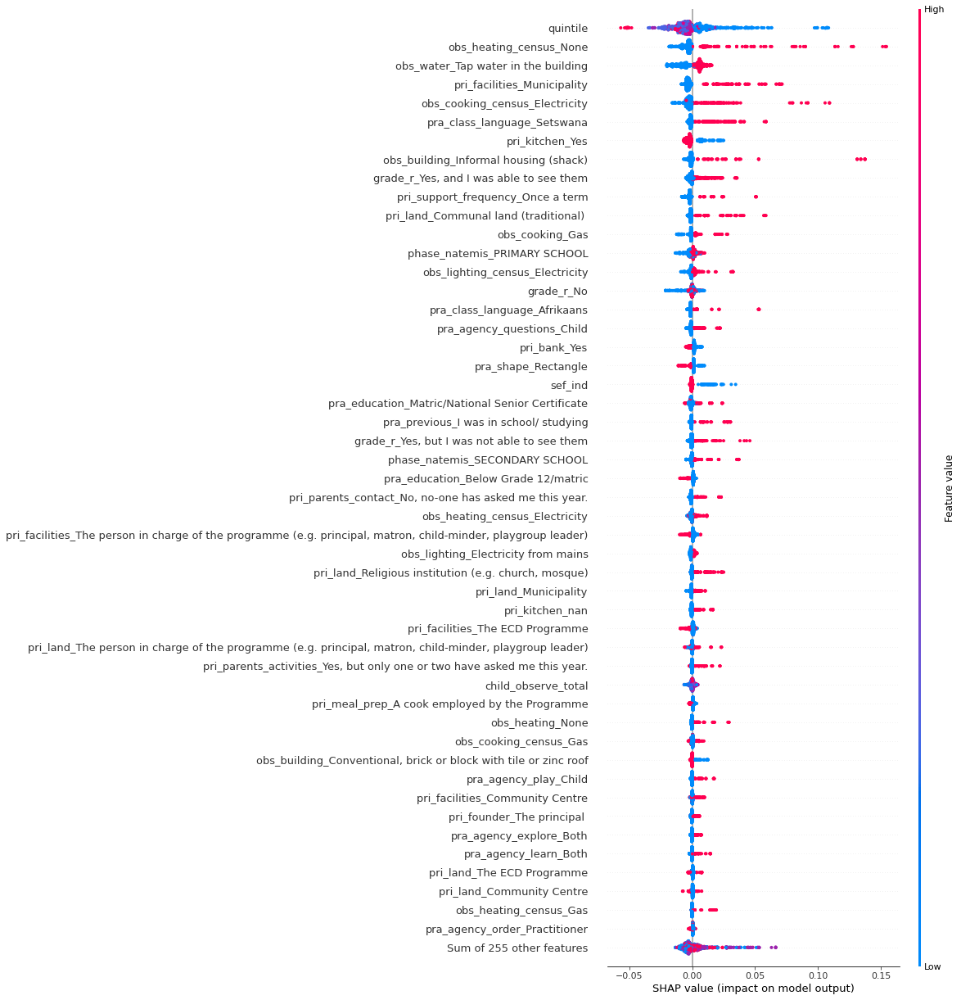

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_domain_5_mn


<Figure size 1080x1800 with 0 Axes>

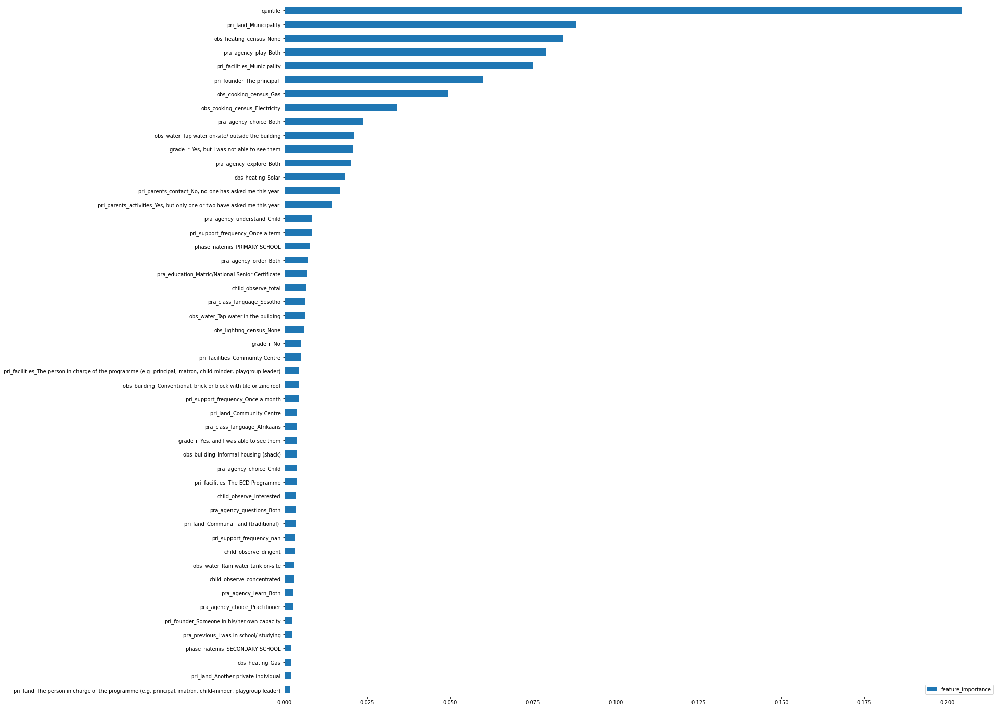

,feature_importance
quintile,0.204437
pri_land_Municipality,0.088111
obs_heating_census_None,0.084038
pra_agency_play_Both,0.079004
pri_facilities_Municipality,0.074956
pri_founder_The principal,0.060101
obs_cooking_census_Gas,0.049246
obs_cooking_census_Electricity,0.033924
pra_agency_choice_Both,0.023792
obs_water_Tap water on-site/ outside the building,0.021110


100%|===================| 997/1000 [03:34<00:00]       

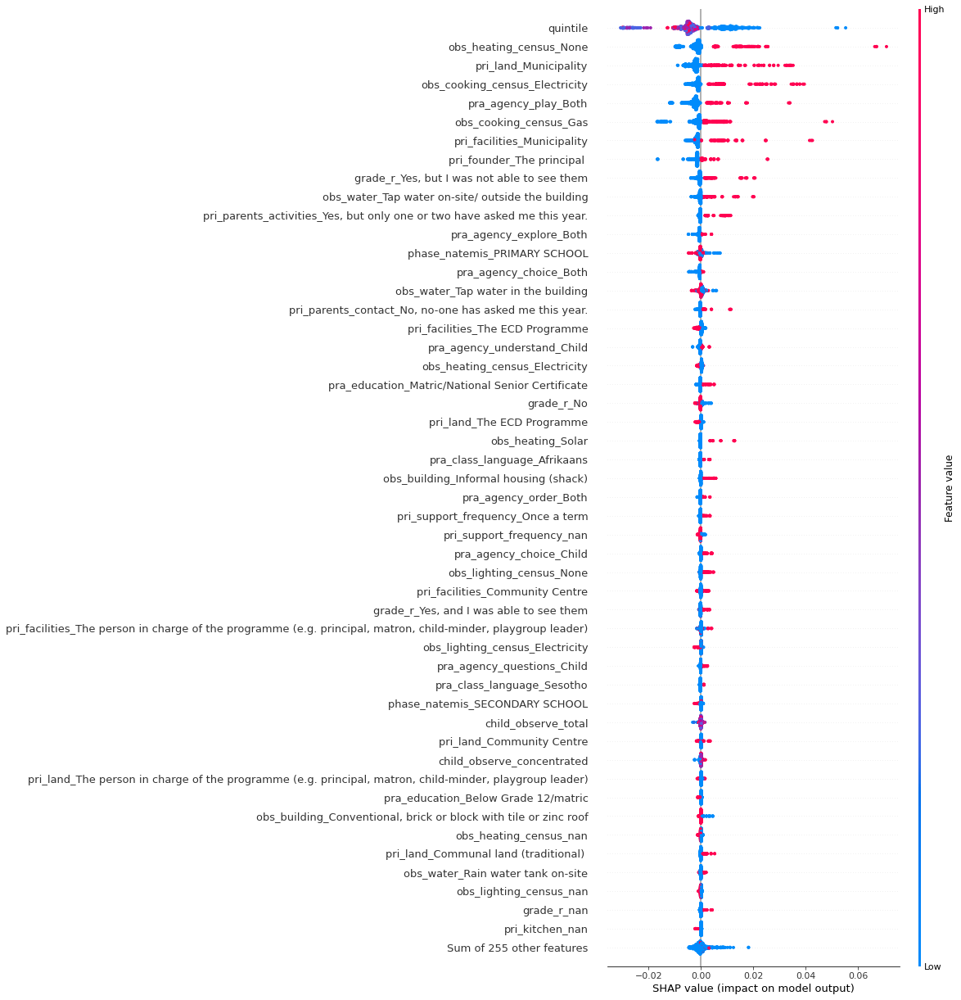

(6612, 1628)
(4994, 697)
*************************************************************************************************
PD_1_INT_total_ward


<Figure size 1080x1800 with 0 Axes>

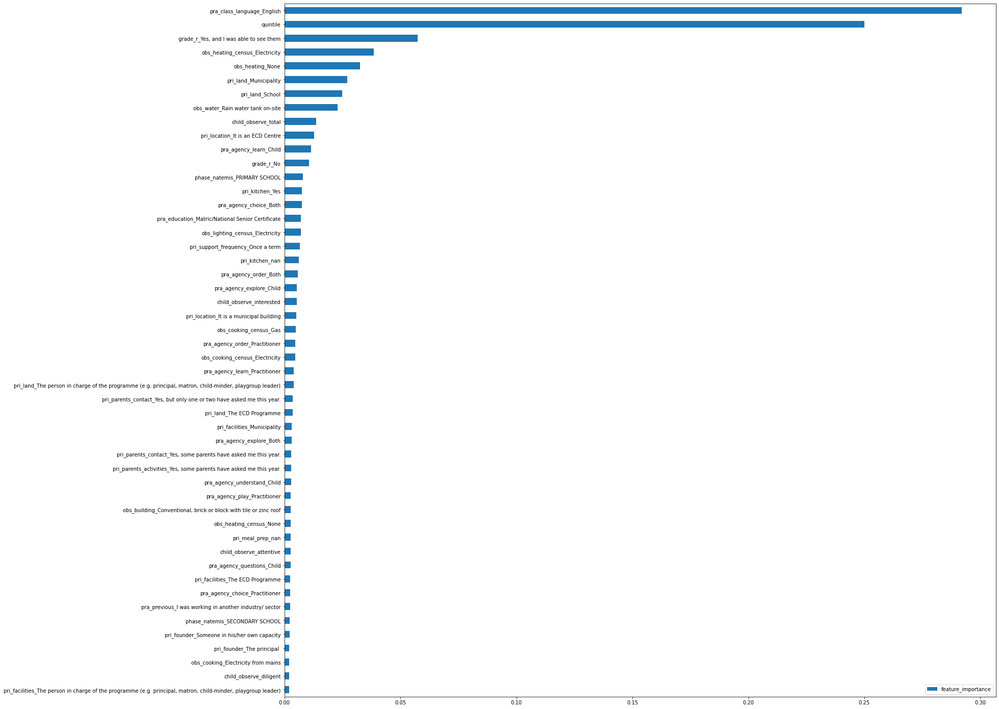

,feature_importance
pra_class_language_English,0.292017
quintile,0.250059
"grade_r_Yes, and I was able to see them",0.057508
obs_heating_census_Electricity,0.038650
obs_heating_None,0.032541
pri_land_Municipality,0.027156
pri_land_School,0.024979
obs_water_Rain water tank on-site,0.023036
child_observe_total,0.013659
pri_location_It is an ECD Centre,0.012752


100%|===================| 997/1000 [03:37<00:00]       

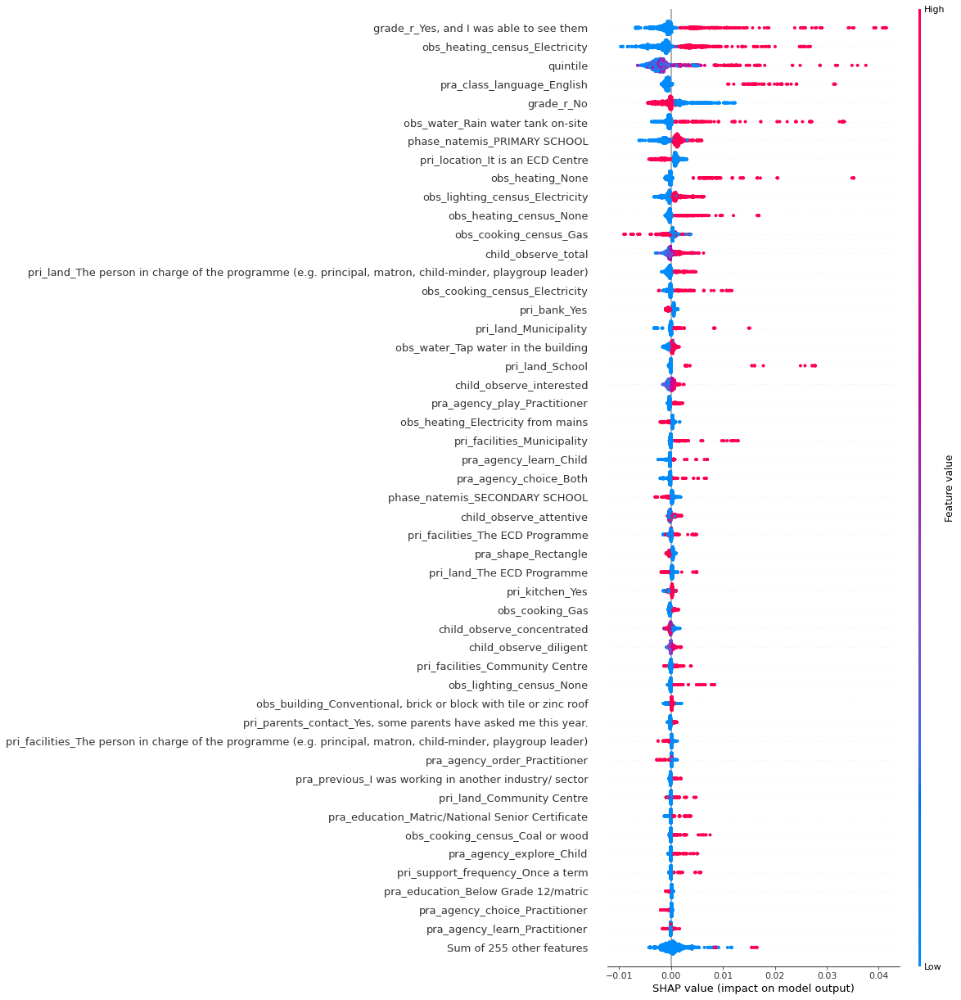

In [ ]:
for var in variables_of_interest:
  X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, var, drop_to_refine_significant_vars_total_elom_facility , dropNa = True)

  est = RegressionForest(n_estimators=1000, min_samples_leaf=5, max_depth=None,
                        min_impurity_decrease = 0.0, max_samples=0.45, min_balancedness_tol=.45,
                        warm_start=False, inference=True, subforest_size=4,
                        honest=True, verbose=0, n_jobs=-1, random_state=1235)

  est.fit(X, Y)

  plt.figure(figsize=(15,25))
  # plt.plot(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), X.columns)
  # plt.plot()
  print('*************************************************************************************************')
  print(var)
  pd.DataFrame(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), 
              index = X.columns, columns= ['feature_importance']).sort_values('feature_importance', ascending = True).tail(50).plot(
                  kind='barh', figsize = (25,25))
  
  plt.show()

  most_important_vars = pd.DataFrame(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), index = X.columns, columns= ['feature_importance']).sort_values('feature_importance', ascending = False).head(50)
  display(most_important_vars)


  explainer = shap.Explainer(est, shap.maskers.Independent(X, max_samples=100), )

  shap_values = explainer(X[:1000], check_additivity=False)
  shap.plots.beeswarm(shap_values, max_display=50)

In [ ]:
writer = pd.ExcelWriter(file_path + 'regression_forest_ECONML_variable_selection.xlsx', engine='xlsxwriter')

for var in variables_of_interest:
  X, Y, clusters = pre_forest_prep_for_specific_PD(Penultimate_df, var, drop_to_refine_significant_vars_total_elom_facility , dropNa = True)

  est = RegressionForest(n_estimators=1000, min_samples_leaf=5, max_depth=None,
                        min_impurity_decrease = 0.0, max_samples=0.45, min_balancedness_tol=.45,
                        warm_start=False, inference=True, subforest_size=4,
                        honest=True, verbose=0, n_jobs=-1, random_state=1235)

  est.fit(X, Y)

  print(var)


  most_important_vars = pd.DataFrame(est.feature_importances(max_depth=4, depth_decay_exponent=2.0), index = X.columns, columns= ['feature_importance']).sort_values('feature_importance', ascending = False).head(50)


  # Write each dataframe to a different worksheet.
  most_important_vars.to_excel(writer, sheet_name= var)


# Close the Pandas Excel writer and output the Excel file.
writer.save()

(6612, 1628)
(4994, 697)
PD_1_INT_total_elom_CHILD
(6612, 1628)
(4994, 697)
PD_1_INT_total_elom_facility
(6612, 1628)
(4994, 697)
PD_1_INT_total_elom_ward
(6612, 1628)
(4994, 697)
PD_1_INT_total_elom_dc
(6612, 1628)
(4994, 697)
PD_1_INT_total_elom_mn
(6612, 1628)
(4994, 697)
PD_1_INT_total_facility
(6612, 1628)
(4994, 697)
PD_1_INT_total_ward
(6612, 1628)
(4994, 697)
PD_1_INT_total_mn
(6612, 1628)
(4994, 697)
PD_1_INT_total_dc
(6612, 1628)
(4994, 697)
PD_1_INT_domain_1_CHILD
(6612, 1628)
(4994, 697)
PD_1_INT_domain_2_CHILD
(6612, 1628)
(4994, 697)
PD_1_INT_domain_3_CHILD
(6612, 1628)
(4994, 697)
PD_1_INT_domain_4_CHILD
(6612, 1628)
(4994, 697)
PD_1_INT_domain_5_CHILD
(6612, 1628)
(4994, 697)
PD_1_INT_domain_1_facility
(6612, 1628)
(4994, 697)
PD_1_INT_domain_2_facility
(6612, 1628)
(4994, 697)
PD_1_INT_domain_3_facility
(6612, 1628)
(4994, 697)
PD_1_INT_domain_4_facility
(6612, 1628)
(4994, 697)
PD_1_INT_domain_5_facility
(6612, 1628)
(4994, 697)
PD_1_INT_domain_1_ward
(6612, 1628)
(49

invalid value encountered in true_divide


(6612, 1628)
(4994, 697)
PD_1_INT_domain_3_dc
(6612, 1628)
(4994, 697)
PD_1_INT_domain_4_dc
(6612, 1628)
(4994, 697)
PD_1_INT_domain_5_dc
(6612, 1628)
(4994, 697)
PD_1_INT_domain_1_mn
(6612, 1628)
(4994, 697)
PD_1_INT_domain_2_mn
(6612, 1628)
(4994, 697)
PD_1_INT_domain_3_mn
(6612, 1628)
(4994, 697)
PD_1_INT_domain_4_mn
(6612, 1628)
(4994, 697)
PD_1_INT_domain_5_mn
(6612, 1628)
(4994, 697)
PD_1_INT_total_ward


# Variable Importance

In [ ]:
for var in variables_of_interest:
  
  rf_R_variables = pd.read_excel(file_path + 'regression_forest_ECONML_variable_selection.xlsx', sheet_name = var)
  rf_R_variables.columns = ['variable', 'feature_importance']

  rf_EML_variables = pd.read_excel(file_path + 'regression_forest_variable_selection.xlsx', sheet_name = var)
  rf_EML_variables.columns = ['index', 'variable', 'feature_importance']
  rf_EML_variables = rf_EML_variables.set_index('index')


  R_variables = rf_R_variables.variable.to_list()
  EML_variables = rf_EML_variables.variable.to_list()
  intersection = list(set(R_variables).intersection(EML_variables))
  if len(intersection) > 0:
    print(var)
    print(intersection)